In [22]:
pwd

'/Users/ud4/repos/GitHub/FATESFACE'

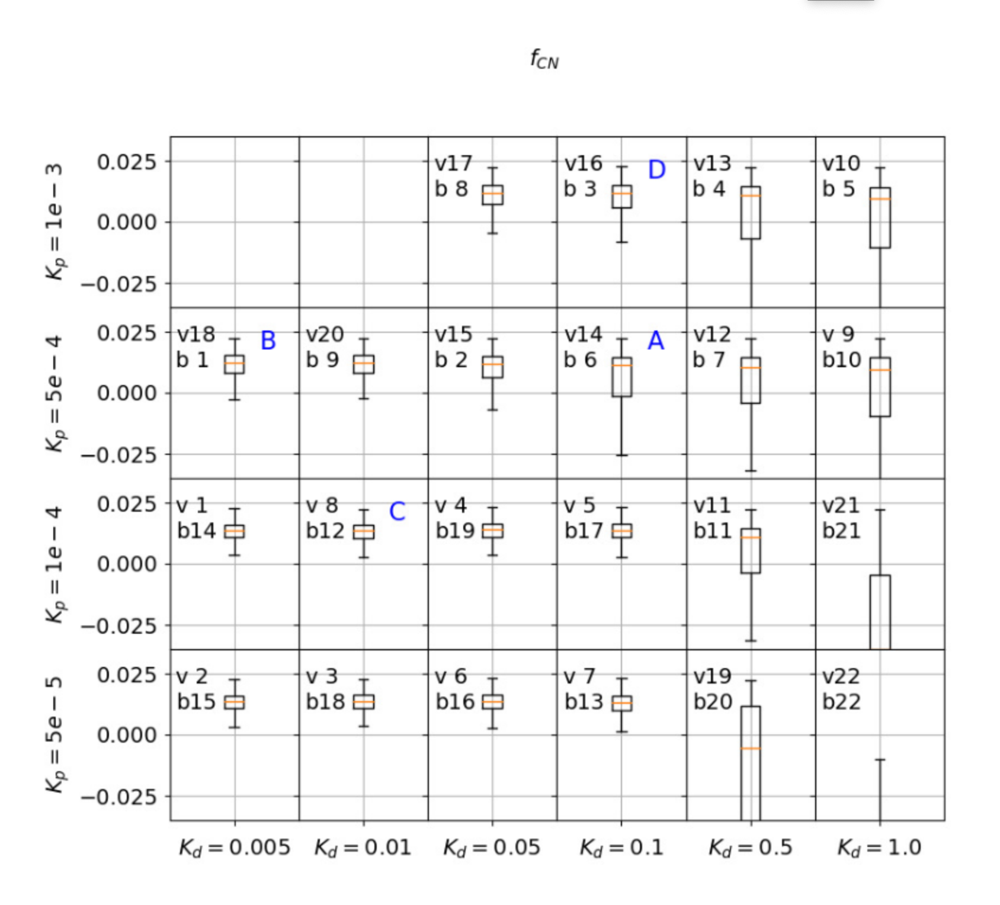

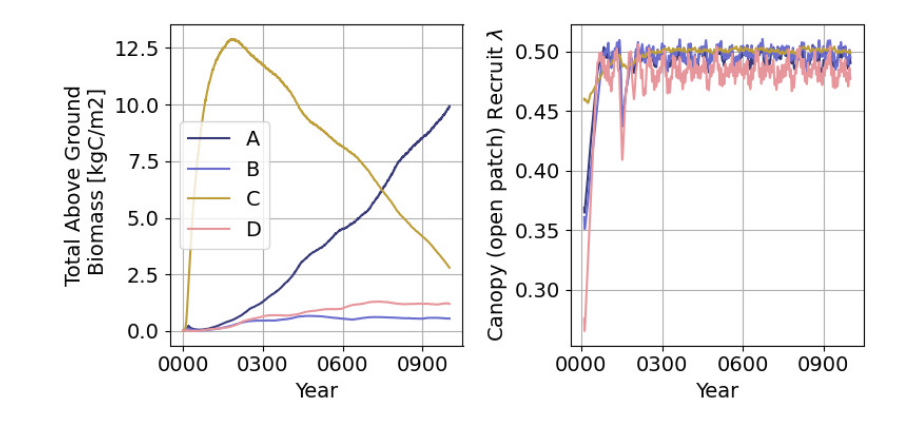

Source : Knox 2023 (under review; https://d197for5662m48.cloudfront.net/documents/publicationstatus/129549/preprint_pdf/4892791c8be5504aff47afd6065937b7.pdf)


In [23]:
from IPython.display import Image, display
display(Image(filename='/Users/ud4/Downloads/PIDs.png',width=800))
display(Image(filename='/Users/ud4/Downloads/BiomassVsPIDs.png',width=800))
print ("Source : Knox 2023 (under review; https://d197for5662m48.cloudfront.net/documents/publicationstatus/129549/preprint_pdf/4892791c8be5504aff47afd6065937b7.pdf)")

In [24]:
import os,glob
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pyreadr # to read .rds files

In [25]:
path_in = "/Users/ud4/FATESMDS_analysis/outputs/runs/tests_alp/230309/"


In [26]:
# RD only

fnames={}


fnames["DUK_PIDA_Conly"] = f"{path_in}Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDA_processed/Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDA_US-DUK_trans.nc"
fnames["ORN_PIDA_Conly"] = f"{path_in}Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDA_processed/Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDA_US-ORN_trans.nc"

fnames["DUK_PIDA_RD"] = f"{path_in}Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDA_RD_processed/Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDA_RD_US-DUK_trans.nc"
fnames["ORN_PIDA_RD"] = f"{path_in}Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDA_RD_processed/Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDA_RD_US-ORN_trans.nc"

#fnames["DUK_PIDB_RD"] = f"{path_in}Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDB_RD_processed/Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDB_RD_US-DUK_trans.nc"
fnames["ORN_PIDB_RD"] = f"{path_in}Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDB_RD_processed/Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDB_RD_US-ORN_trans.nc"

#"ORN_PIDC_RD" : Simulation missing *Running
fnames["DUK_PIDC_RD"] = f"{path_in}Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDC_RD_processed/Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDC_RD_US-DUK_trans.nc"
fnames["ORN_PIDC_RD"] = f"{path_in}Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDC_RD_processed/Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDC_RD_US-DUK_trans.nc"

fnames["DUK_PIDD_RD"] = f"{path_in}Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDD_RD_processed/Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDD_RD_US-DUK_trans.nc"
fnames["ORN_PIDD_RD"] = f"{path_in}Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDD_RD_processed/Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDD_RD_US-ORN_trans.nc"

fnames["DUK_PIDzero_RD"] = f"{path_in}Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDzero_RD_processed/Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDzero_RD_US-ORN_trans.nc"
fnames["ORN_PIDzero_RD"] = f"{path_in}Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDzero_RD_processed/Bharat_AW_Nalloc_api25e3sm_mf0df100_r0616_Base_PIDzero_RD_US-ORN_trans.nc"





In [27]:
# Other global attributes for plots

logging_year= 1855

In [28]:
ds = {}

In [29]:
for idx, key in enumerate(fnames.keys()):
    print (key)
    ds[key] = xr.open_mfdataset(fnames[key],decode_times=True)

DUK_PIDA_Conly
ORN_PIDA_Conly
DUK_PIDA_RD
ORN_PIDA_RD
ORN_PIDB_RD
DUK_PIDC_RD
ORN_PIDC_RD
DUK_PIDD_RD
ORN_PIDD_RD
DUK_PIDzero_RD
ORN_PIDzero_RD


In [30]:
for idx, key in enumerate(ds.keys()):
    ds[key]['time'] =  pd.to_datetime(ds[key].time.values.astype(str))

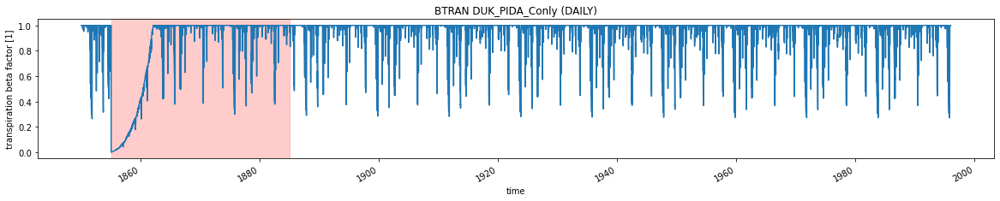

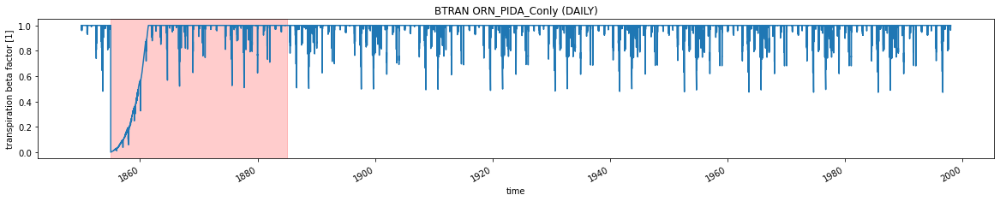

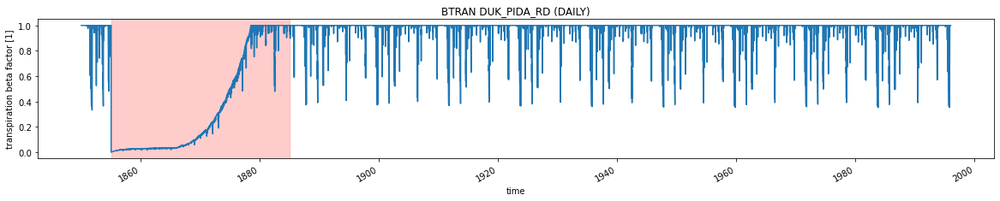

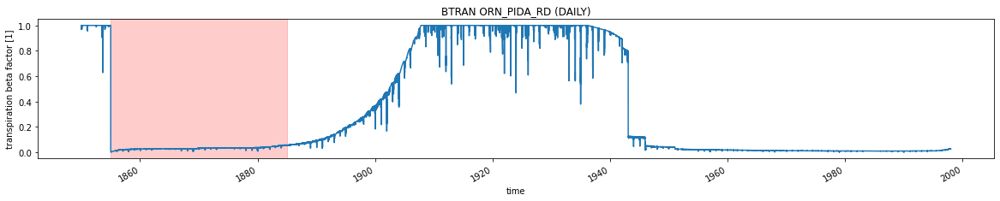

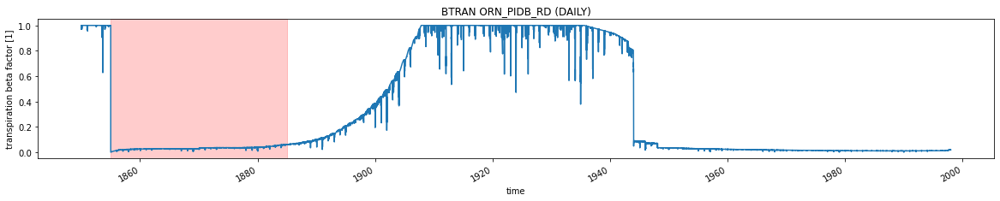

...

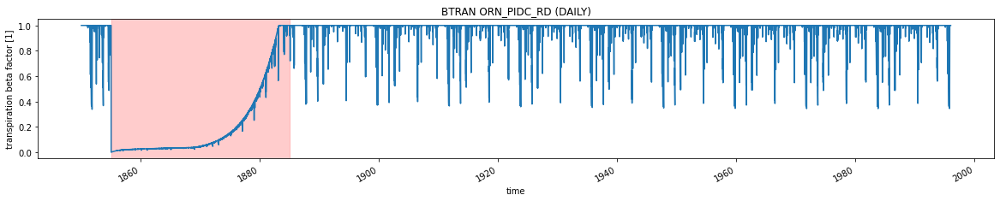

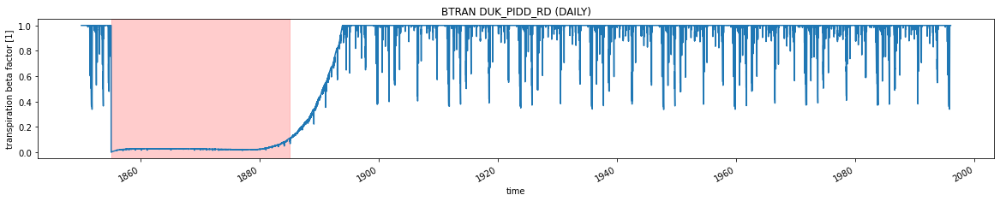

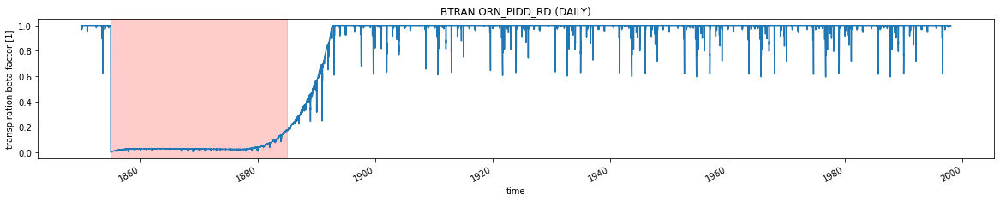

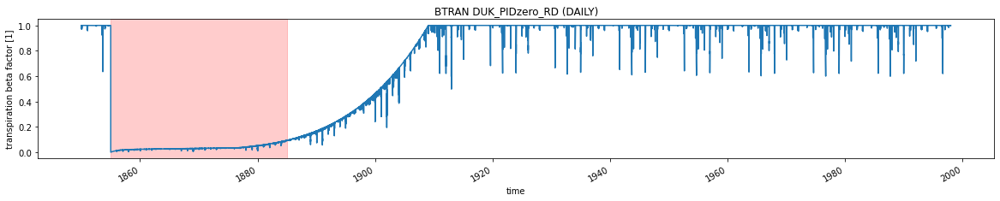

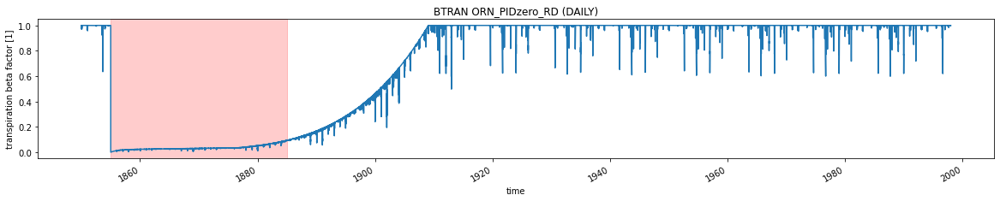

In [31]:
start = "1855-01-01"
end = "1885-01-01"
var = "BTRAN"
for idx, key in enumerate(ds.keys()):
    ds[key][var].plot(figsize=(20,3))
    plt.title(f"{var} {key} (DAILY)")
    plt.axvspan(start,end,alpha = .2, color = 'red')

'transpiration beta factor'

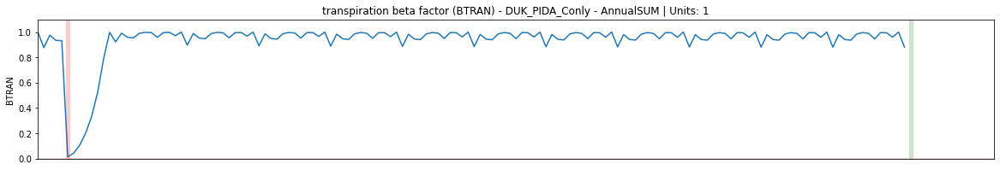

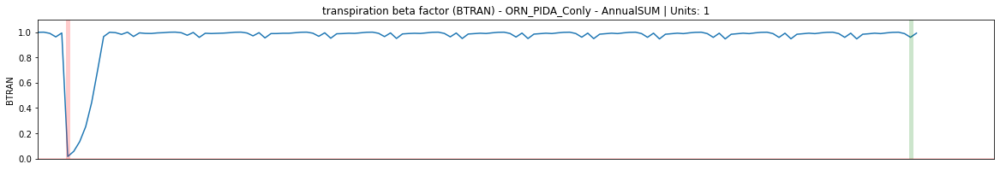

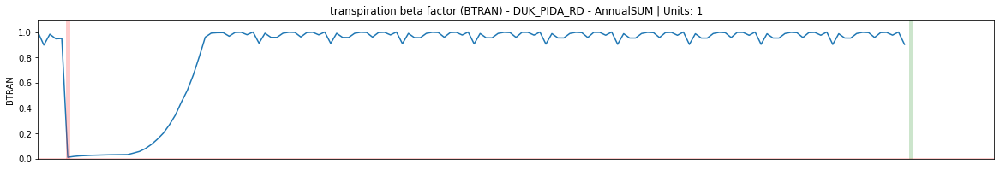

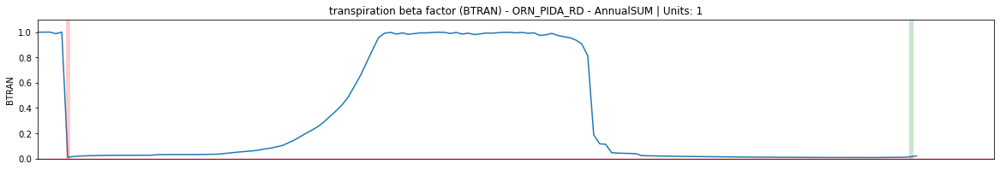

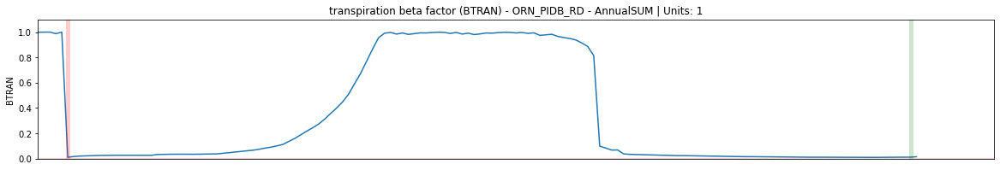

...

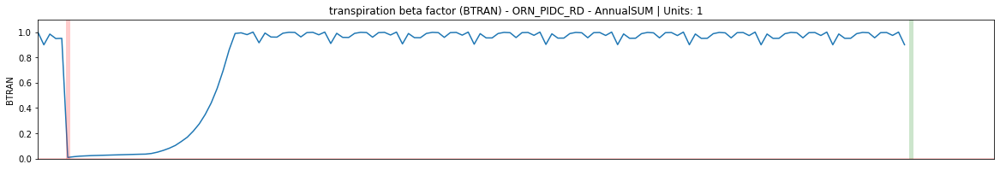

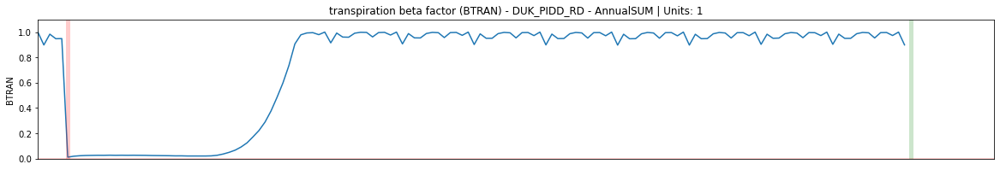

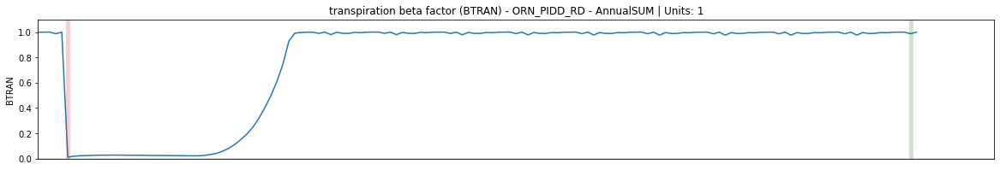

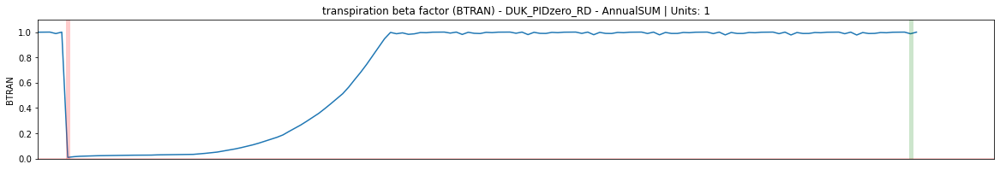

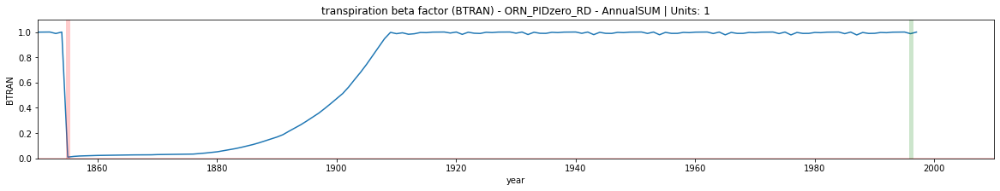

In [32]:
var = "BTRAN"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3))
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,1.1)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
    

ds[key][var].long_name 
# Remarks: 

In [33]:
len(ds.keys())

11

### BTRAN
Increased BTRAN shown increase water stress during after the logging event which hinder NPP growth, especially in the case of ECA and RD. For Carbon only simulations BTRAN recovered quickly. What could cause BTRAN to be so low in N-active model?


In [34]:
ds[key][var].groupby("time.year").mean('time')

<xarray.DataArray 'BTRAN' (year: 148, lndgrid: 1)>
dask.array<stack, shape=(148, 1), dtype=float32, chunksize=(1, 1), chunktype=numpy.ndarray>
Coordinates:
  * year     (year) int64 1850 1851 1852 1853 1854 ... 1993 1994 1995 1996 1997
Dimensions without coordinates: lndgrid

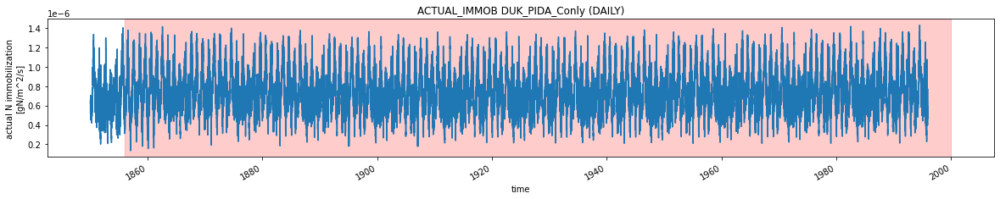

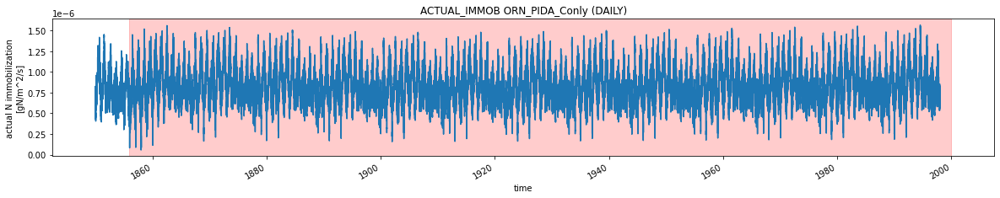

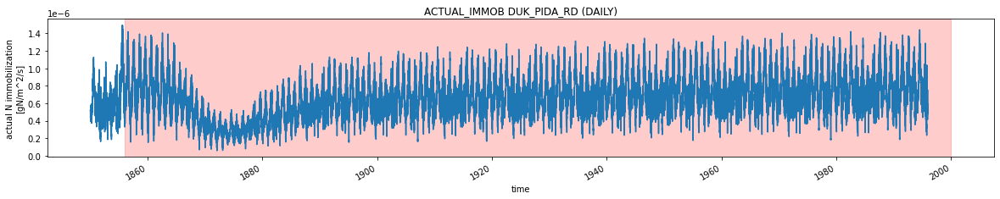

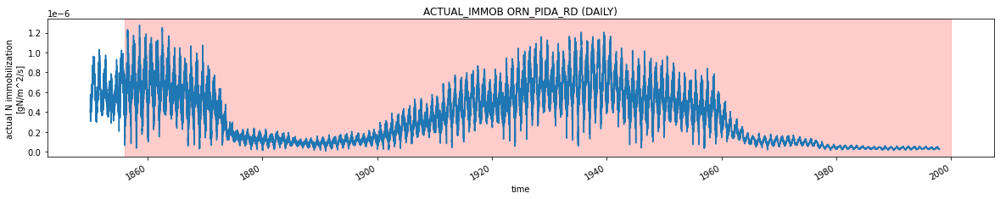

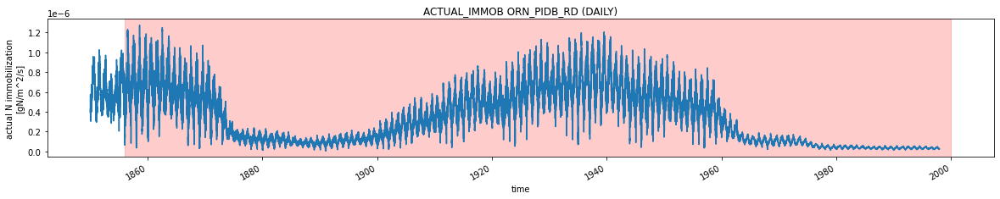

...

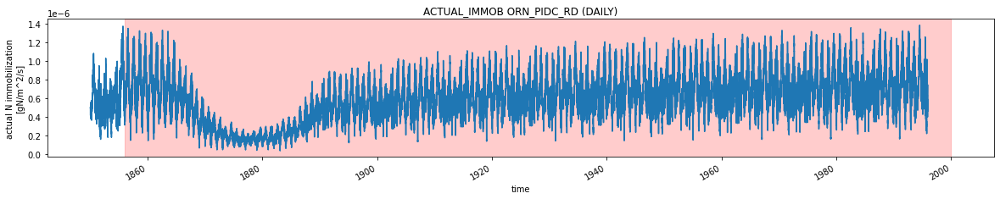

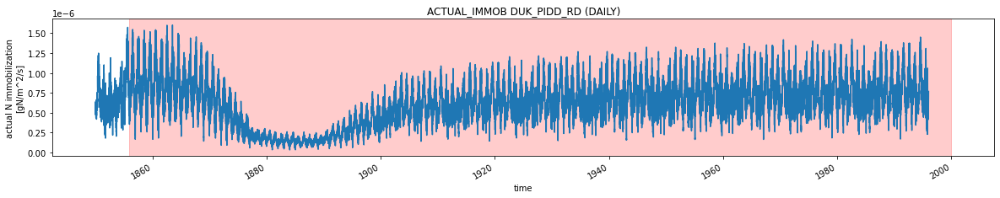

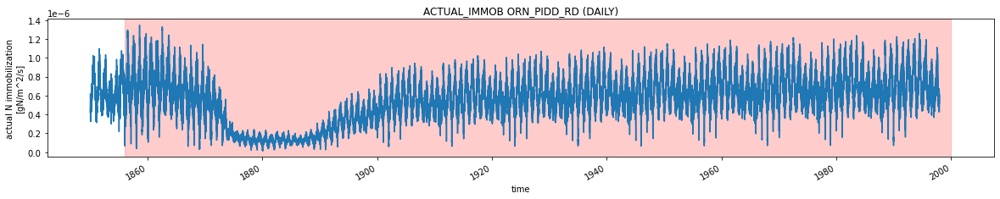

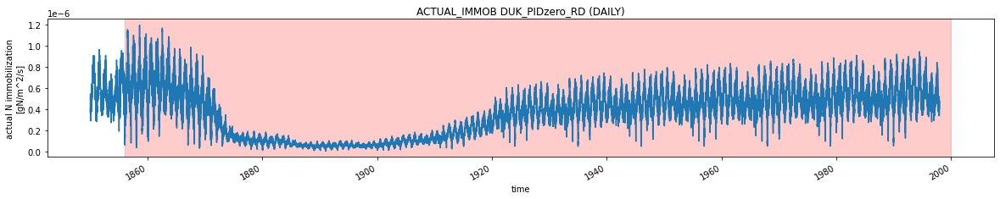

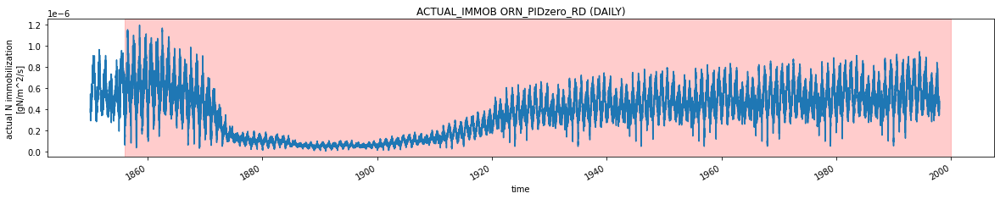

In [35]:
start = "1855-12-01"
end = "2000-01-01"
var = "ACTUAL_IMMOB"
for idx, key in enumerate(ds.keys()):
    ds[key][var].plot(figsize=(20,3))
    plt.title(f"{var} {key} (DAILY)")
    plt.axvspan(start,end,alpha = .2, color = 'red')

'actual N immobilization'

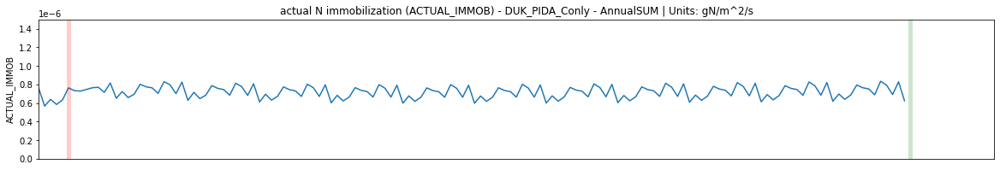

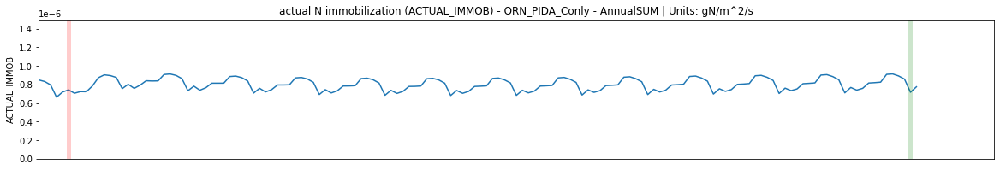

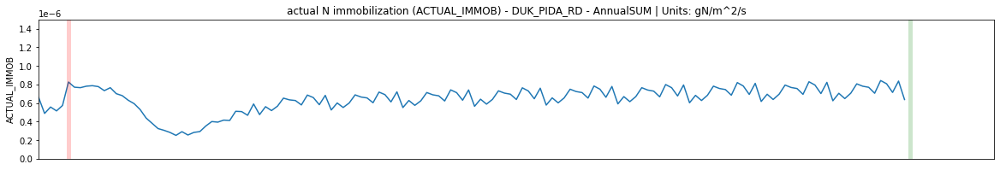

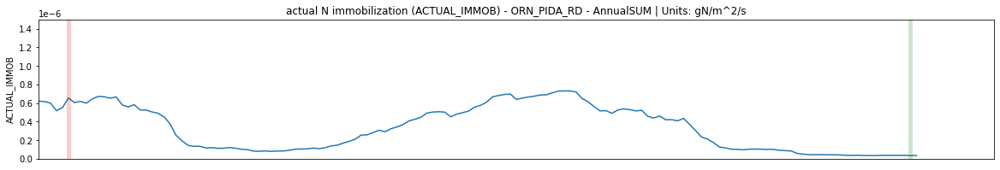

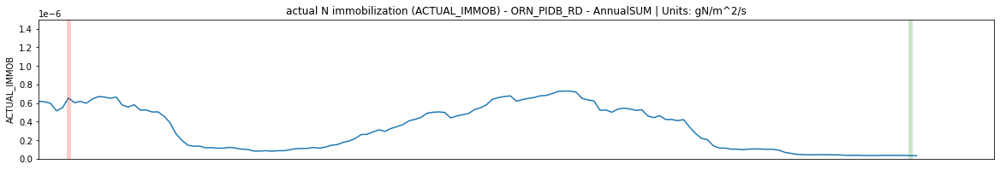

...

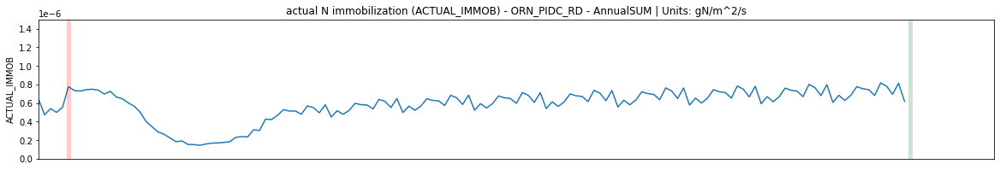

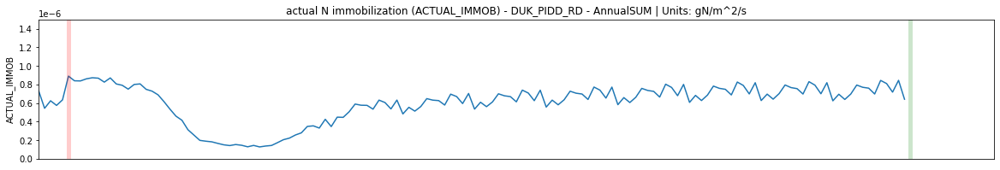

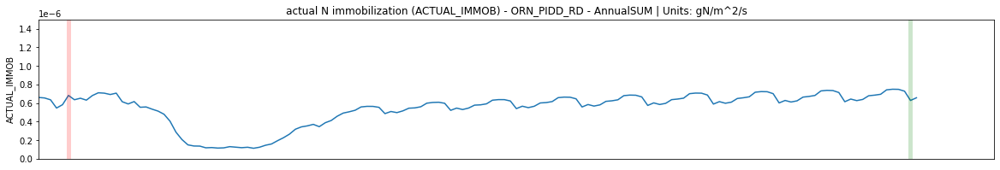

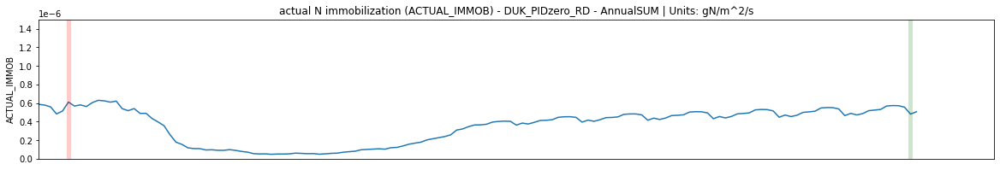

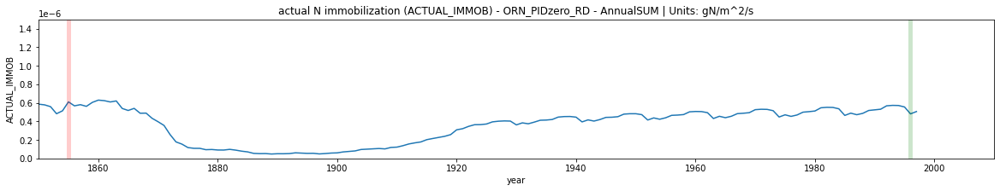

In [36]:
#ACTUAL_IMMOB
var = "ACTUAL_IMMOB"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3))
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,1.5e-6)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
    
ds[key][var].long_name 
# Remarks: 
# Increase in Immobilization of 

### ACTUAL_IMMOB
Increased ACTUAL_IMMOB shows less nutrient available for plants in ECA model.


'actual P immobilization'

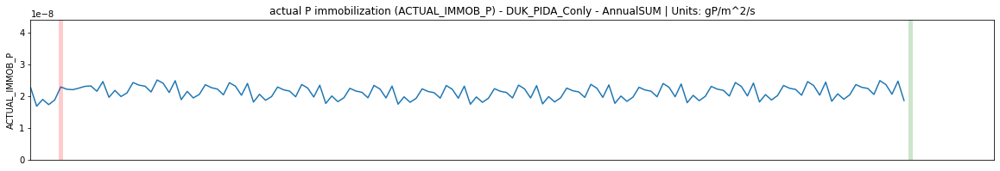

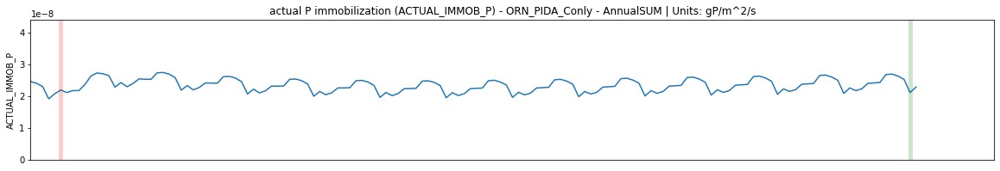

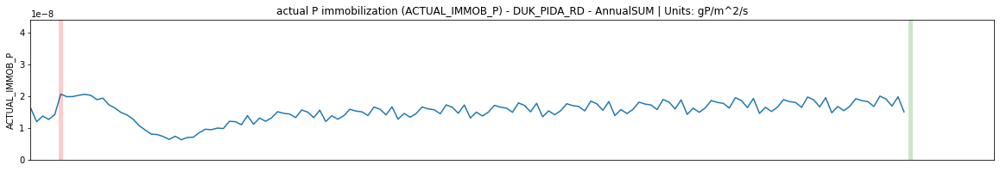

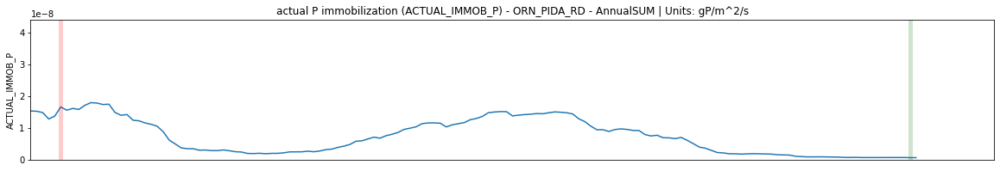

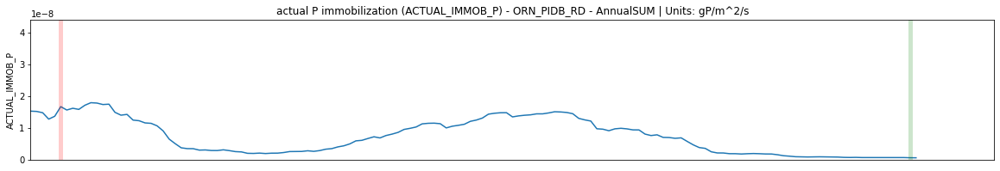

...

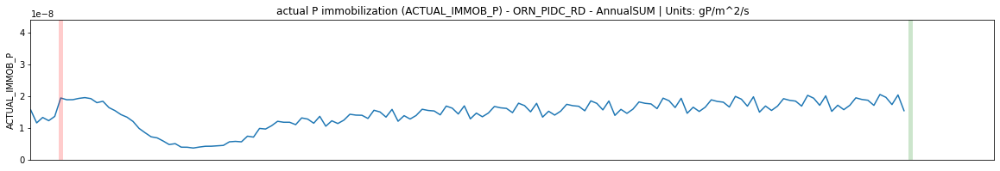

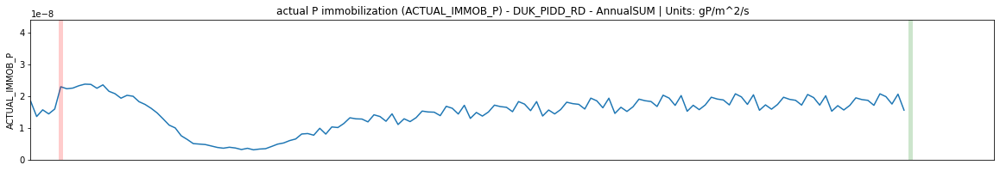

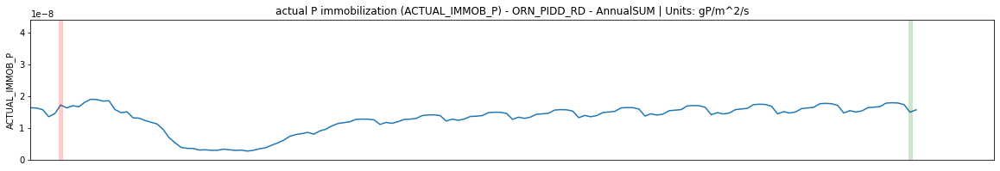

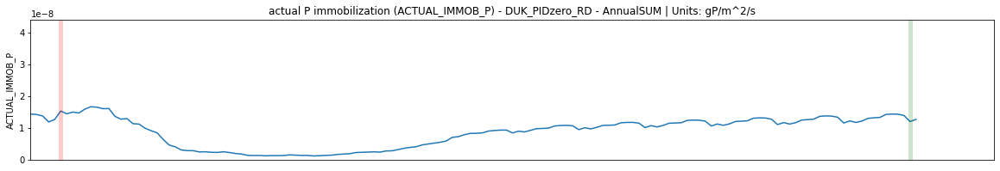

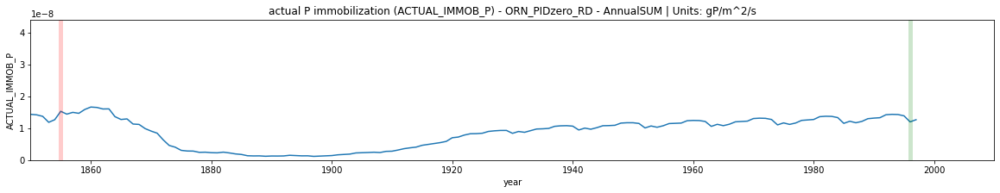

In [37]:
#ACTUAL_IMMOB
var = "ACTUAL_IMMOB_P"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3))
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,4.4e-8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
        
ds[key][var].long_name 
# Remarks: 
    

'adsorb P flux'

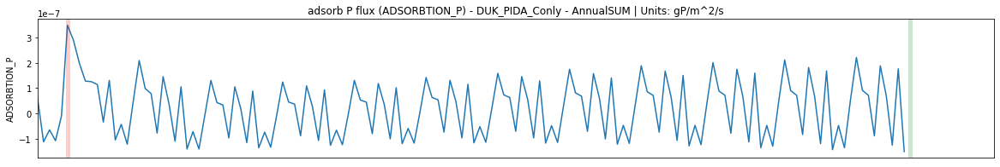

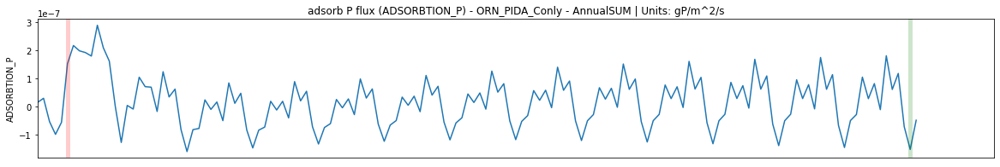

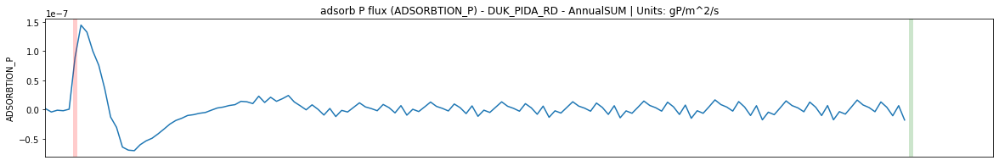

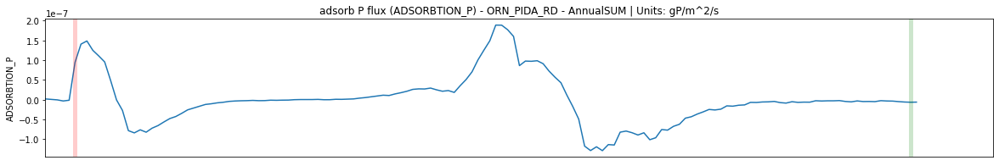

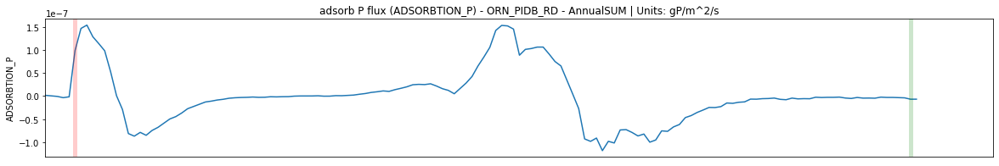

...

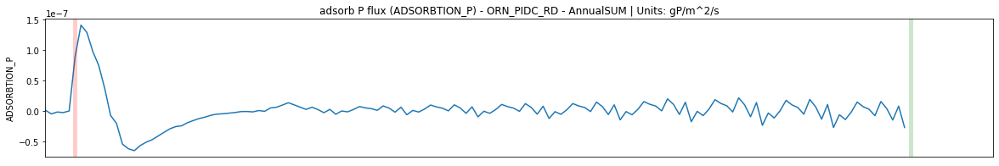

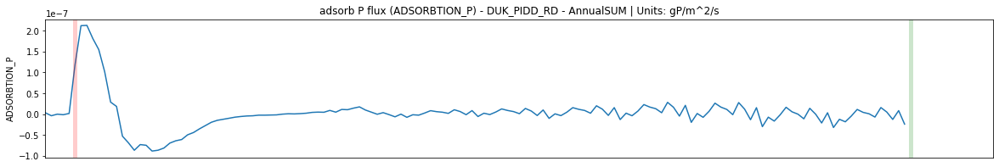

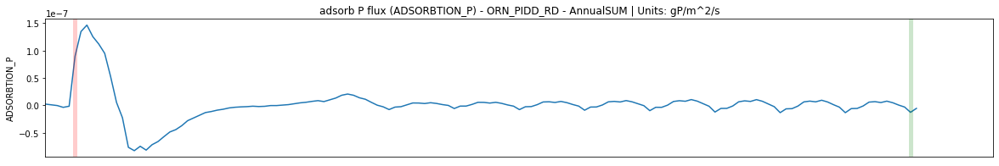

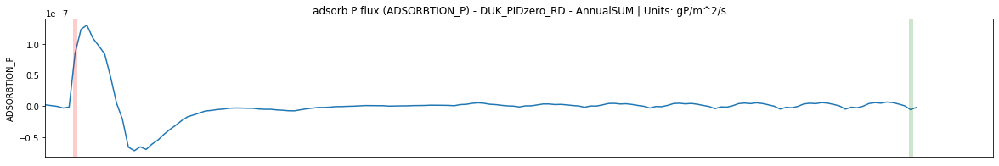

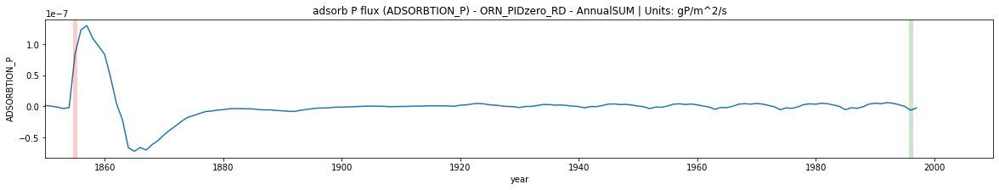

In [38]:
var = "ADSORBTION_P"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3))
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
        
ds[key][var].long_name 
# Remarks: 

'Gridcell carbon mass balance error'

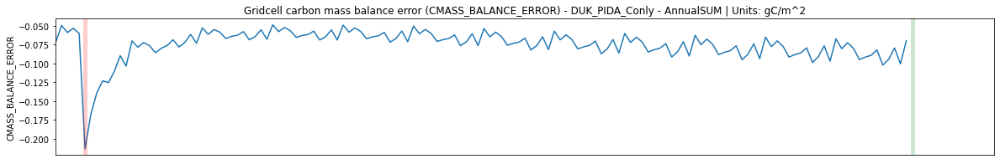

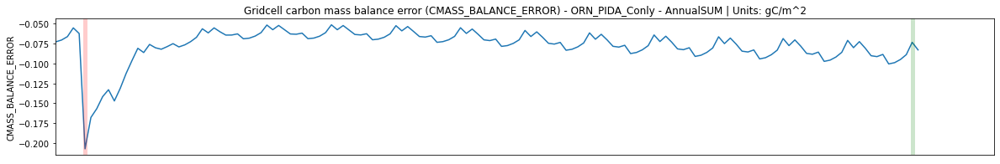

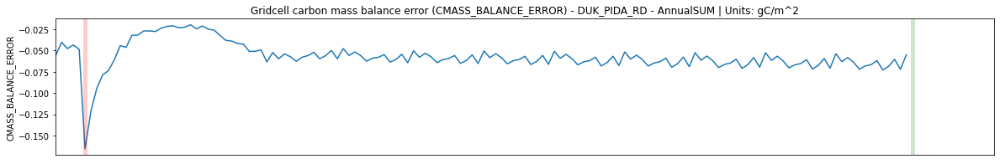

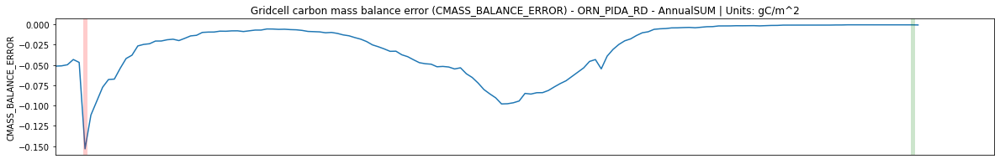

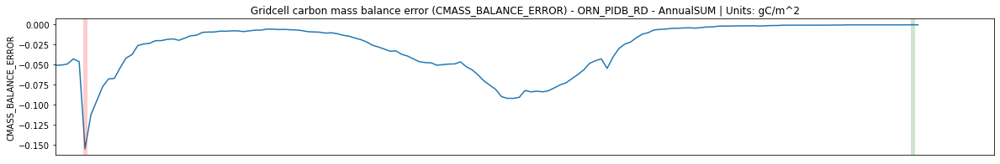

...

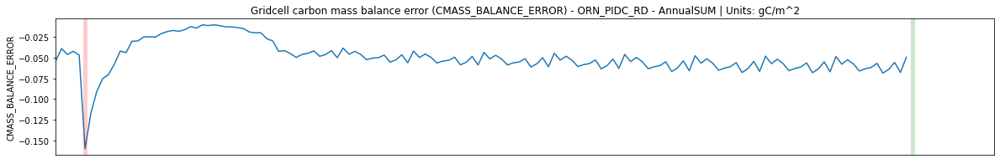

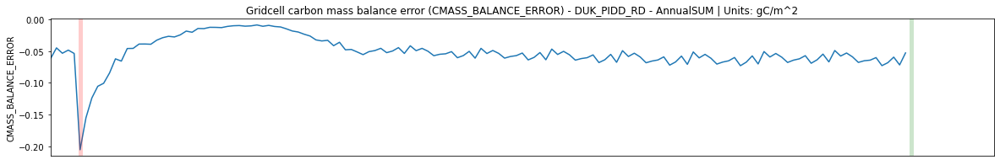

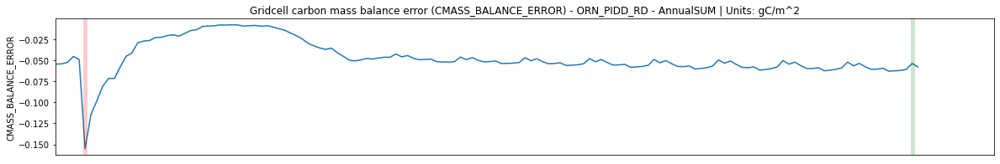

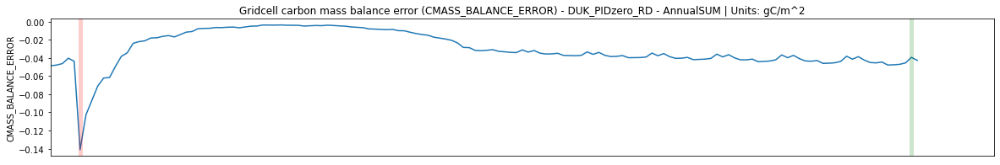

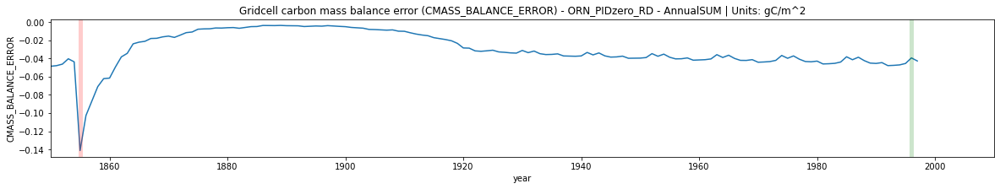

In [39]:

var = "CMASS_BALANCE_ERROR"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3))
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(.6e-6,1.5e-6)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
        
ds[key][var].long_name 
# Remarks: 

'total rate of denitrification'

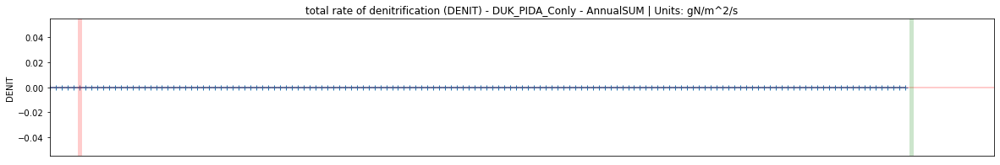

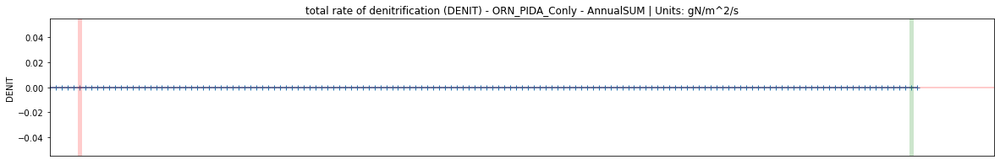

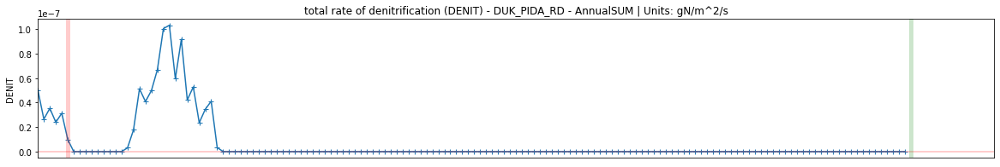

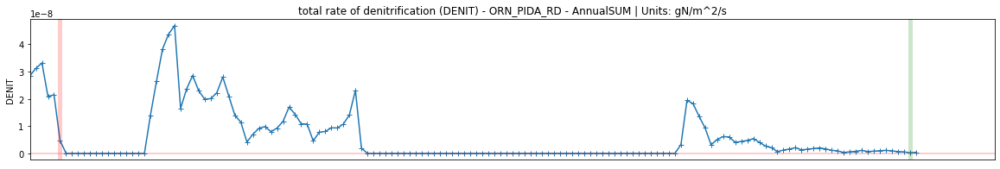

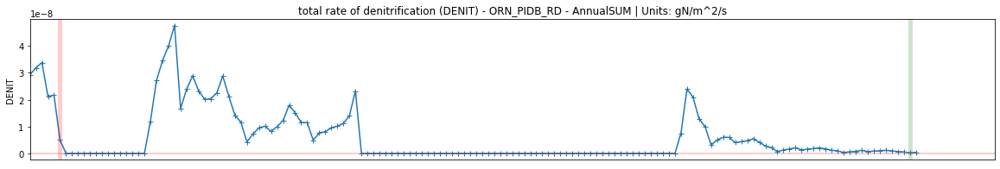

...

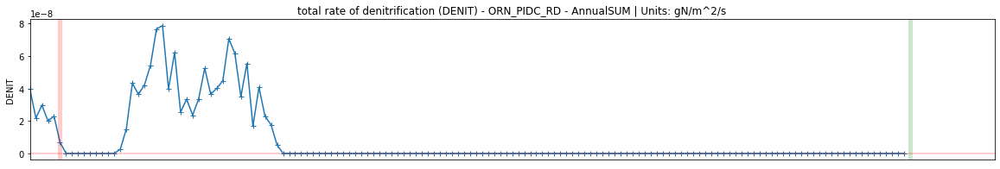

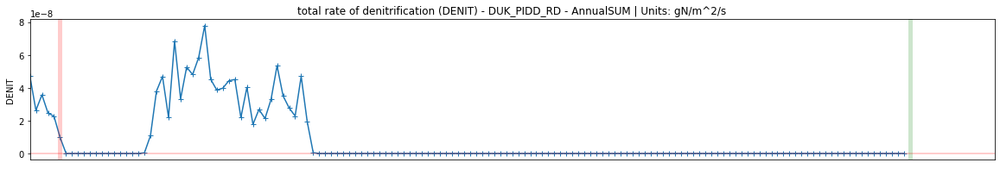

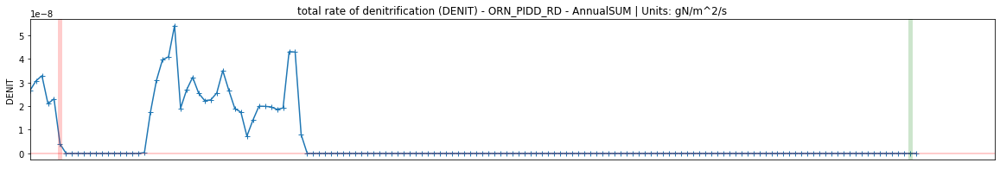

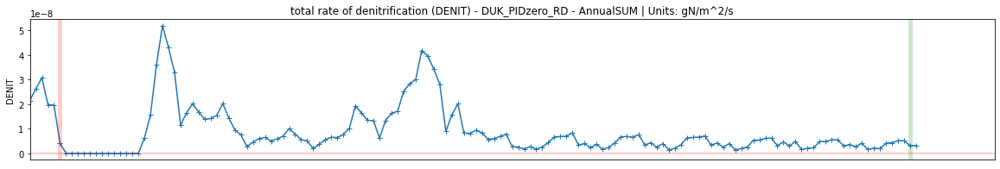

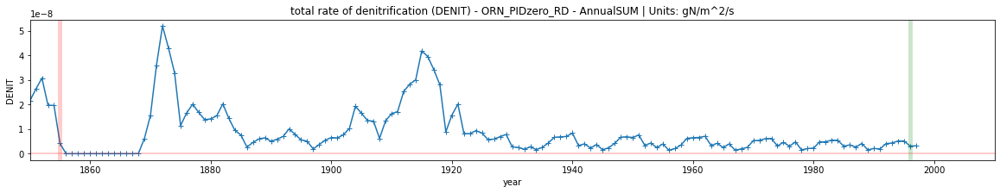

In [40]:

var = "DENIT"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(.6e-6,1.5e-6)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)

ds[key][var].long_name 
# Remarks: 

'desorp P flux'

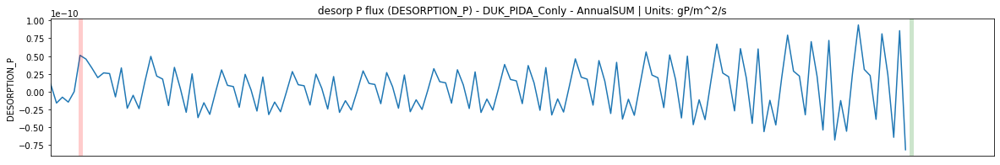

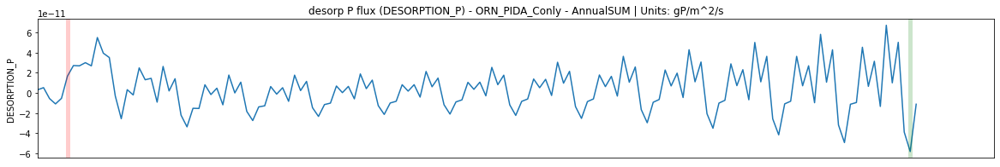

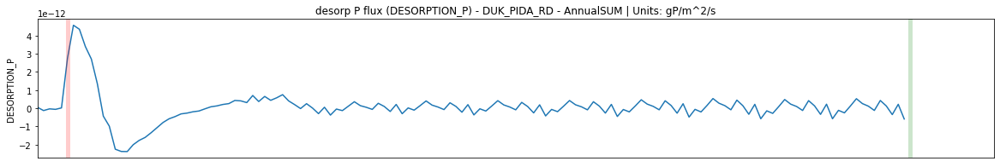

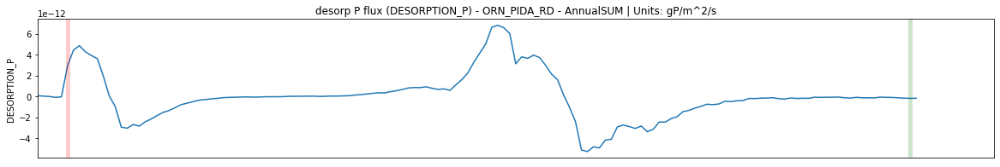

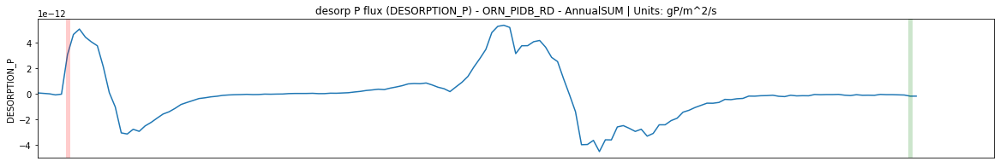

...

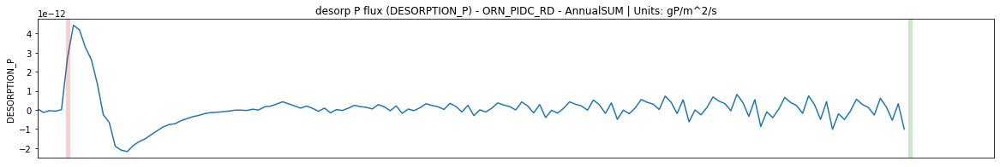

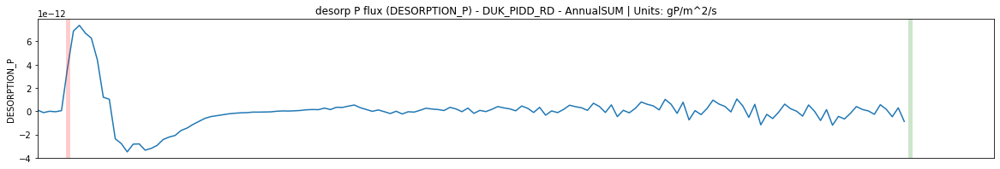

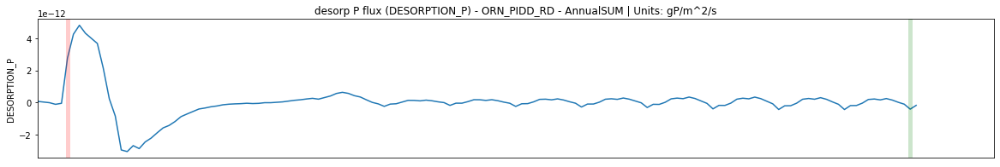

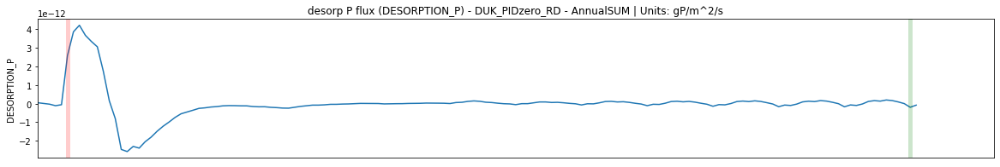

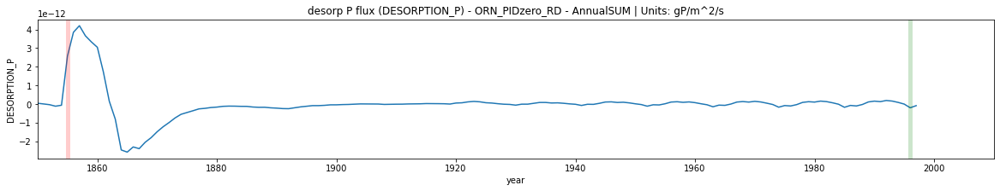

In [41]:

var = "DESORPTION_P"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3))
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(.6e-6,1.5e-6)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)

ds[key][var].long_name 
# Remarks: 

'exposed one-sided leaf area index'

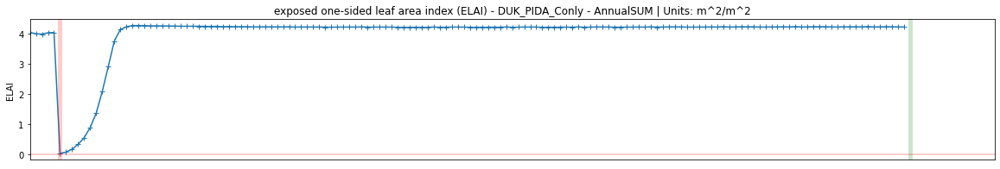

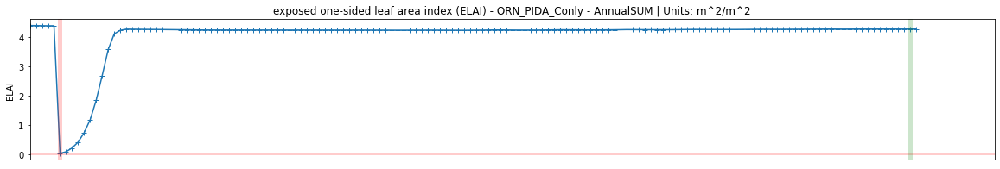

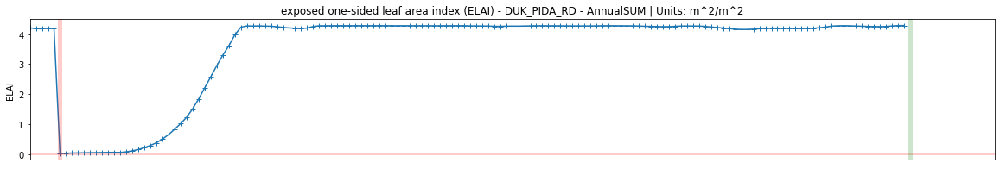

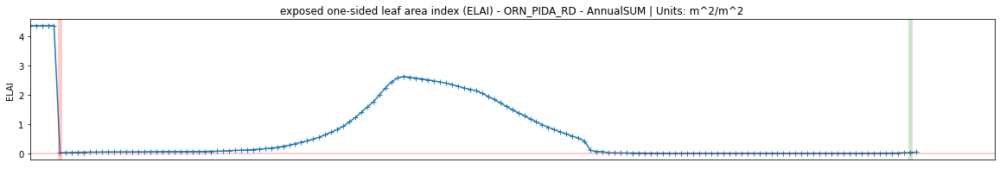

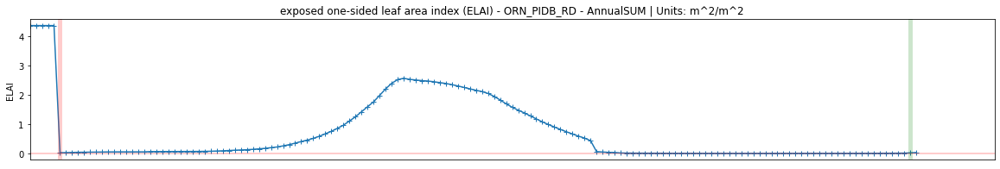

...

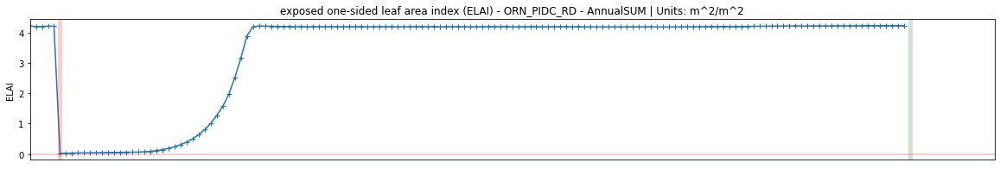

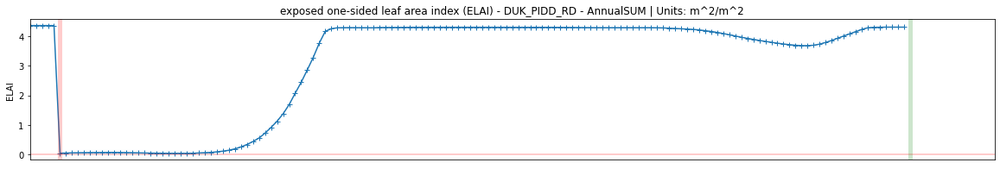

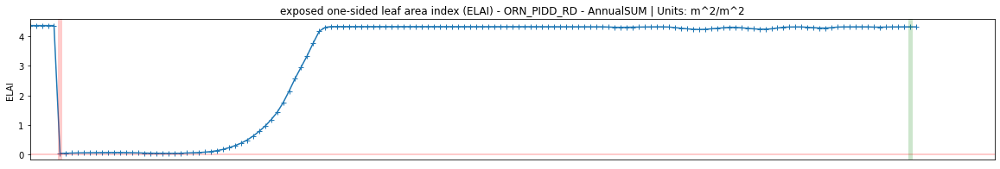

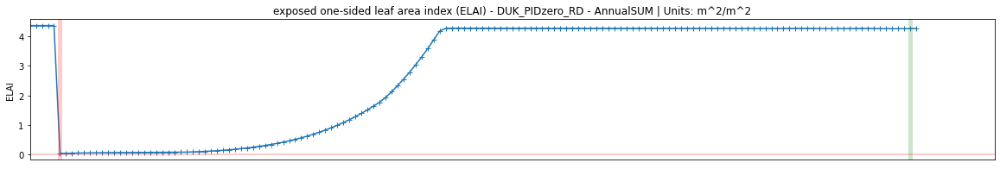

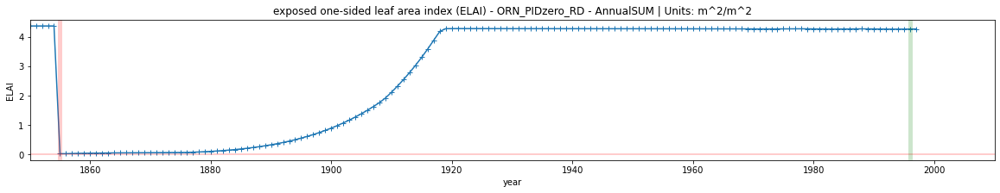

In [42]:
var = "ELAI"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(.6e-6,1.5e-6)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)

ds[key][var].long_name 
# Remarks: 

'exposed one-sided stem area index'

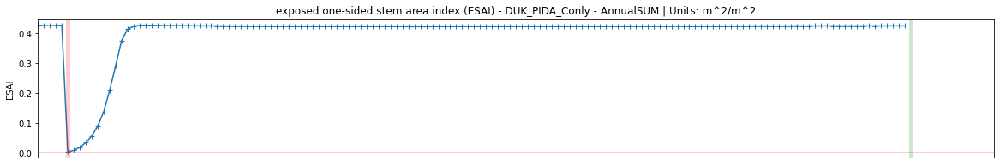

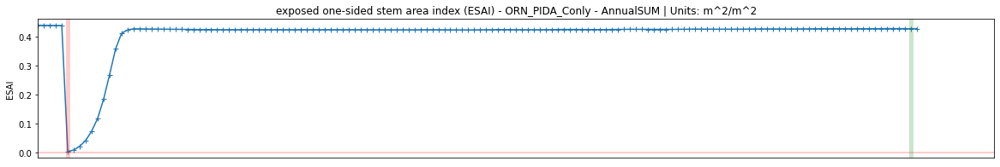

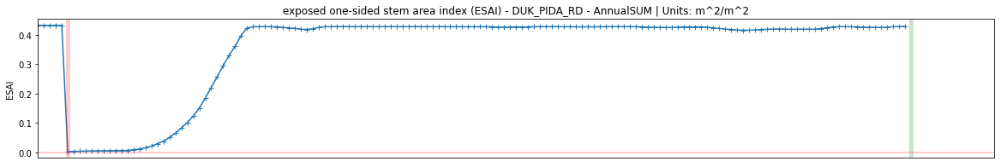

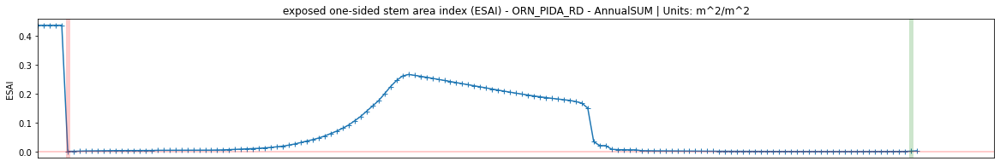

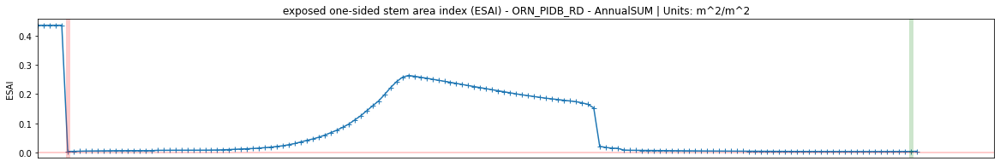

...

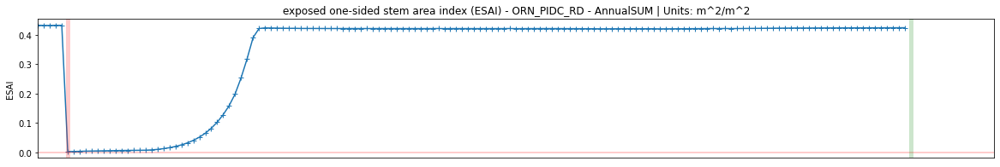

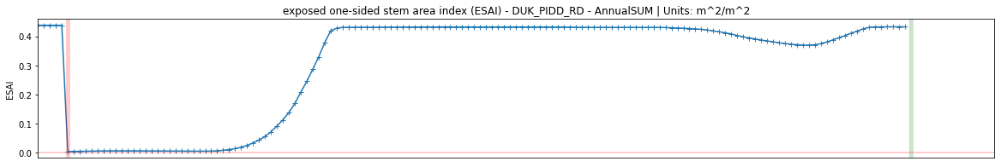

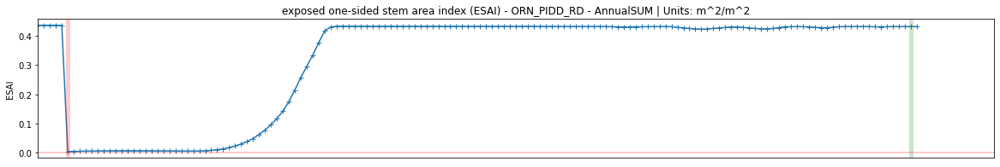

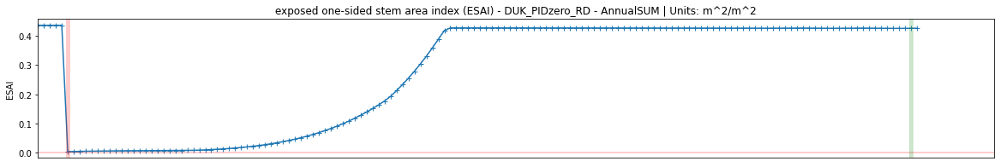

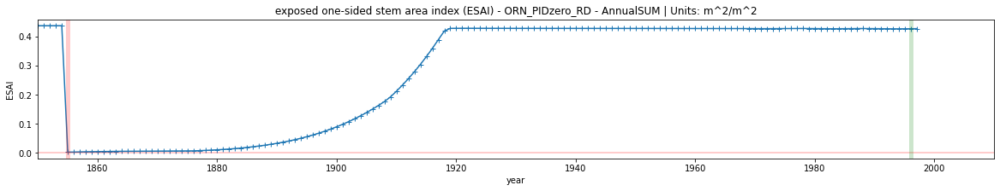

In [43]:
var = "ESAI"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(.6e-6,1.5e-6)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
        
ds[key][var].long_name 
# Remarks: 

'area occupied by all plants per m2 land area'

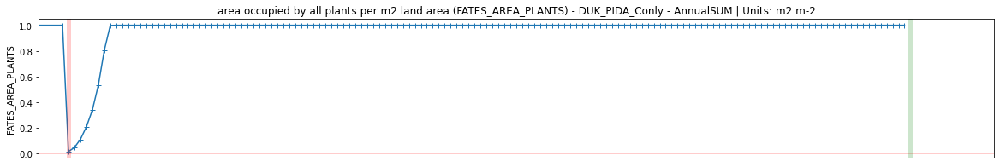

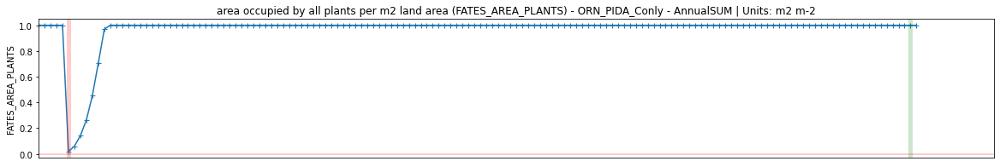

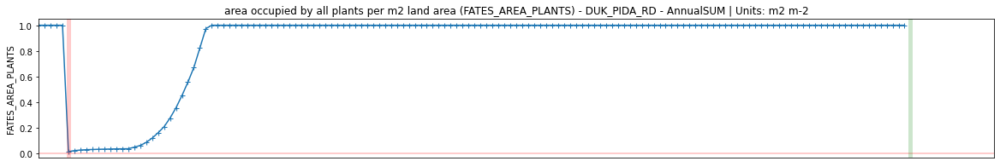

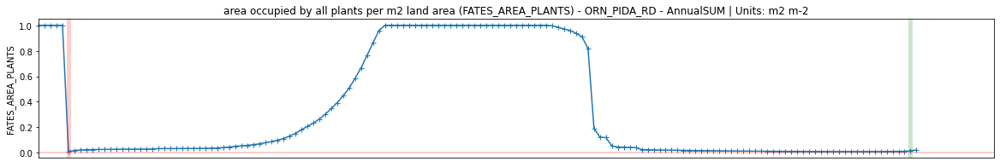

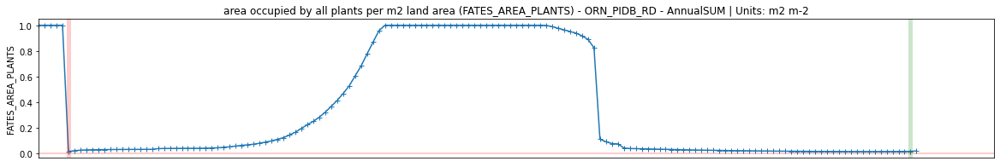

...

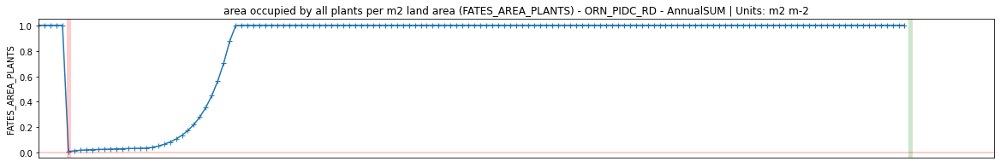

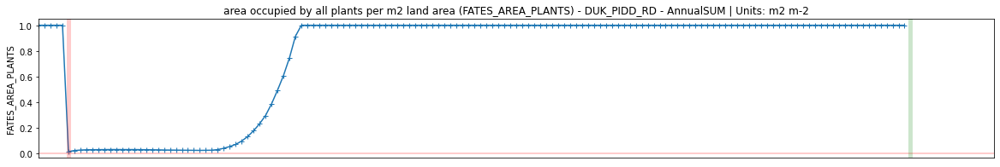

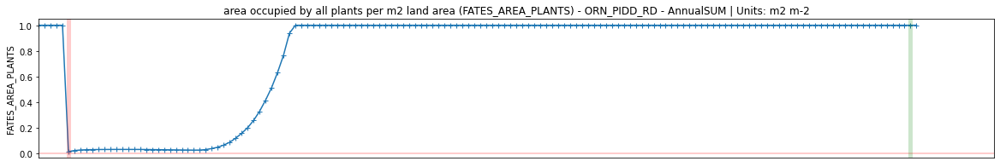

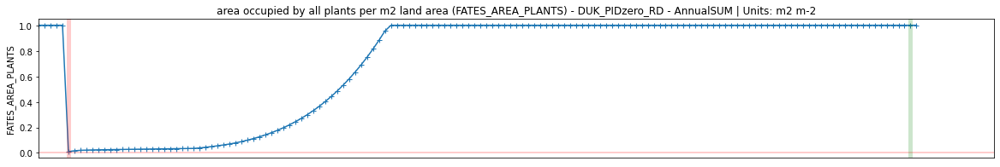

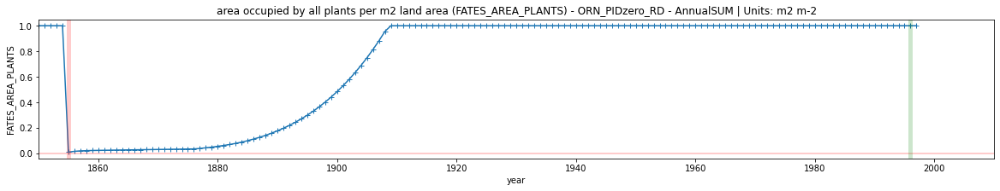

In [44]:
var = "FATES_AREA_PLANTS"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(.6e-6,1.5e-6)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
        
ds[key][var].long_name 
# Remarks: 

'area occupied by woody plants per m2 land area'

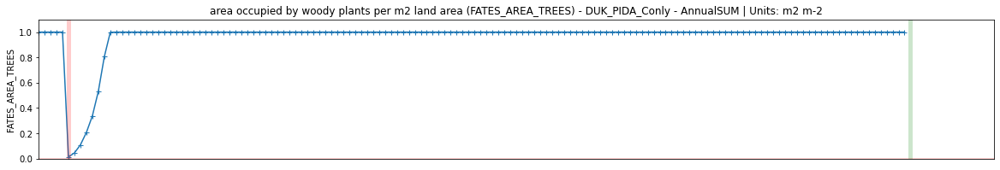

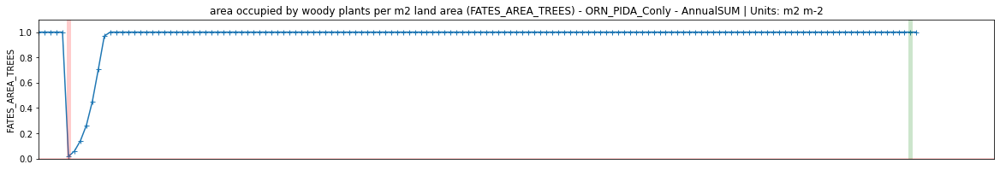

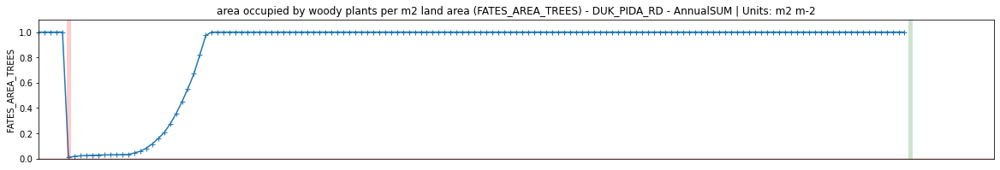

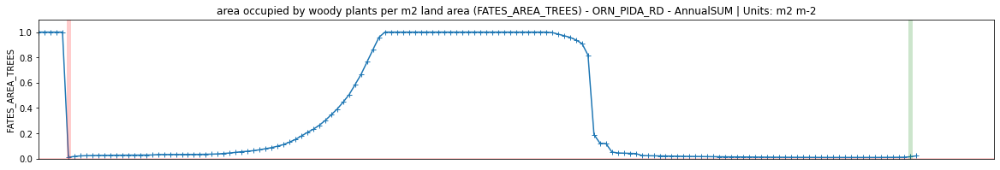

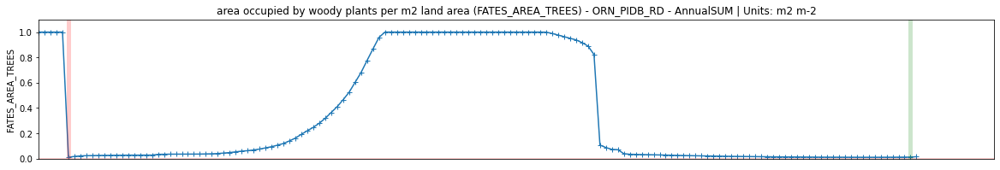

...

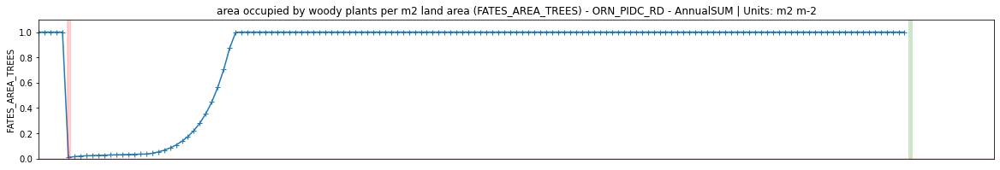

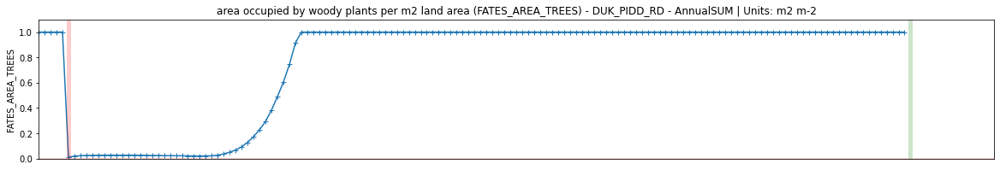

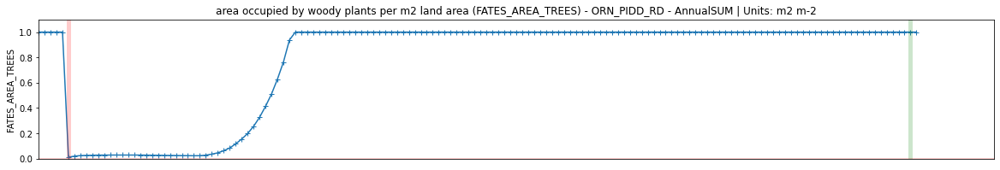

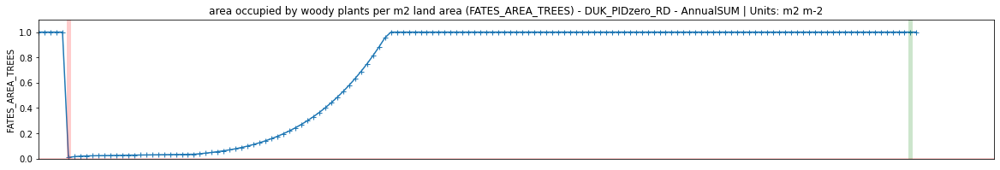

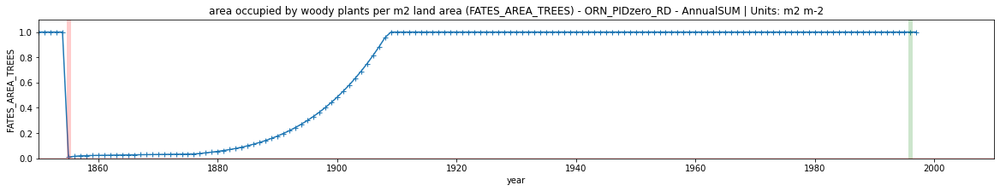

In [138]:
var = "FATES_AREA_TREES"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,1.1)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
        
ds[key][var].long_name 
# Remarks: 

'autotrophic respiration in kg carbon per m2 per second'

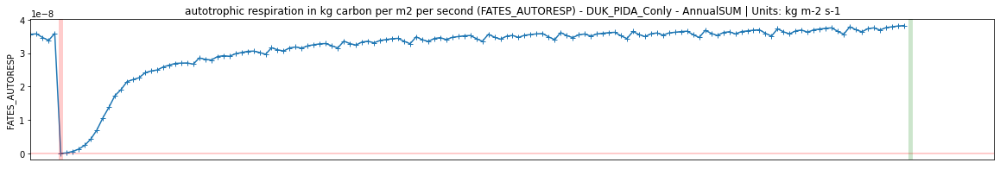

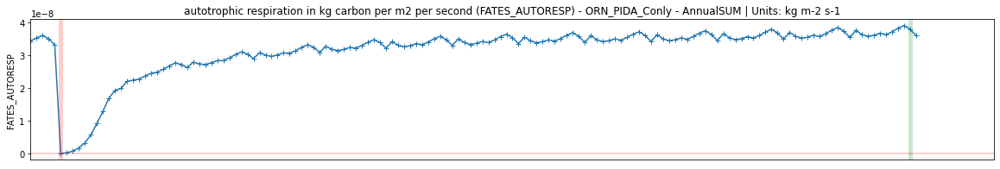

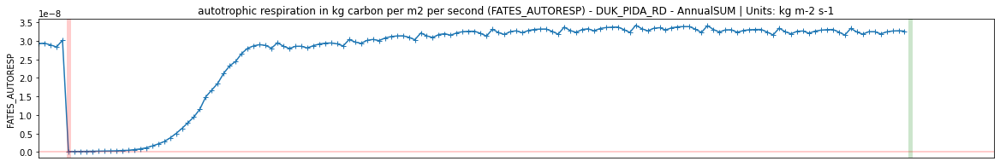

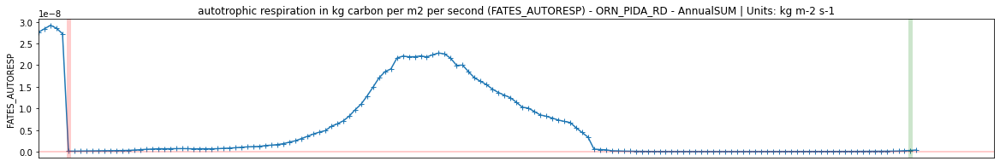

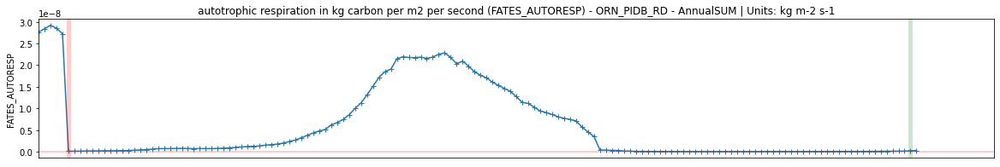

...

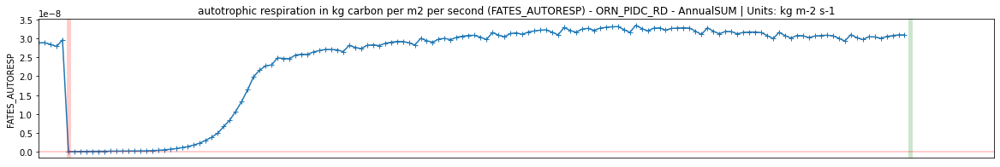

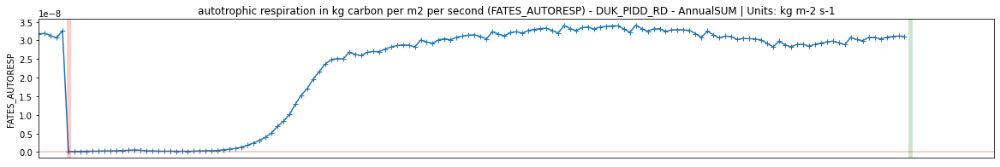

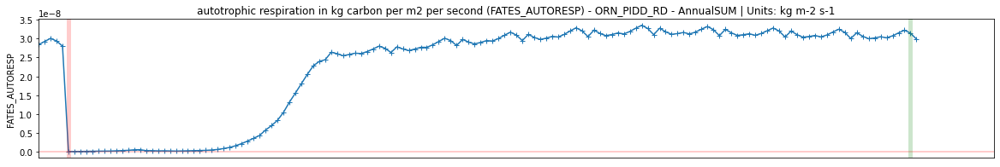

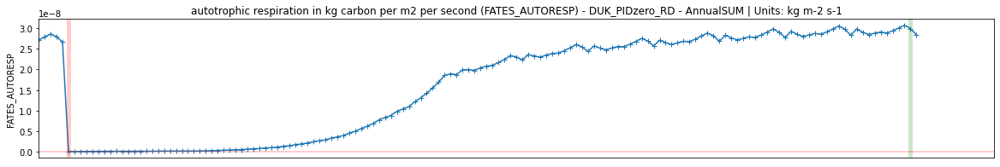

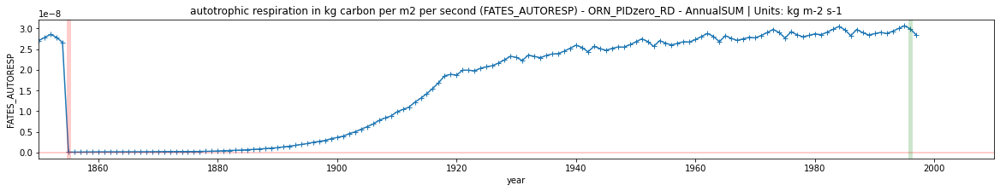

In [46]:
var = "FATES_AUTORESP"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(.6e-6,1.5e-6)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
        
ds[key][var].long_name 
# Remarks: 

'autotrophic respiration of canopy plants in kg carbon per m2 per second'

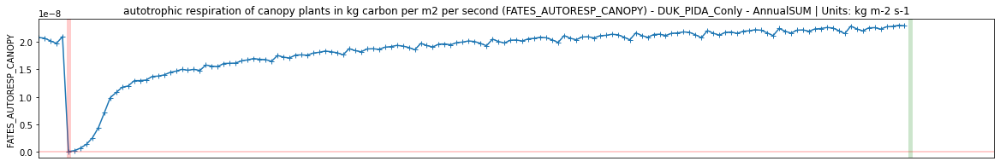

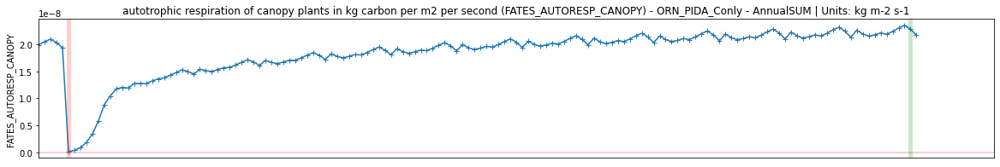

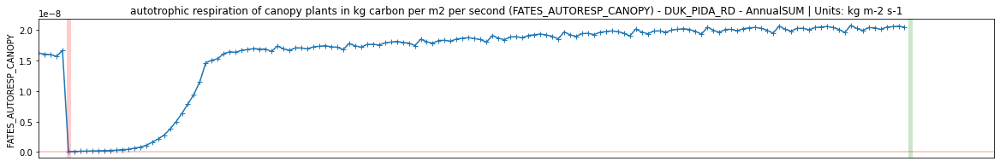

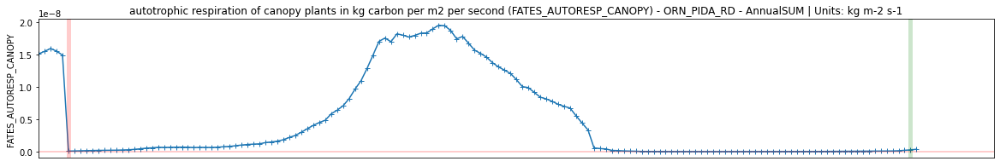

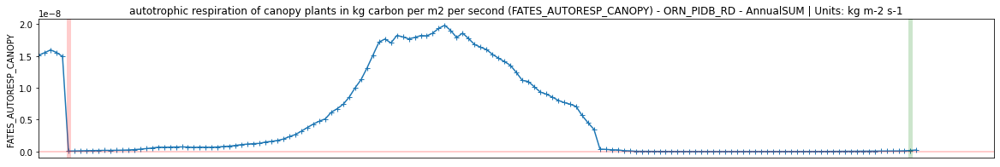

...

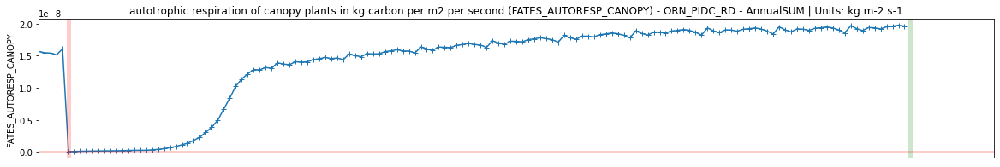

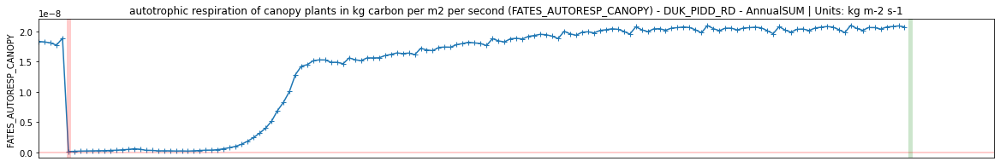

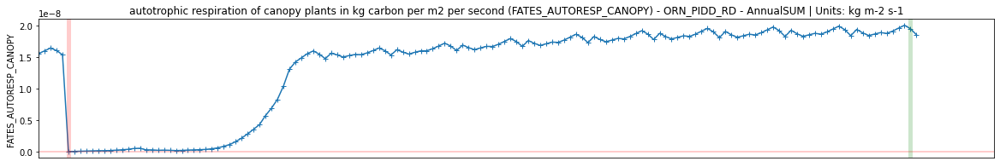

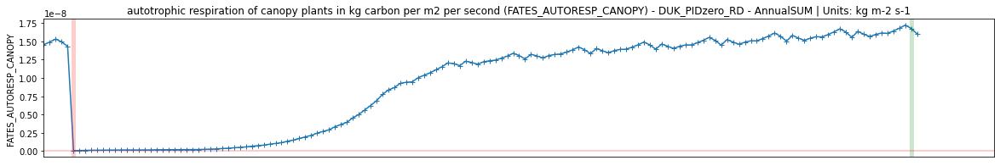

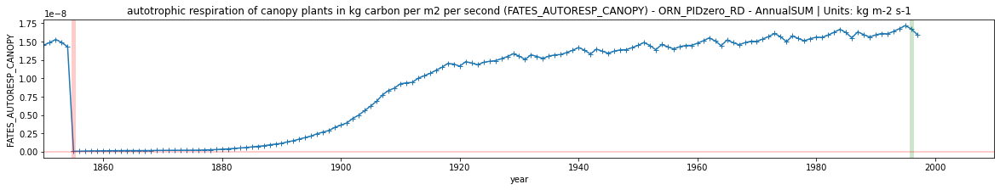

In [47]:
var = "FATES_AUTORESP_CANOPY"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(.6e-6,1.5e-6)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
        
ds[key][var].long_name 
# Remarks: 
    

'autotrophic respiration of understory plants in kg carbon per m2 per second'

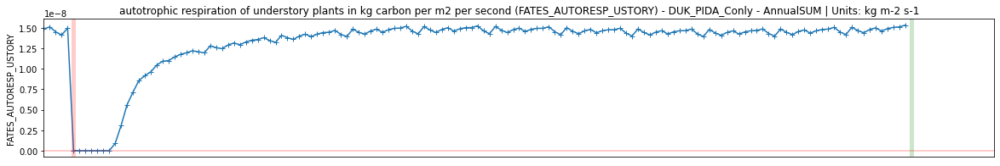

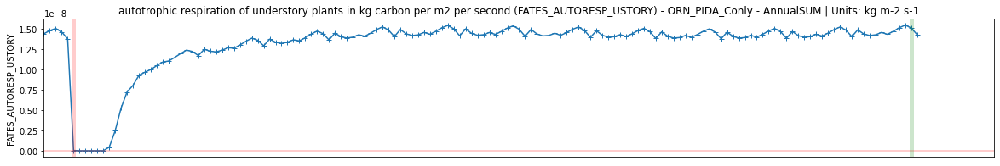

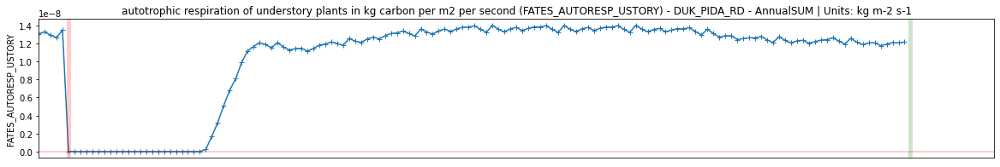

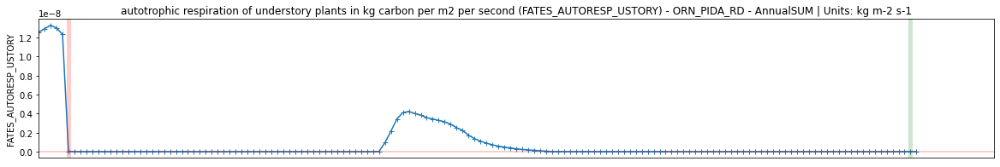

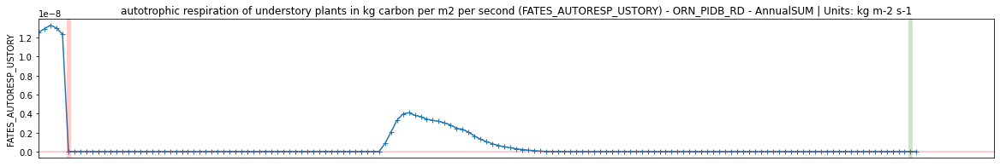

...

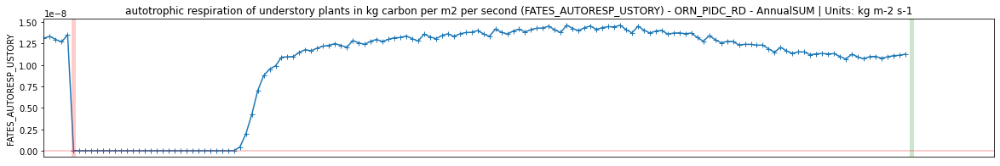

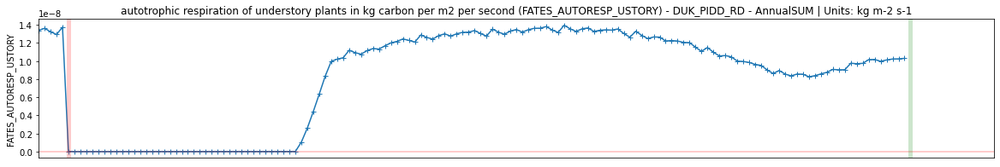

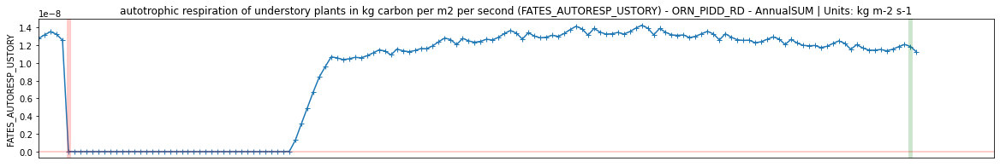

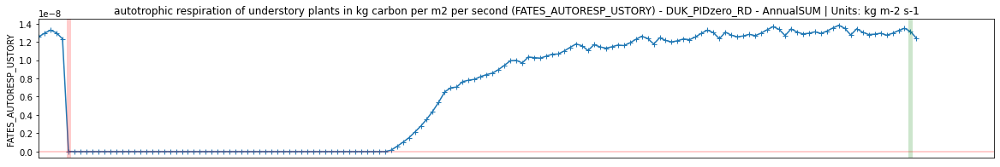

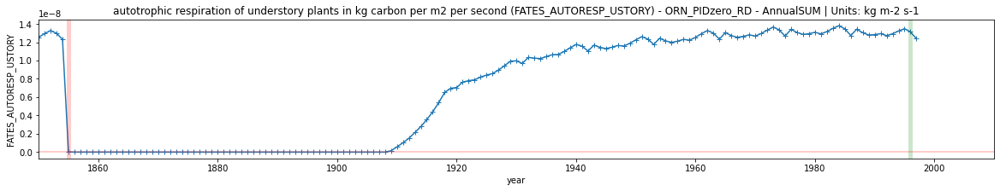

In [48]:
var = "FATES_AUTORESP_USTORY"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(.6e-6,1.5e-6)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
        
ds[key][var].long_name 
# Remarks: 

'live coarse root maintenance autotrophic respiration in kg carbon per m2 per second'

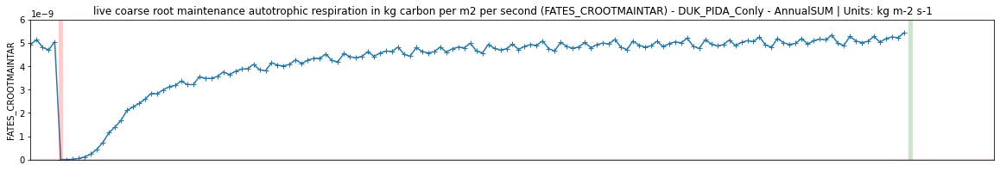

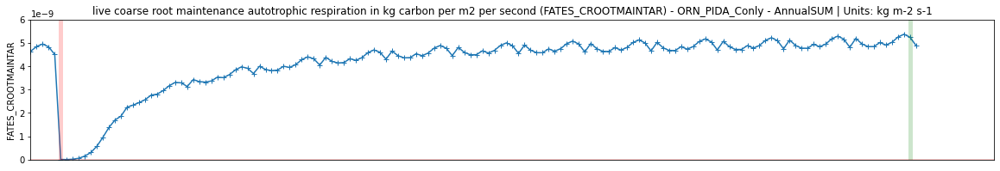

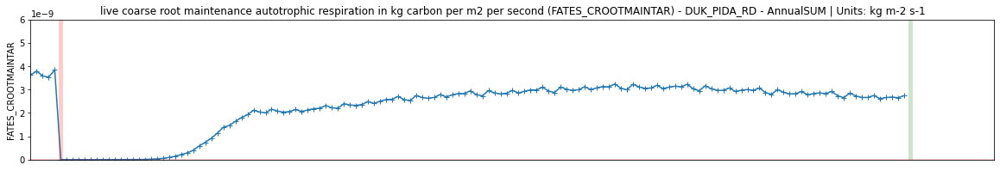

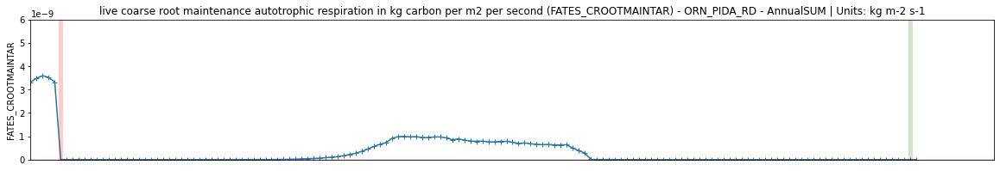

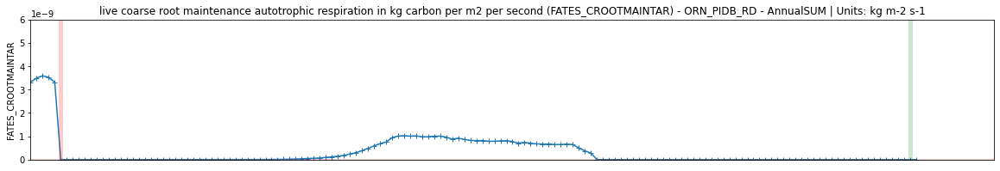

...

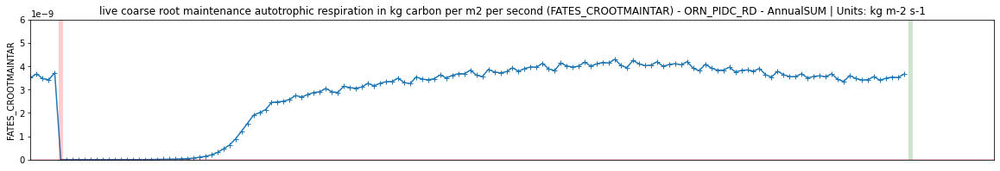

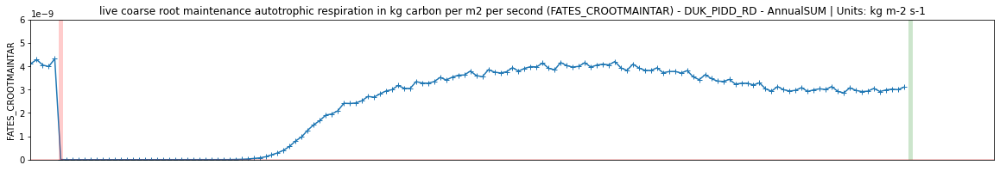

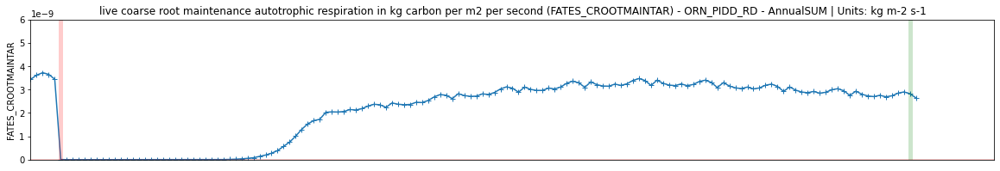

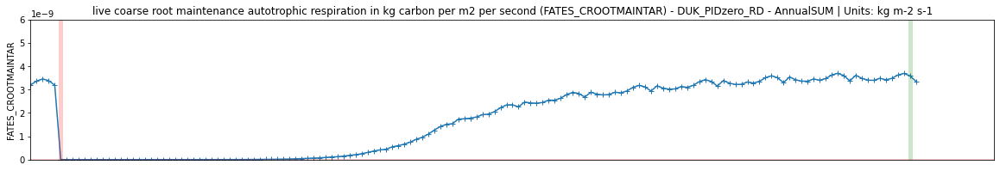

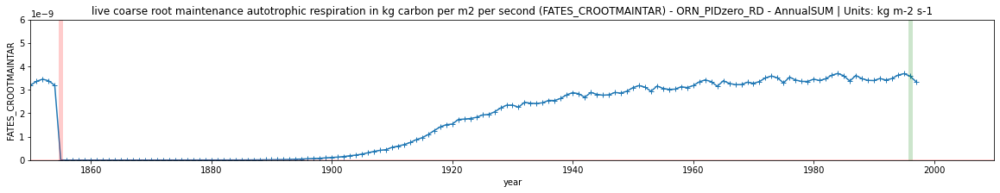

In [49]:
var = "FATES_CROOTMAINTAR"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,6e-9)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
        
ds[key][var].long_name 
# Remarks: 
    

'allocation to coarse roots in kg carbon per m2 per second'

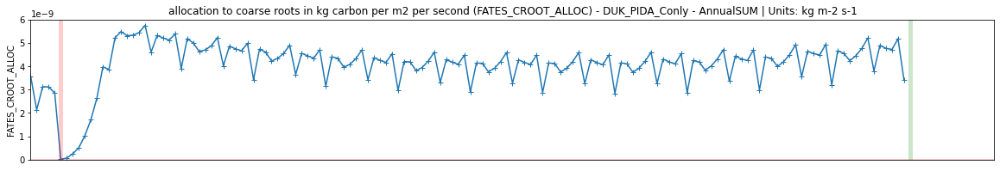

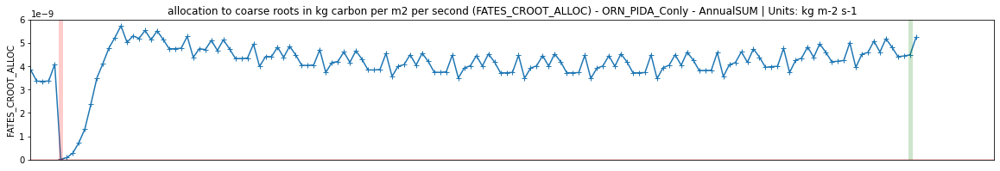

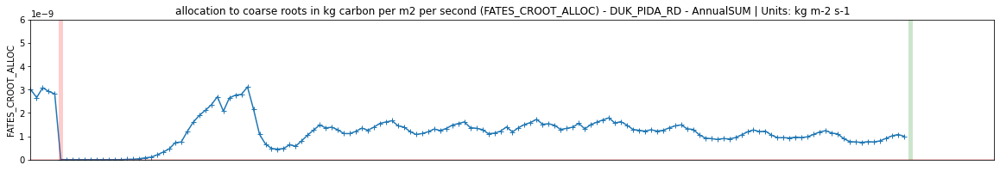

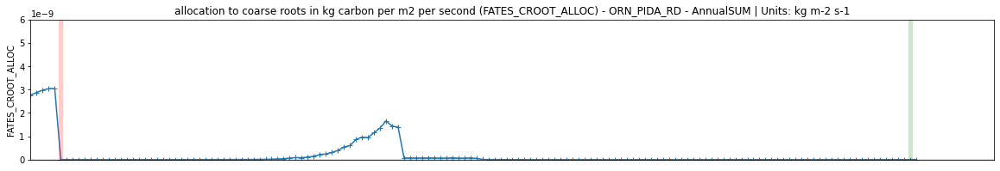

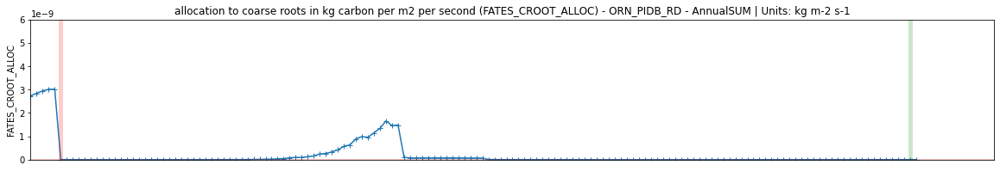

...

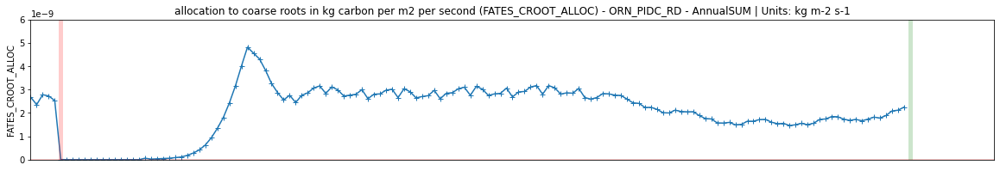

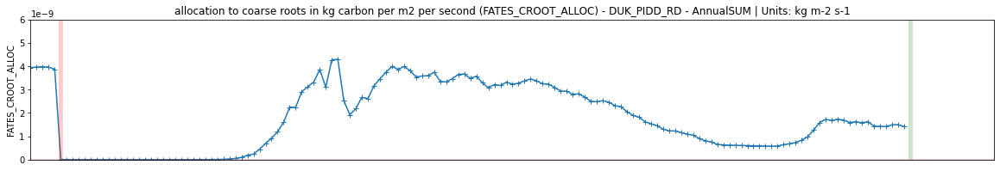

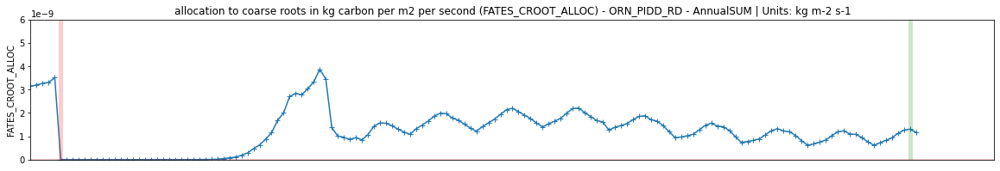

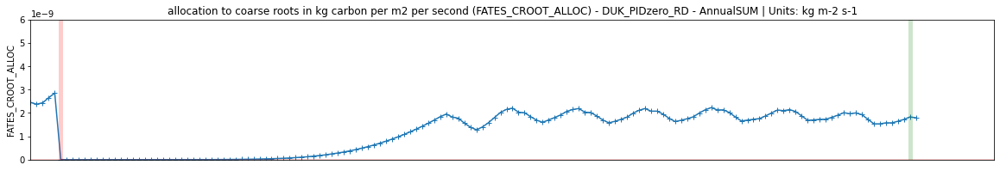

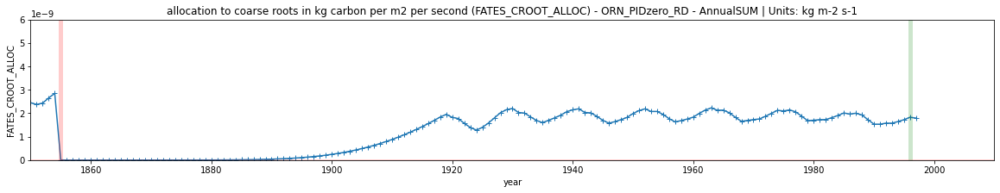

In [50]:
var = "FATES_CROOT_ALLOC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,6e-9)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)

ds[key][var].long_name 
# Remarks: 

'disturbance rate from logging'

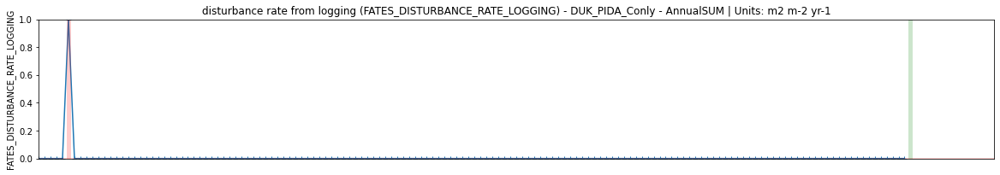

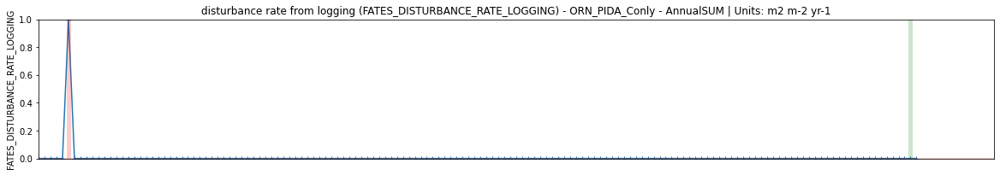

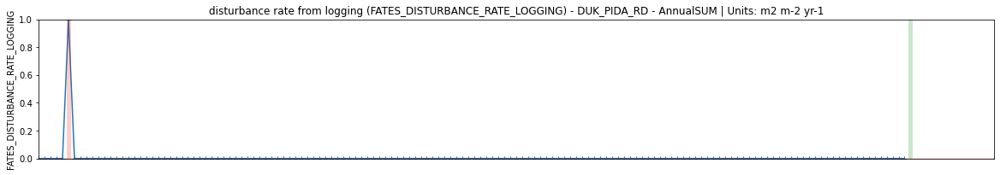

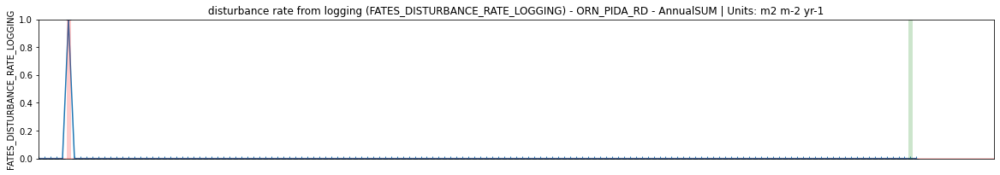

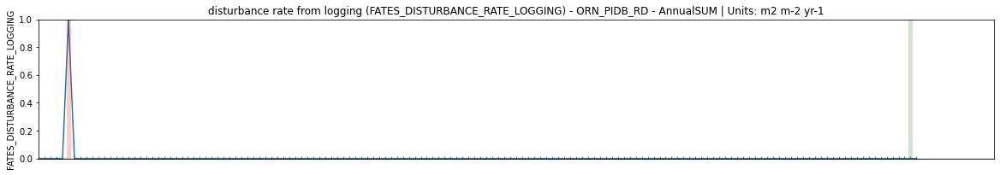

...

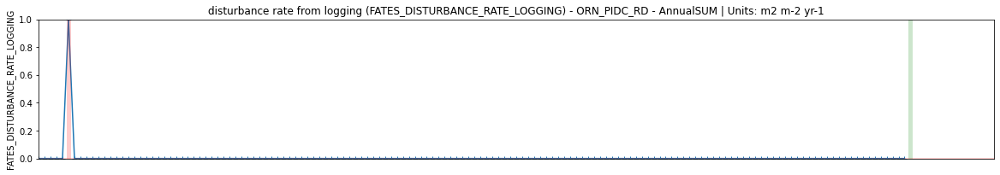

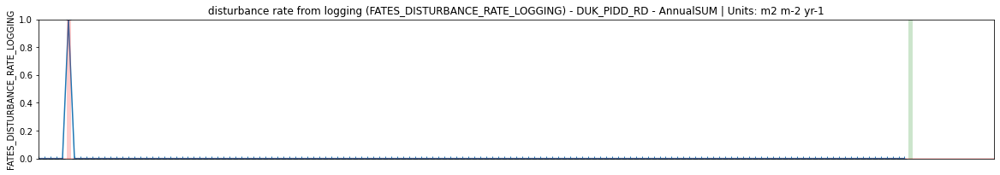

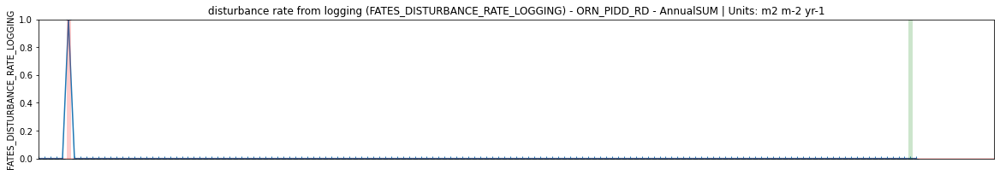

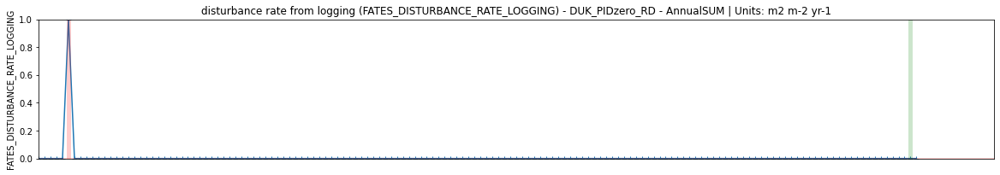

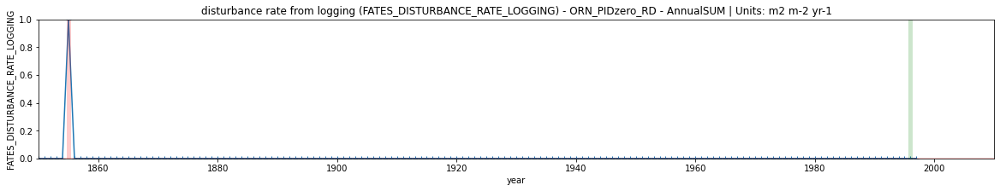

In [51]:
var = "FATES_DISTURBANCE_RATE_LOGGING"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,1)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)

ds[key][var].long_name 
# Remarks: 

'respiration of un-allocatable carbon gain'

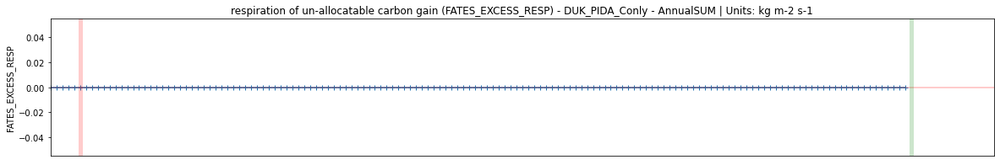

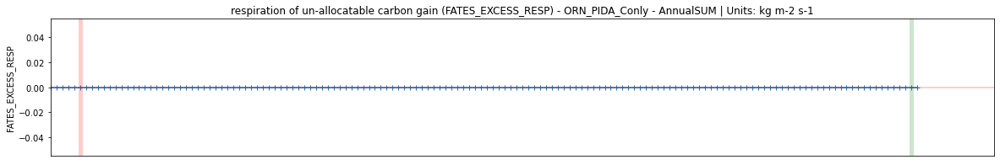

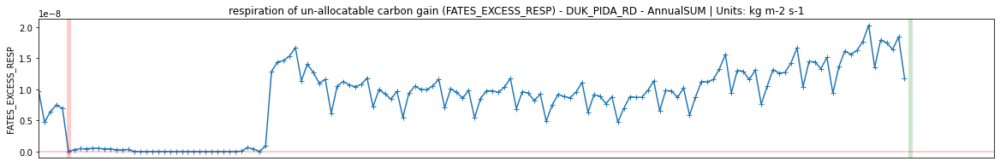

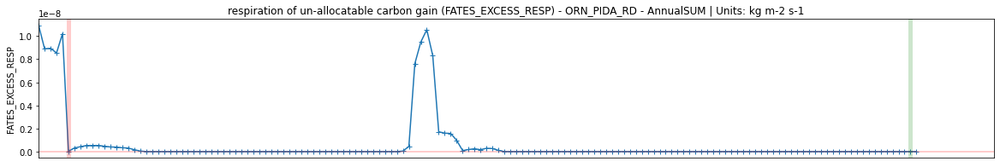

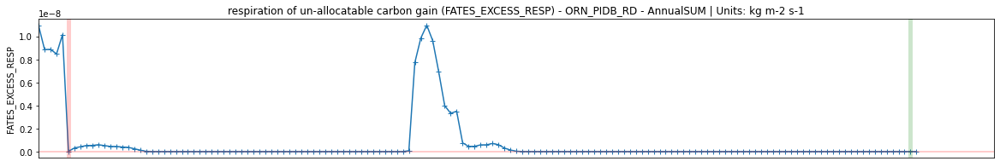

...

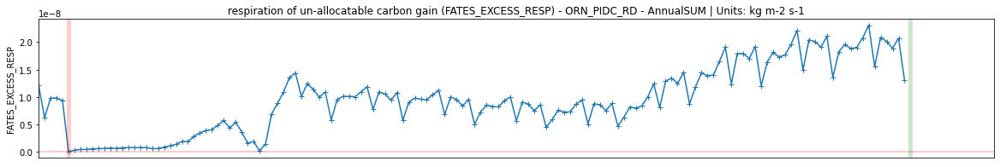

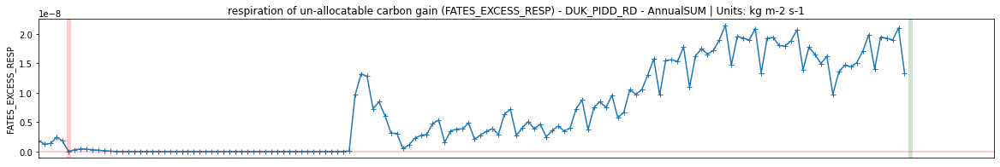

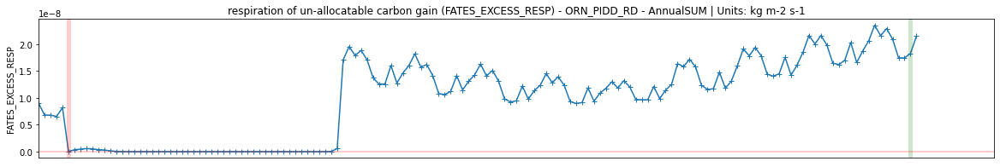

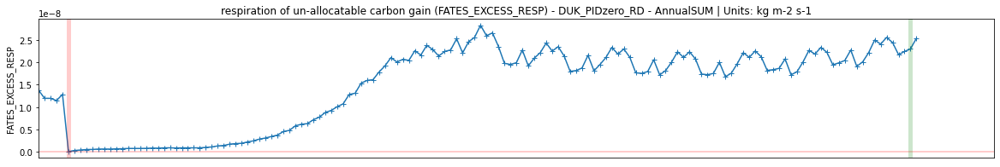

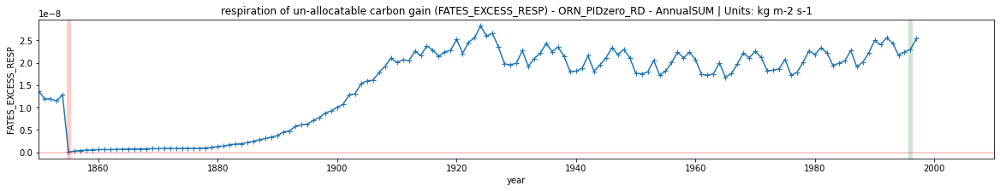

In [52]:
var = "FATES_EXCESS_RESP"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,6e-9)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)

ds[key][var].long_name 
# Remarks: 

'site-level drought status, <2 too dry for leaves, >=2 not too dry'

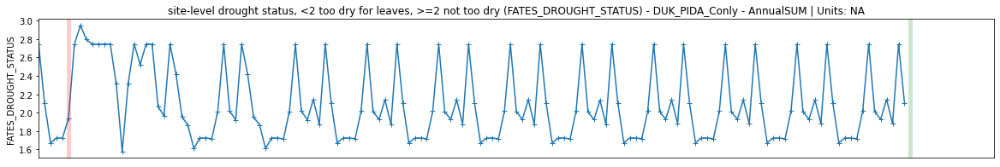

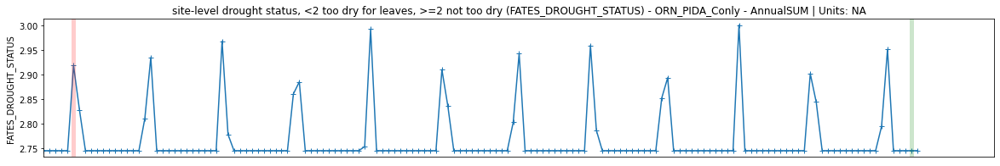

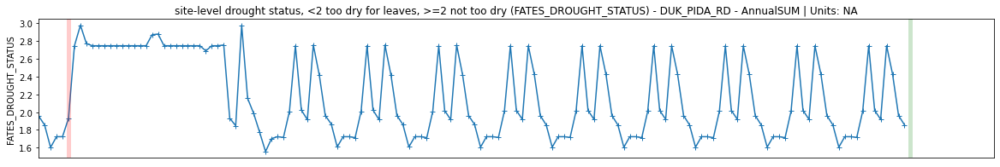

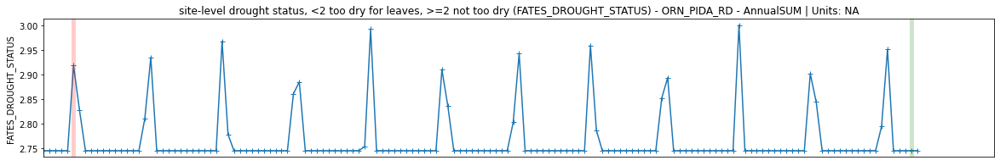

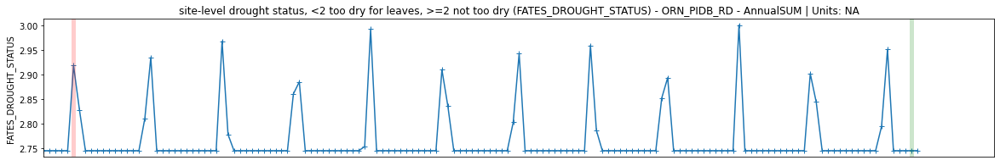

...

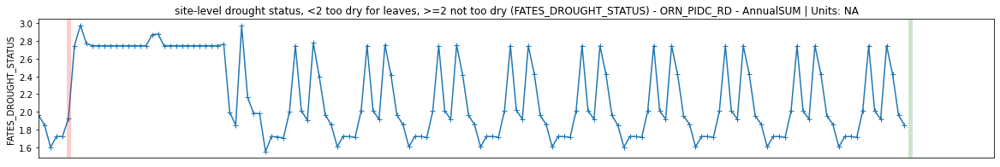

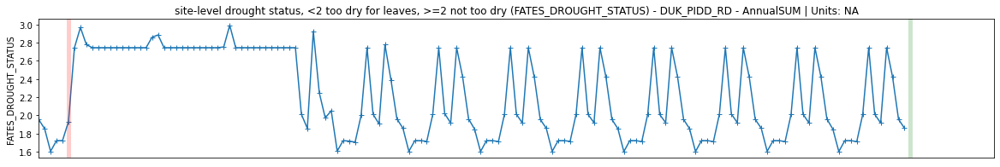

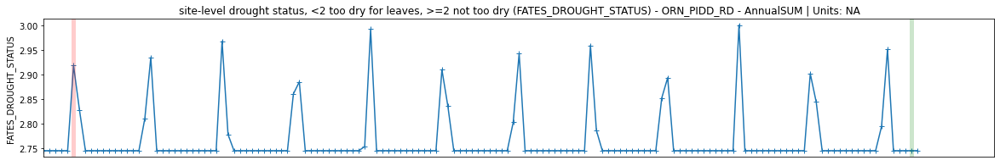

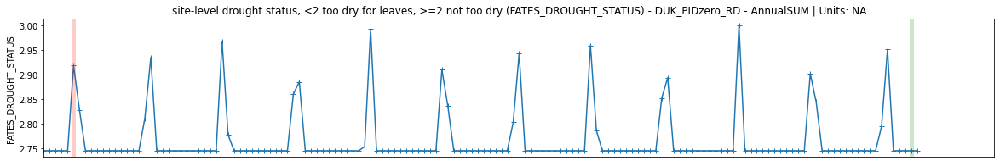

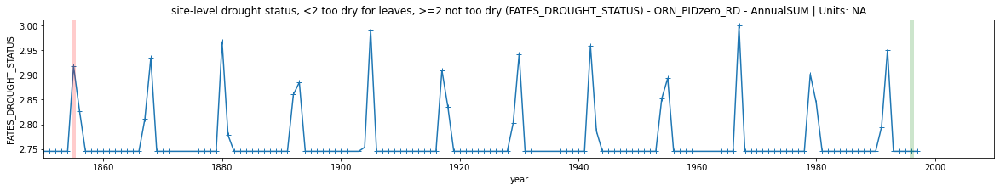

In [53]:
var = "FATES_DROUGHT_STATUS"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: NA")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    #plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,6e-9)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
        
ds[key][var].long_name 
# Remarks: 
    

'fine root maintenance autotrophic respiration in kg carbon per m2 per second'

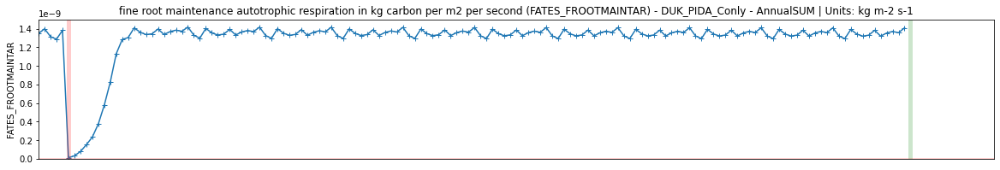

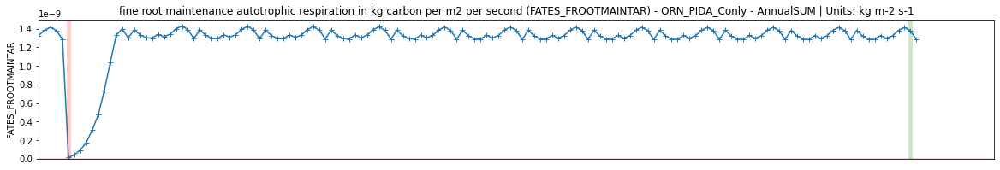

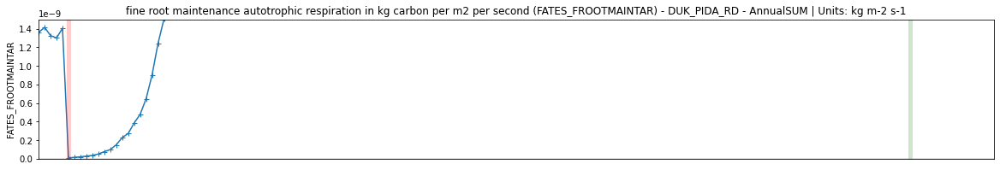

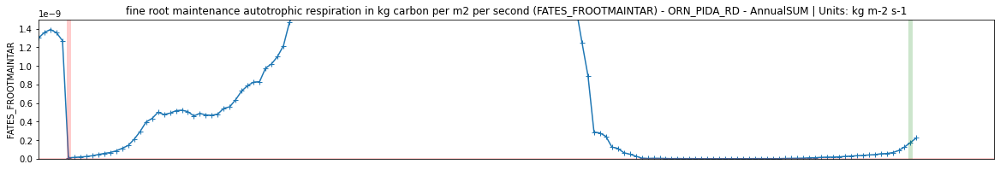

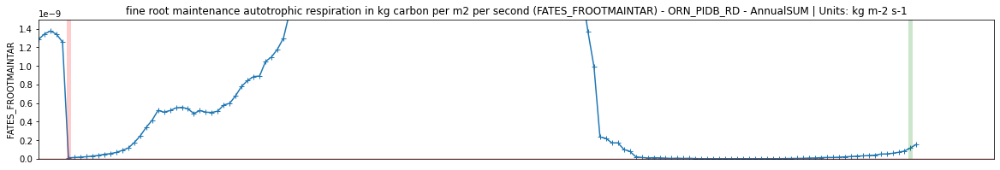

...

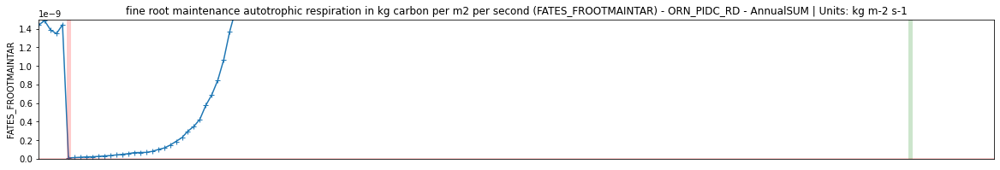

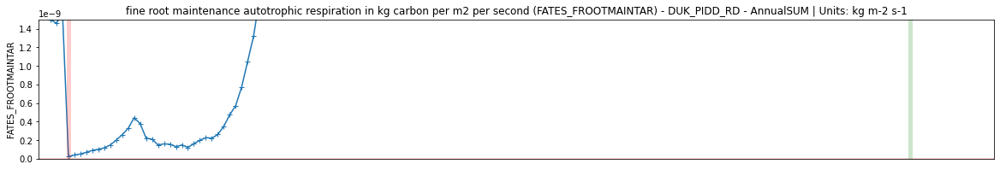

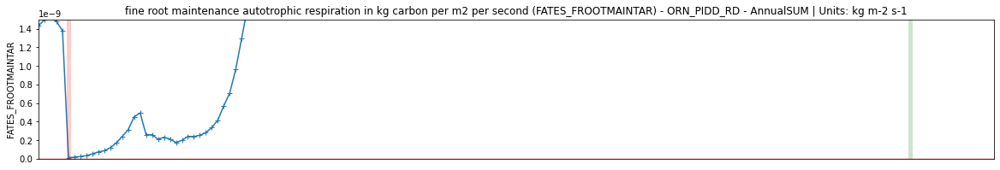

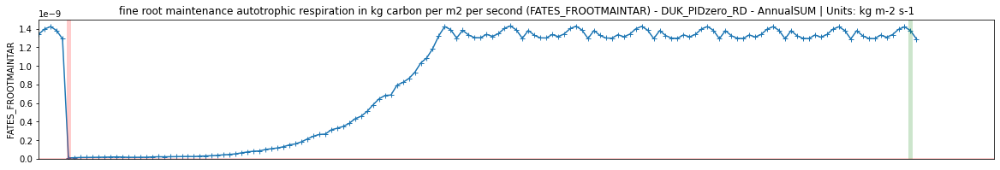

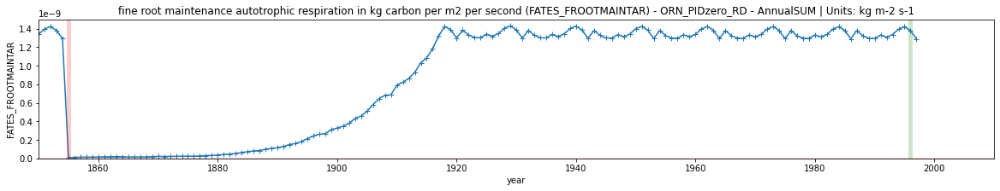

In [54]:
var = "FATES_FROOTMAINTAR"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,1.5e-9)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
    
ds[key][var].long_name 
# Remarks: 

'allocation to fine roots in kg carbon per m2 per second'

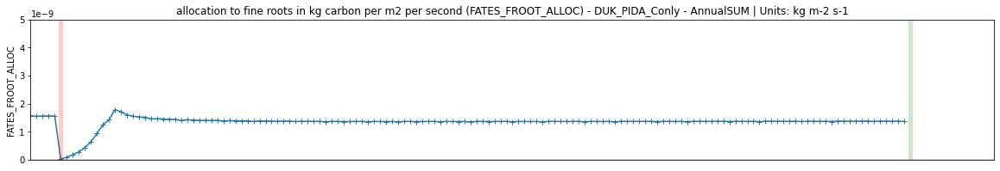

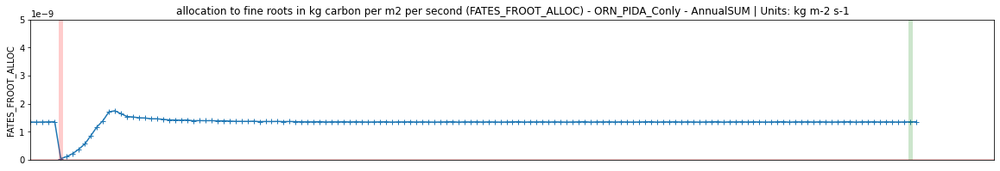

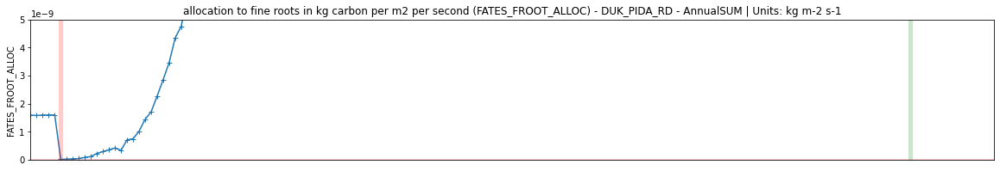

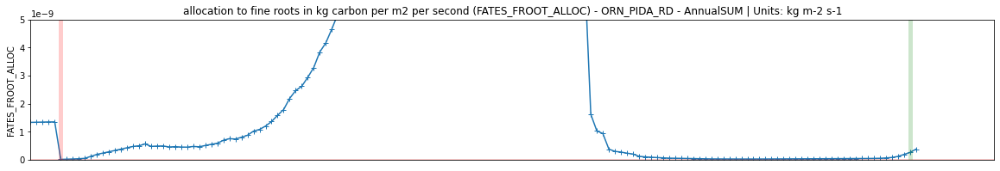

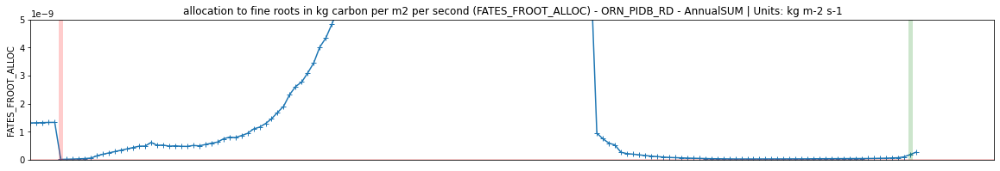

...

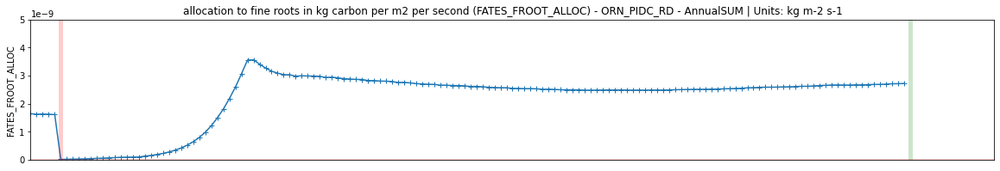

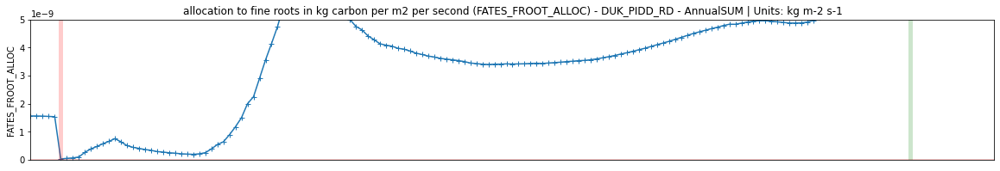

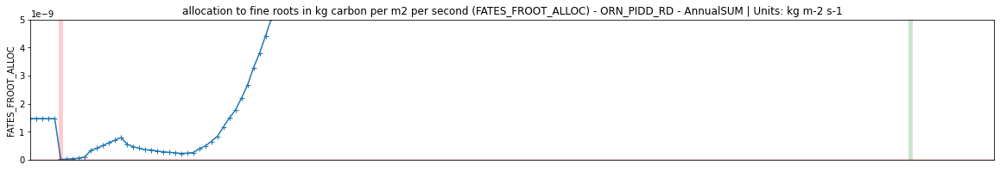

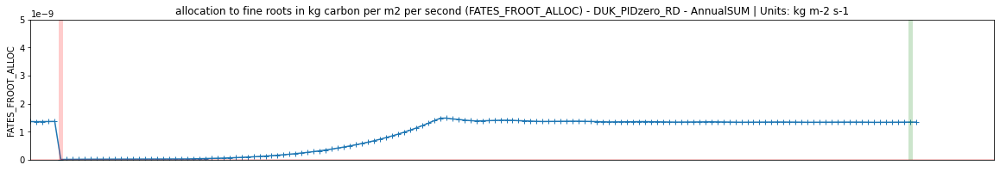

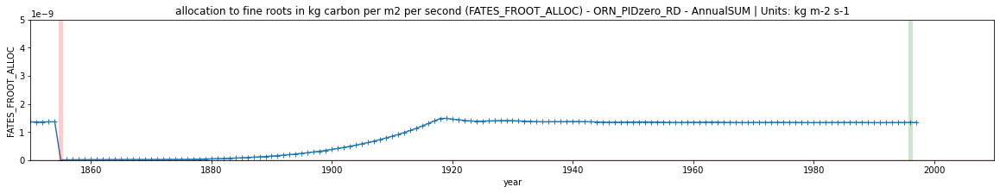

In [55]:
var = "FATES_FROOT_ALLOC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,5e-9)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)

ds[key][var].long_name 
# Remarks: 
    

'site-level growing degree days'

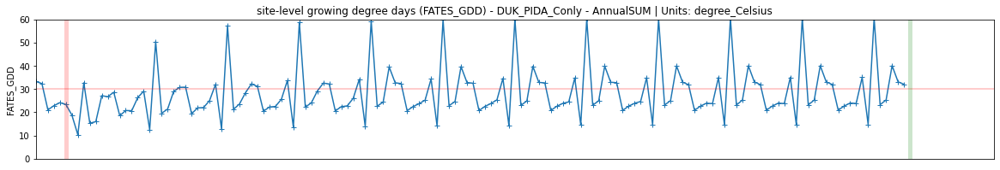

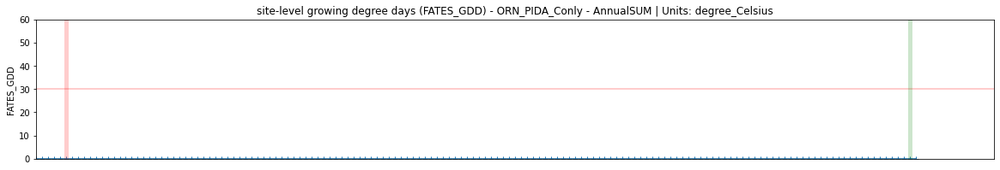

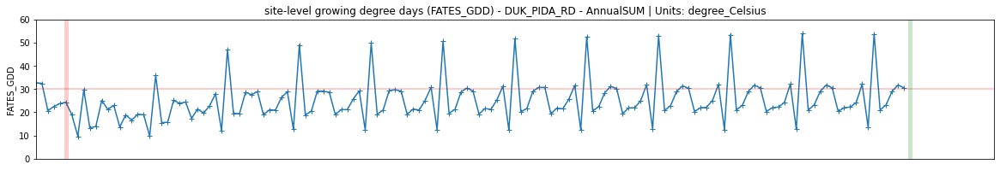

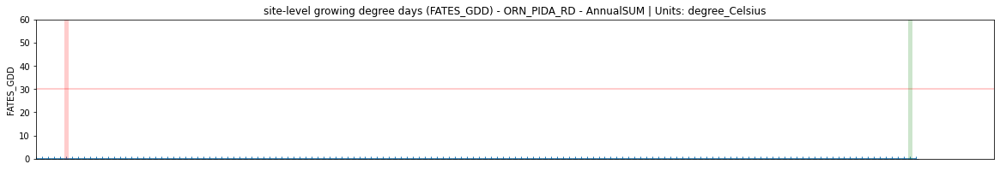

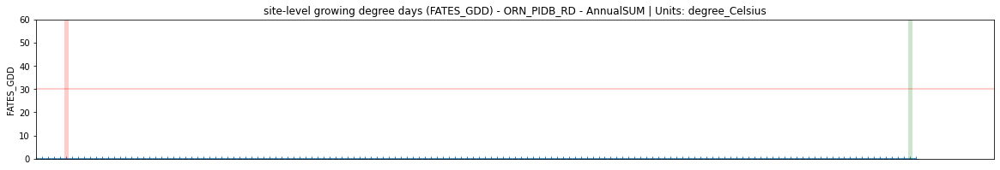

...

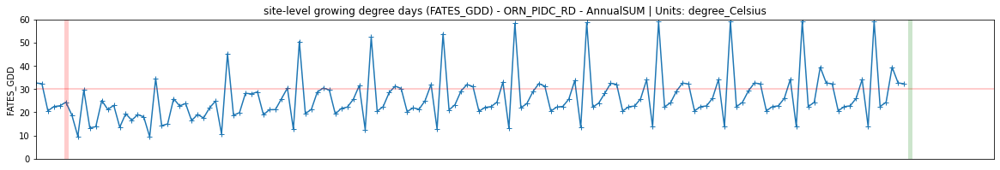

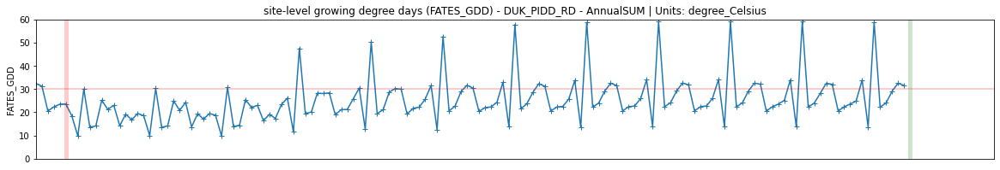

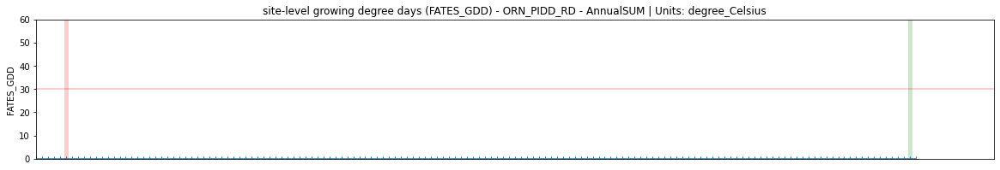

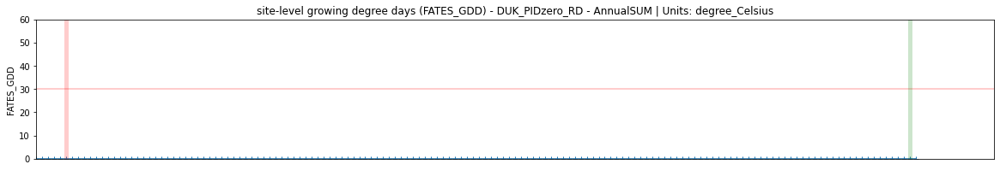

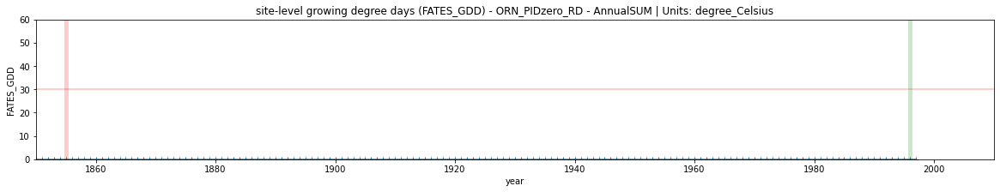

In [56]:
var = "FATES_GDD"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 30, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,60)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)

ds[key][var].long_name 
# Remarks: 

'gross primary production in kg carbon per m2 per second'

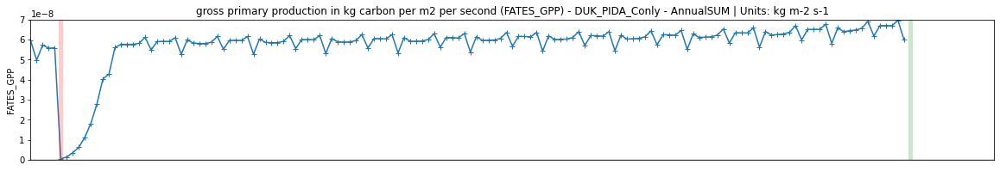

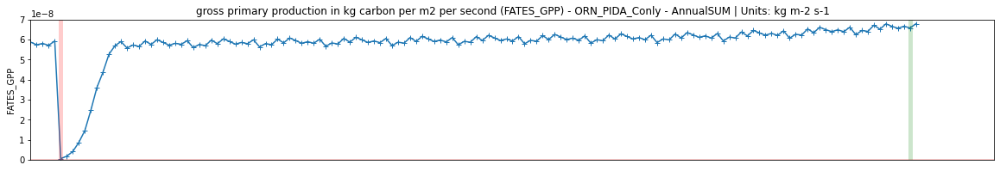

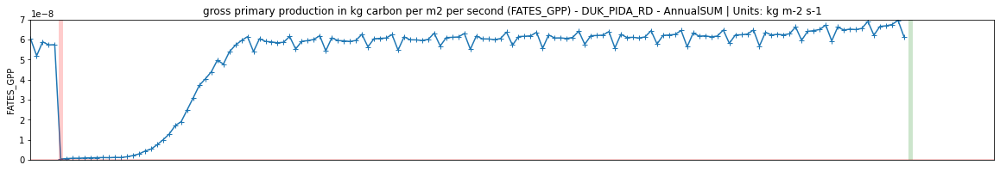

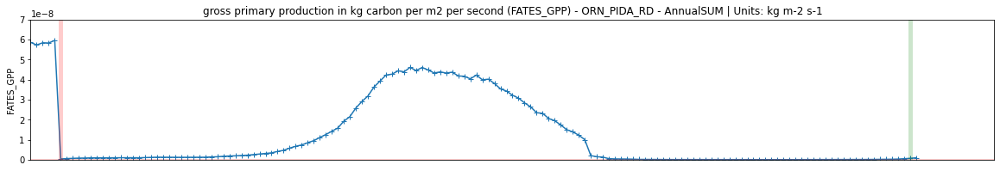

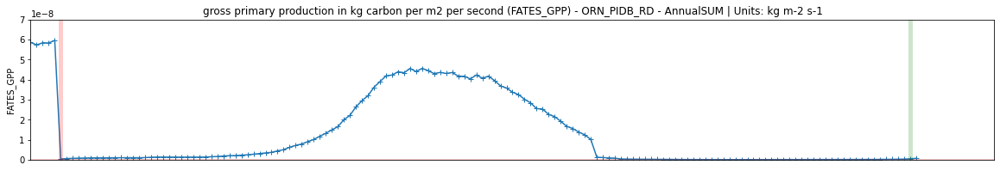

...

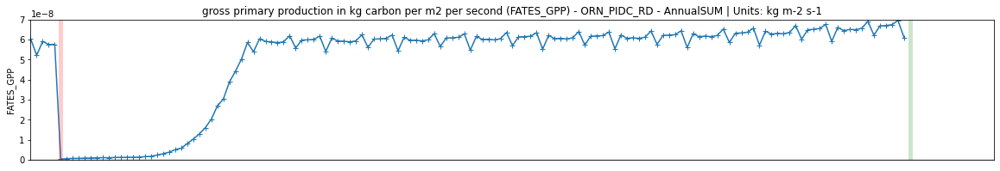

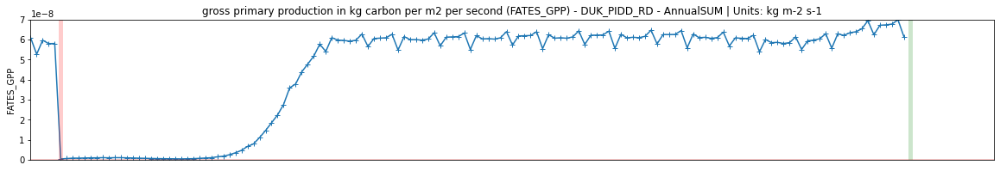

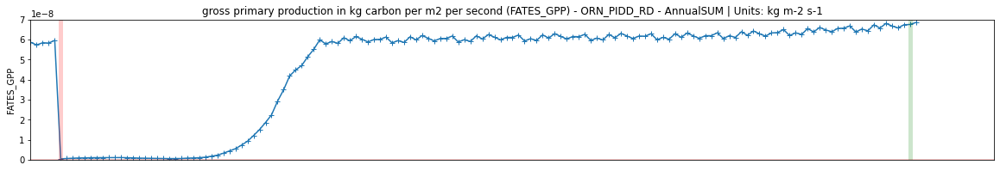

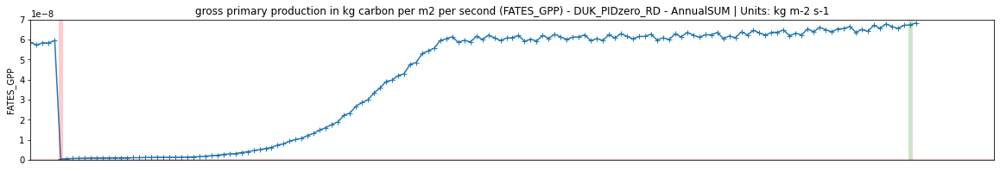

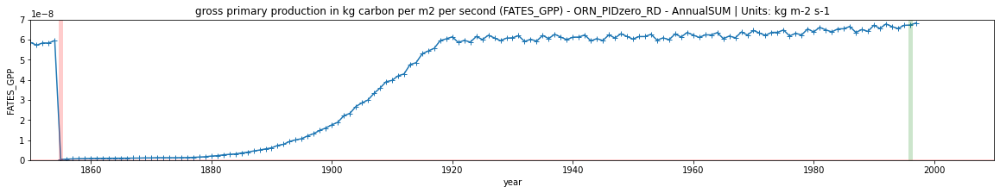

In [57]:
var = "FATES_GPP"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,7e-8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
        
ds[key][var].long_name 
# Remarks: 

'harvest carbon flux in kg carbon per m2 per year'

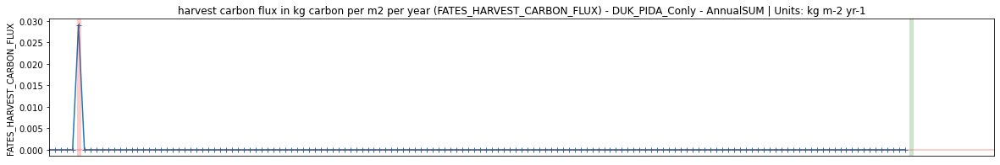

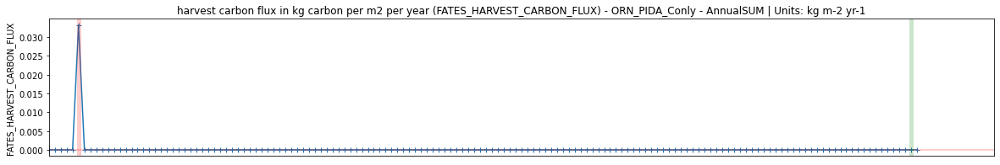

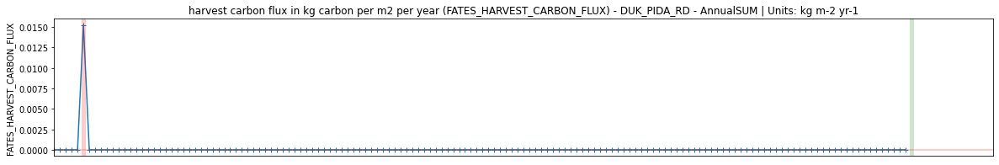

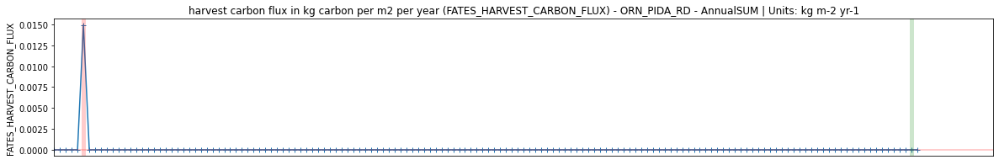

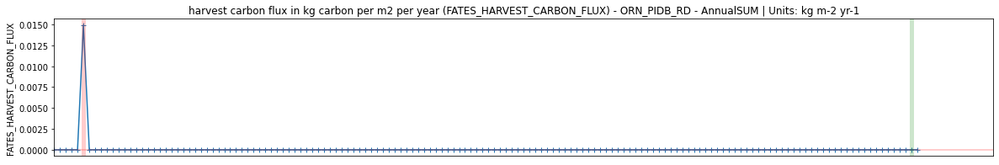

...

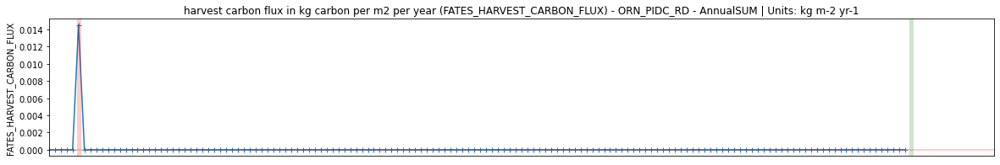

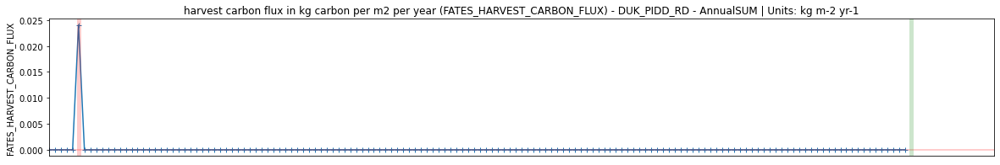

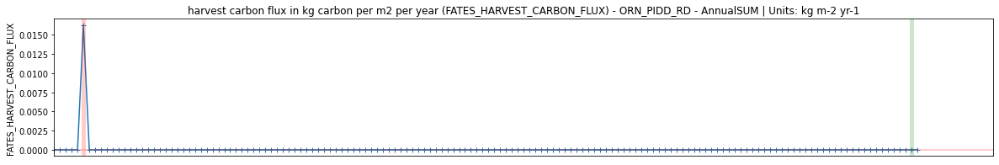

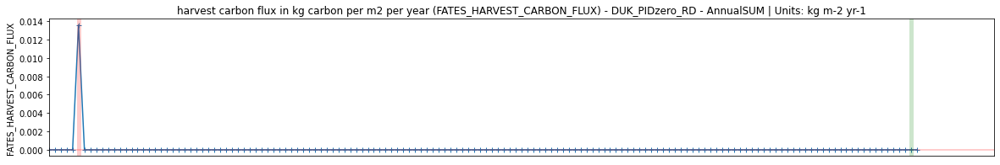

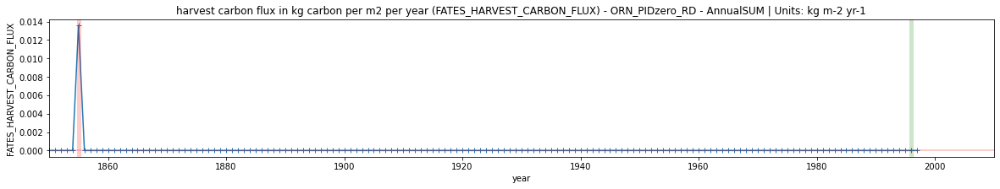

In [58]:
var = "FATES_HARVEST_CARBON_FLUX"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,7e-8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)

        
ds[key][var].long_name 
# Remarks:     

'heterotrophic respiration in kg carbon per m2 per second'

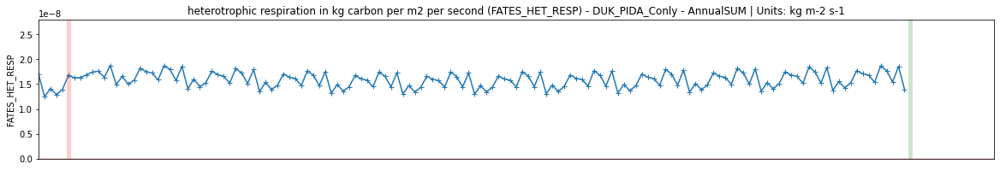

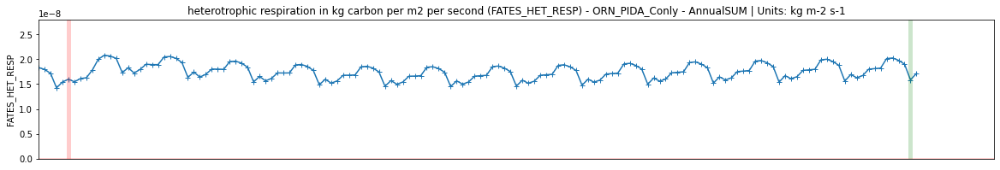

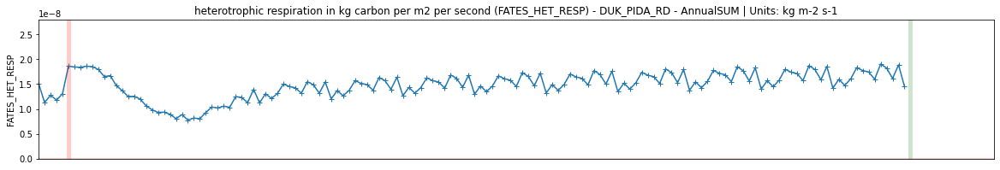

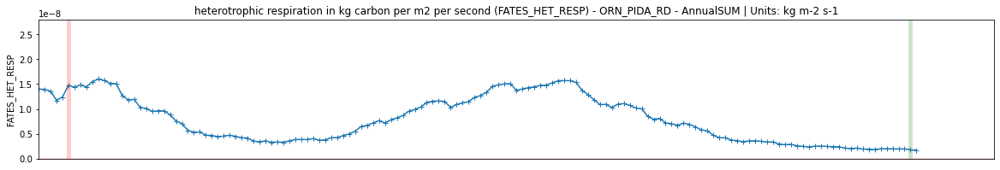

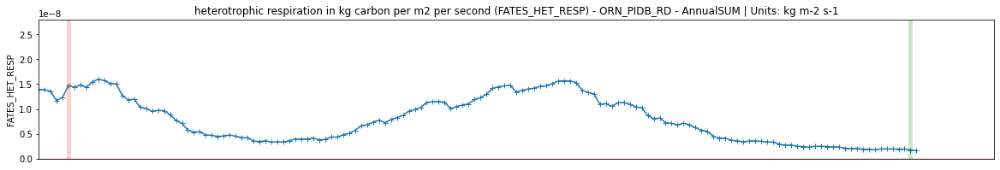

...

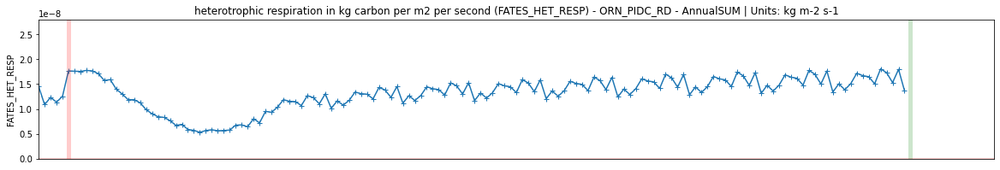

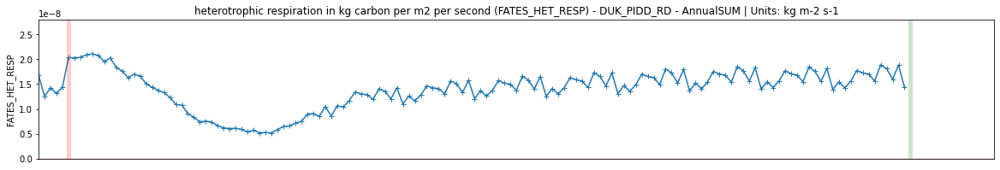

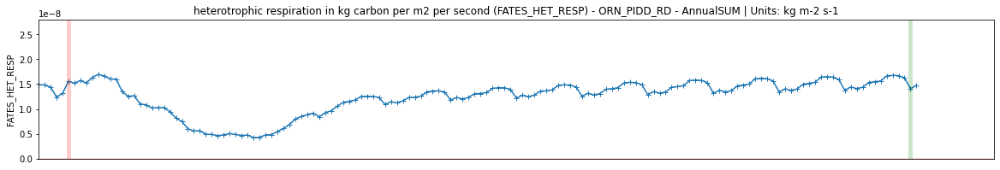

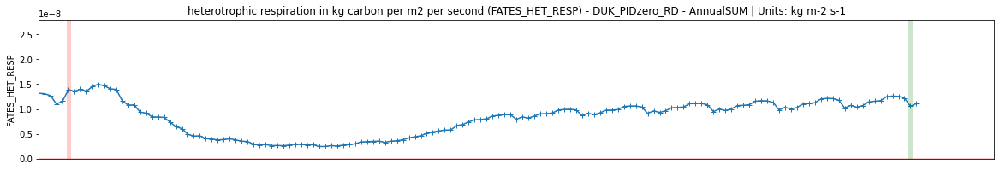

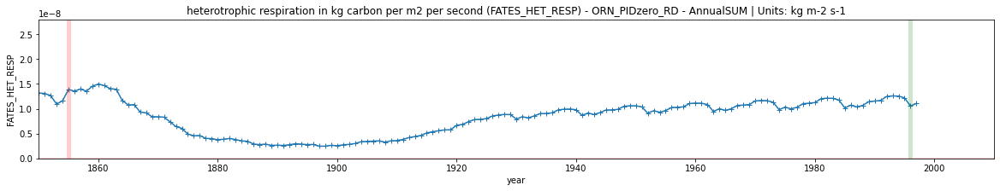

In [59]:
var = "FATES_HET_RESP"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,2.8e-8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 
# Remarks: Does this tells us that the microbes in soil live and flurish after logging (ECA). Slowly decline in aCO2 and eCO2. due to less litter?

'mean leaf boundary layer conductance'

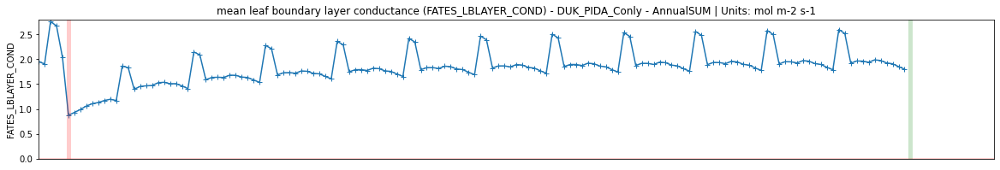

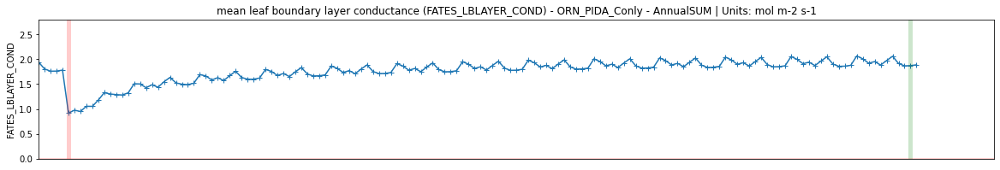

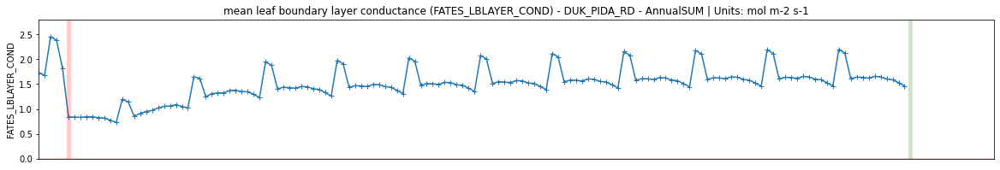

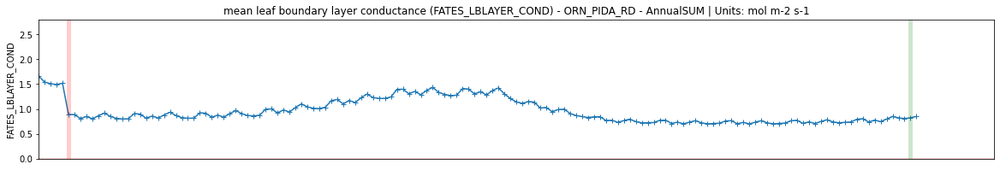

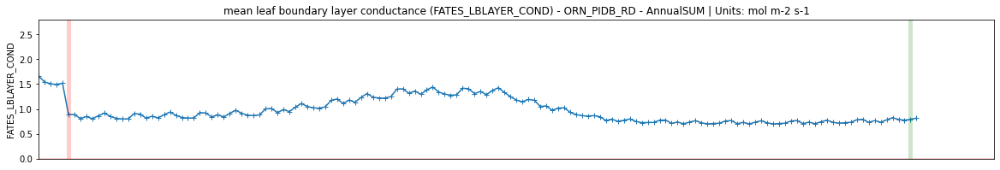

...

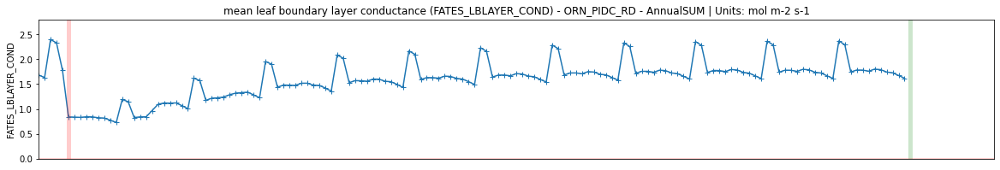

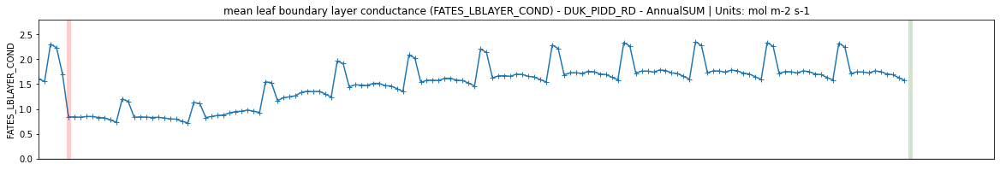

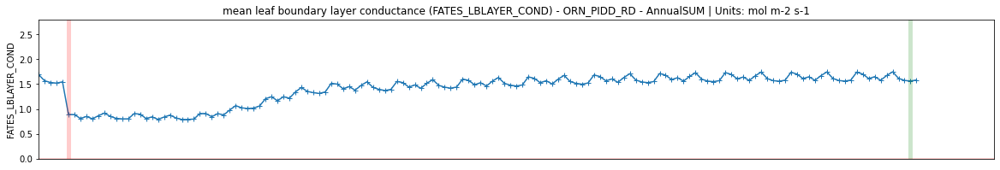

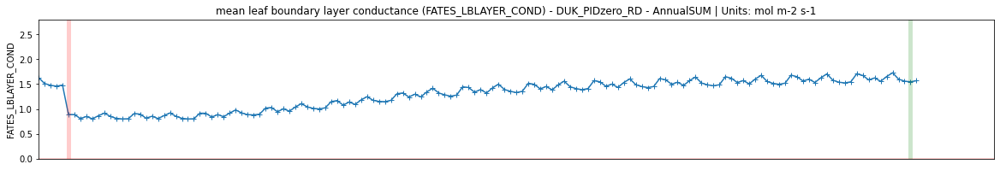

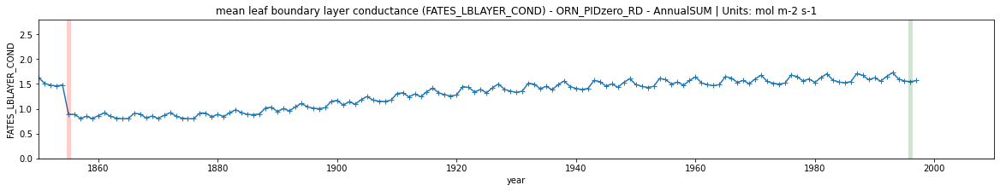

In [60]:
var = "FATES_LBLAYER_COND"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,2.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'allocation to leaves in kg carbon per m2 per second'

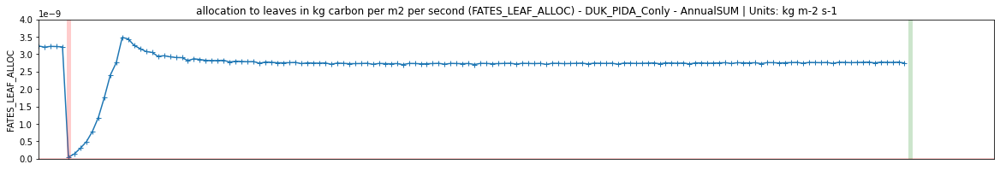

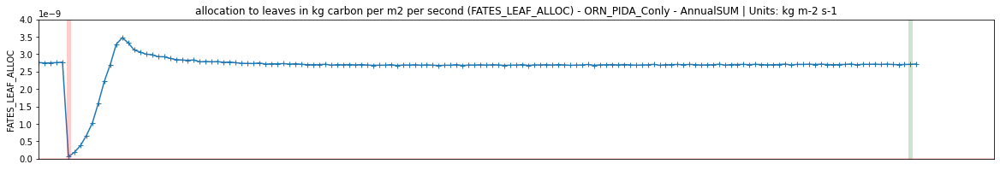

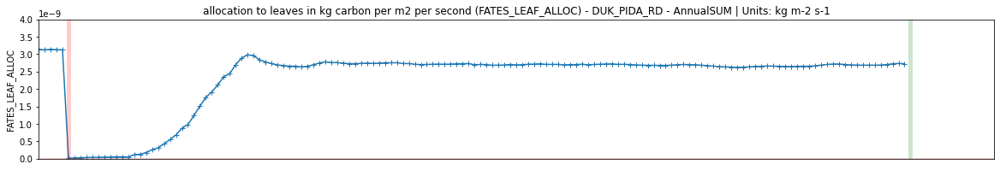

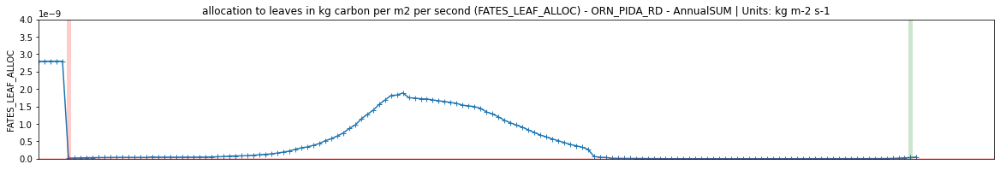

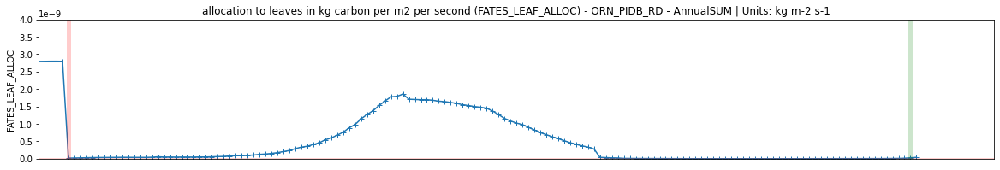

...

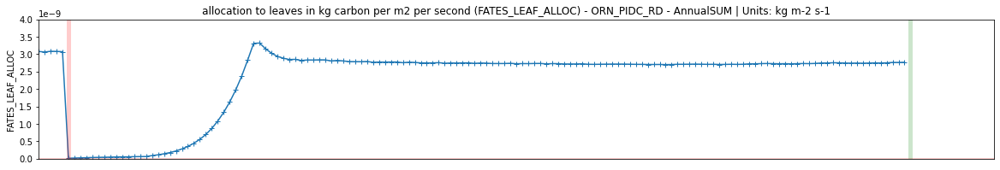

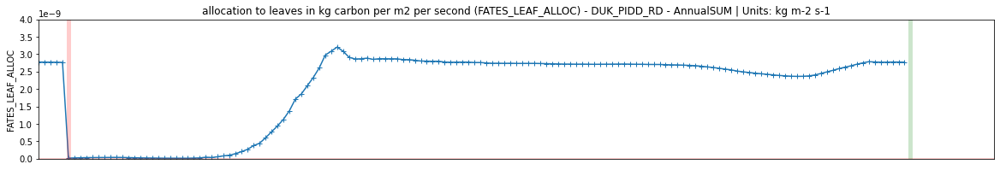

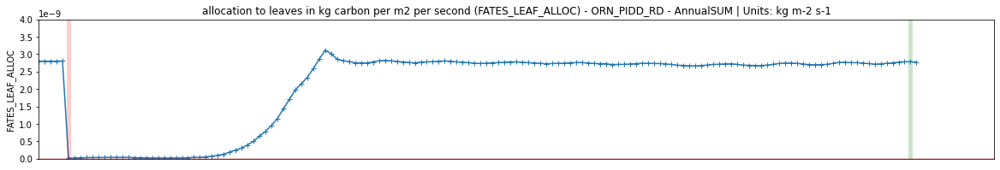

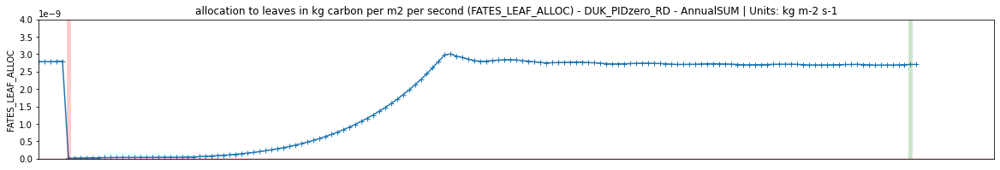

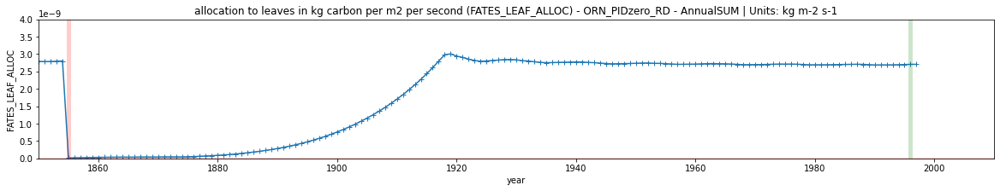

In [61]:
var = "FATES_LEAF_ALLOC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,4e-9)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'litter flux in kg carbon per m2 per second'

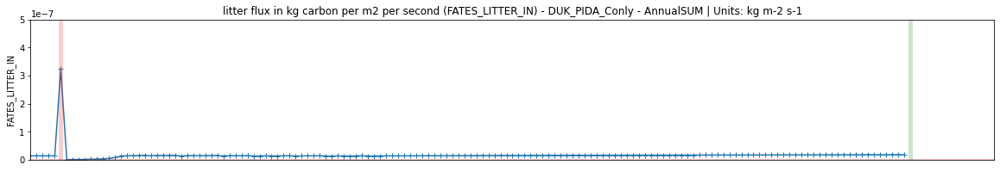

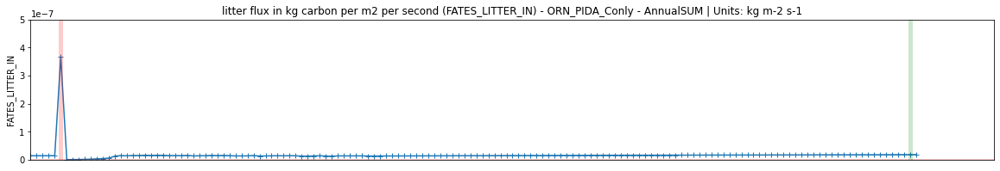

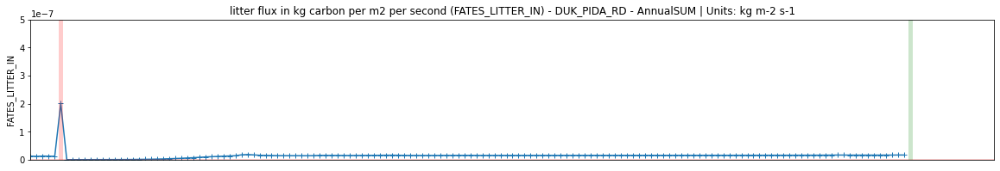

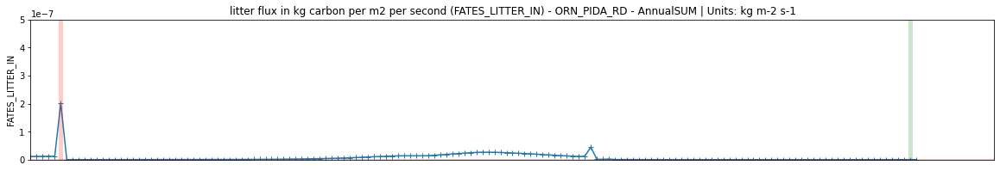

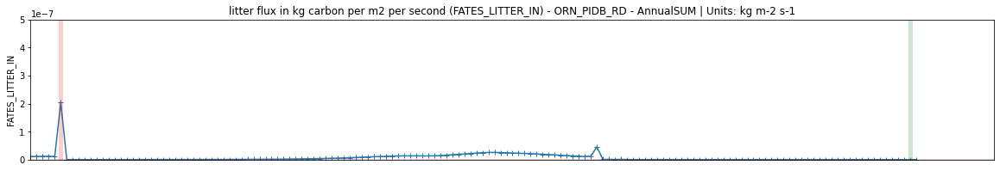

...

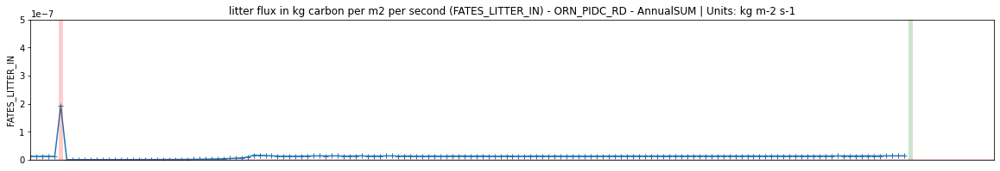

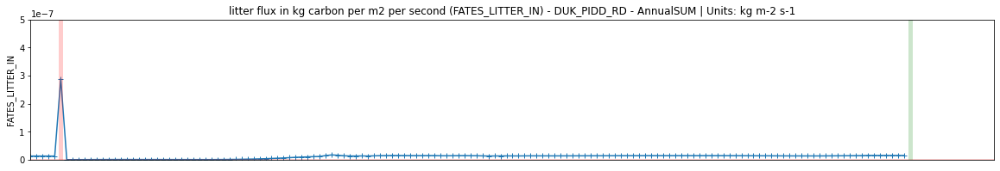

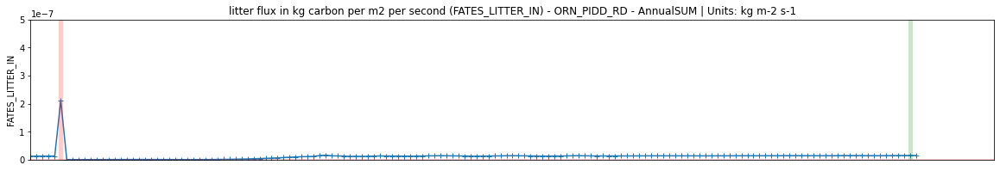

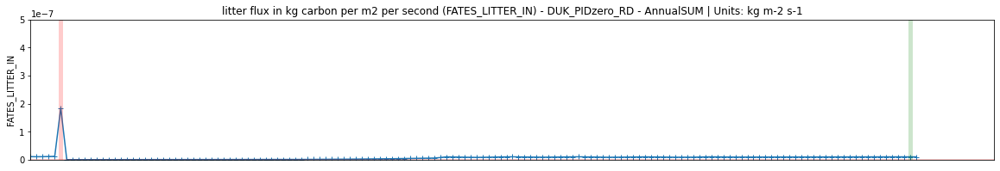

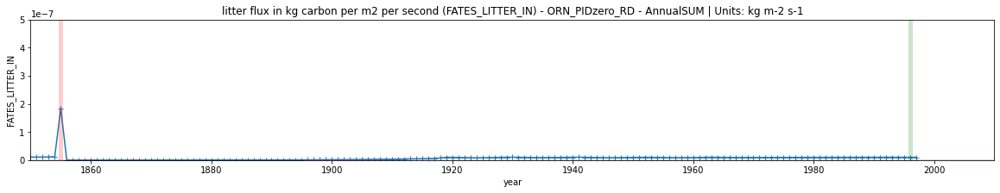

In [62]:

var = "FATES_LITTER_IN"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,5e-7)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'litter flux out in kg carbon (exudation, fragmentation, seed decay)'

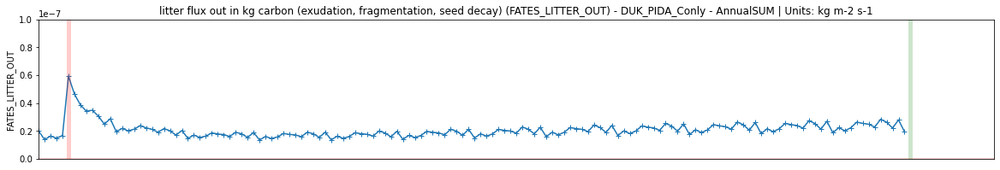

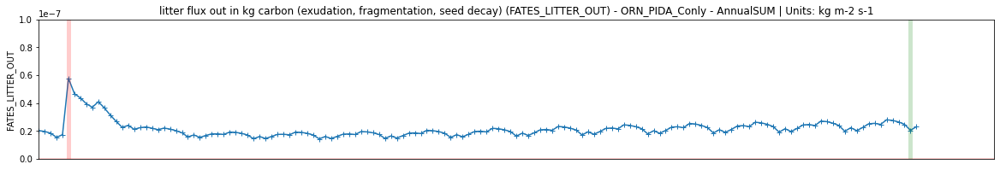

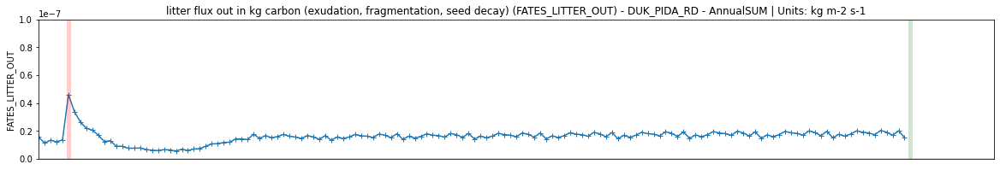

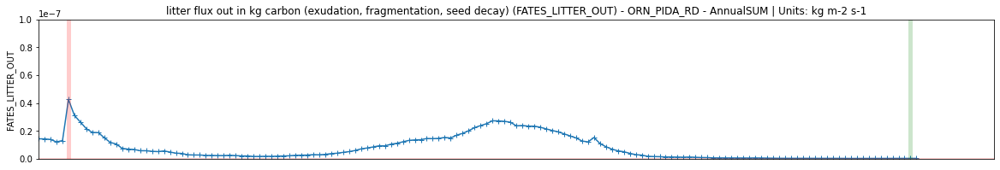

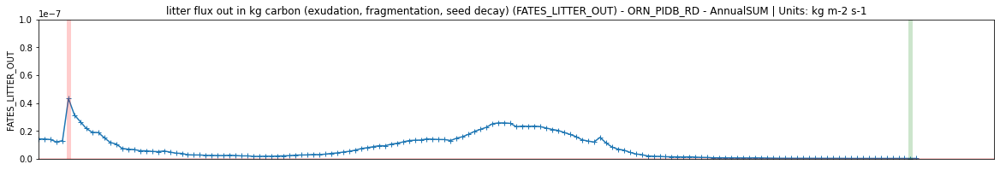

...

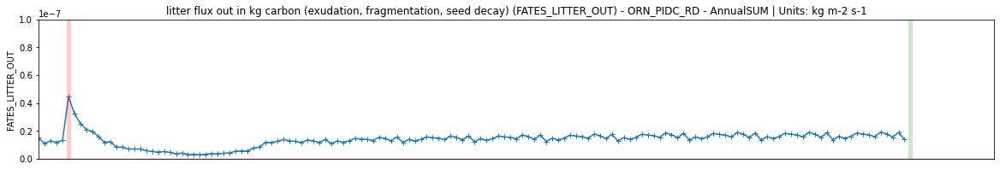

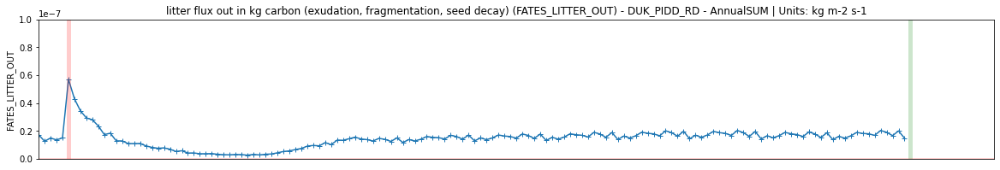

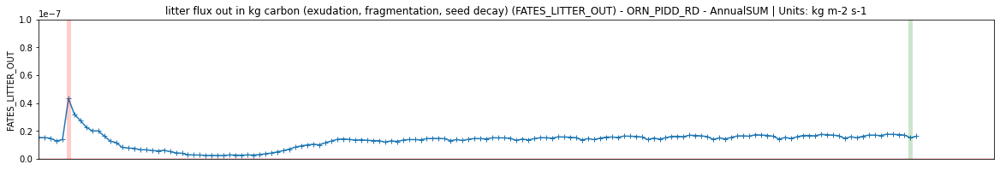

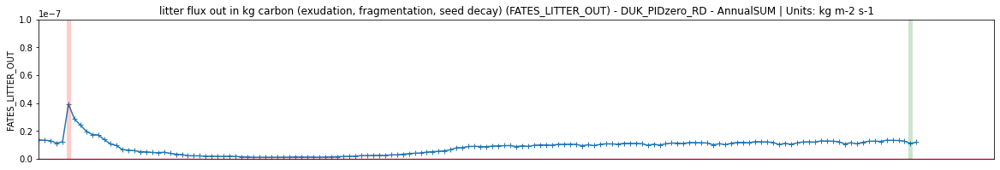

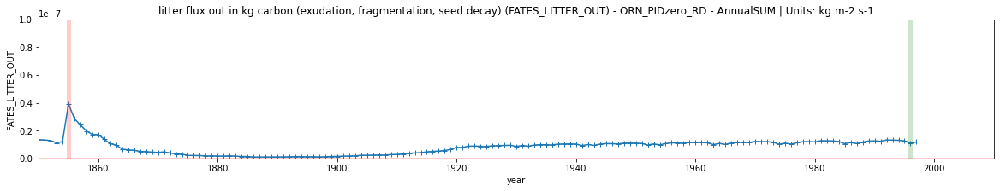

In [63]:

var = "FATES_LITTER_OUT"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,1e-7)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks:  

'net ecosystem production in kg carbon per m2 per second'

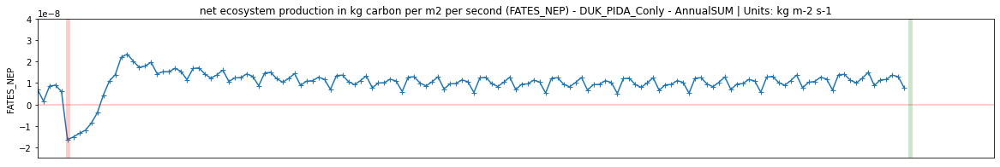

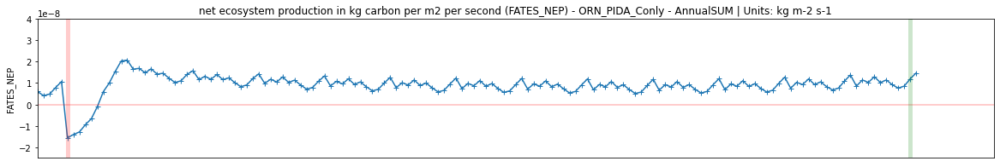

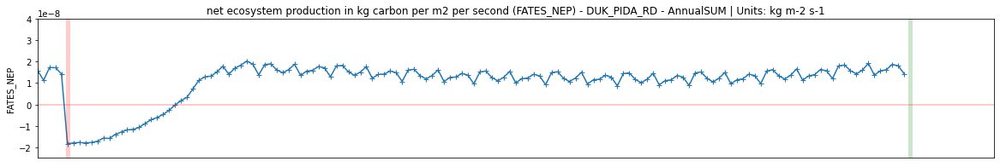

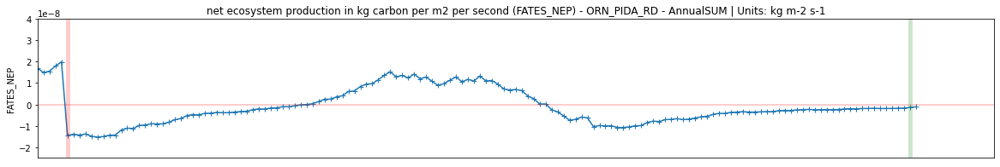

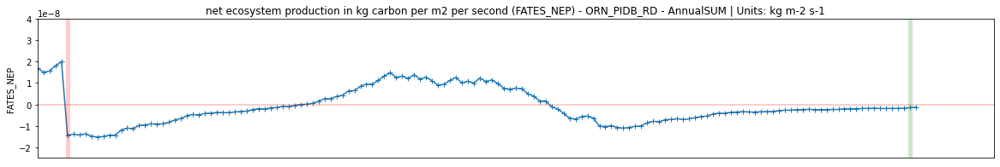

...

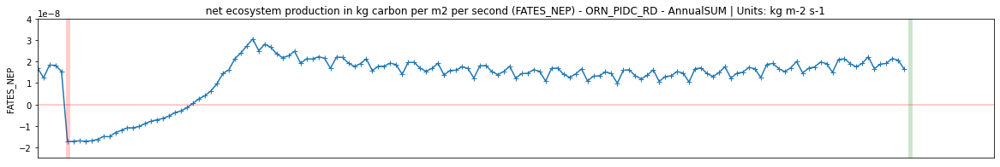

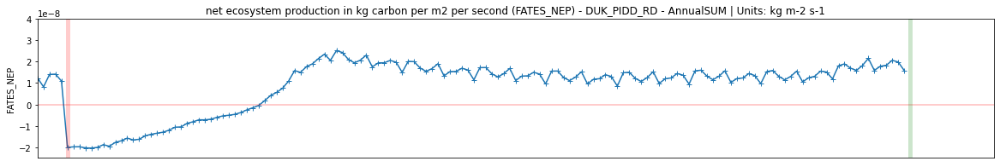

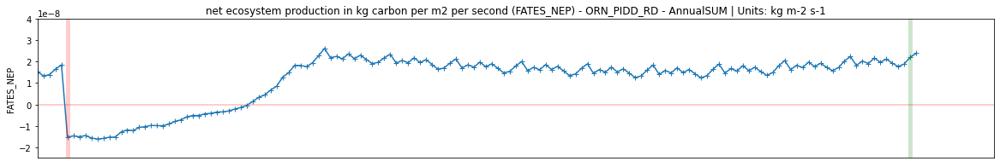

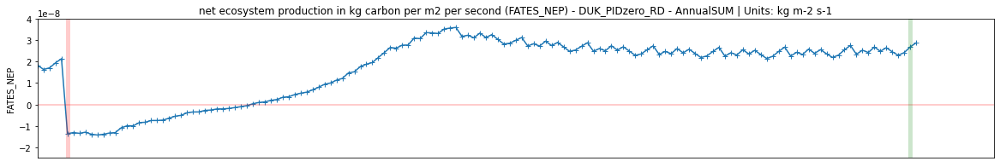

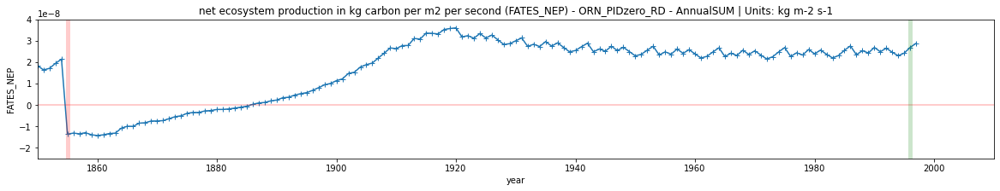

In [64]:

var = "FATES_NEP"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(-2.5e-8,4e-8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'net primary production in kg carbon per m2 per second'

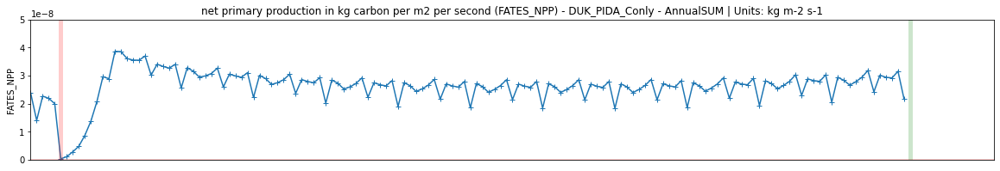

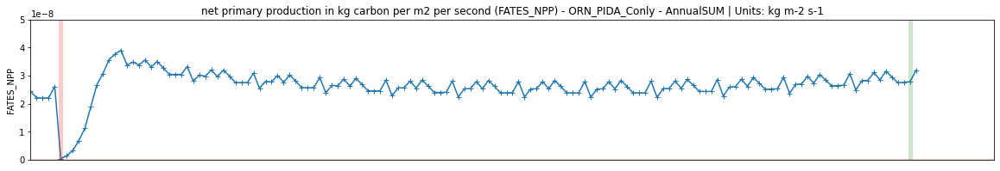

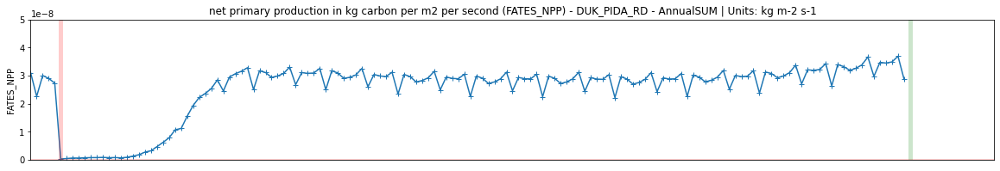

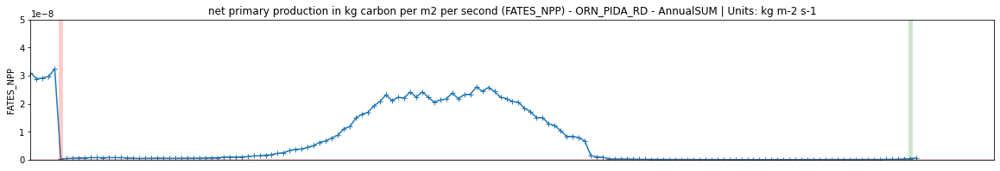

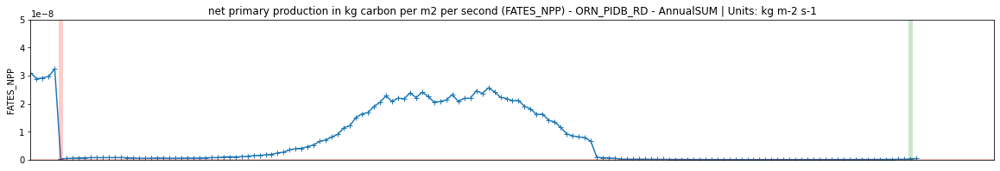

...

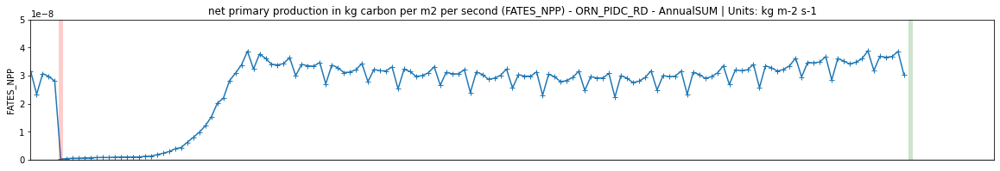

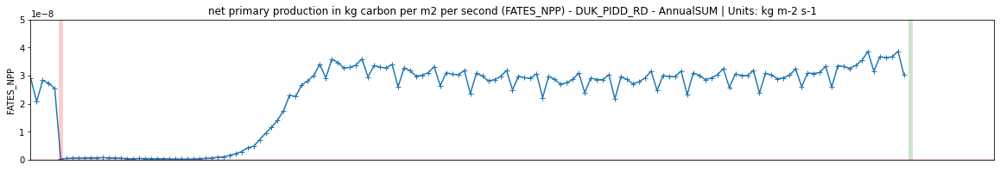

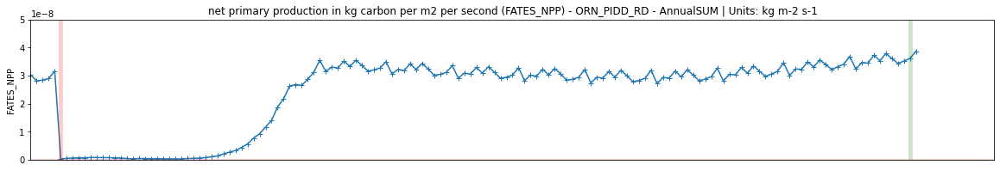

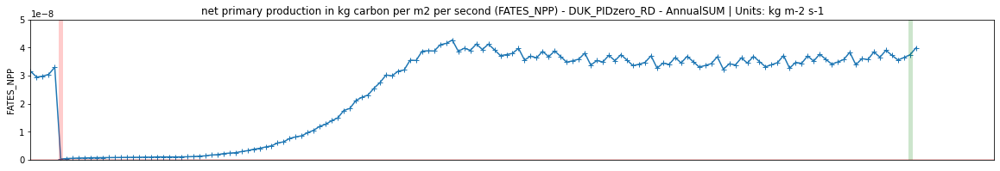

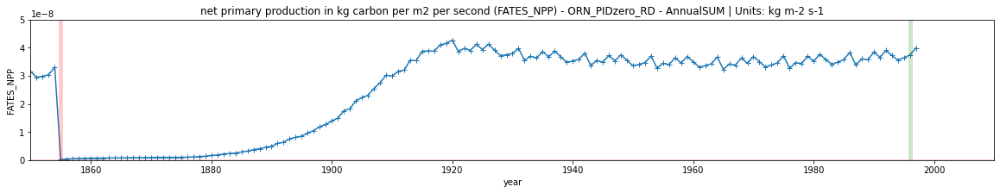

In [65]:

var = "FATES_NPP"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,5e-8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'allocation to stem in kg carbon per m2 per second'

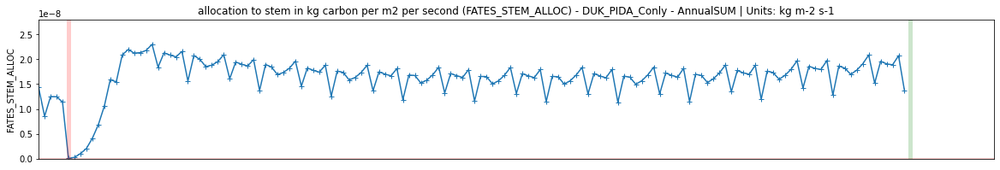

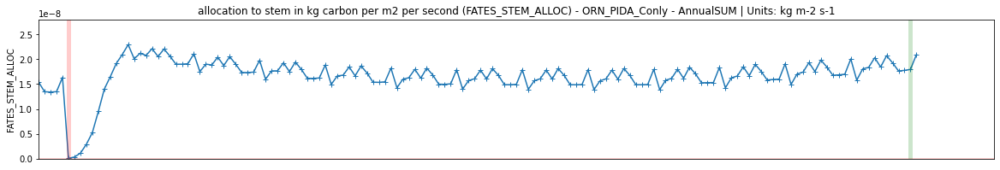

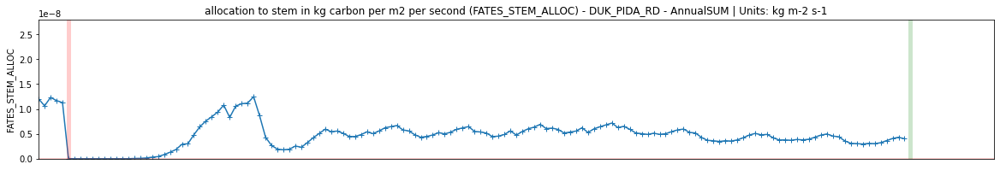

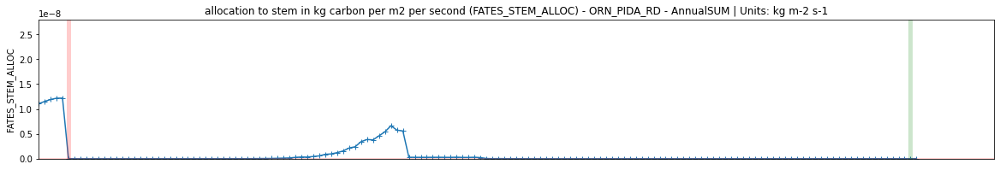

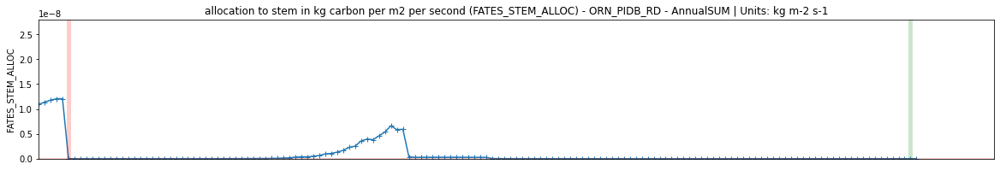

...

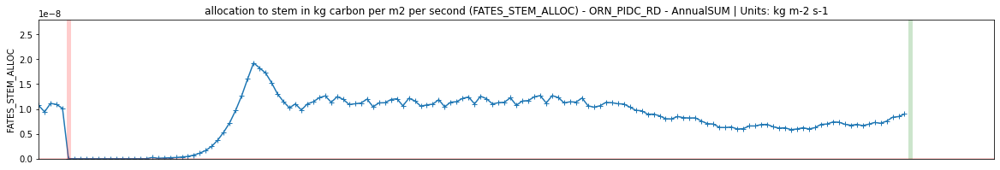

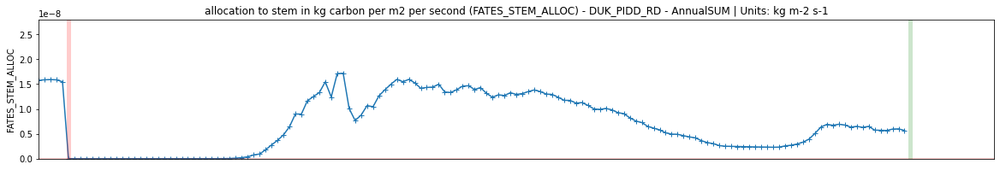

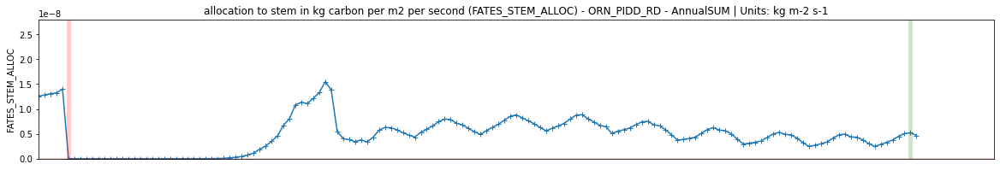

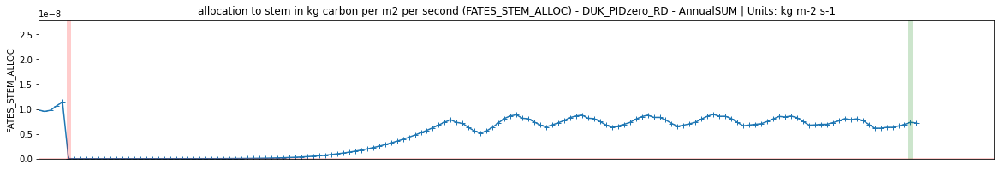

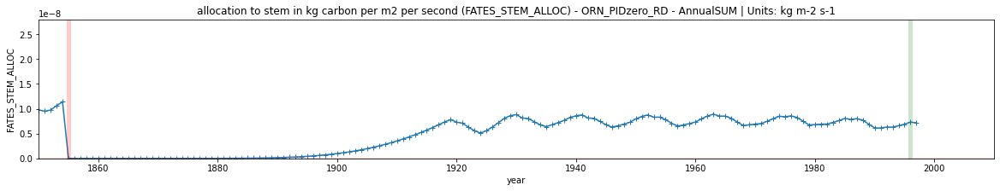

In [66]:

var = "FATES_STEM_ALLOC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,2.8e-8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks:  

'mean stomatal conductance'

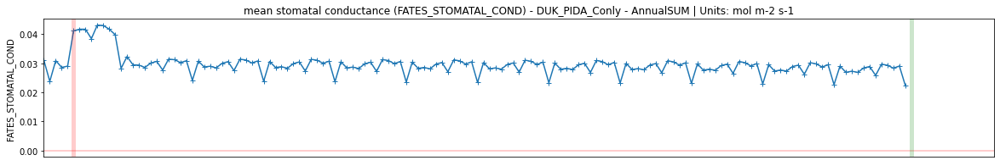

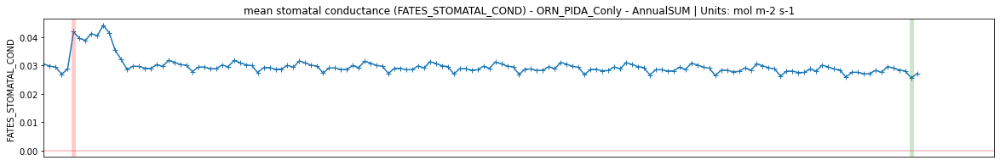

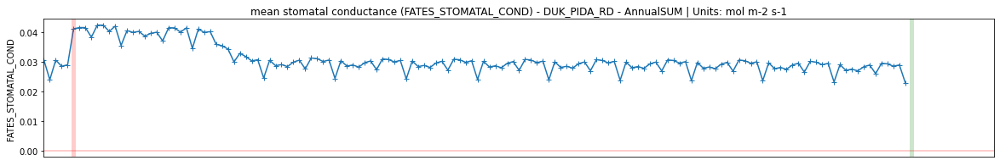

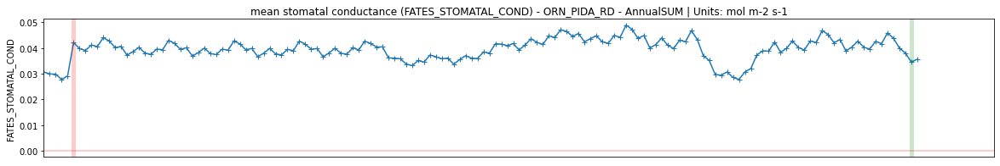

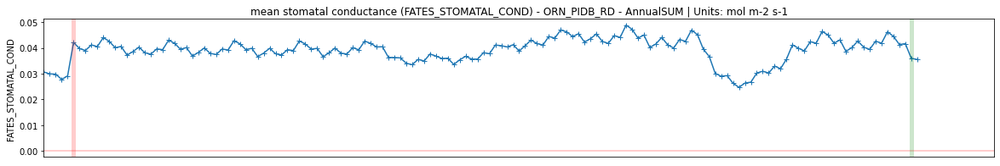

...

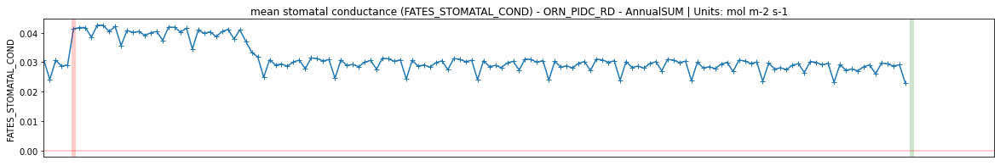

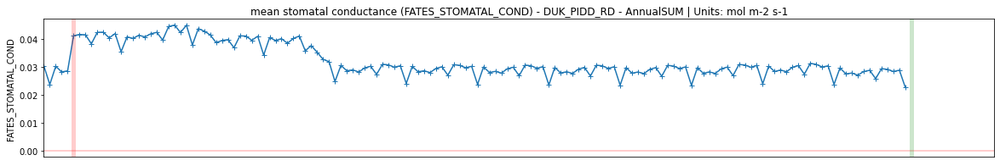

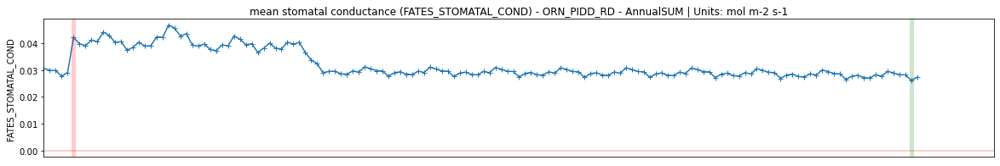

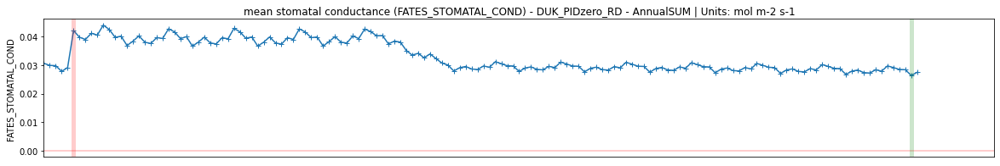

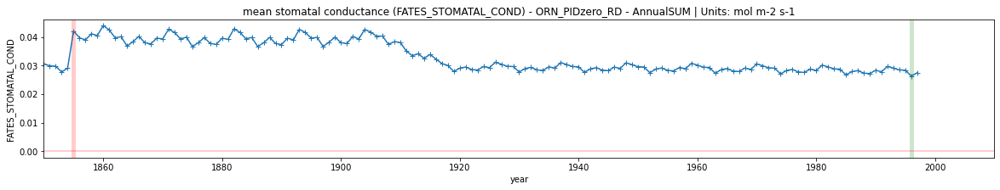

In [67]:

var = "FATES_STOMATAL_COND"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.04)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks:  

'canopy evaporation'

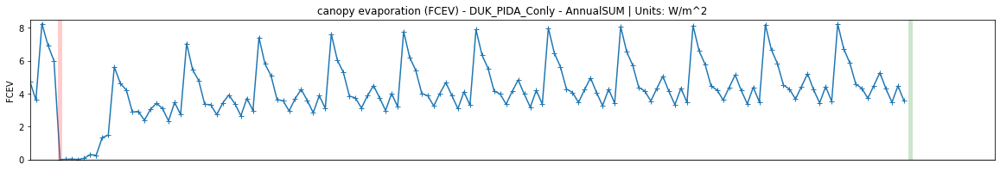

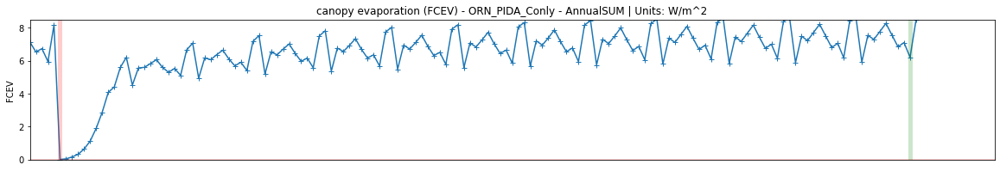

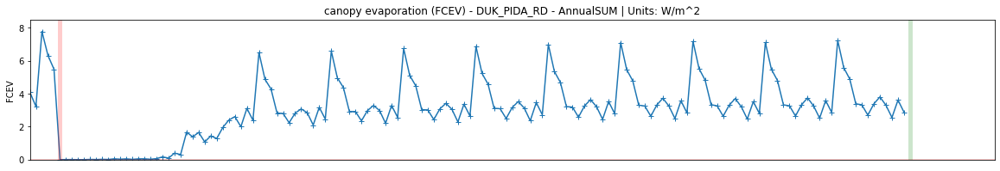

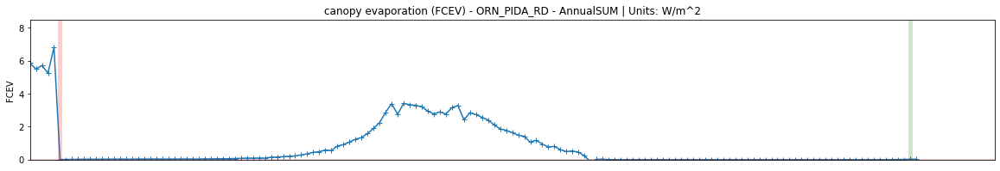

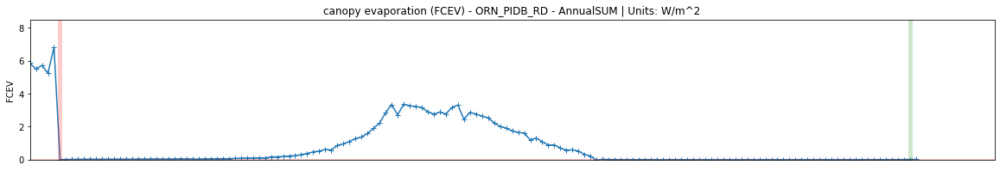

...

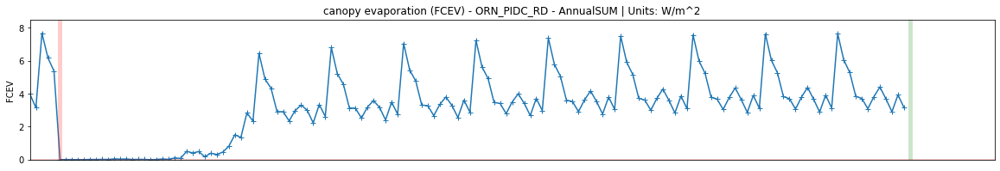

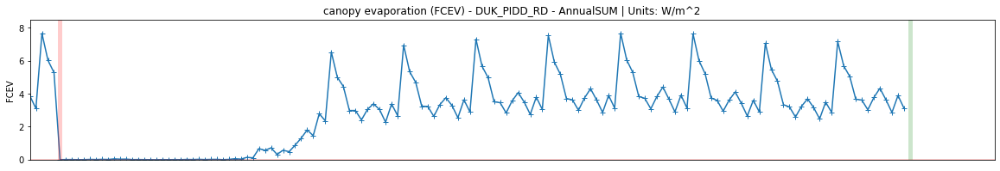

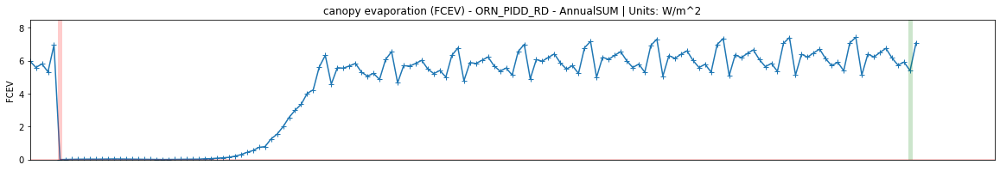

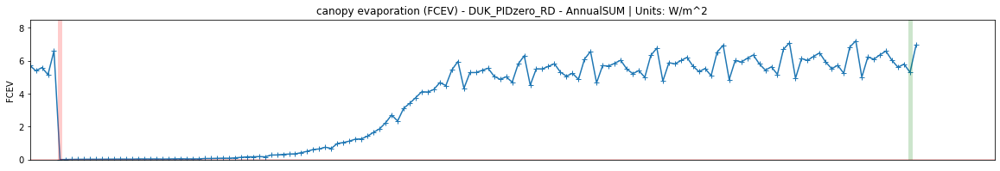

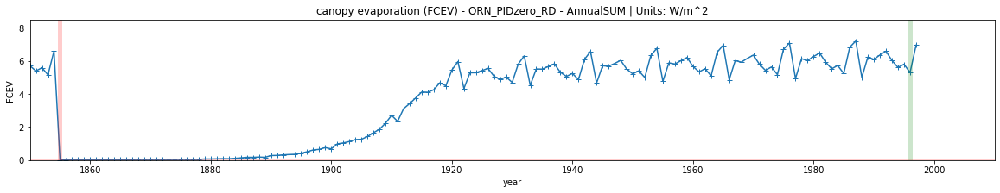

In [68]:

var = "FCEV"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,8.5)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'fractional impermeable area'

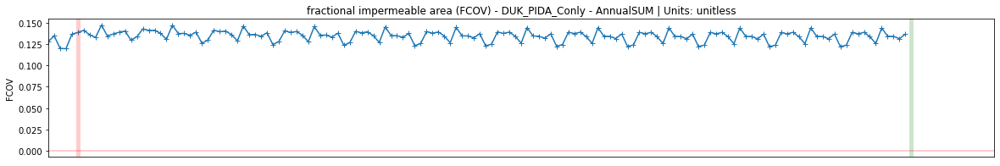

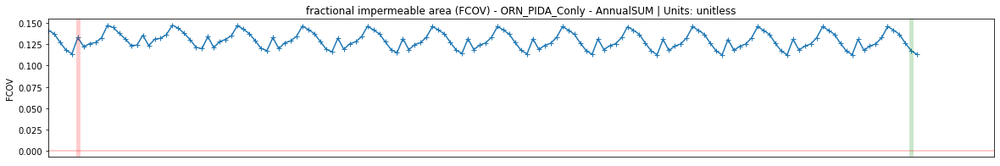

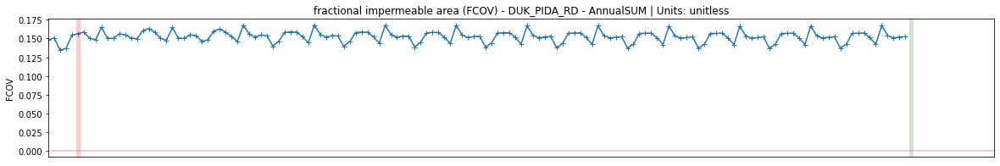

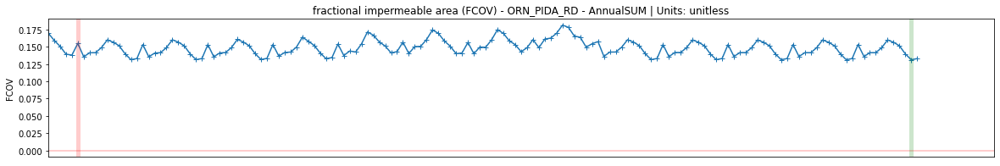

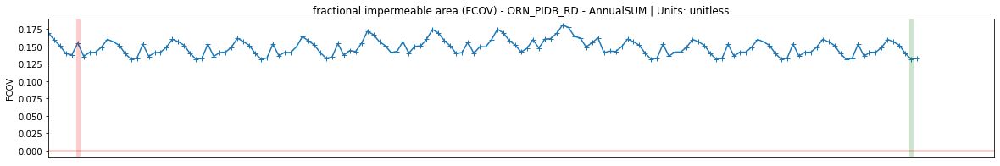

...

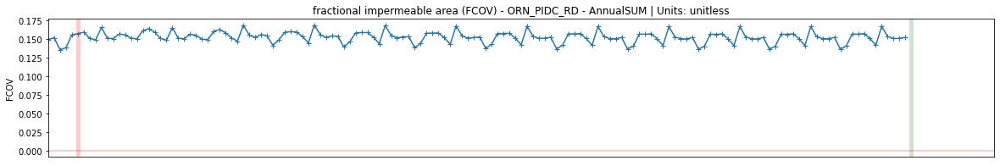

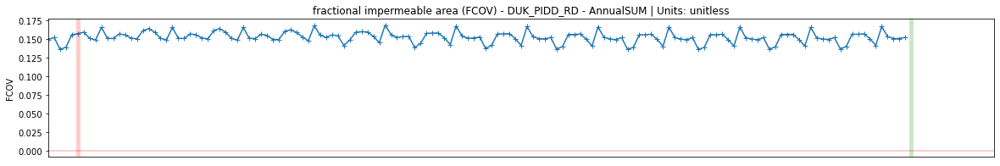

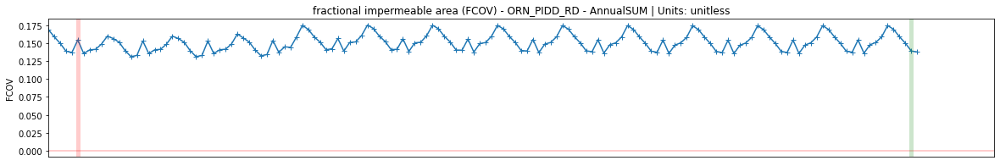

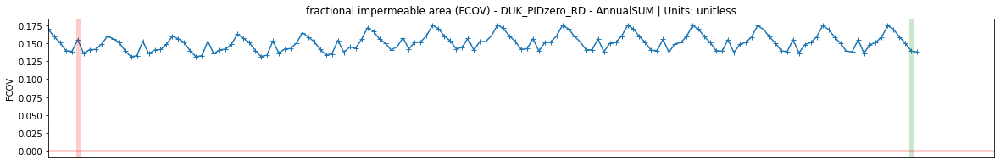

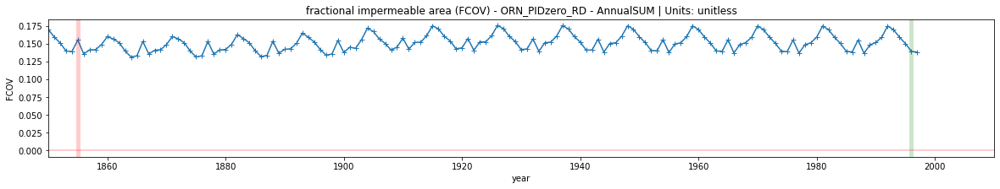

In [69]:

var = "FCOV"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,8.5)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'ground evaporation'

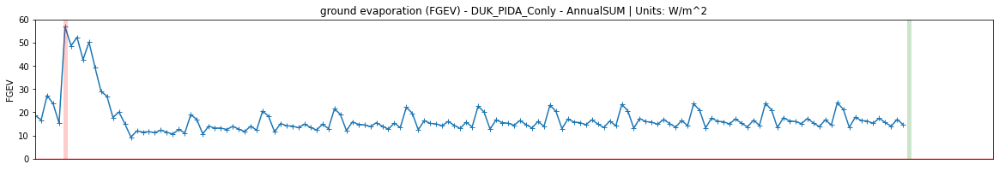

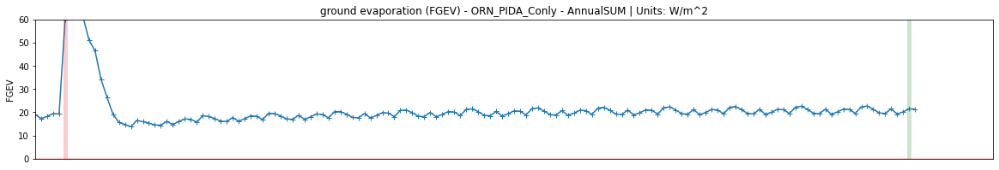

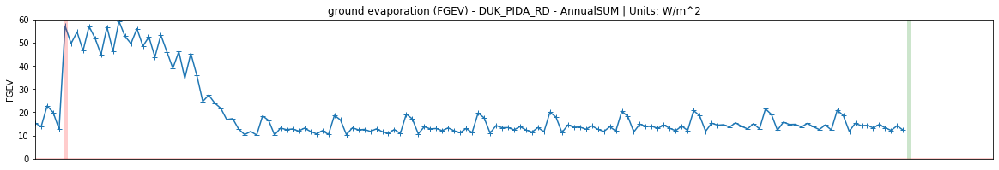

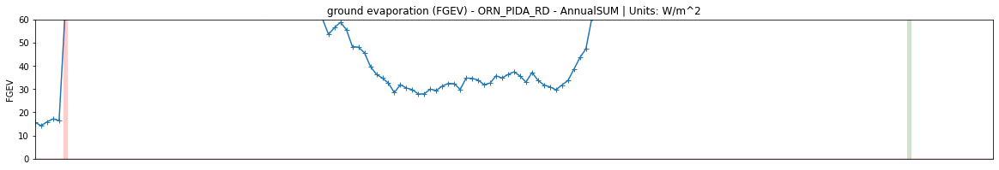

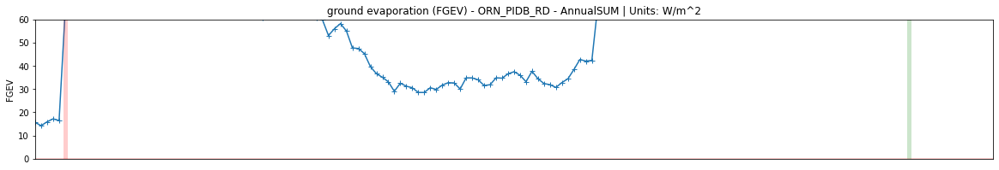

...

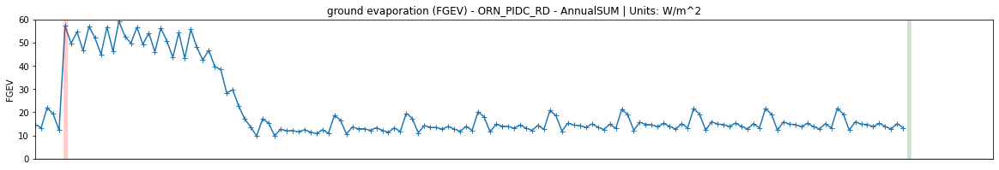

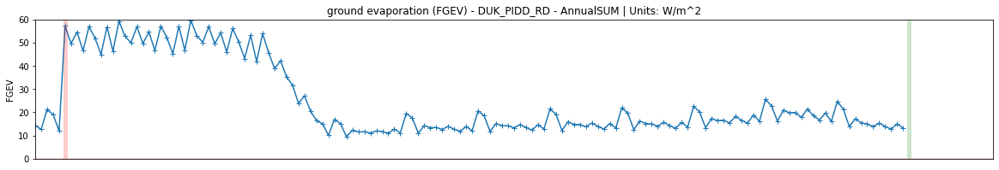

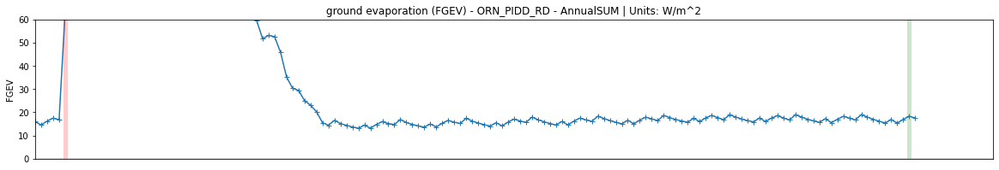

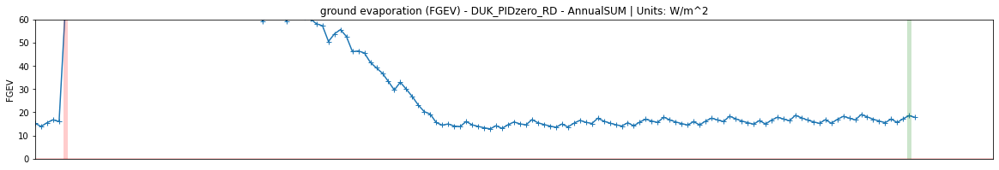

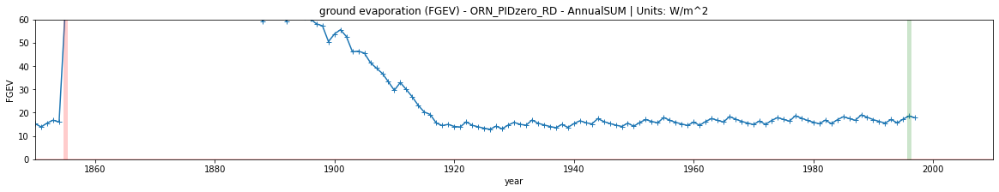

In [70]:

var = "FGEV"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,60)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 
# Remarks: High EVAP maybe causing water stress.

'fraction of ground covered by surface water'

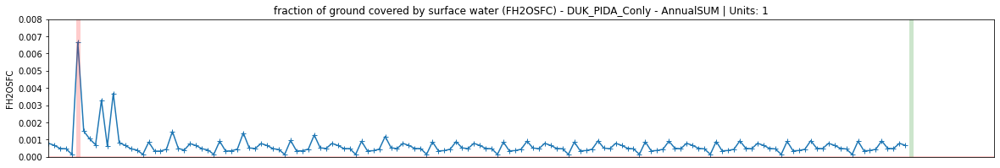

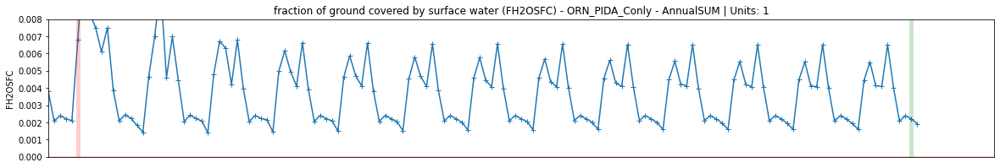

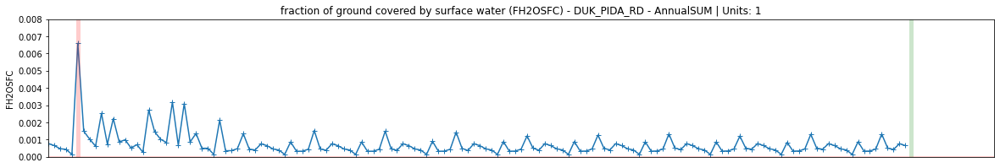

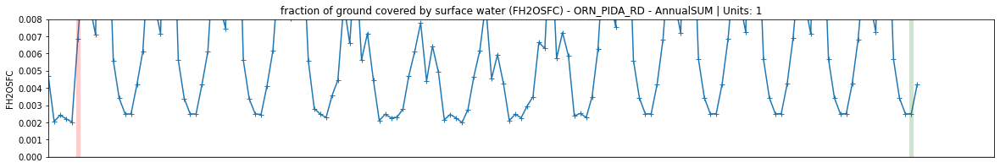

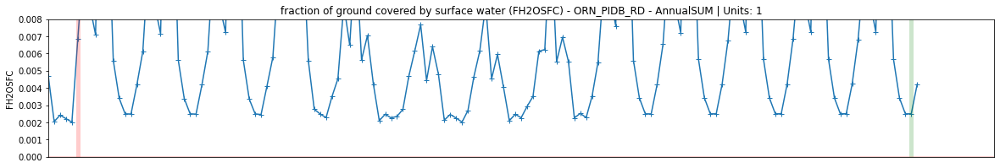

...

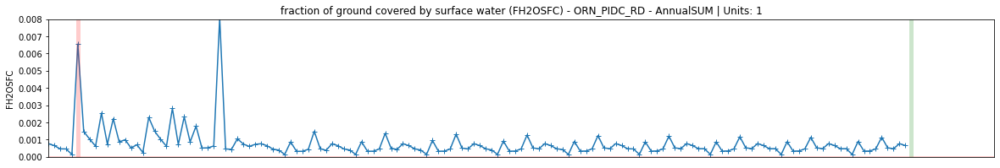

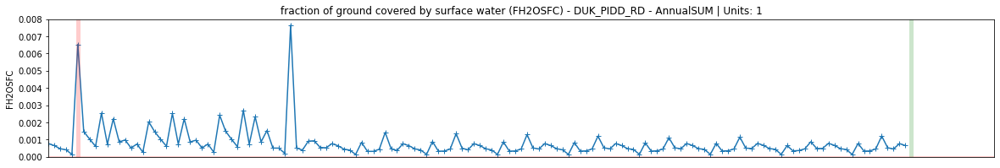

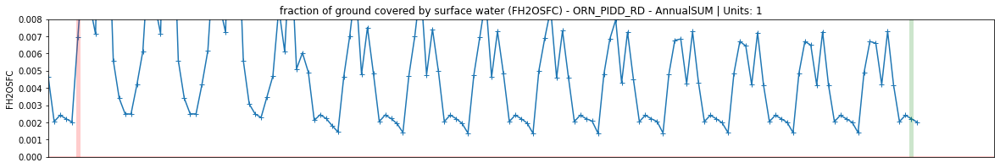

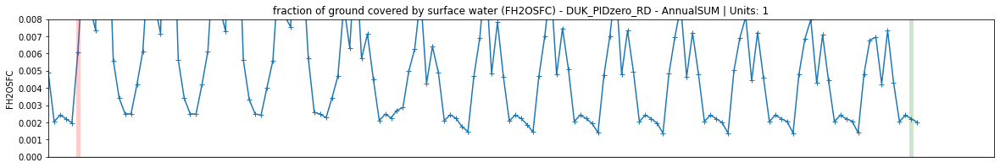

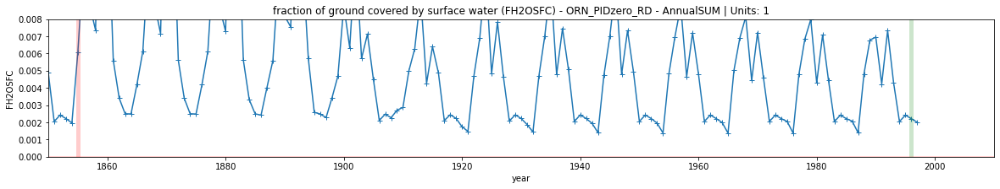

In [71]:

var = "FH2OSFC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,.008)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'sensible heat from ground'

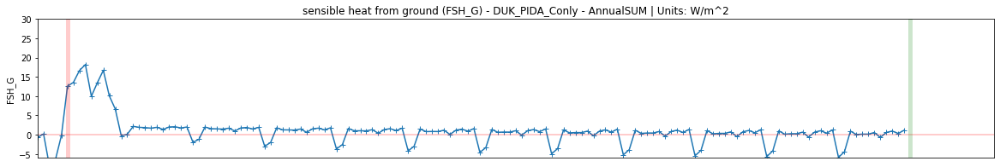

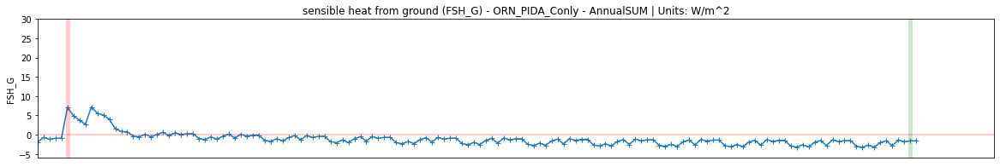

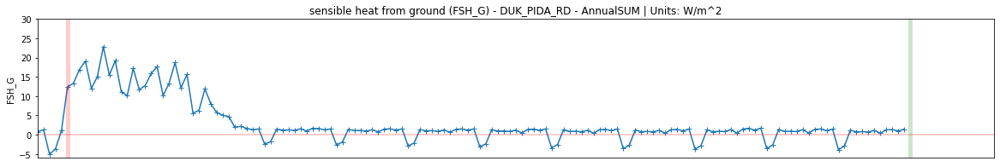

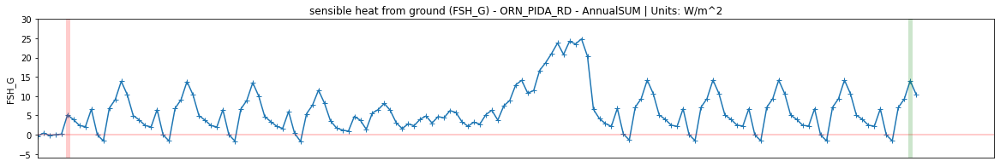

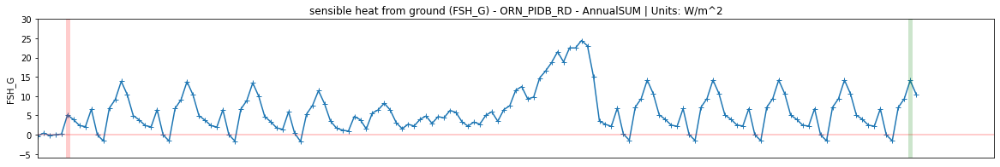

...

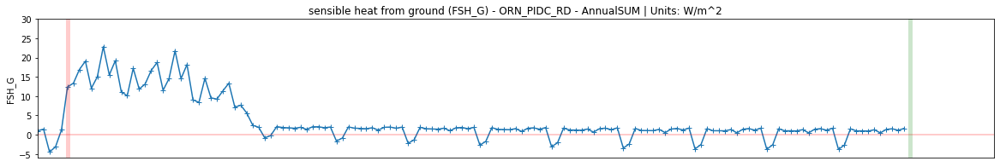

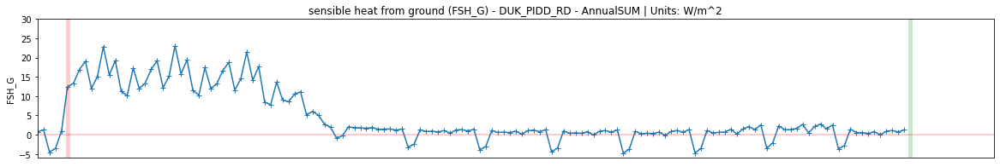

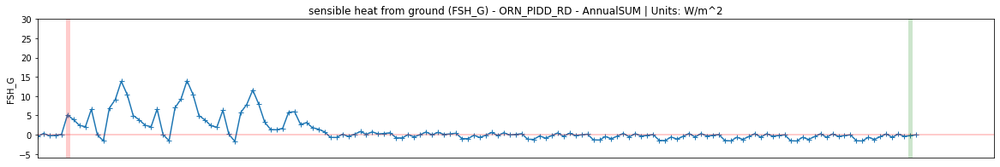

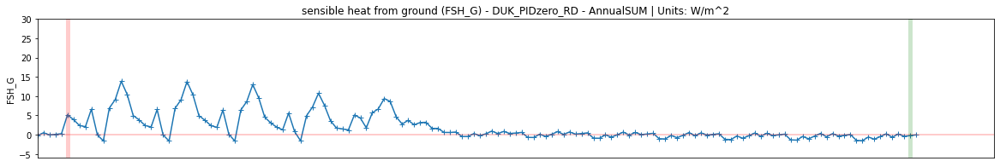

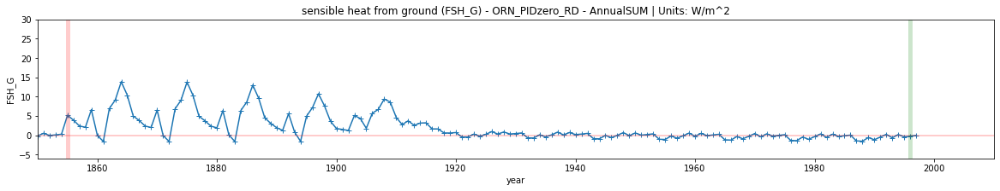

In [72]:

var = "FSH_G"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(-6,30)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'denitrification flux'

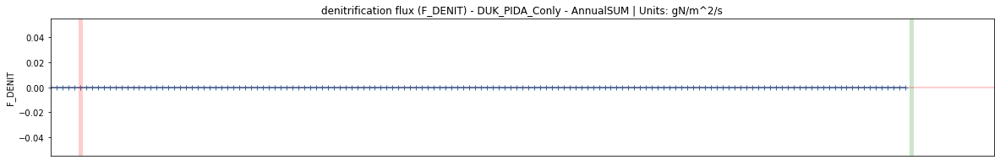

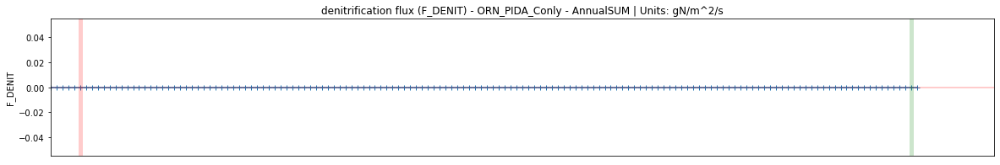

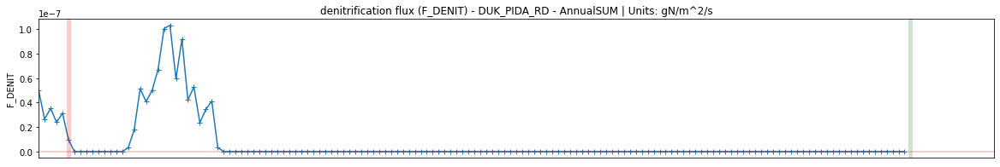

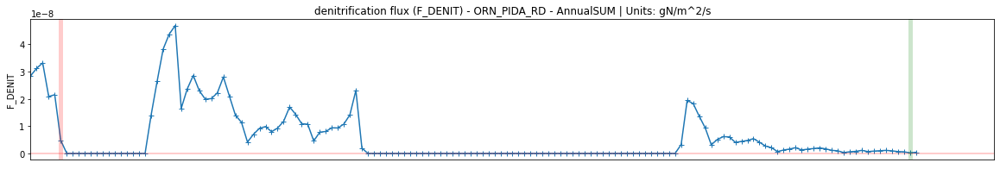

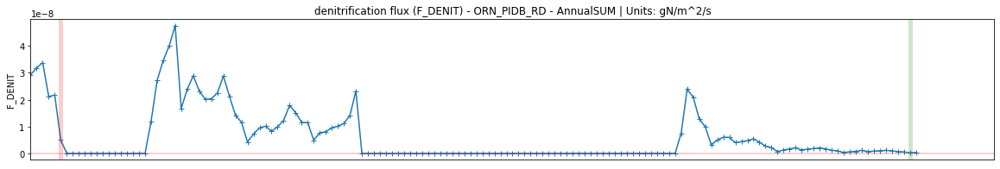

...

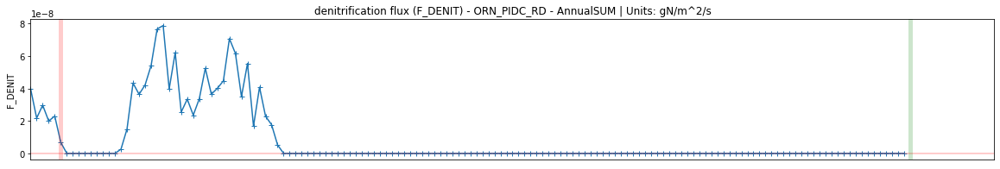

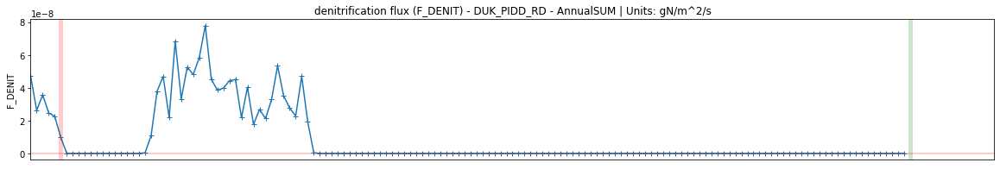

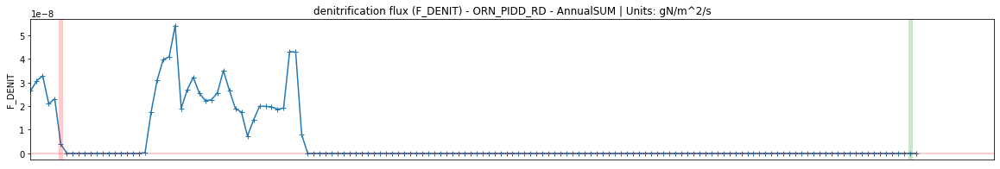

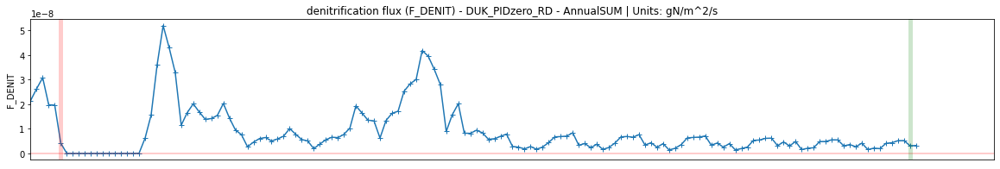

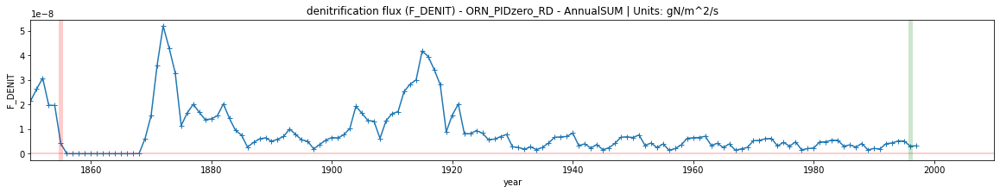

In [73]:

var = "F_DENIT"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(-6,30)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'denitrification N2O flux'

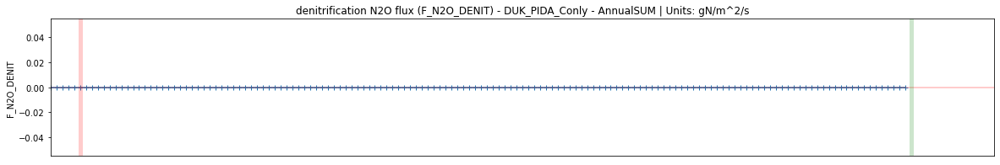

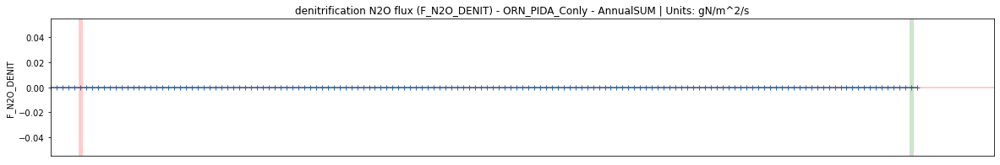

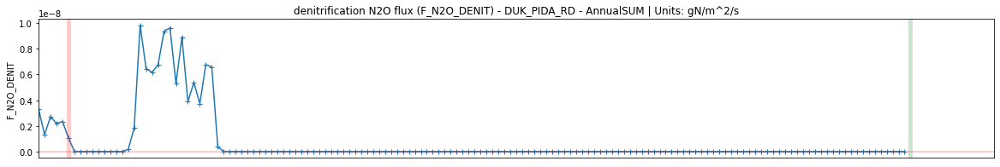

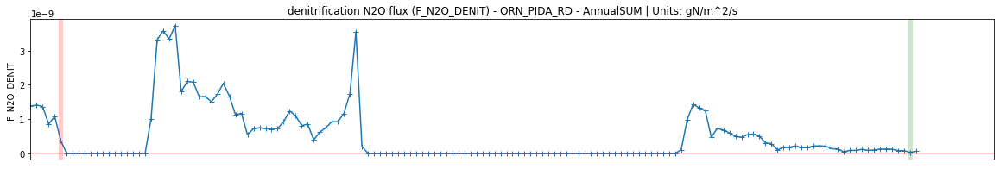

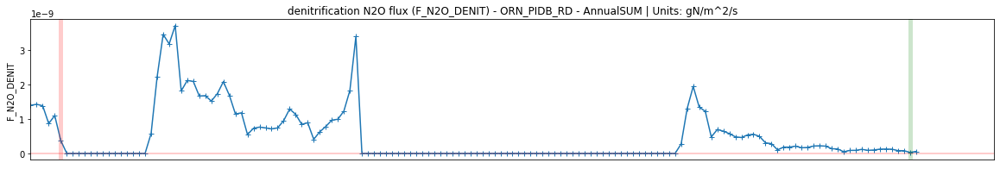

...

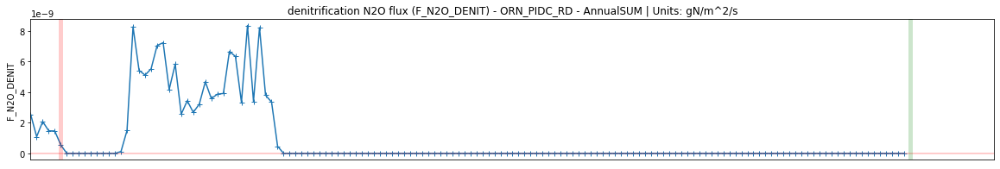

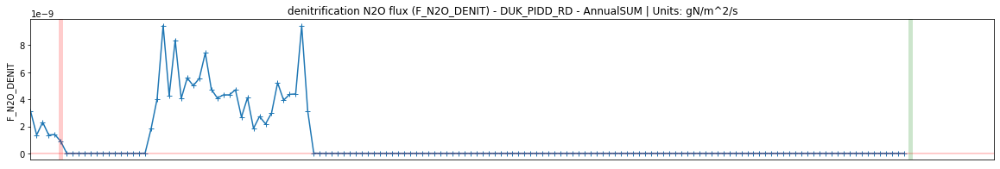

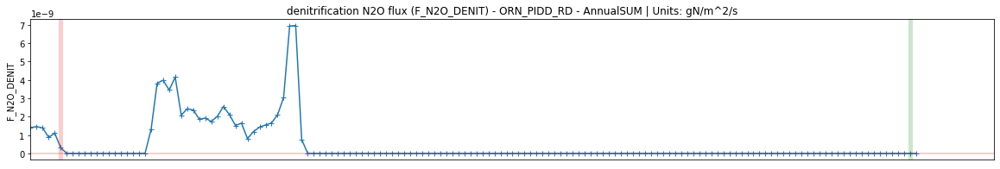

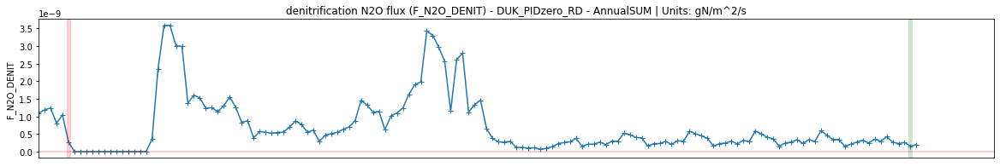

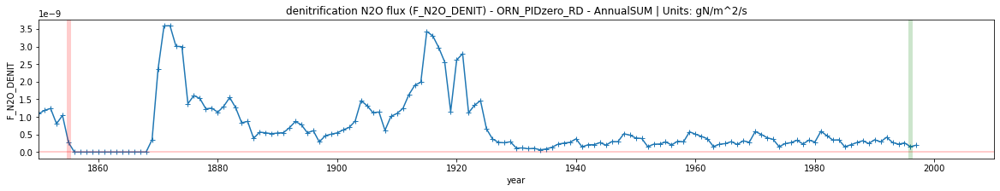

In [74]:

var = "F_N2O_DENIT"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(-6,30)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'nitrification flux'

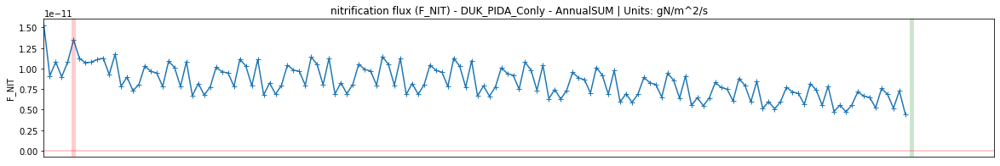

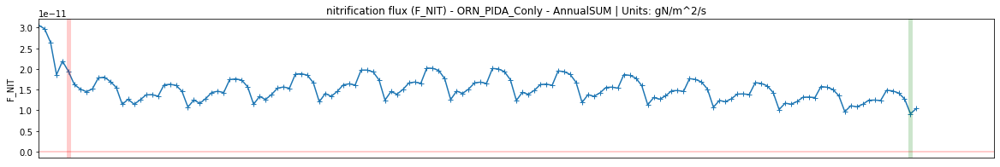

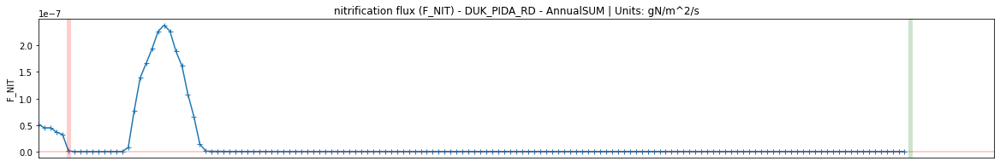

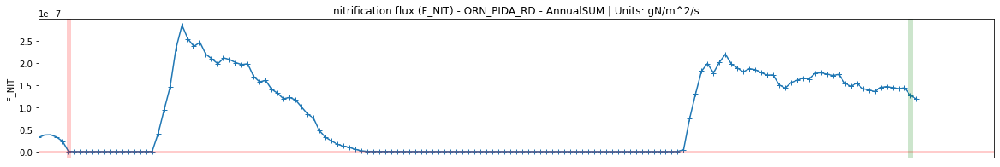

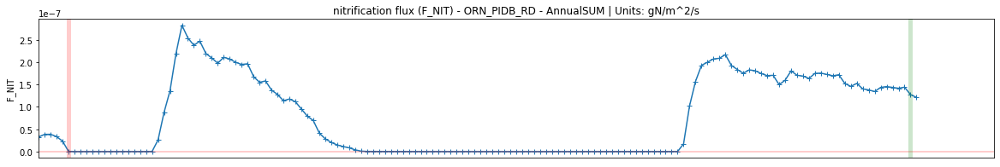

...

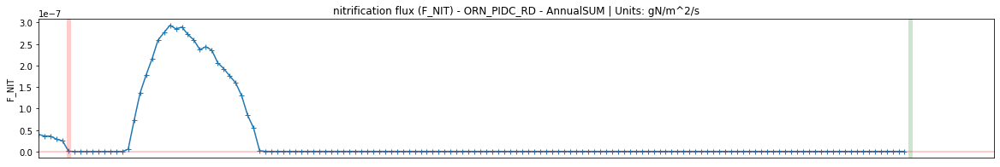

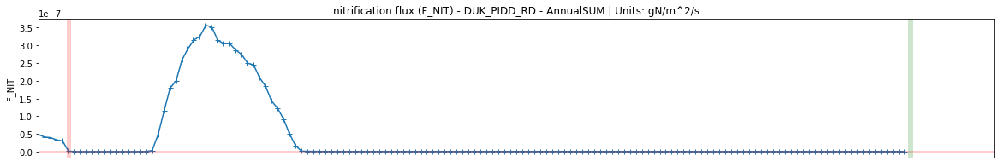

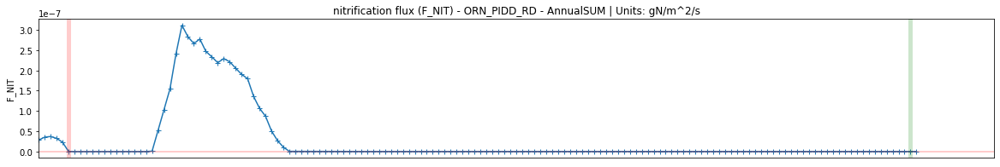

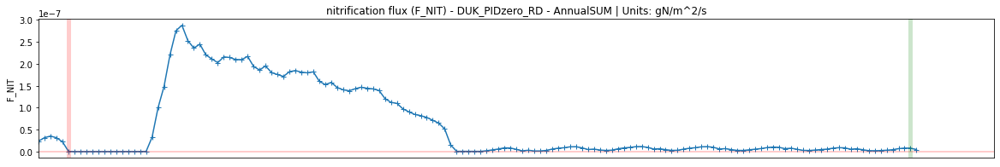

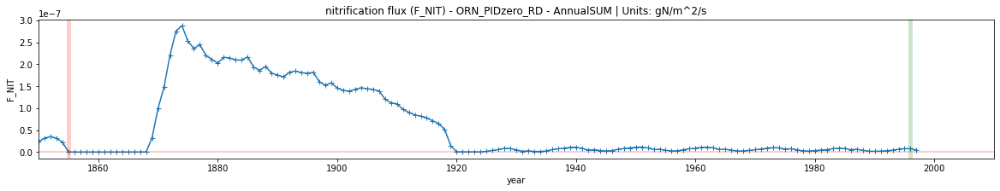

In [75]:

var = "F_NIT"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(-6,30)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'gross rate of N mineralization'

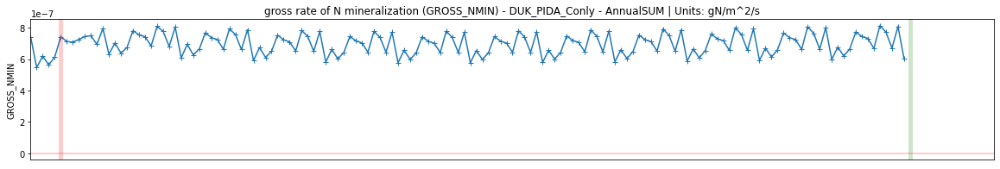

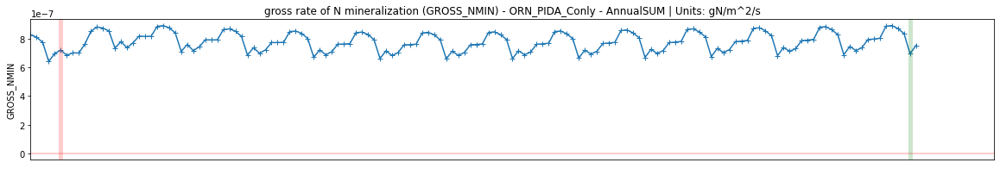

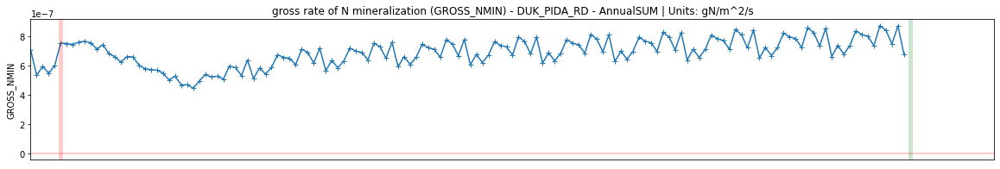

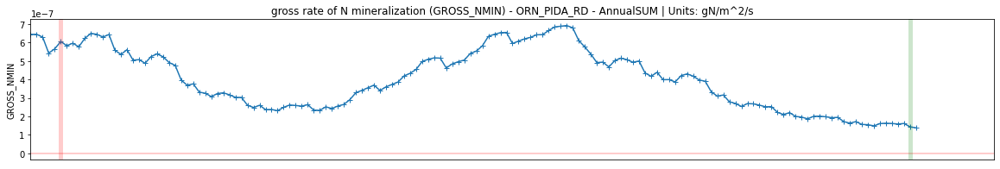

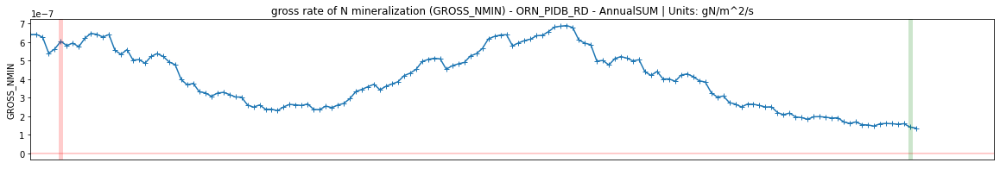

...

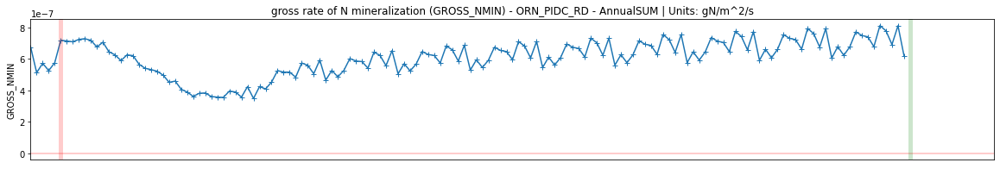

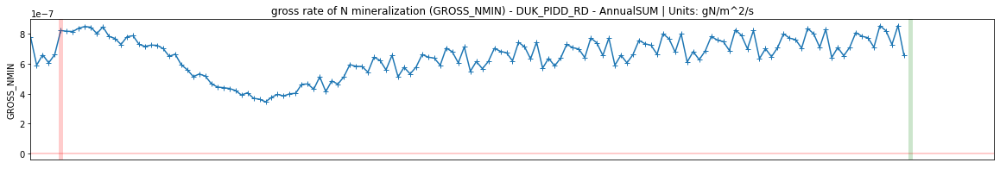

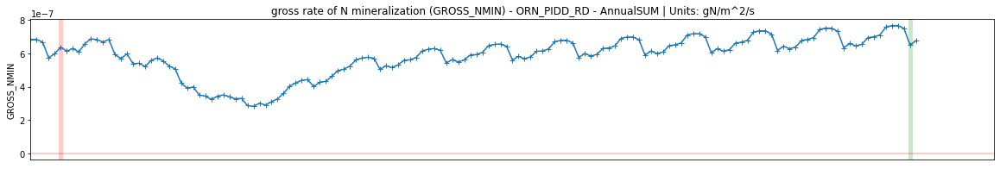

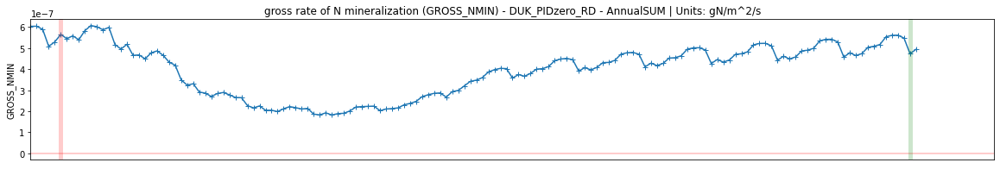

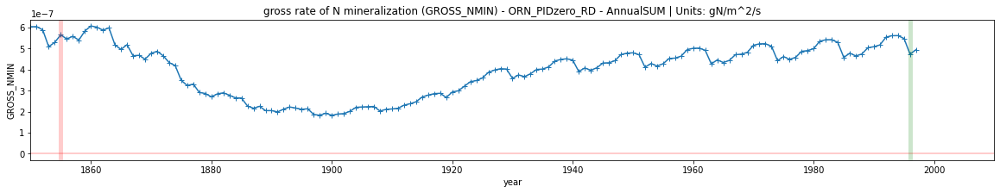

In [76]:

var = "GROSS_NMIN"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(-6,30)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'intercepted water'

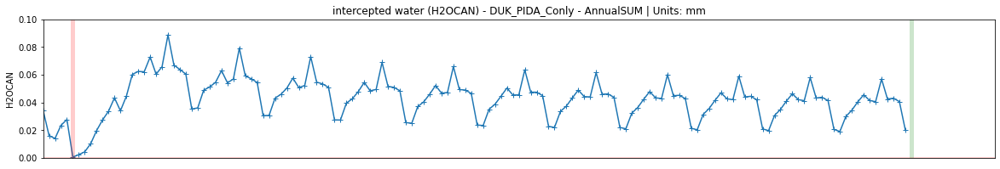

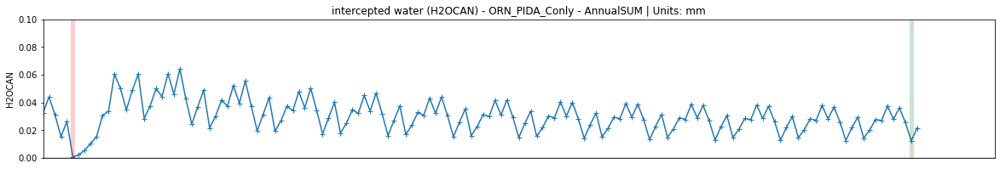

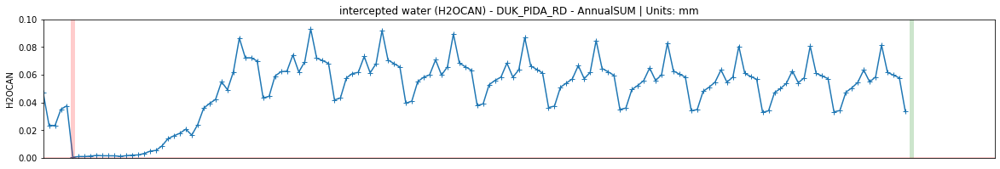

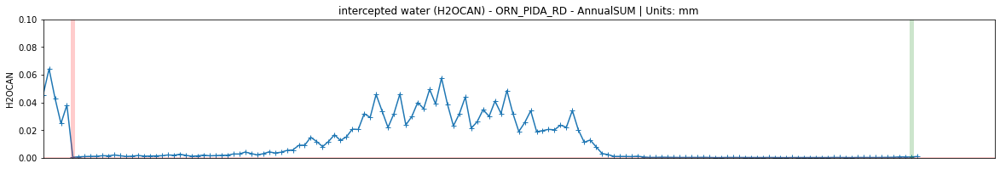

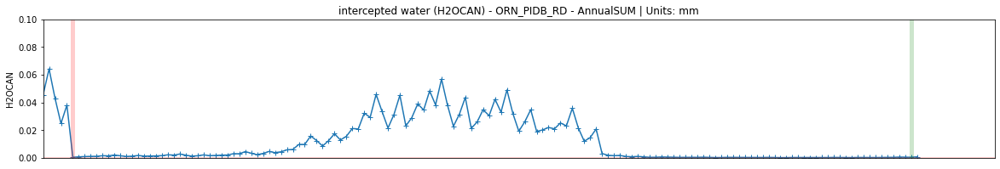

...

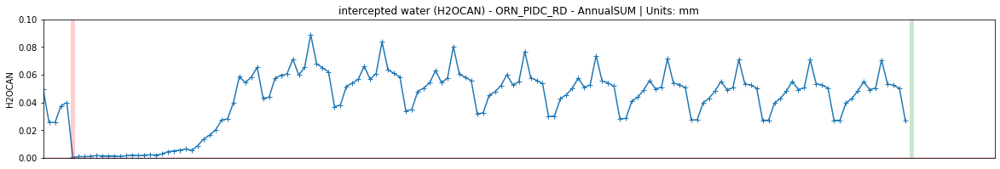

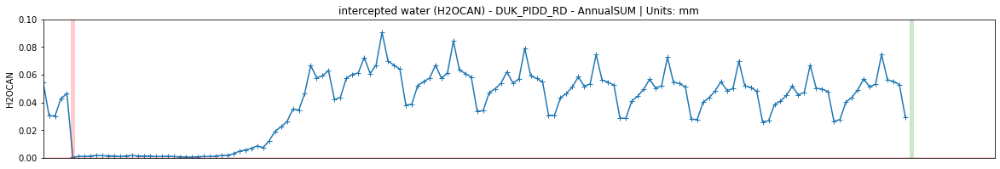

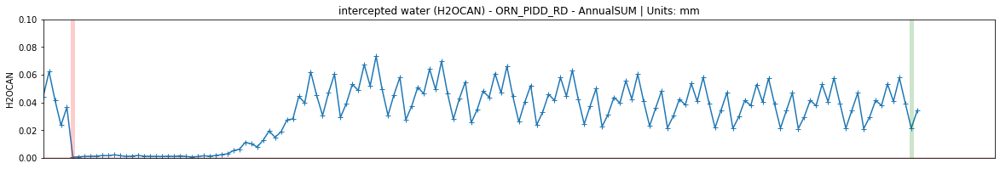

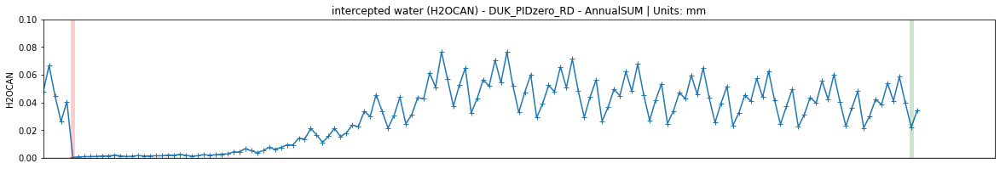

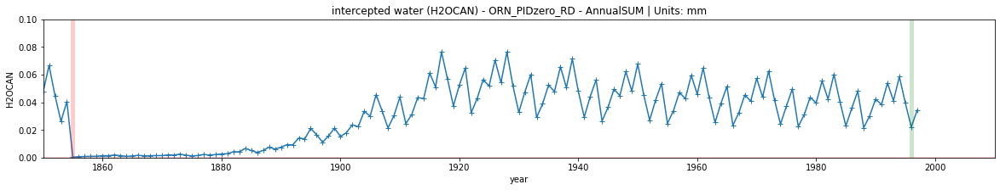

In [77]:

var = "H2OCAN"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,.1)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'total heterotrophic respiration'

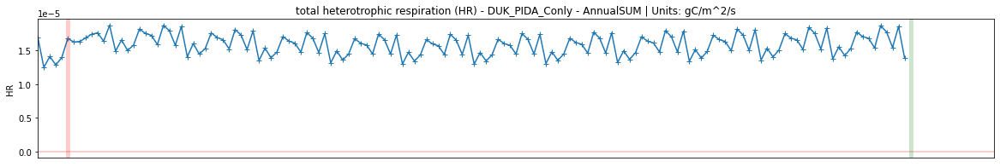

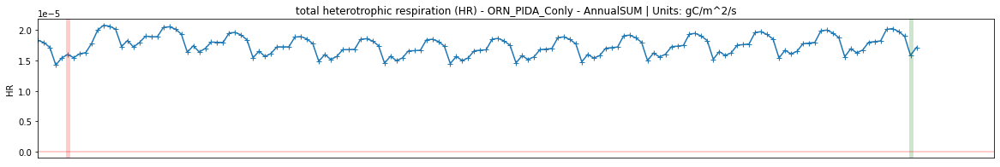

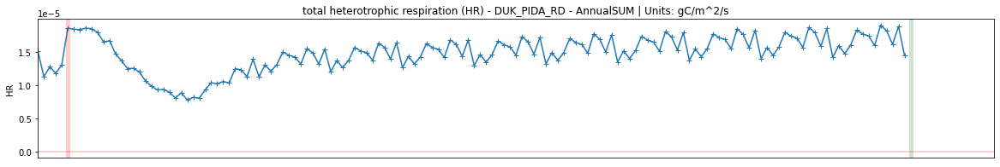

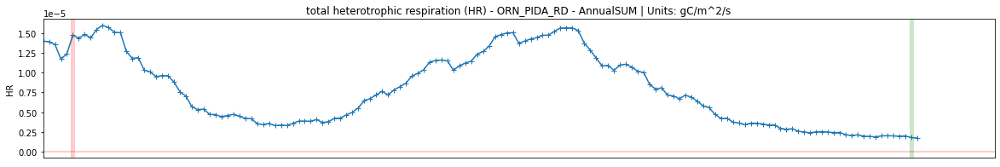

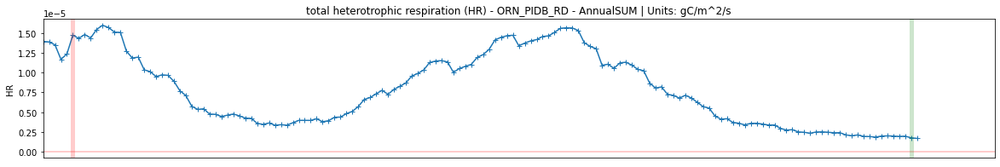

...

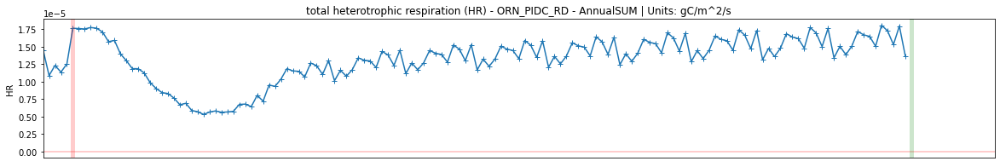

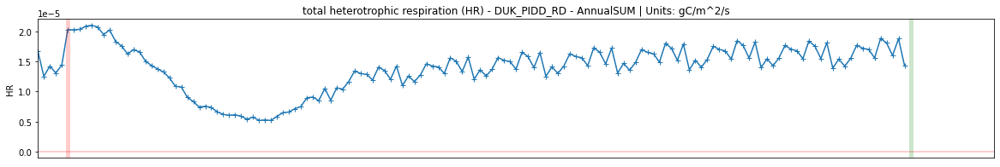

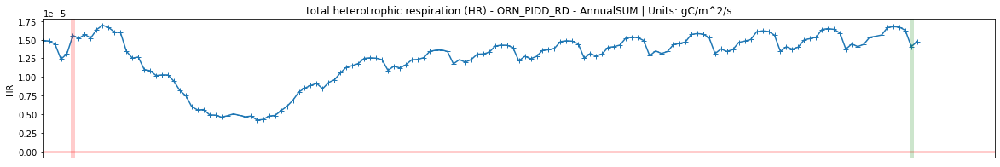

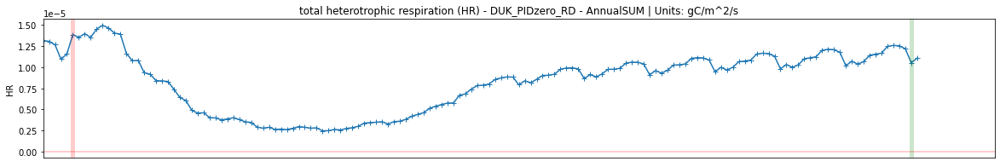

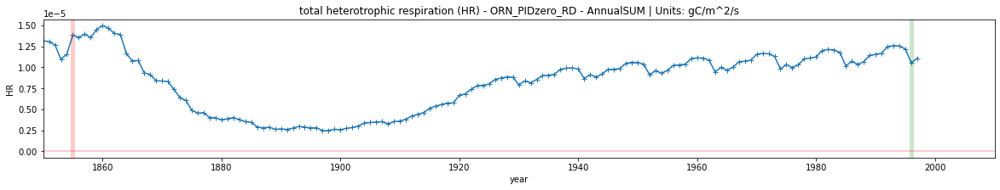

In [78]:

var = "HR"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'litter heterotrophic respiration'

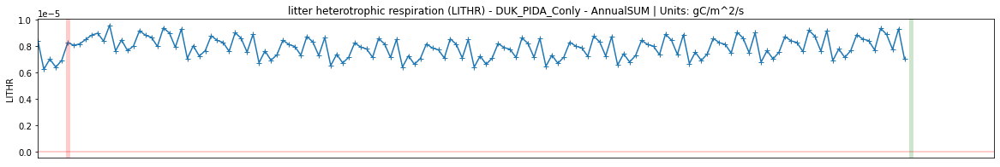

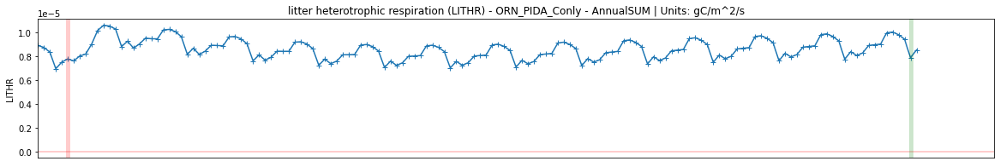

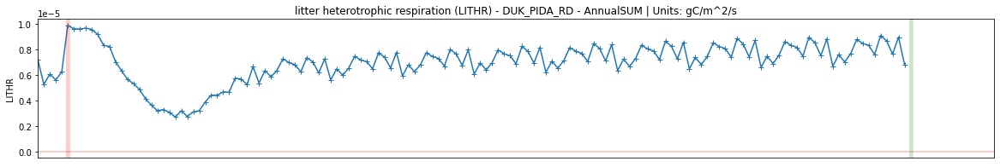

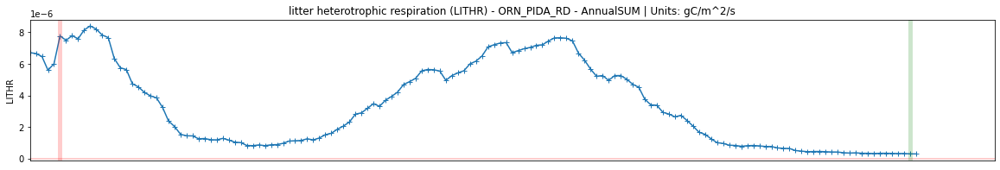

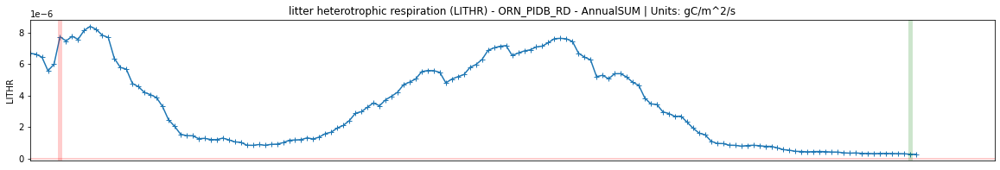

...

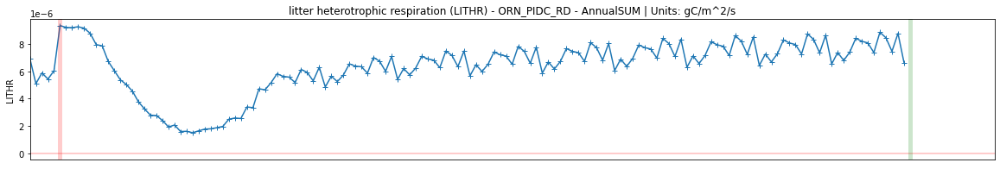

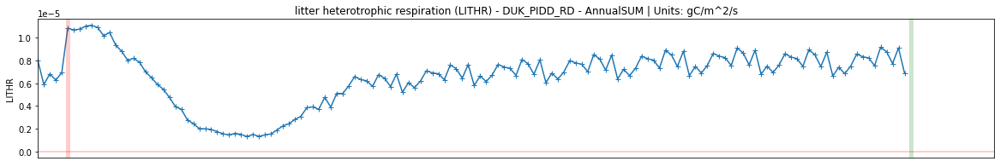

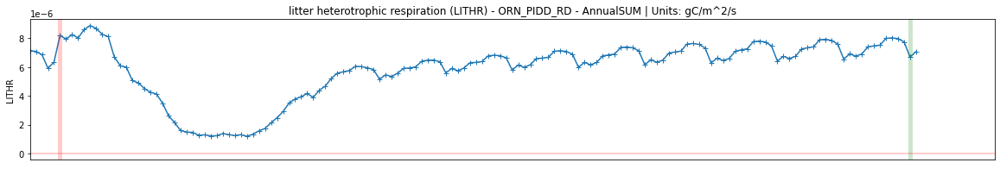

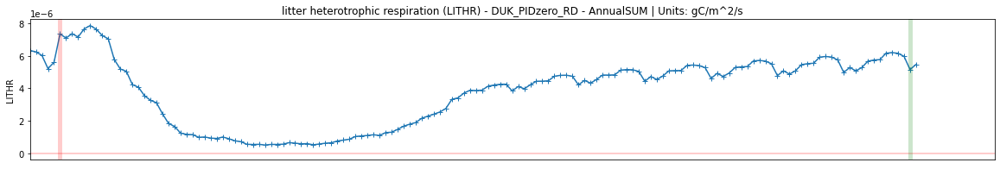

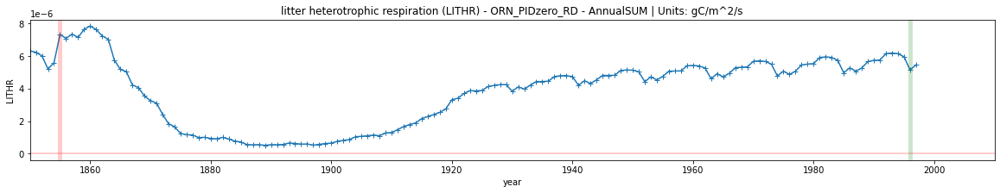

In [79]:

var = "LITHR"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'net rate of N mineralization'

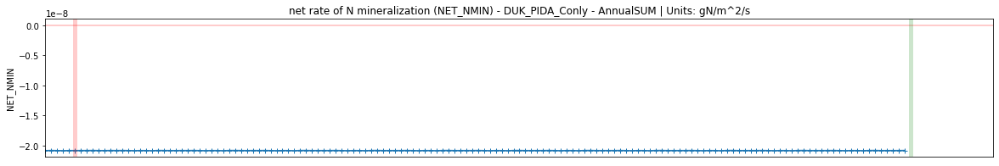

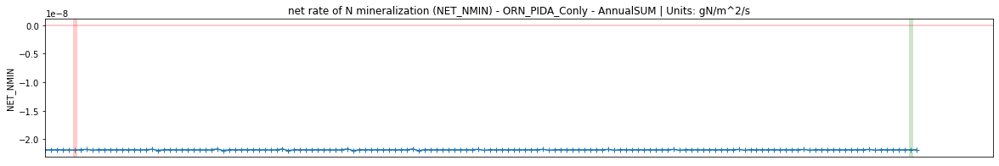

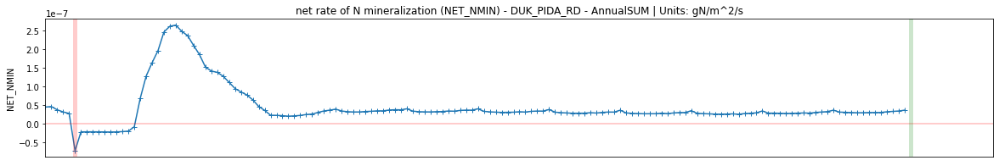

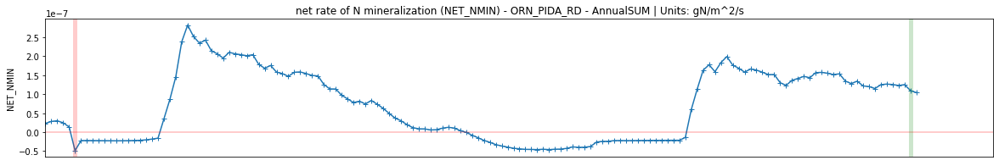

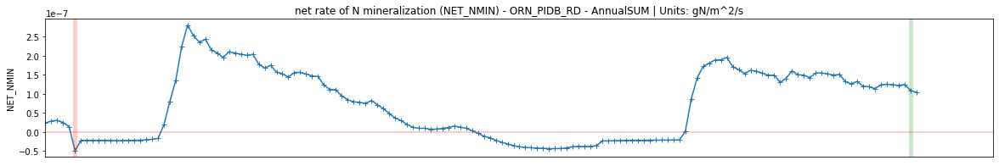

...

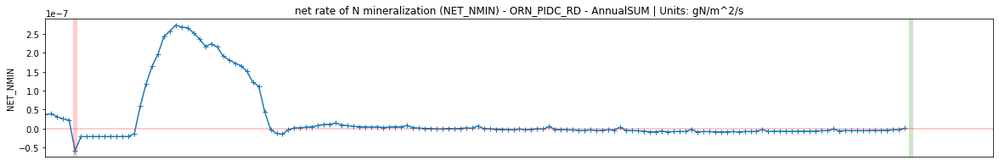

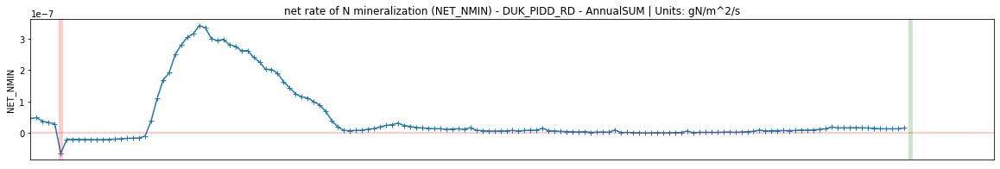

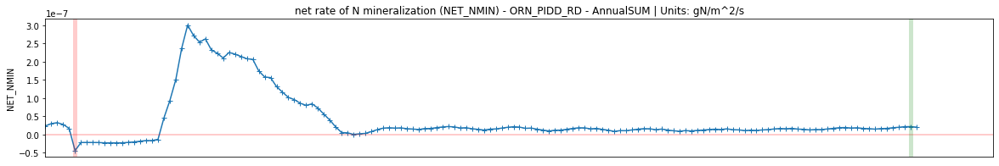

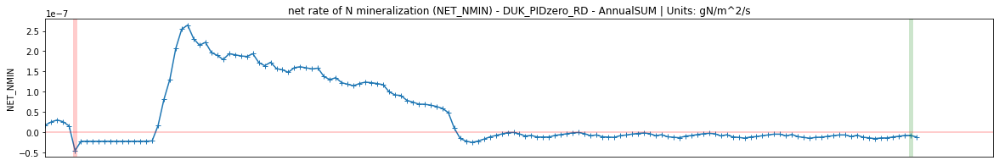

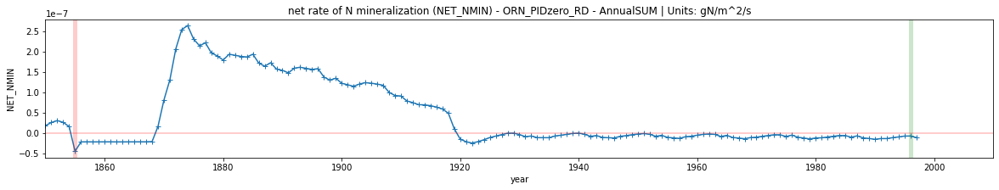

In [80]:

var = "NET_NMIN"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'net rate of P mineralization'

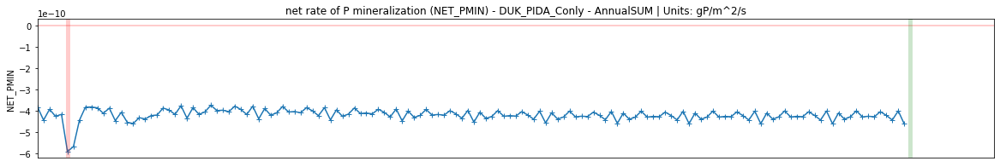

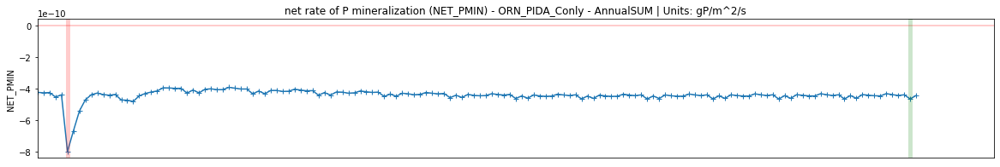

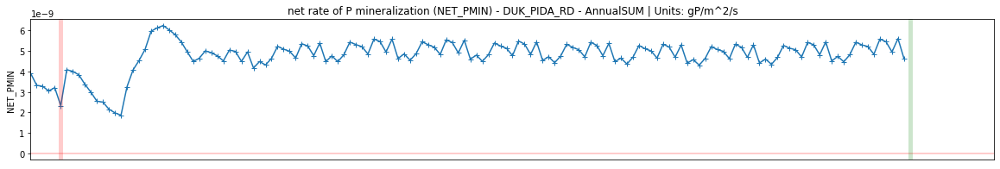

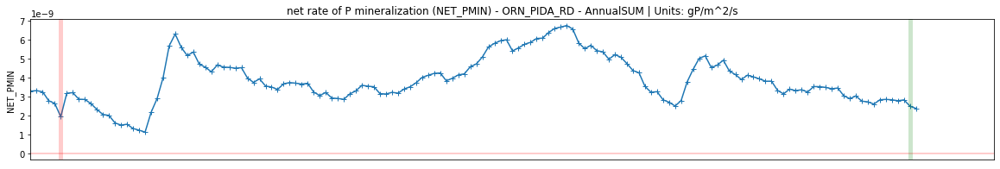

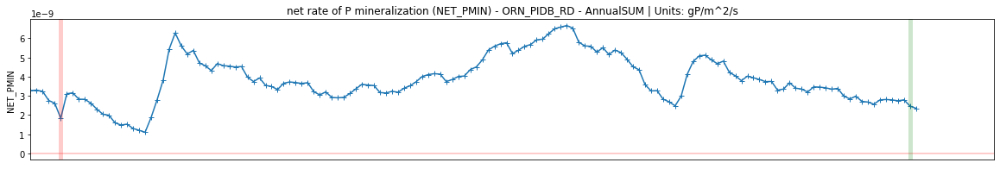

...

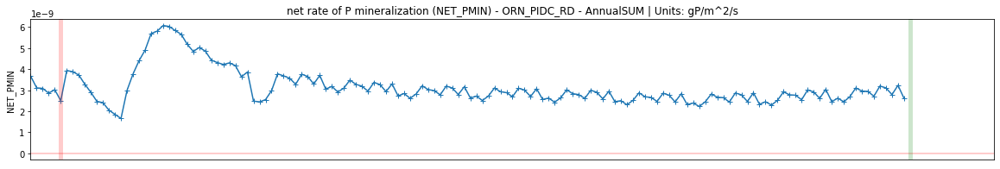

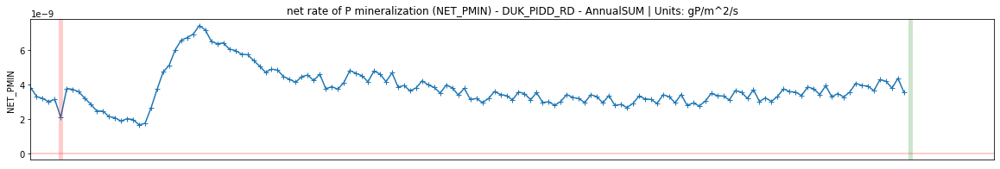

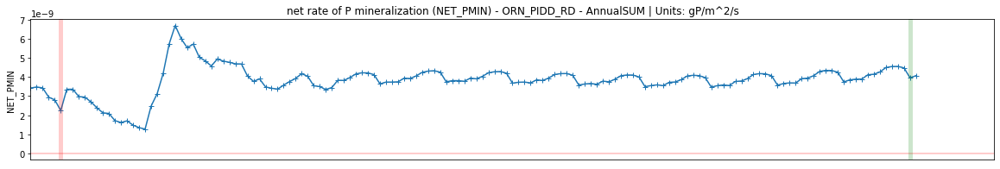

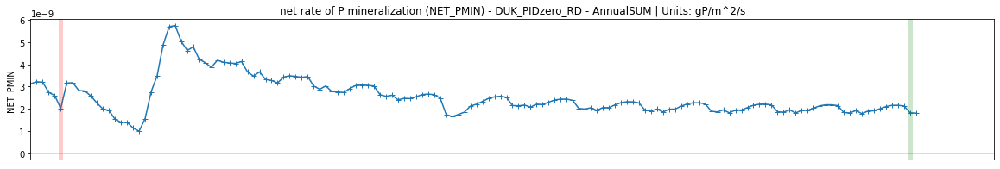

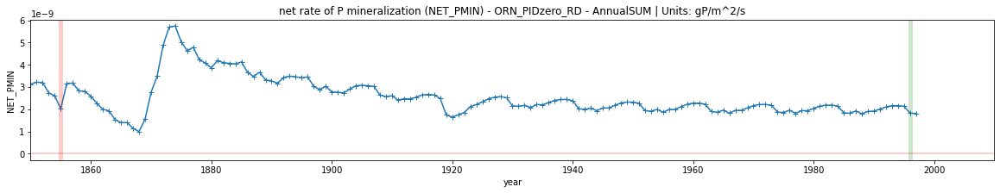

In [81]:

var = "NET_PMIN"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'N flux required to support initial GPP'

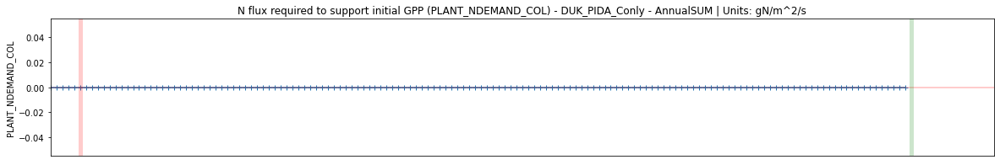

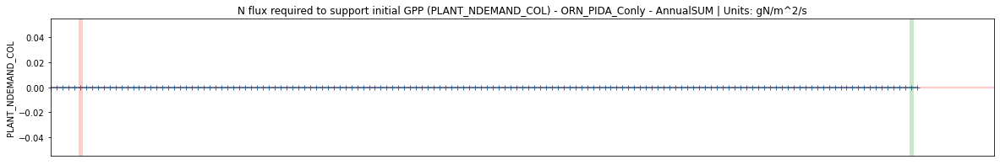

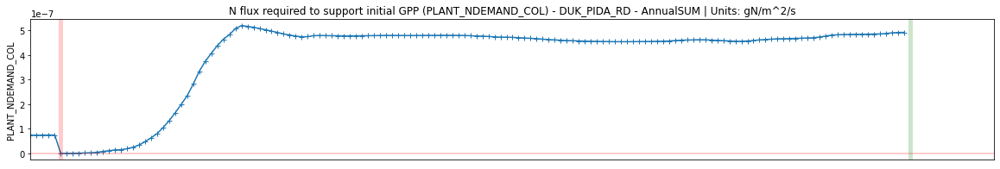

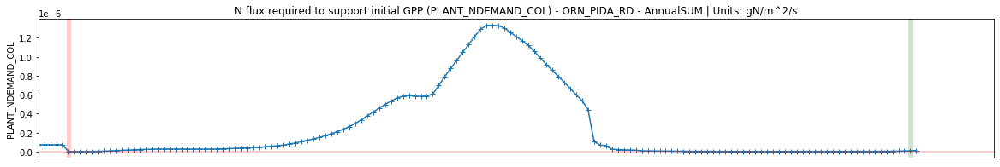

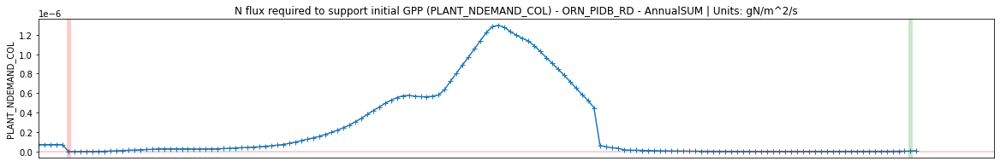

...

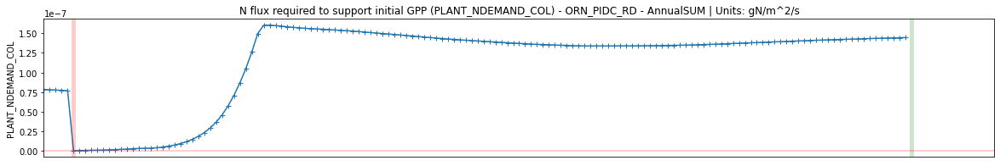

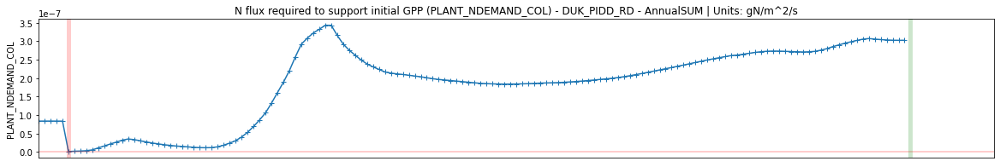

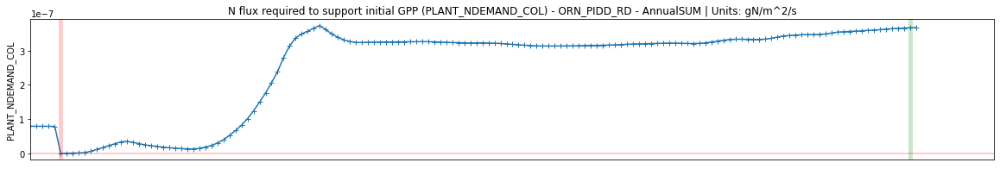

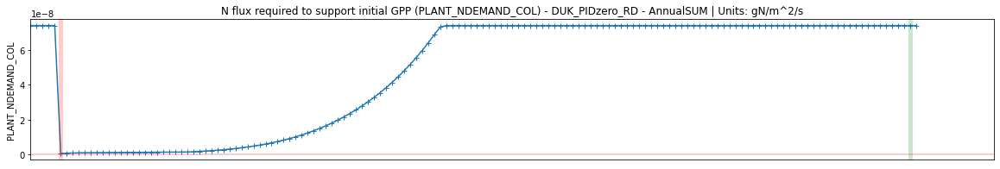

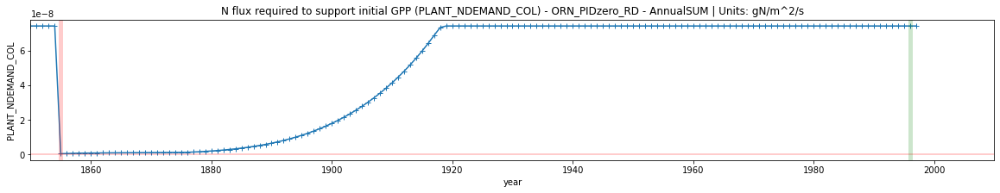

In [82]:

var = "PLANT_NDEMAND_COL"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 
# Remarks:

'P flux required to support initial GPP'

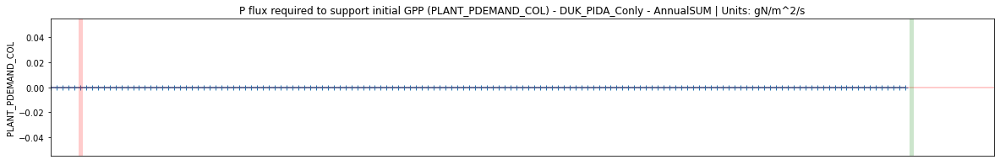

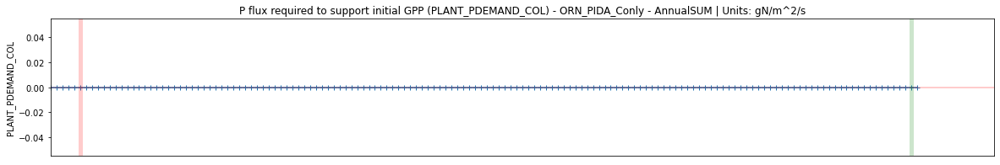

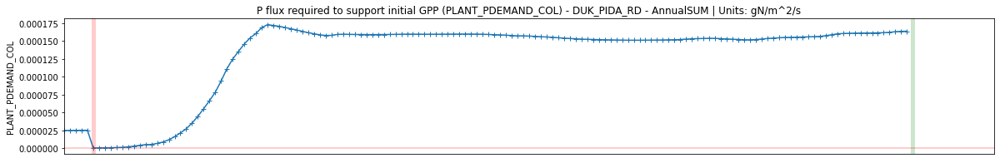

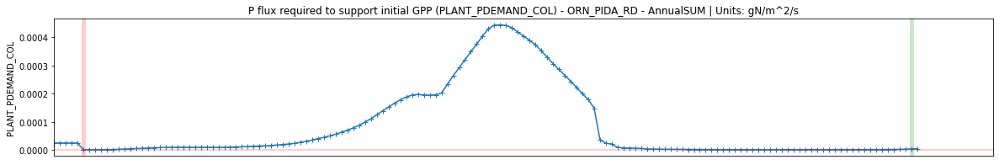

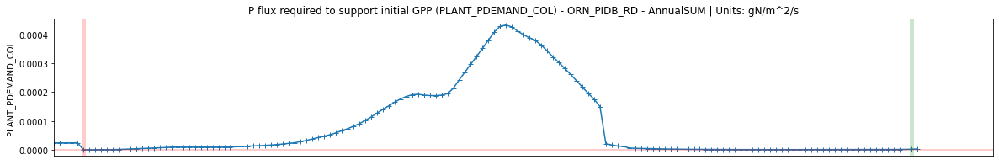

...

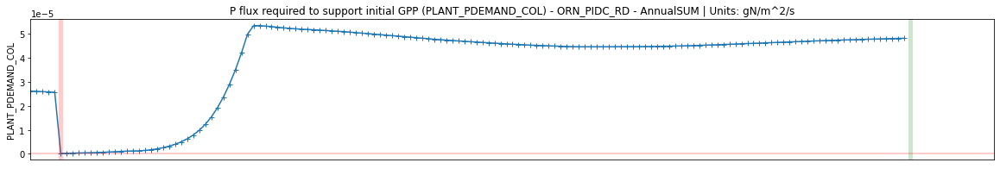

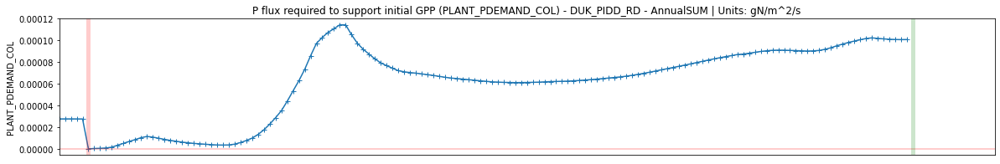

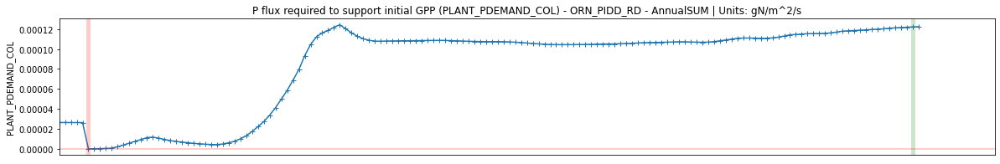

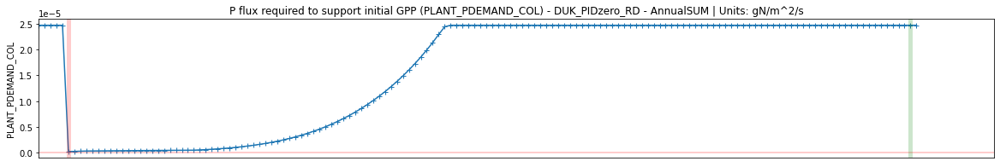

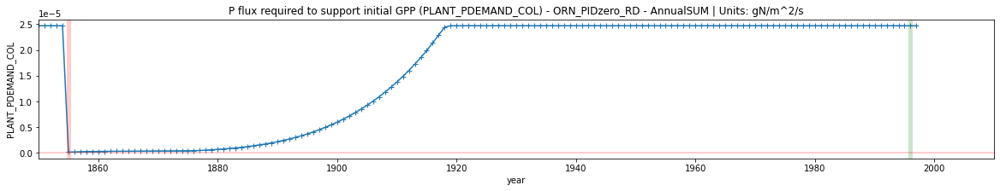

In [83]:

var = "PLANT_PDEMAND_COL"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: P recovers while N is limited in ECA.

'potential N immobilization'

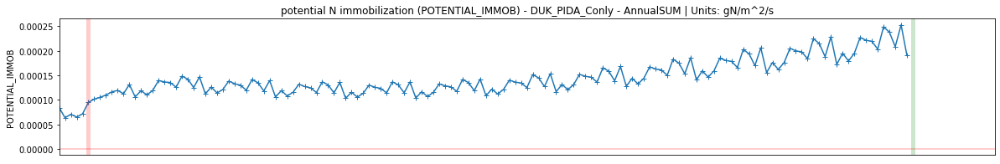

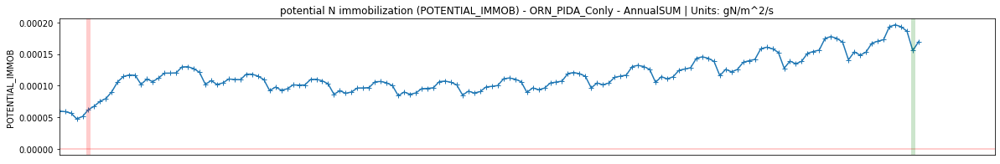

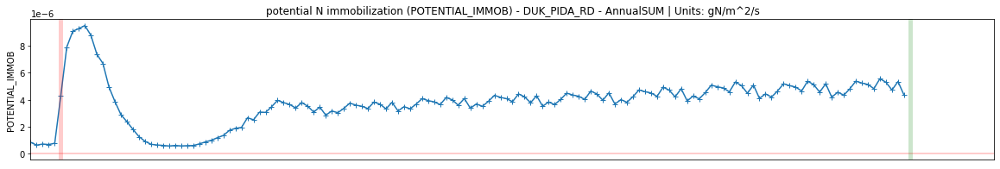

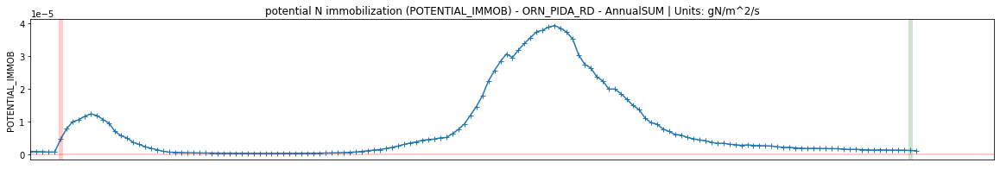

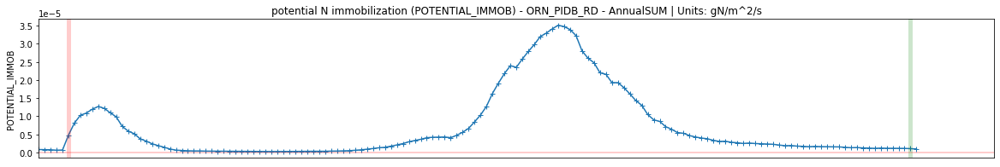

...

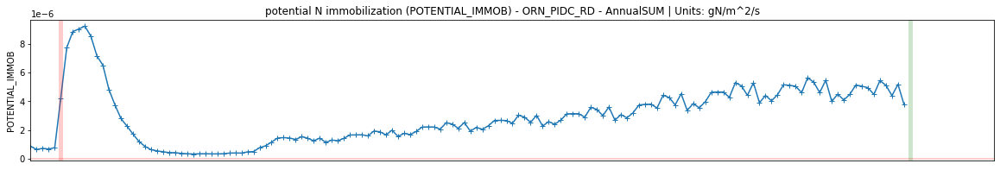

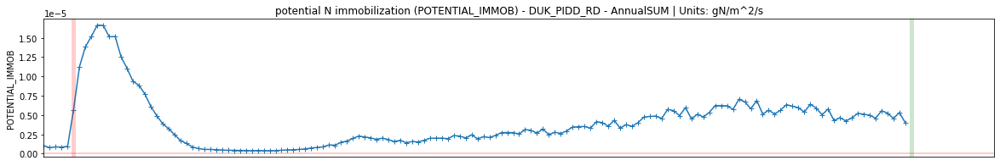

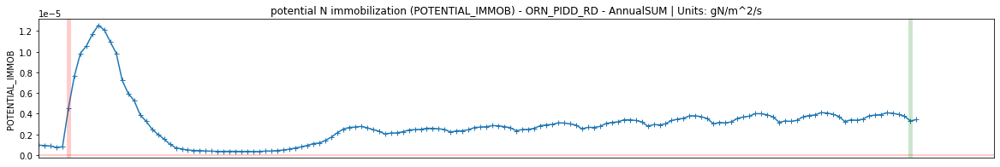

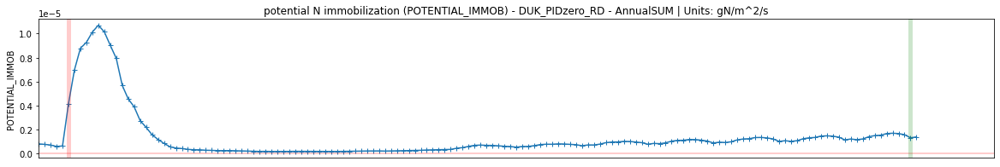

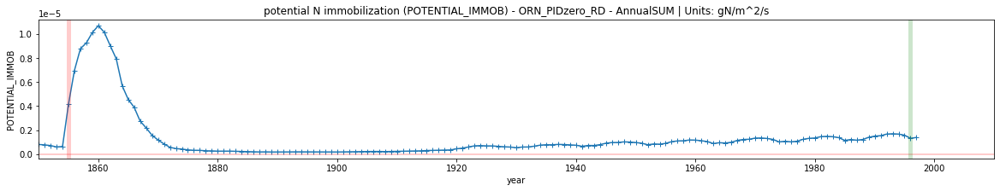

In [84]:

var = "POTENTIAL_IMMOB"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,5e-4)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'potential P immobilization'

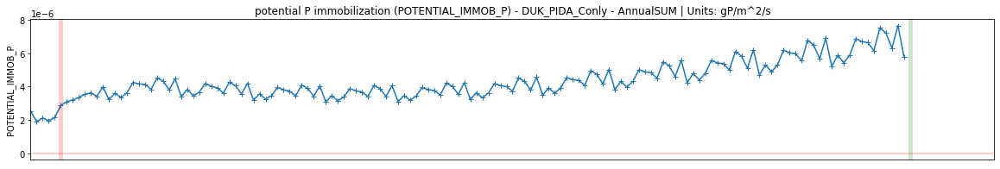

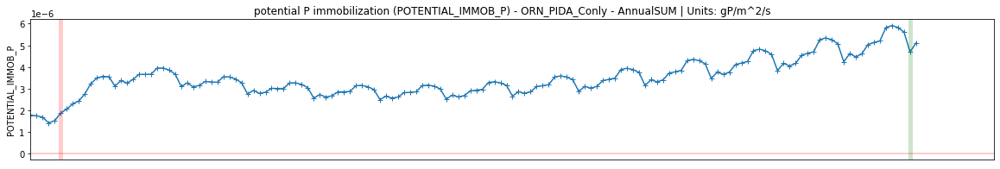

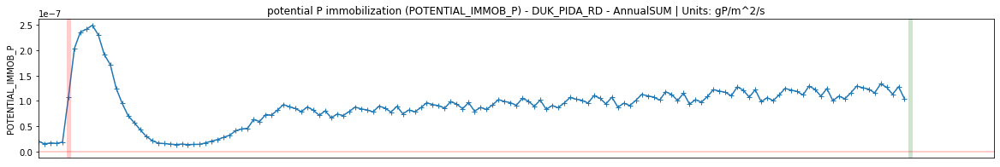

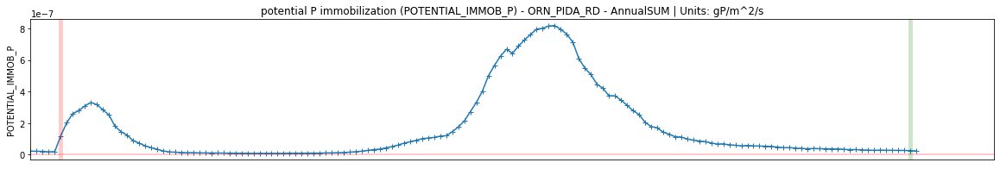

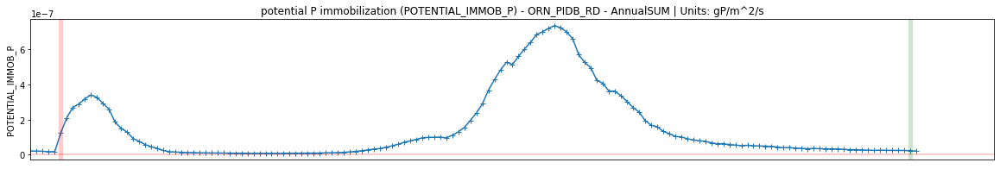

...

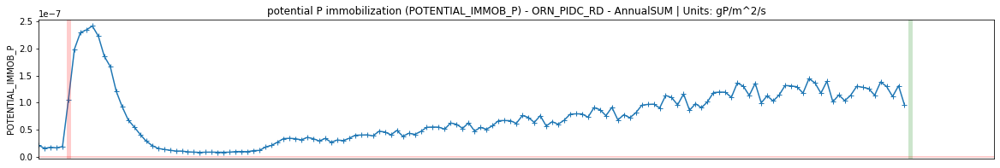

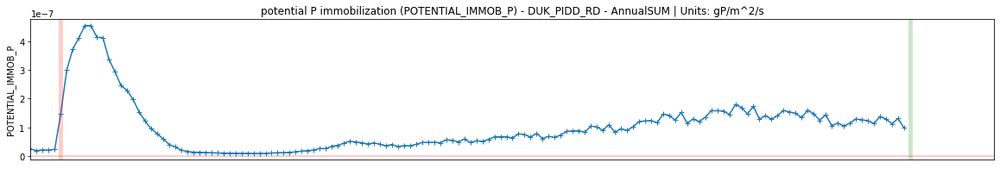

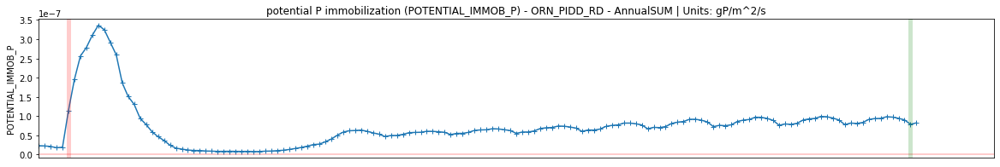

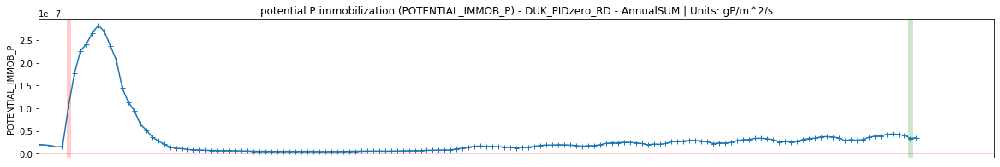

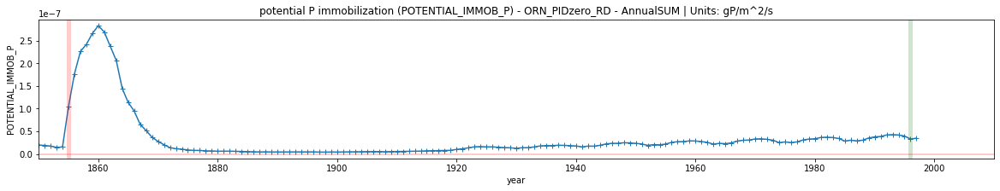

In [85]:

var = "POTENTIAL_IMMOB_P"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'potential denitrification flux'

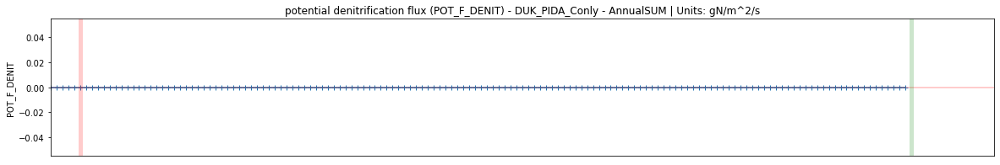

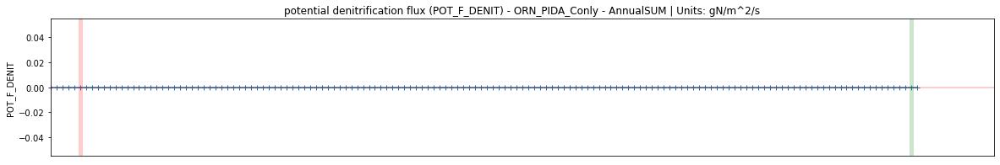

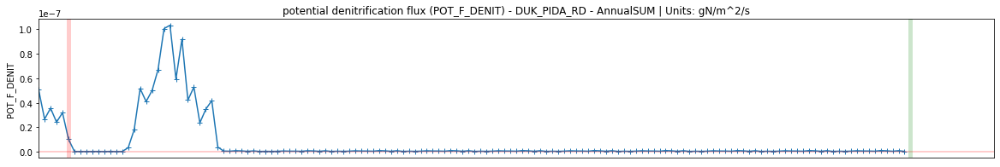

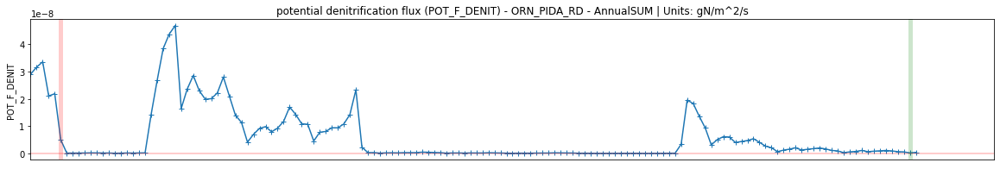

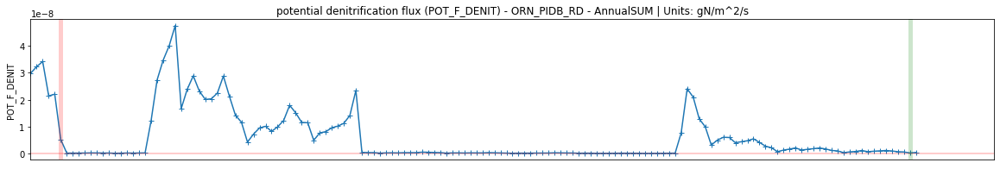

...

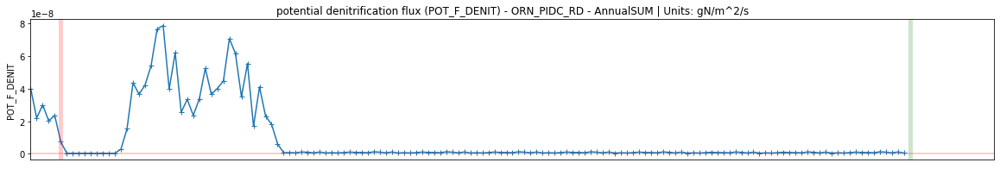

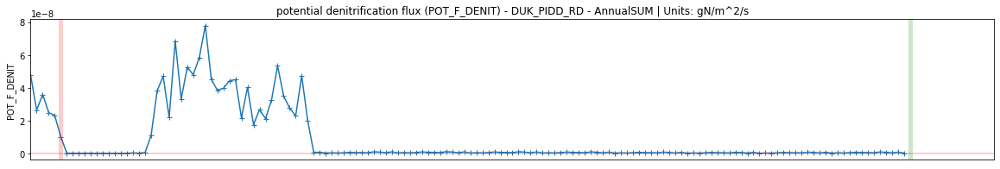

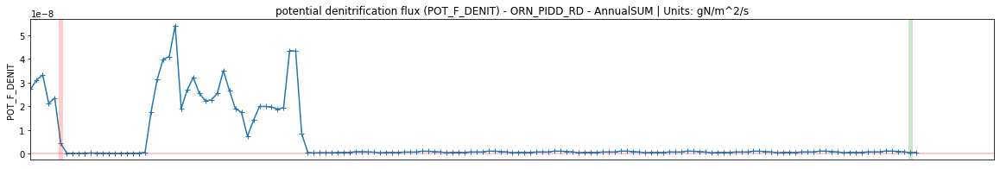

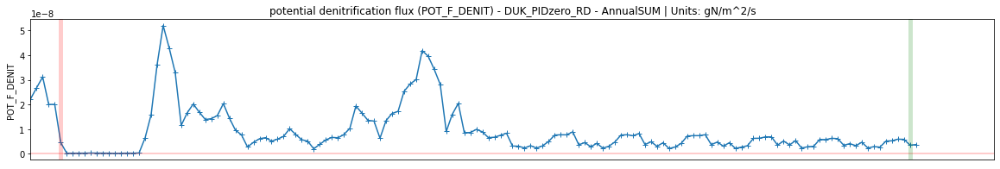

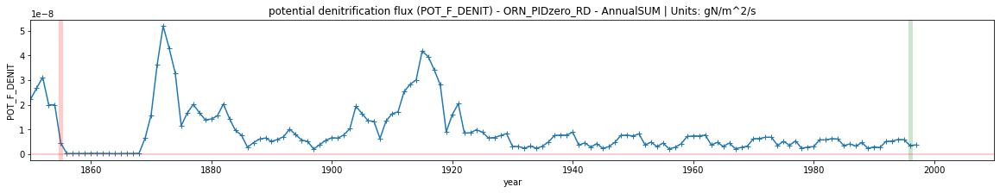

In [86]:

var = "POT_F_DENIT"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'potential nitrification flux'

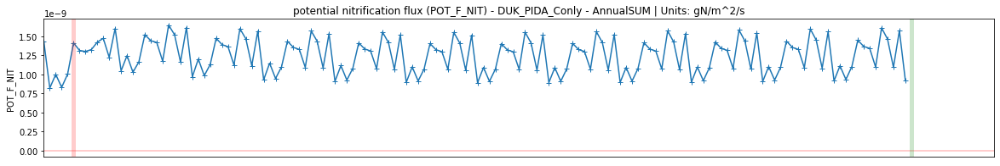

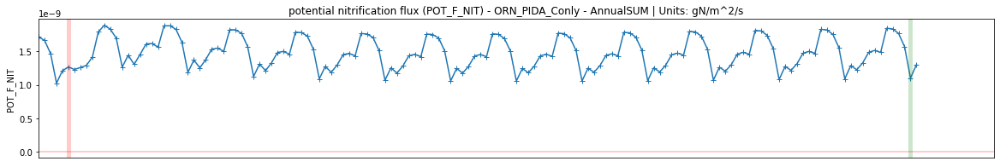

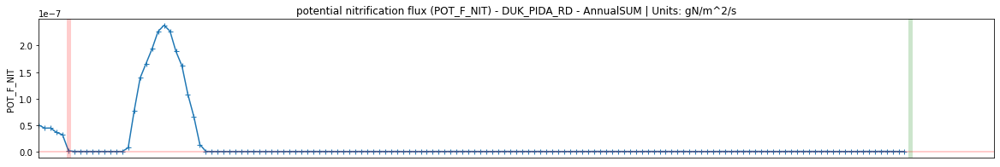

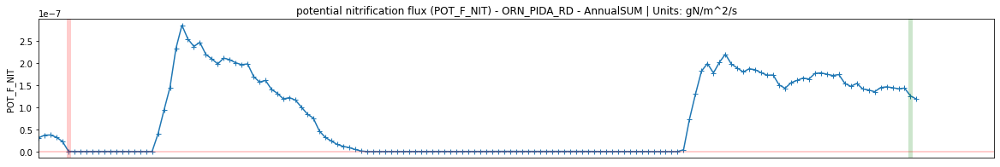

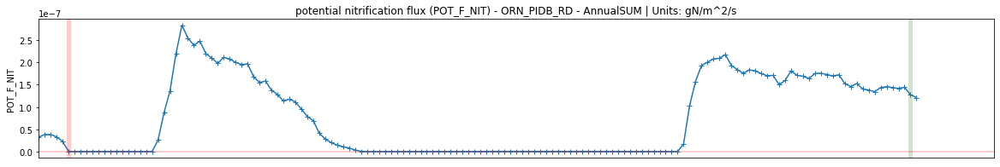

...

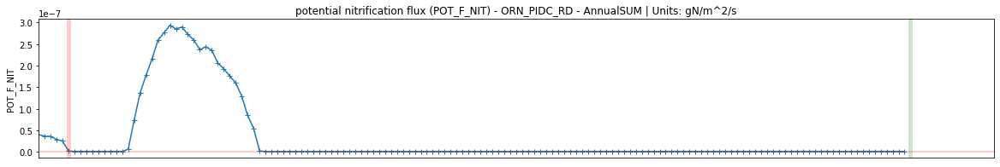

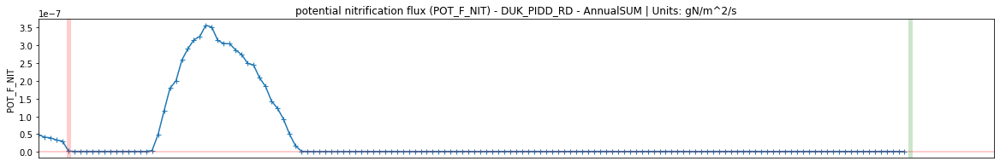

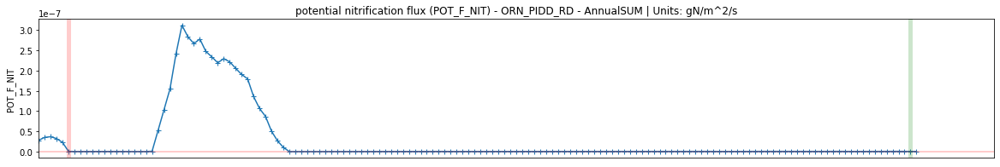

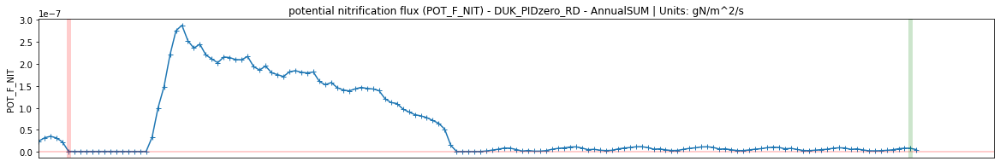

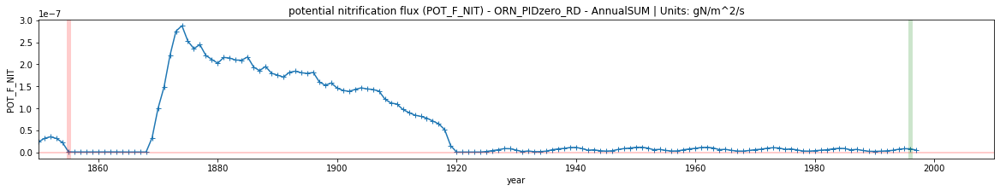

In [87]:

var = "POT_F_NIT"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'perched wt drainage'

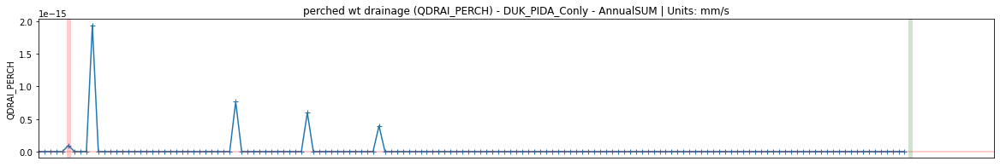

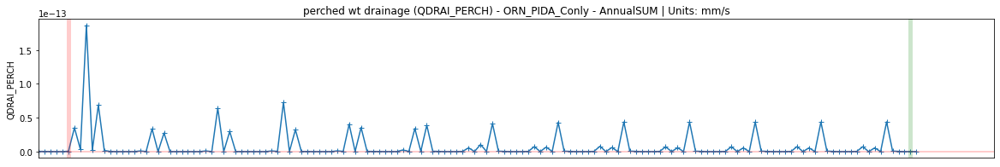

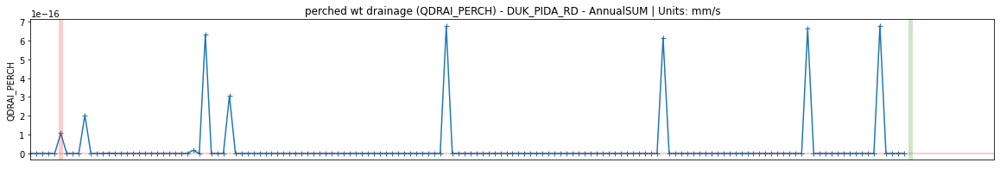

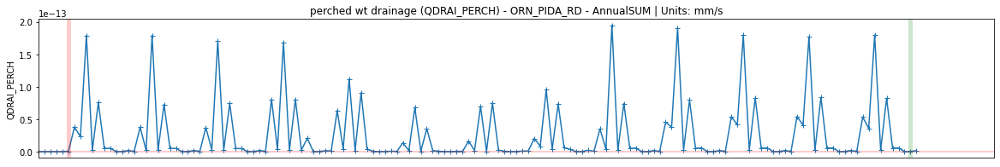

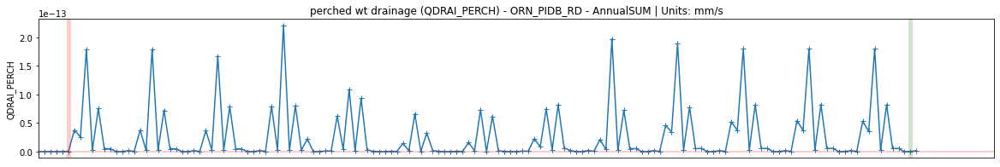

...

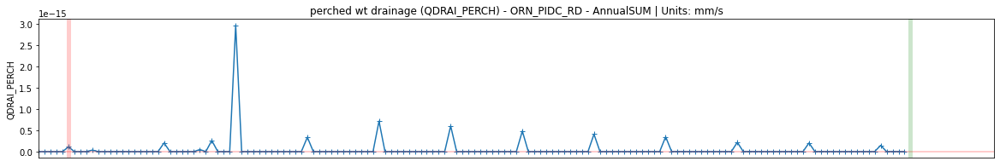

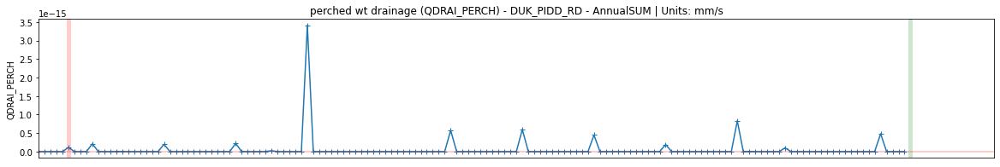

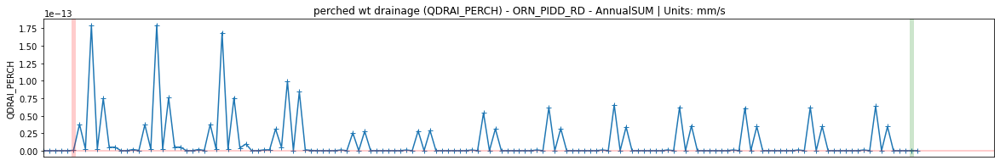

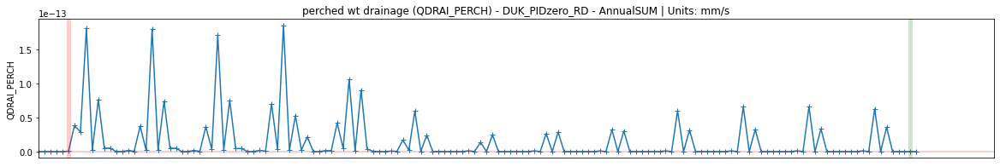

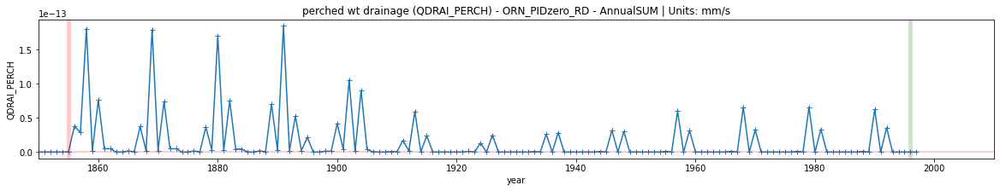

In [88]:

var = "QDRAI_PERCH"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'infiltration'

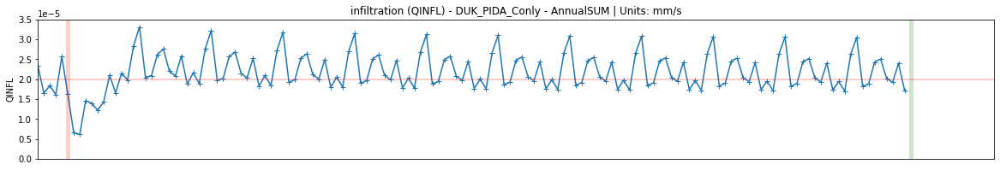

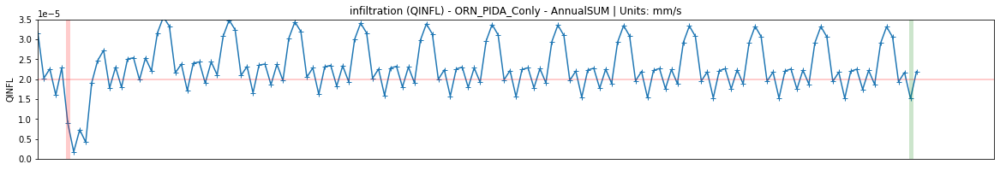

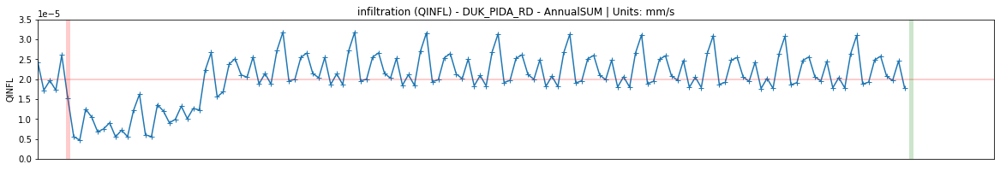

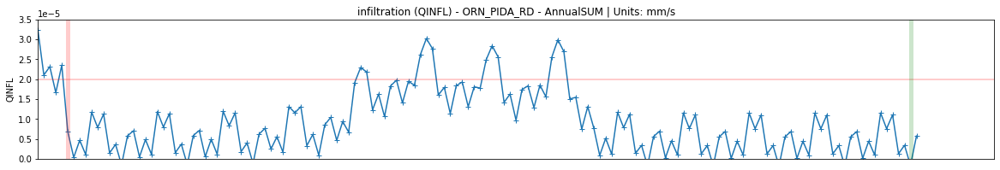

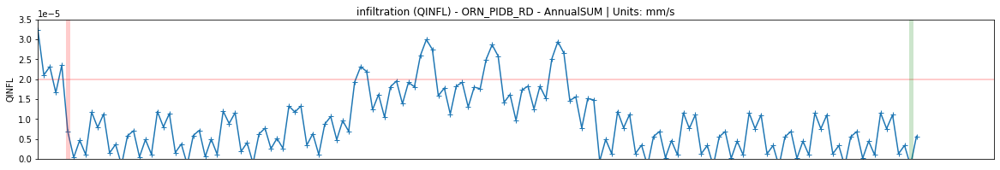

...

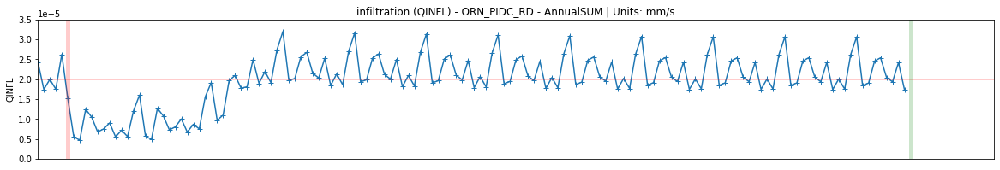

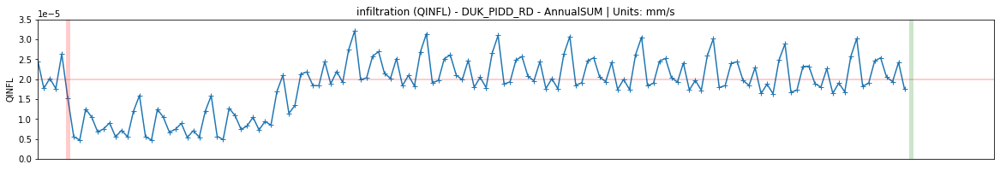

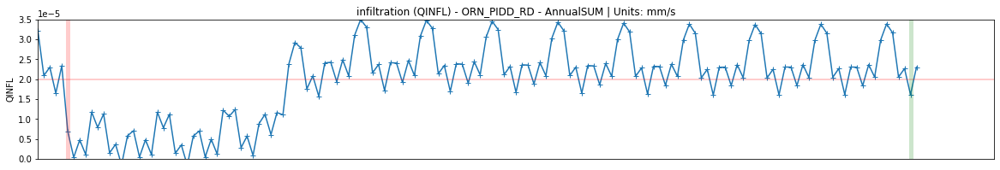

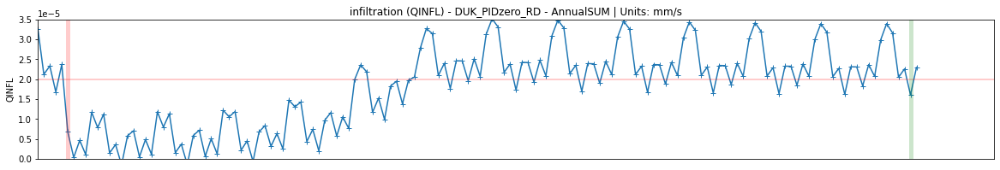

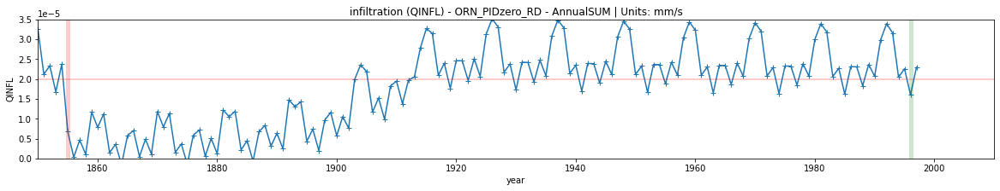

In [89]:

var = "QINFL"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 2e-5, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,3.5e-5)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'soil mineral N'

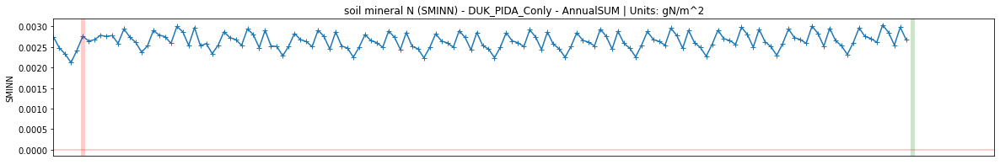

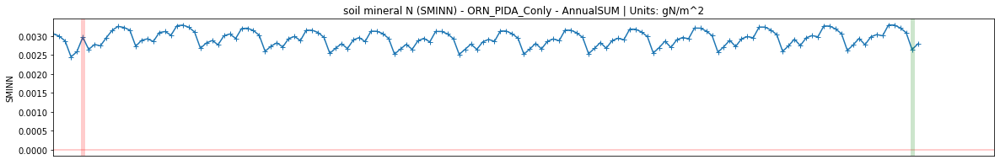

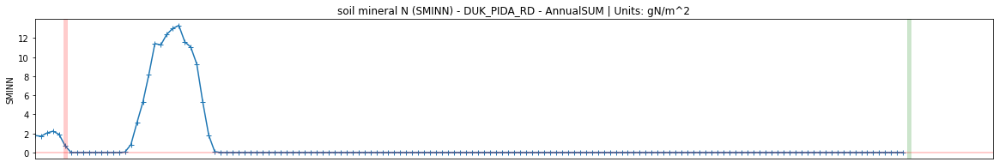

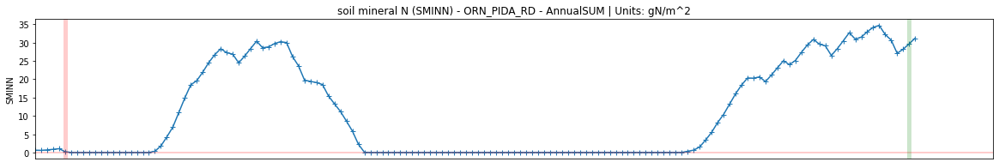

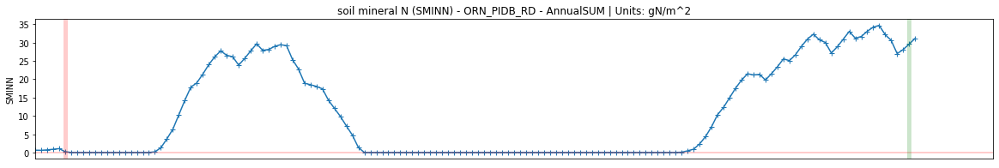

...

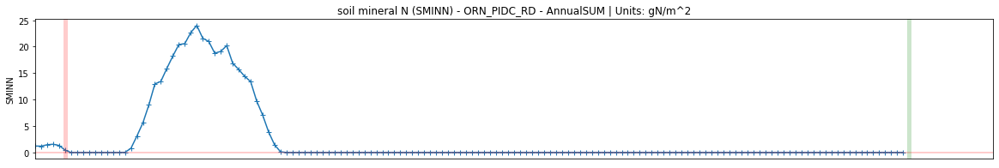

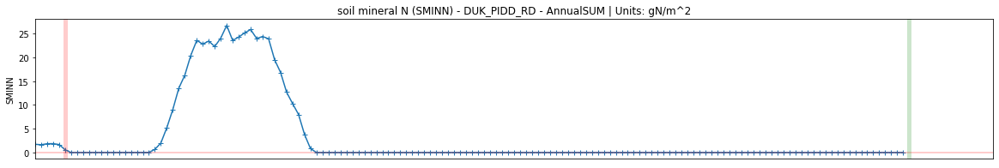

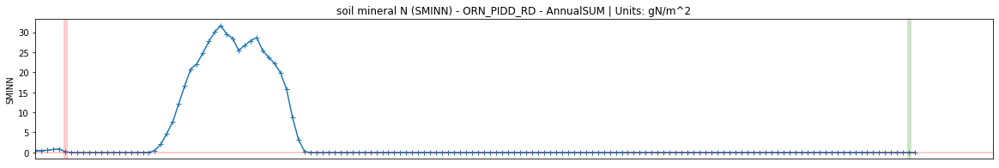

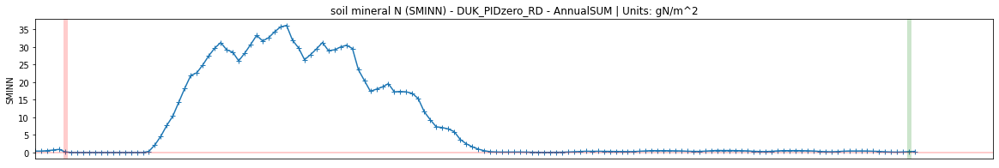

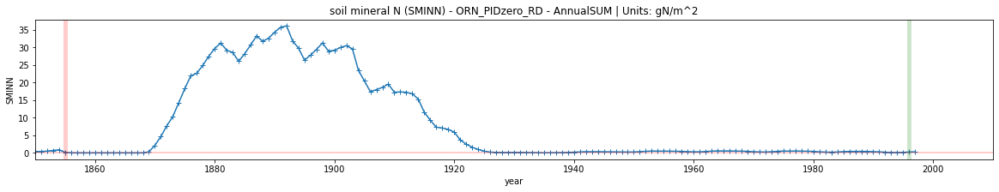

In [90]:

var = "SMINN"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'plant uptake of soil mineral N'

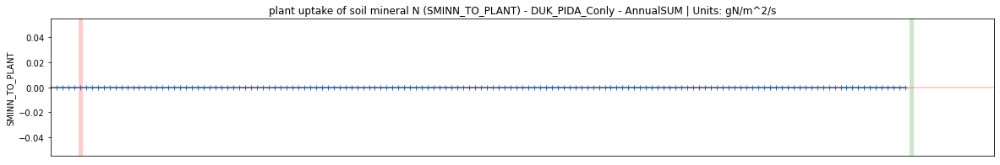

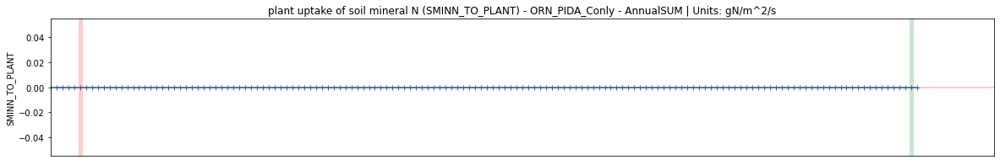

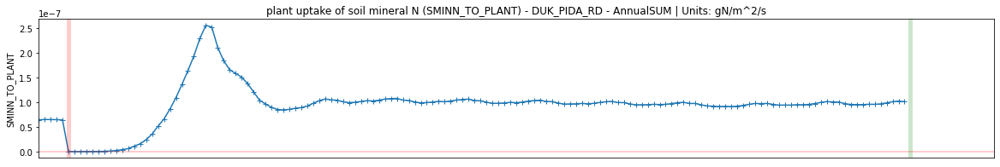

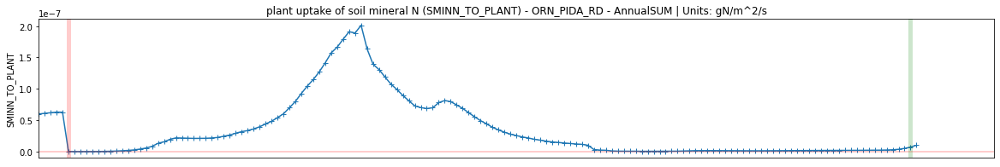

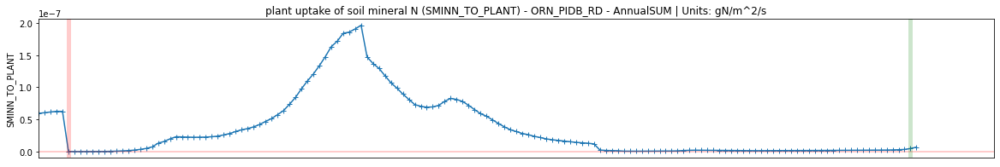

...

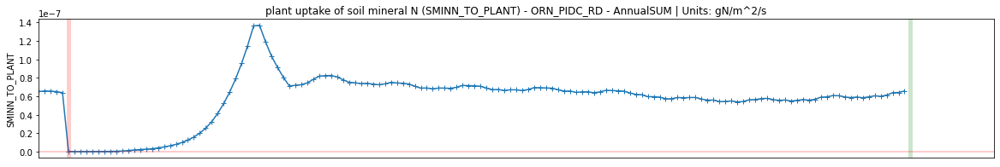

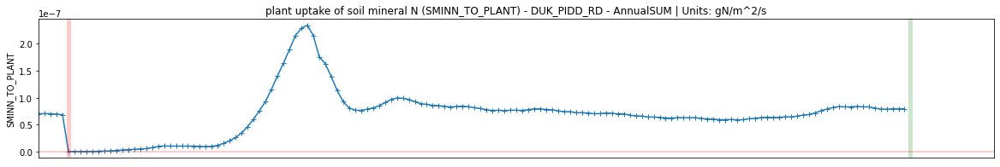

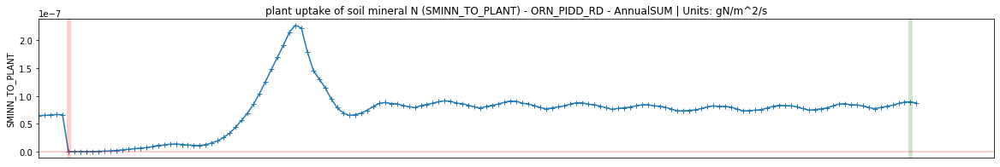

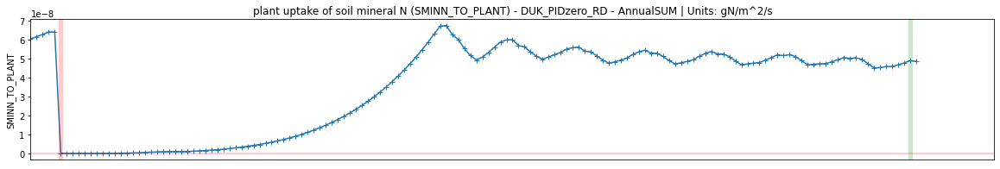

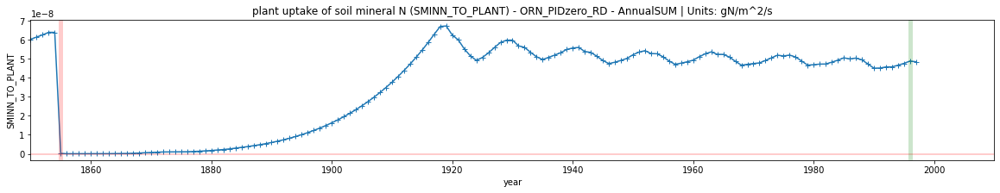

In [91]:

var = "SMINN_TO_PLANT"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'soil mineral P'

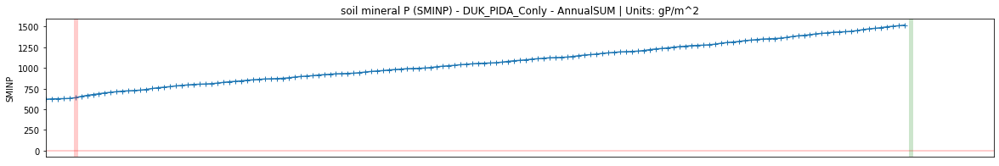

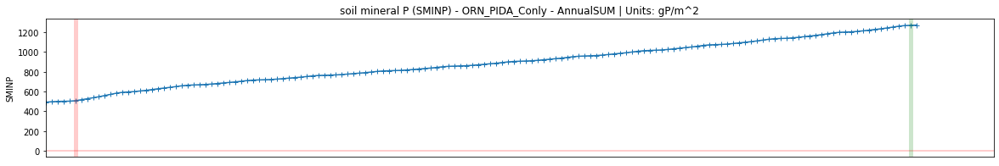

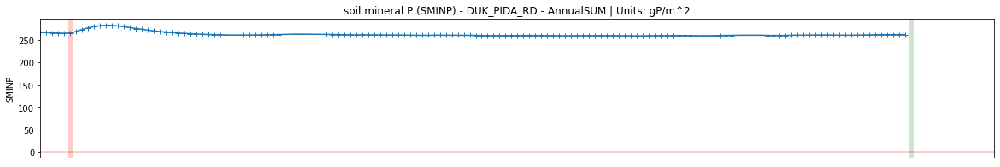

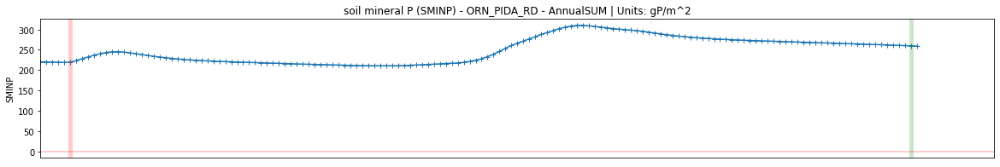

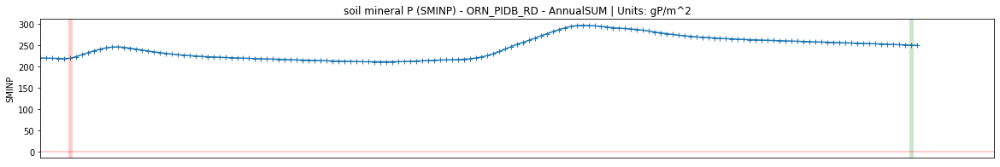

...

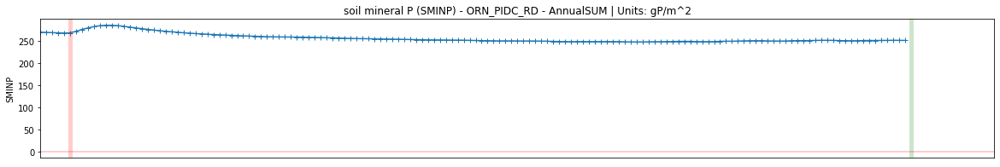

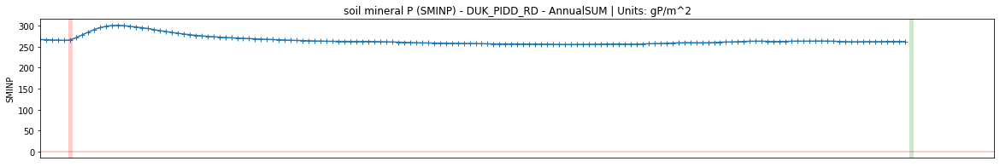

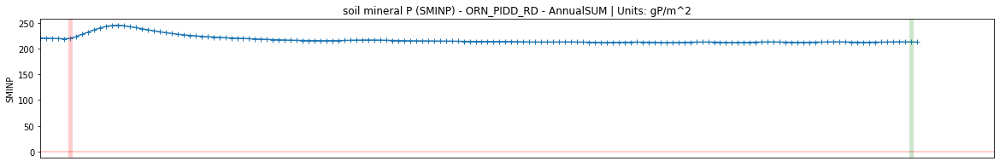

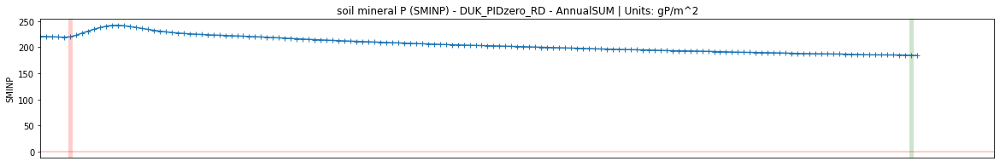

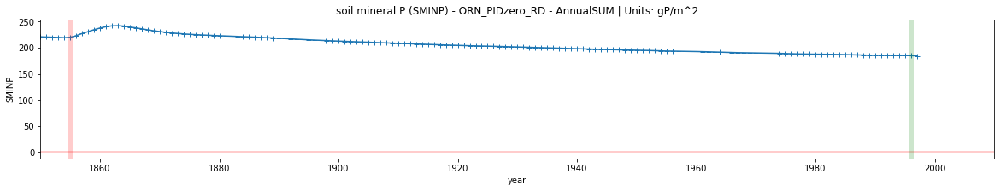

In [92]:

var = "SMINP"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'total projected leaf area index'

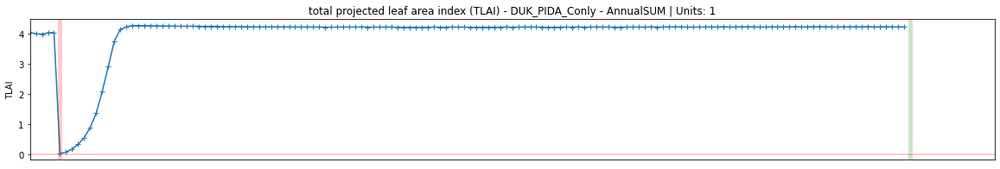

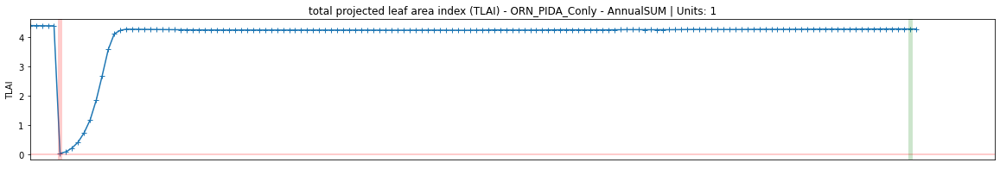

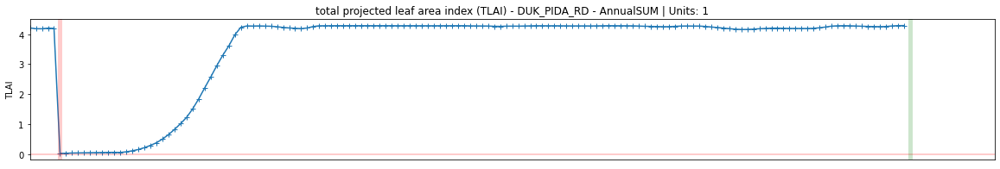

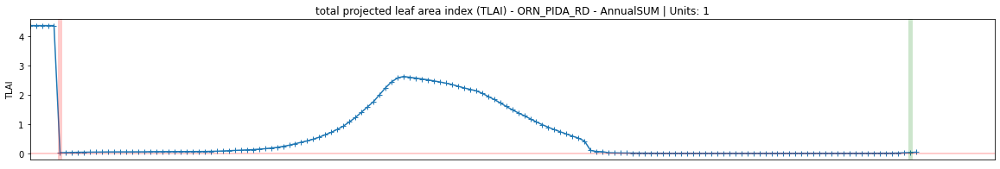

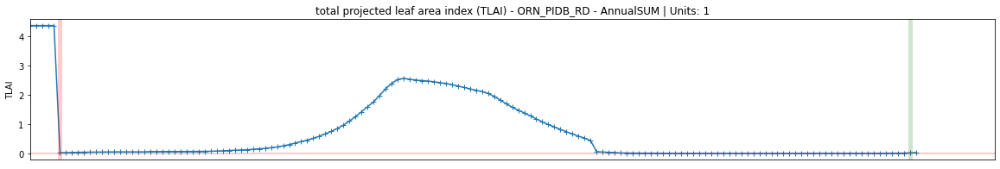

...

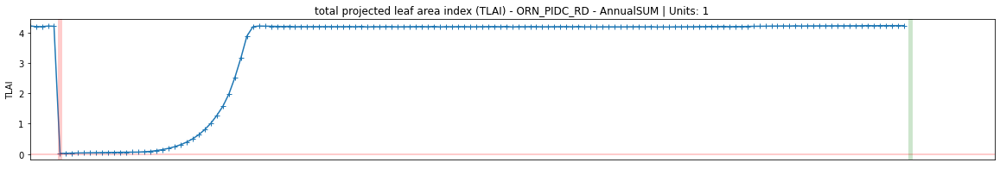

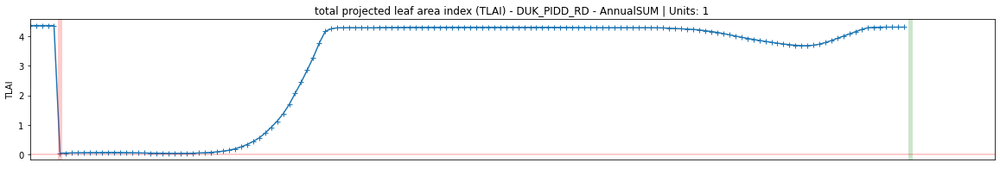

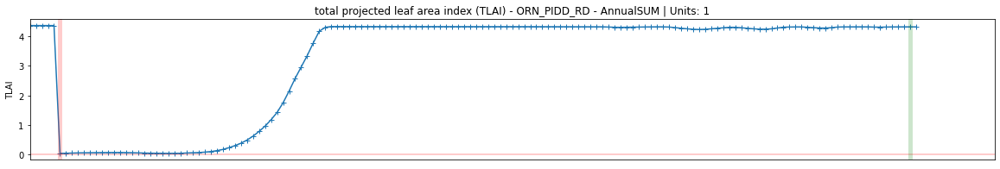

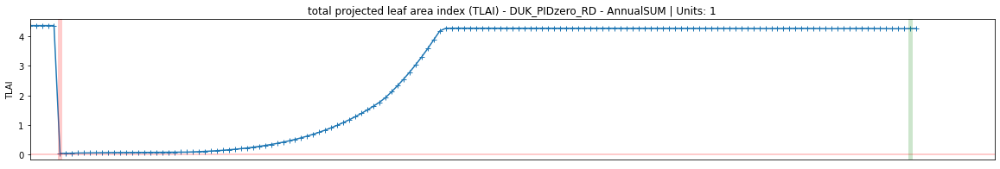

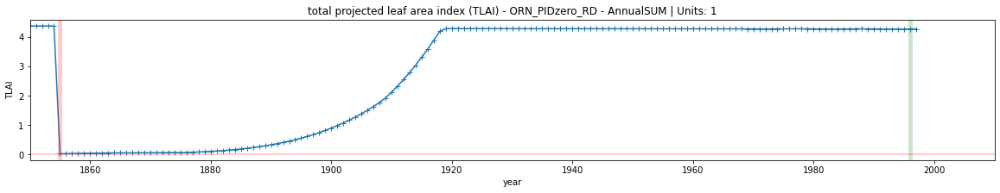

In [93]:

var = "TLAI"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)

ds[key][var].long_name 
# Remarks: 

'total column carbon, incl veg and cpool but excl product pools'

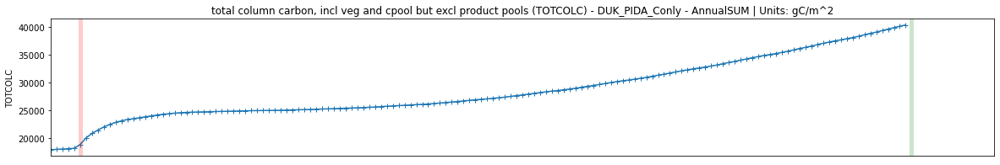

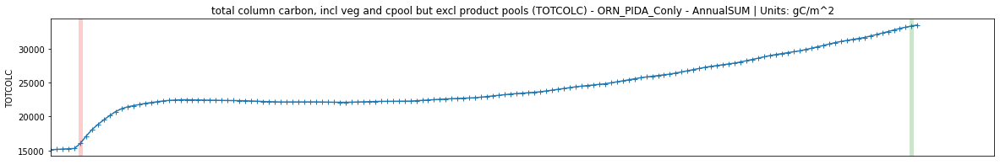

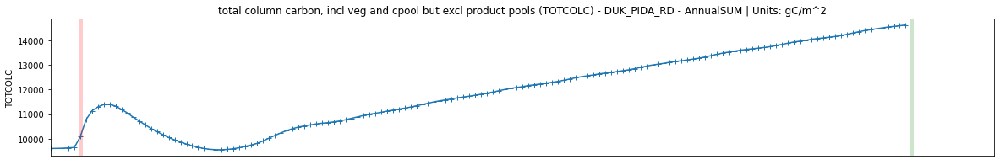

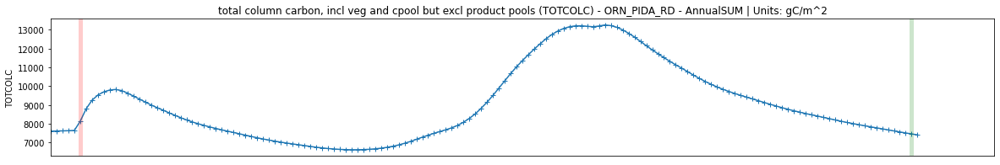

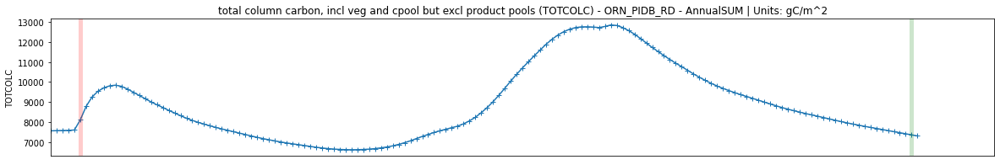

...

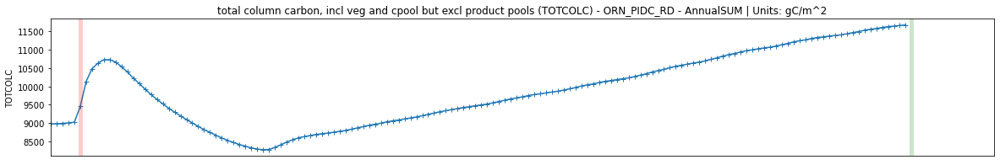

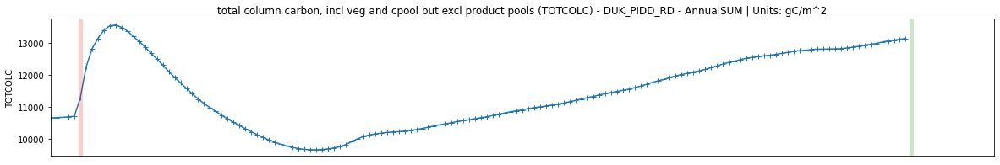

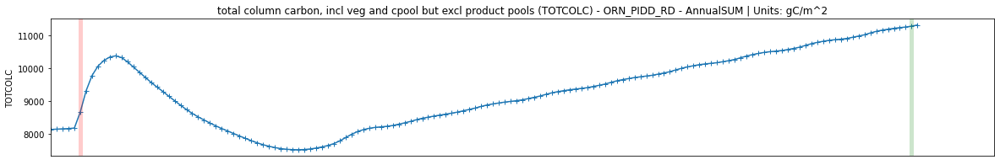

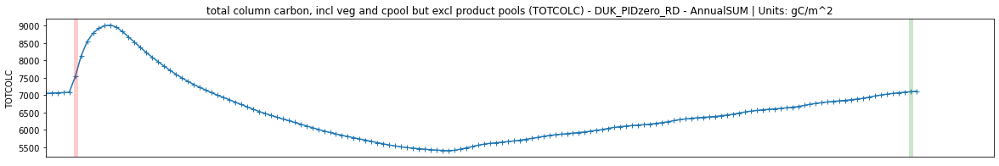

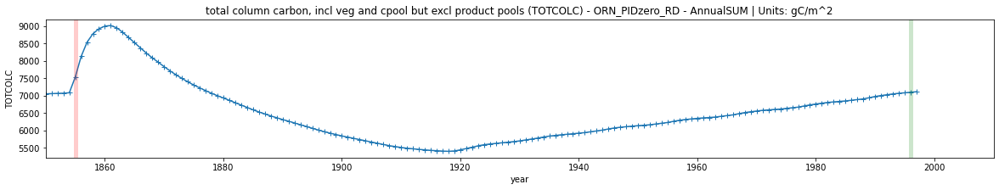

In [94]:
var = "TOTCOLC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    #plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'total ecosystem carbon, incl veg but excl cpool but excl product pools'

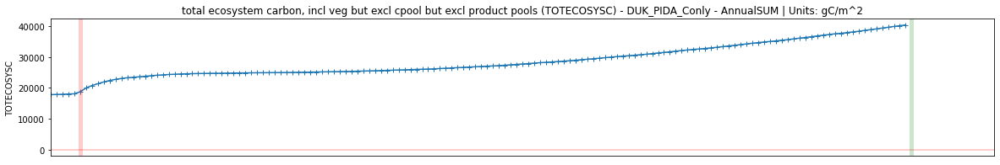

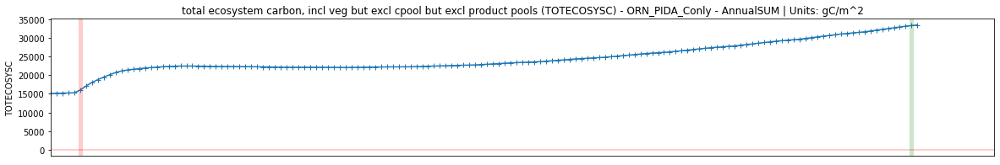

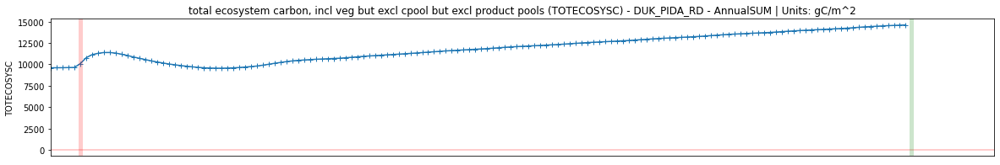

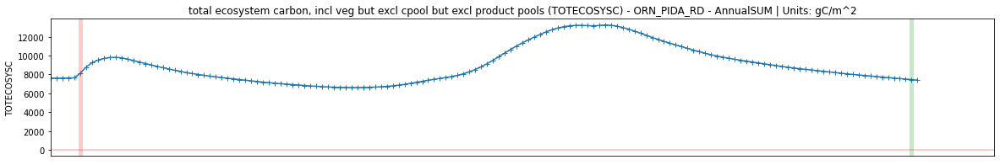

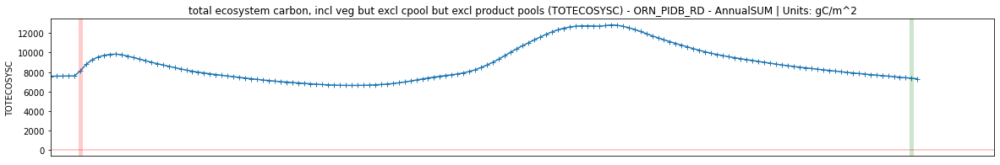

...

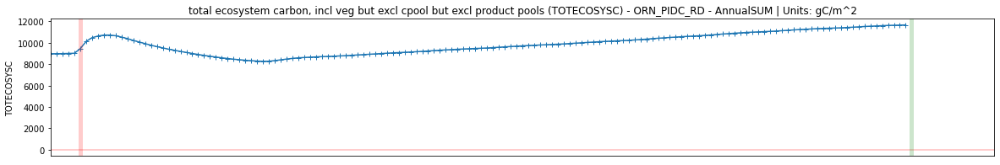

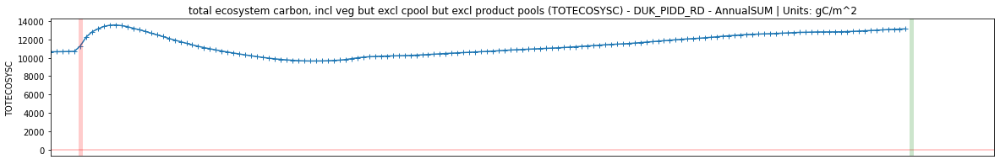

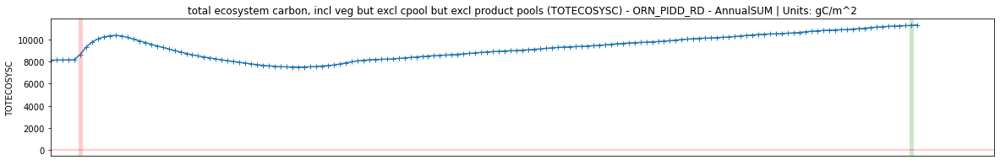

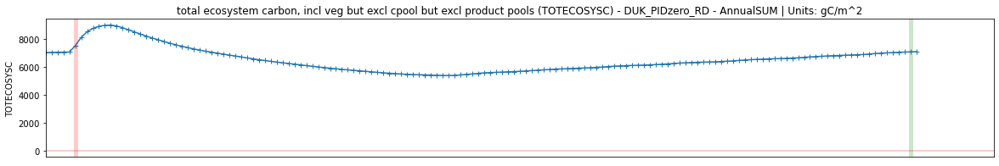

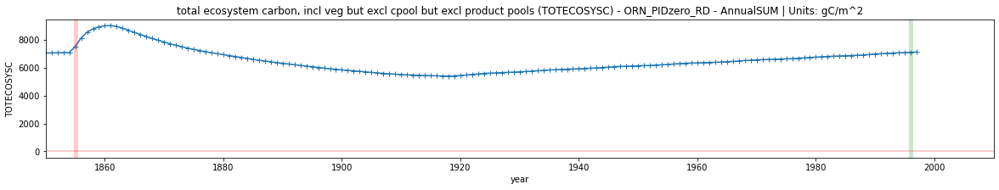

In [95]:

var = "TOTECOSYSC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'total ecosystem N but excl product pools'

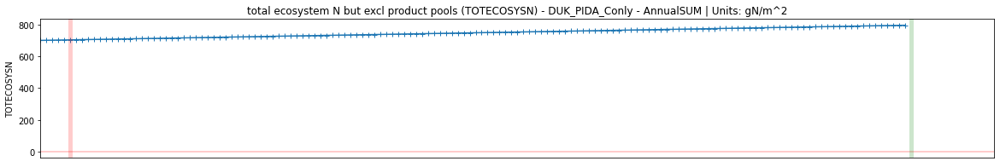

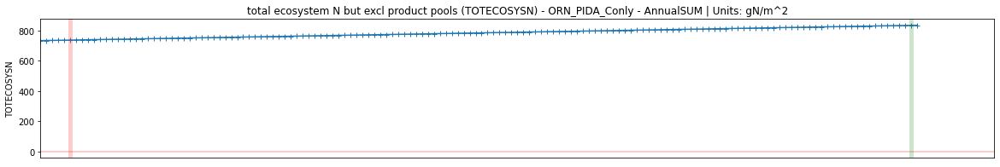

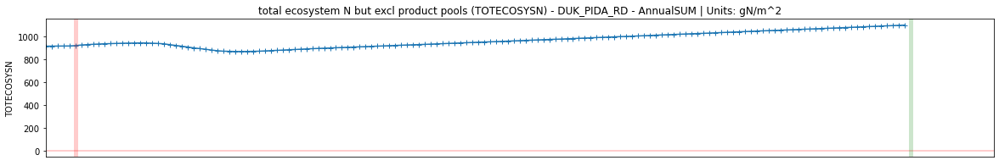

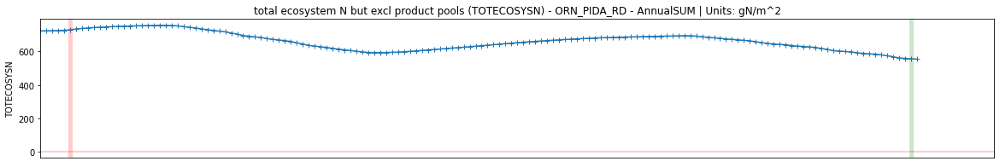

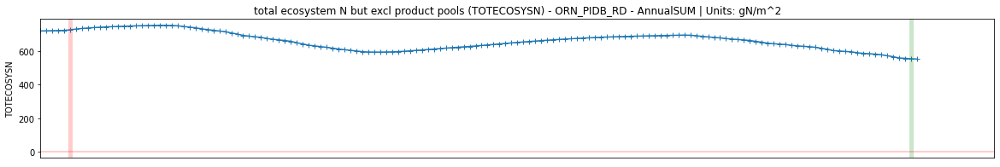

...

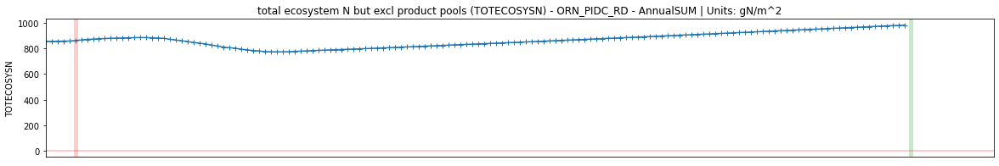

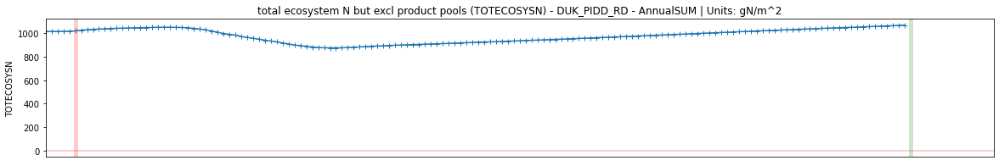

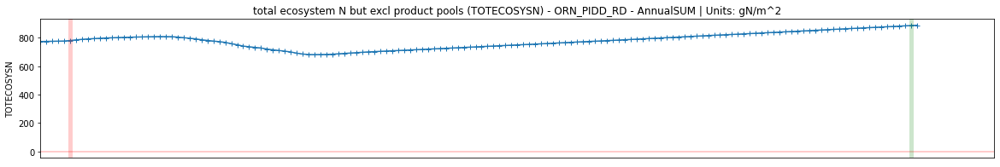

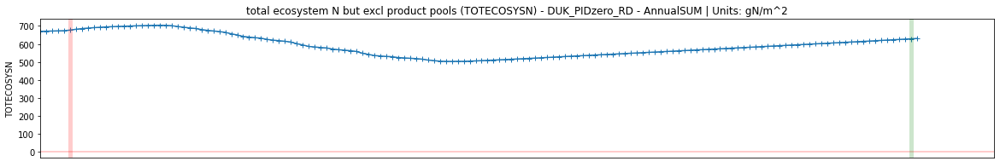

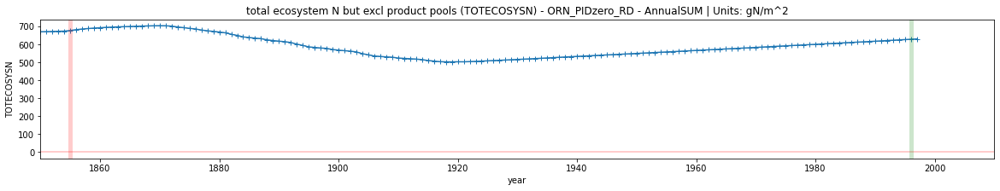

In [96]:

var = "TOTECOSYSN"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks:  

'total ecosystem P but excl product pools'

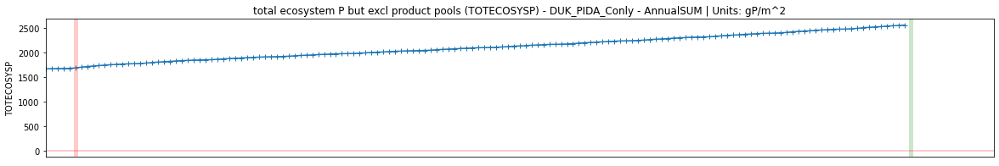

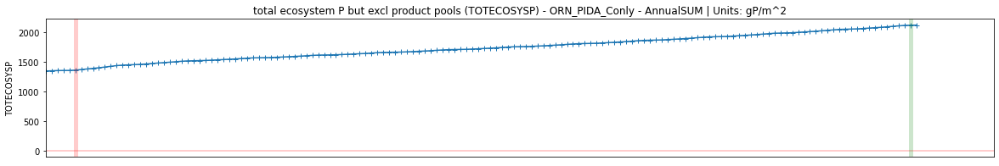

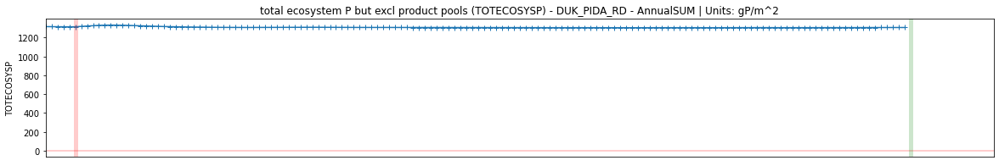

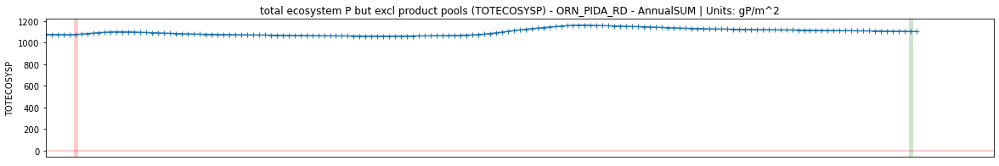

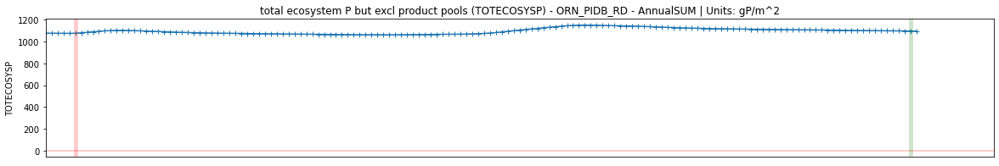

...

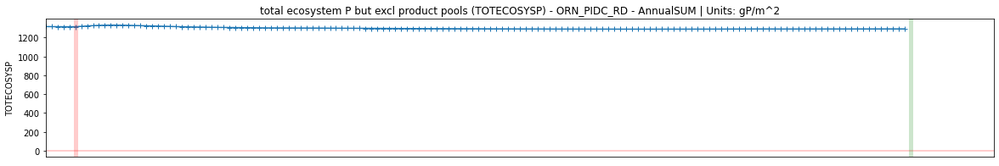

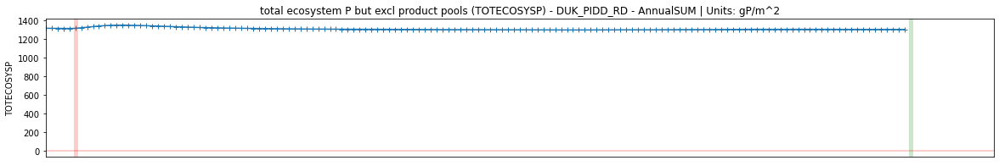

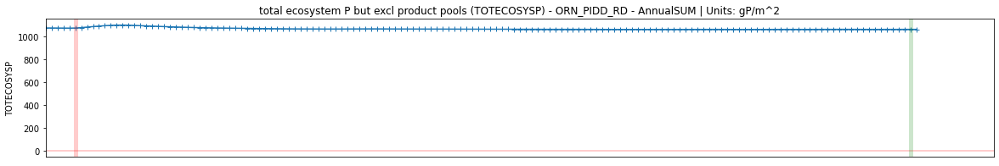

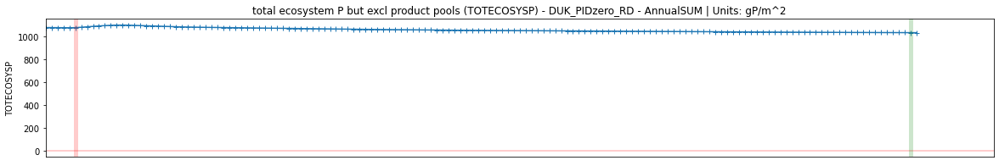

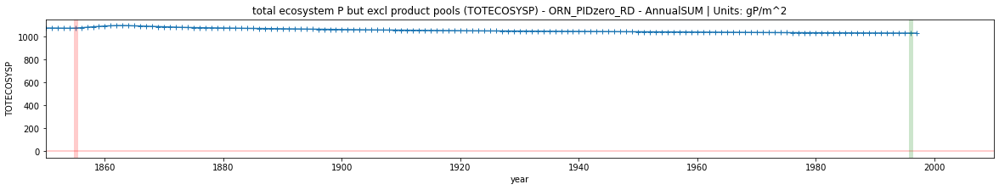

In [97]:

var = "TOTECOSYSP"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'total litter carbon'

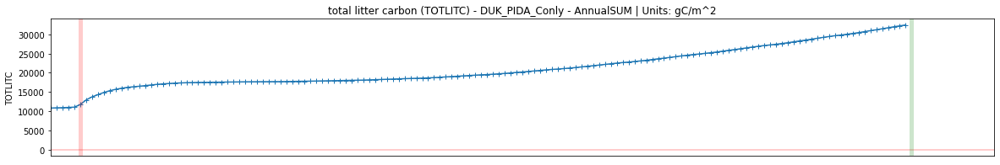

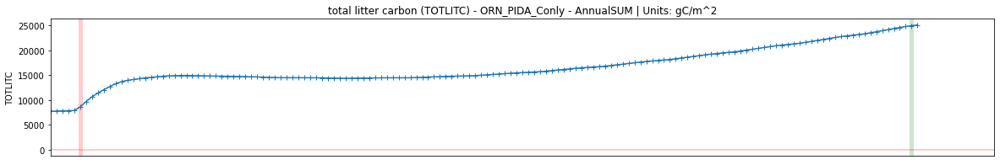

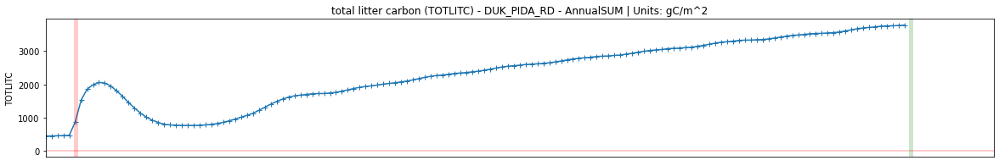

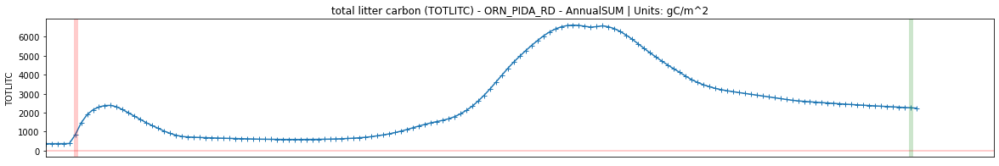

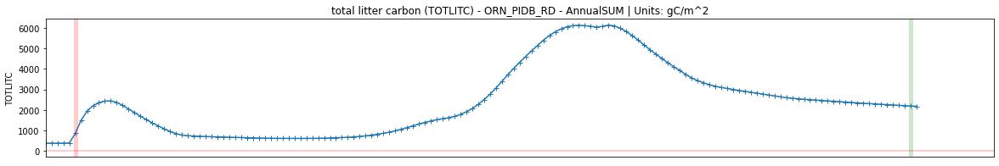

...

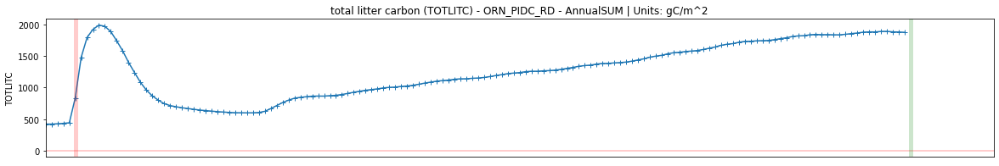

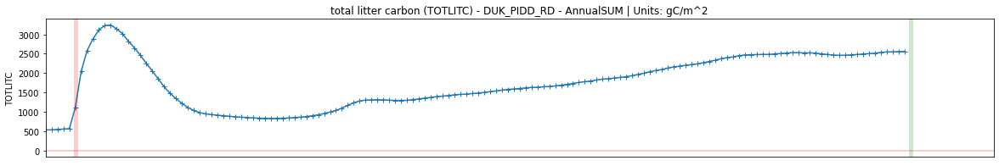

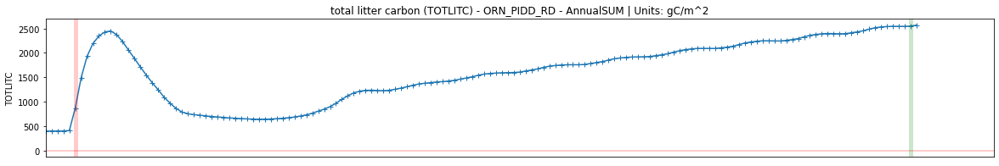

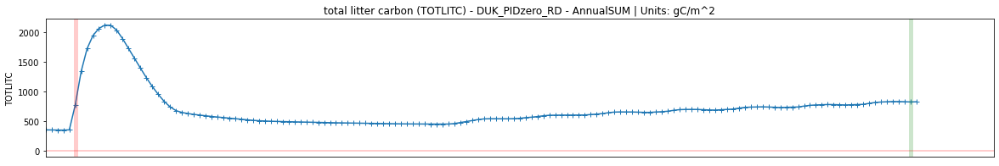

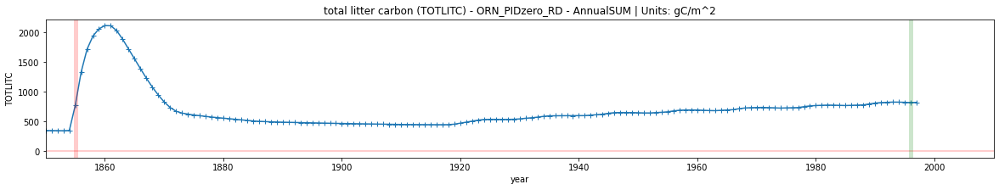

In [98]:


var = "TOTLITC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'total litter N'

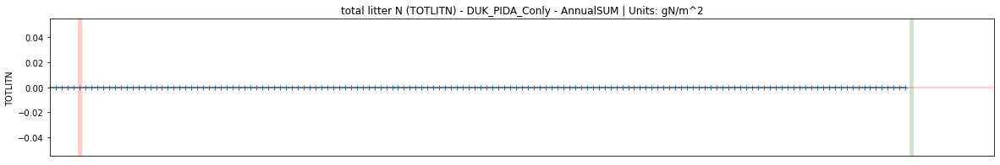

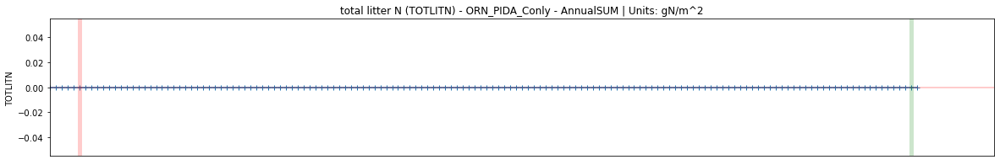

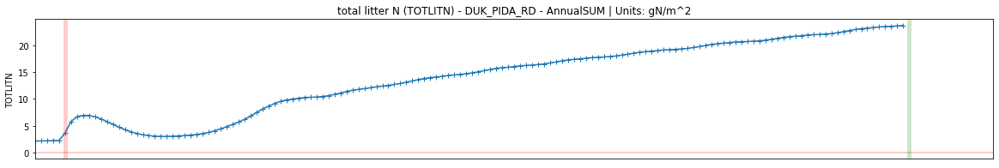

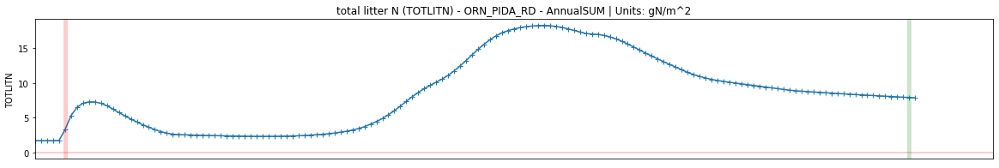

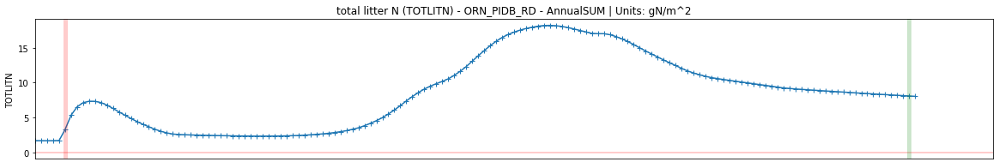

...

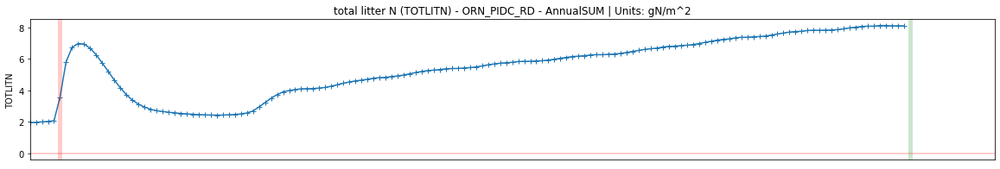

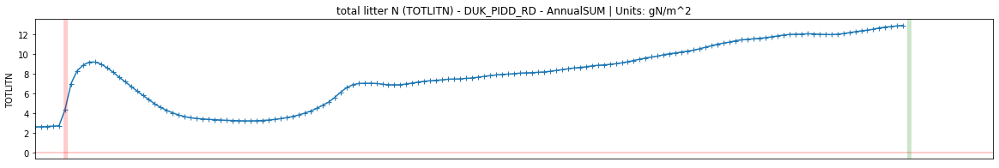

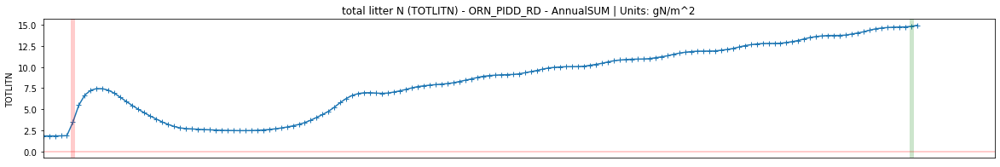

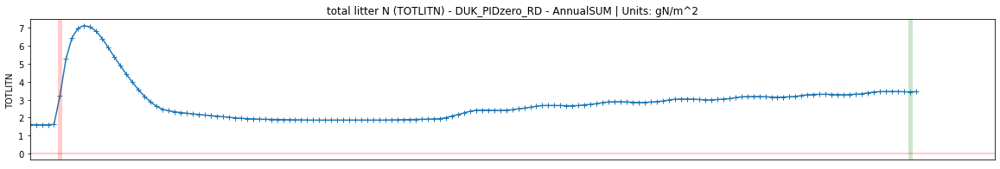

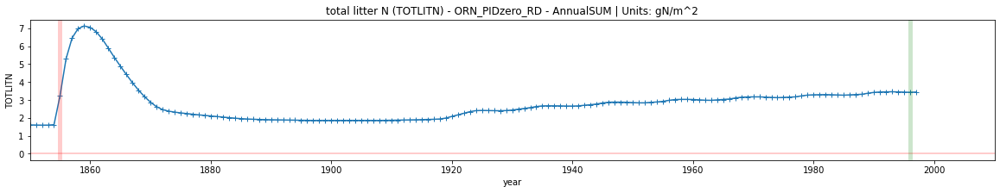

In [99]:
var = "TOTLITN"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks:  

'total litter P'

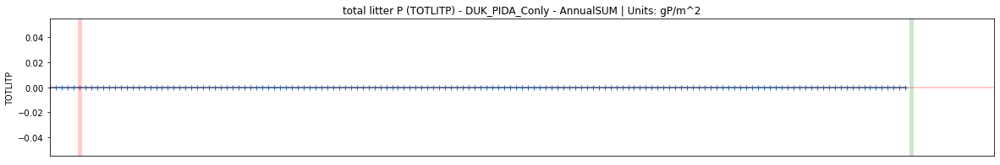

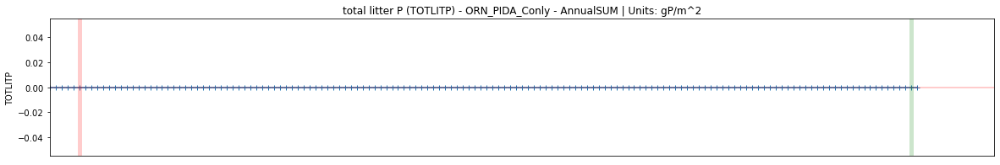

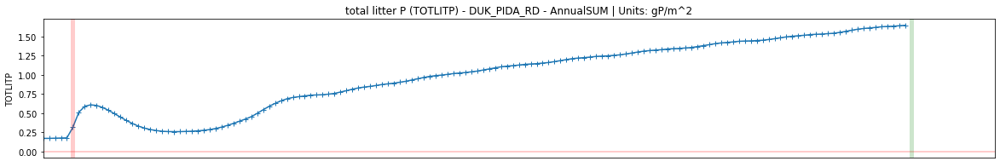

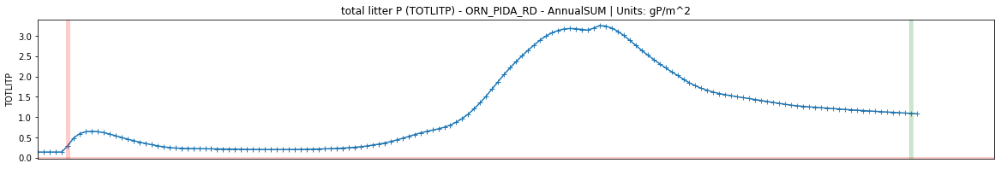

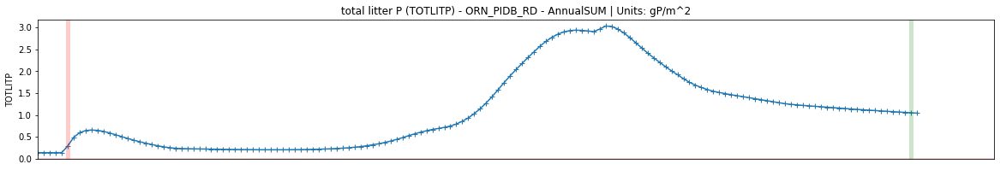

...

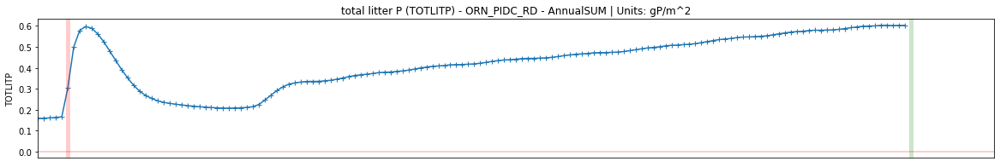

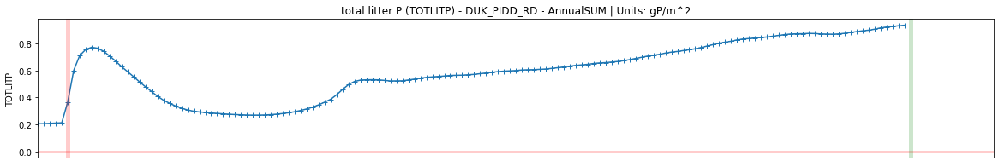

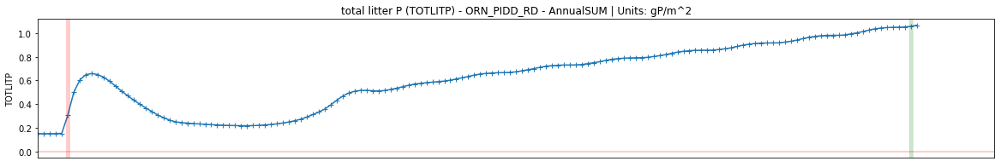

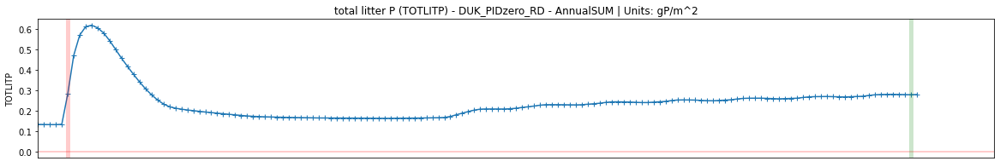

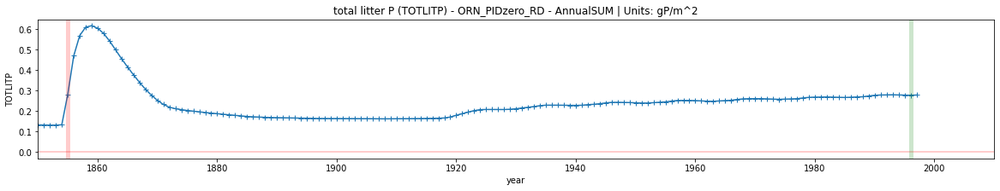

In [100]:
var = "TOTLITP"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'total projected stem area index'

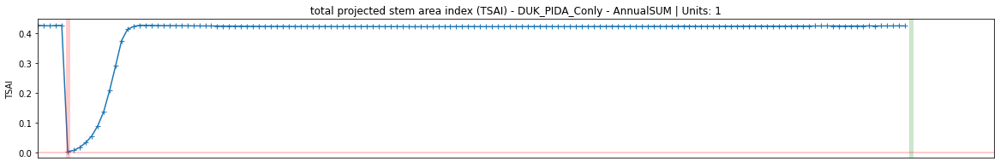

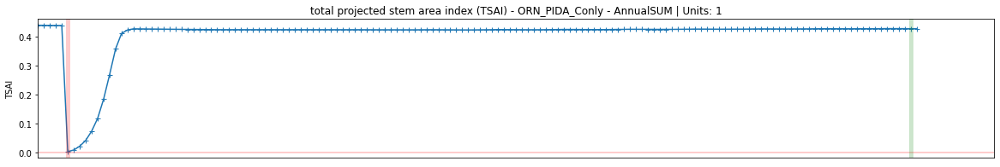

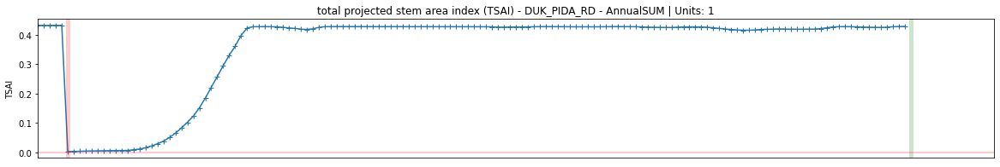

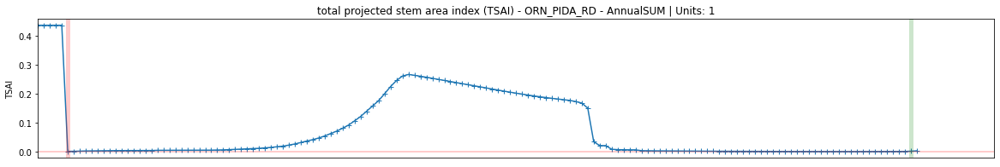

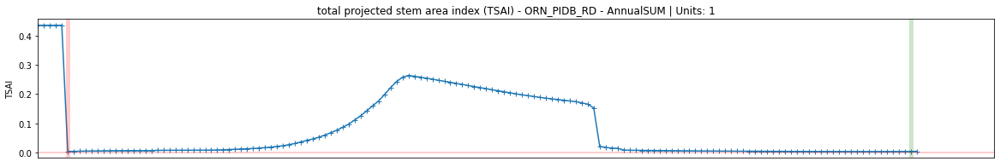

...

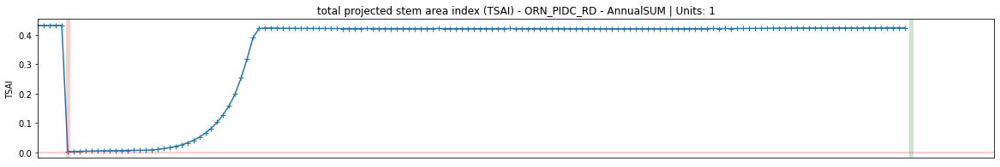

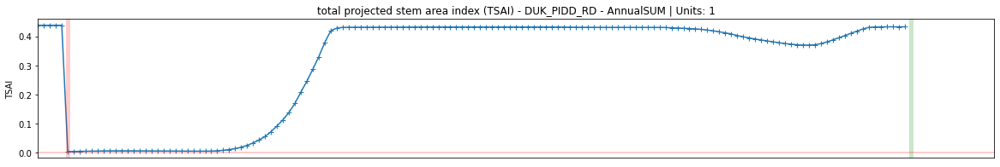

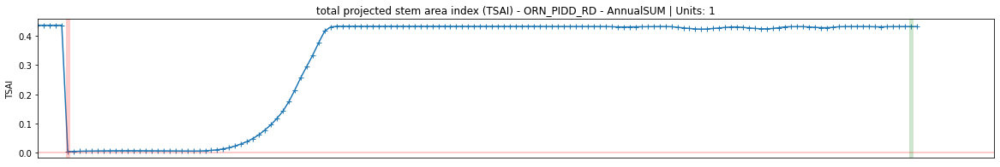

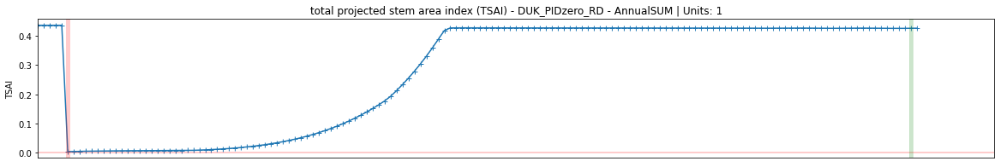

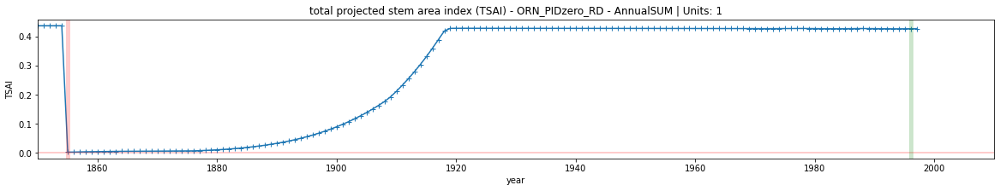

In [101]:
var = "TSAI"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,.8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

## Looking at Biomass variables

The biomass components that remain close to zero for logging under ECA are:
- FATES_CANOPY_VEGC
- FATES_DEMOTION_CARBONFLUX
- FATES_LEAFC
- FATES_MORTALITY_CFLUX_CANOPY
- FATES_MORTALITY_CFLUX_USTORY
- FATES_NONSTRUCTC
- FATES_SAPWOODC
- FATES_STOREC
- FATES_STRUCTC (slow recovery for C only)
- FATES_USTORY_VEGC
- FATES_VEGC (slow recovery for C only)
- FATES_VEGC_ABOVEGROUND (slow recovery for C only)

Non-Zero are:
- FATES_FROOTC (full recovery)

Zero after logging (C and ECA):
- FATES_PROMOTION_CARBONFLUX


### both the fluxes as well as carbon pools are low for ECA. 


'biomass of canopy plants in kg carbon per m2 land area'

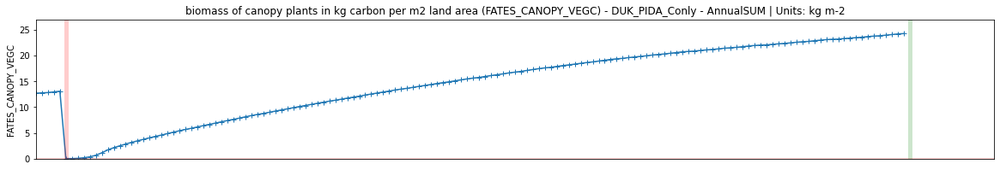

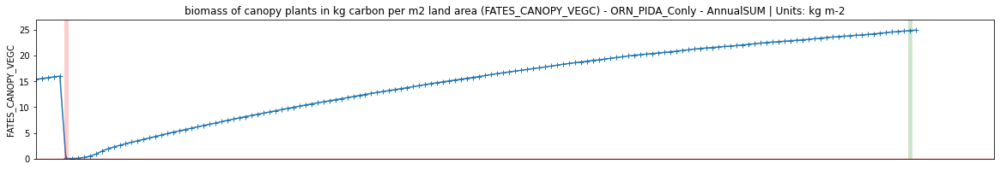

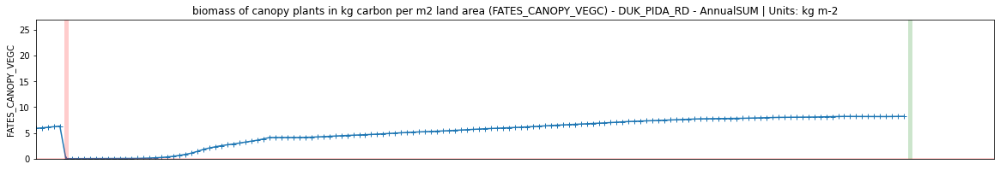

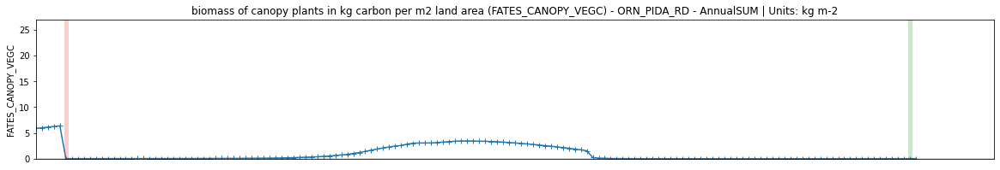

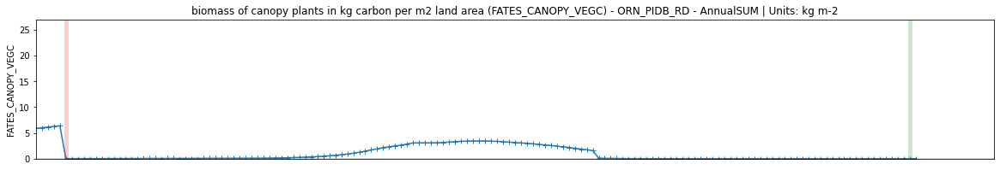

...

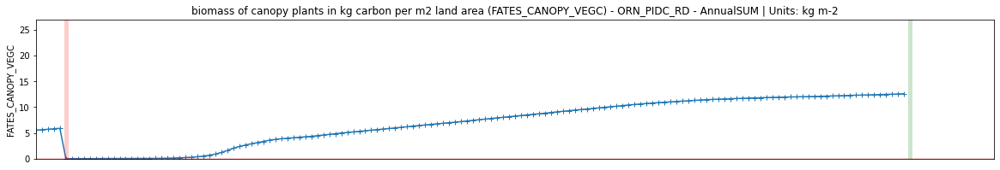

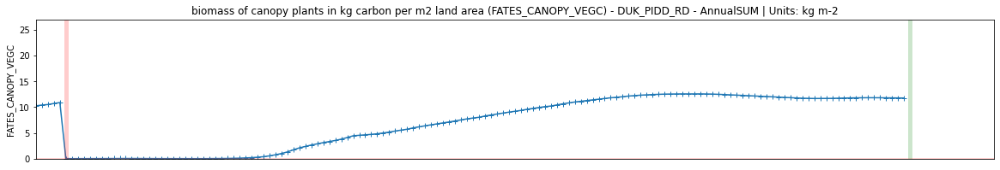

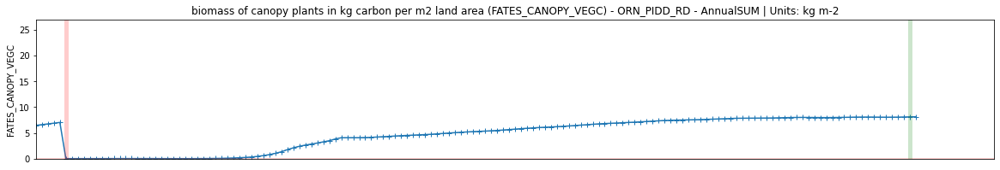

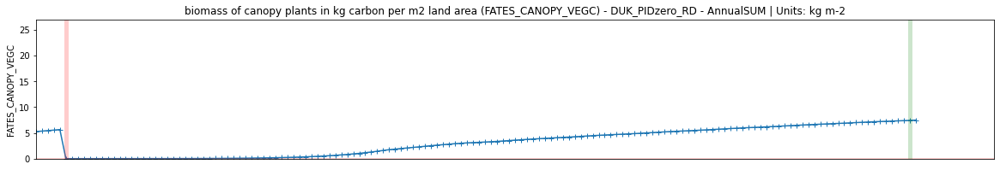

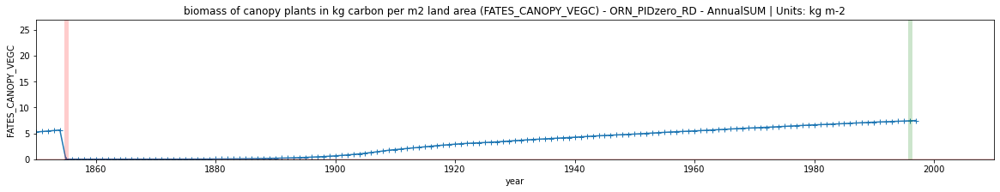

In [102]:
var = "FATES_CANOPY_VEGC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,27)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
        
ds[key][var].long_name 
# Remarks: 

'demotion-associated biomass carbon flux from canopy to understory in kg carbon per m2 per second'

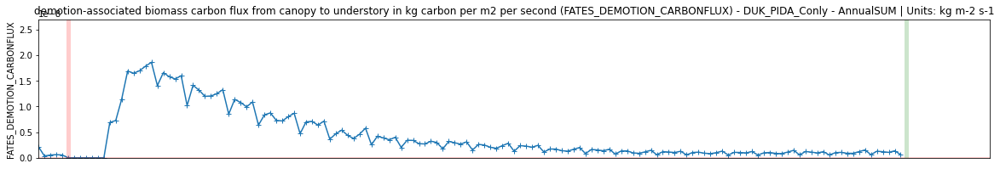

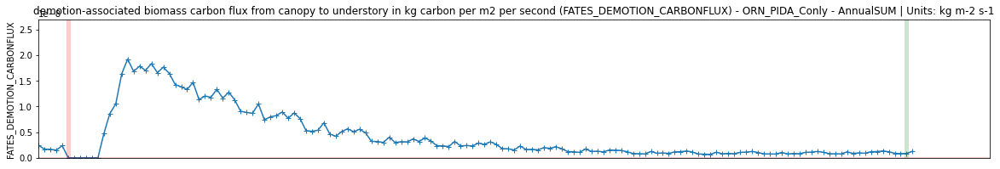

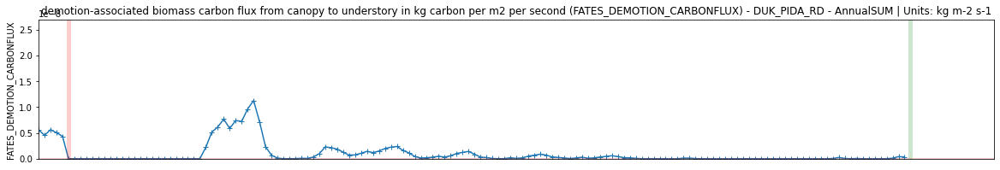

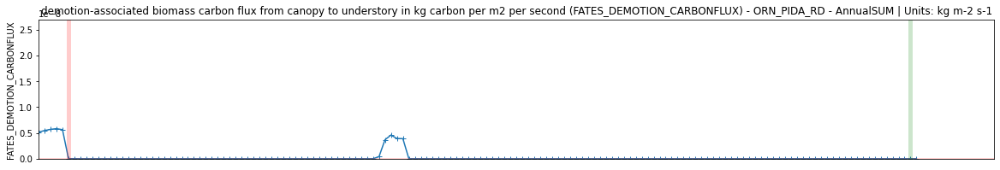

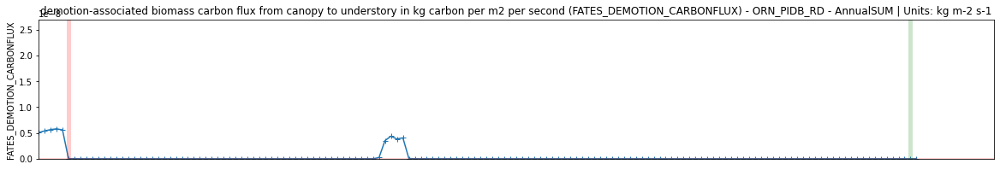

...

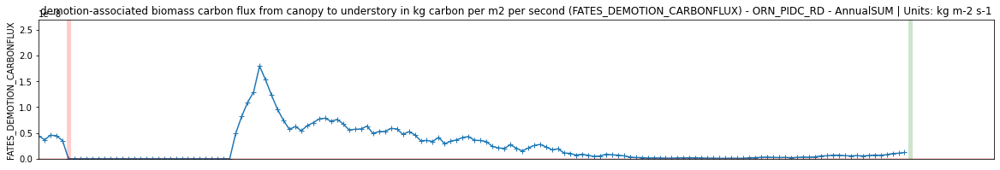

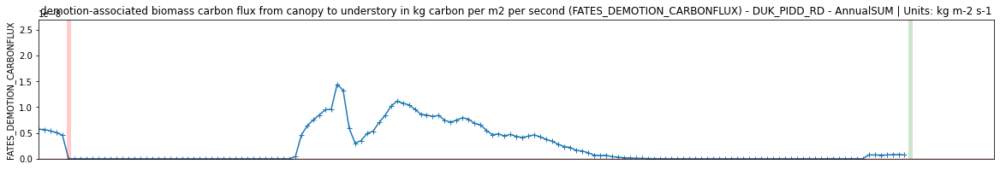

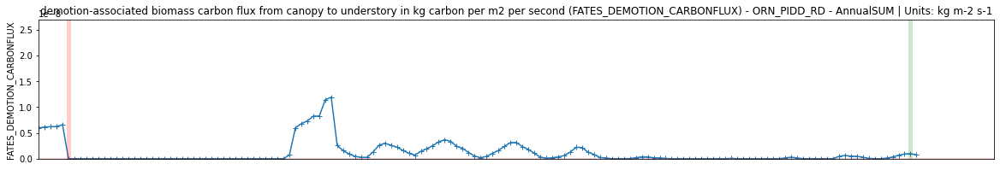

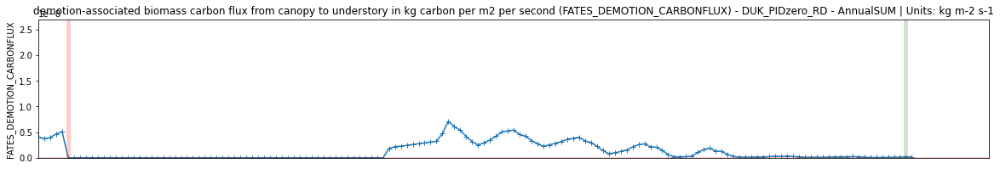

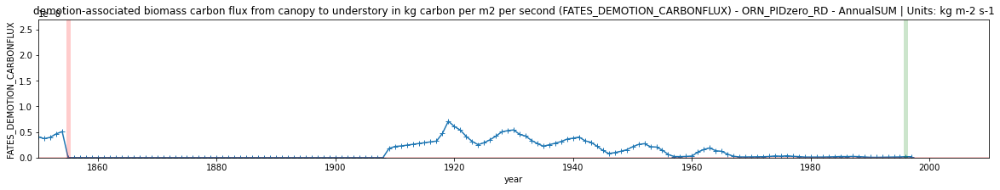

In [103]:
var = "FATES_DEMOTION_CARBONFLUX"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,2.7e-8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
        
ds[key][var].long_name 
# Remarks: 

'total biomass in live plant fine roots in kg carbon per m2'

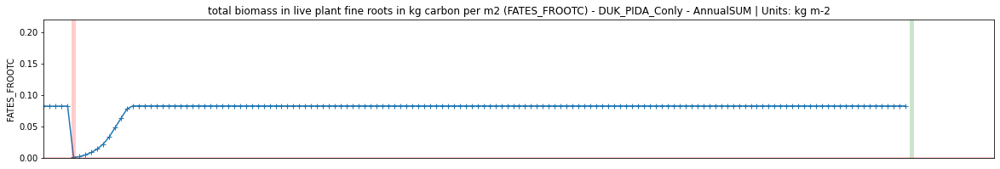

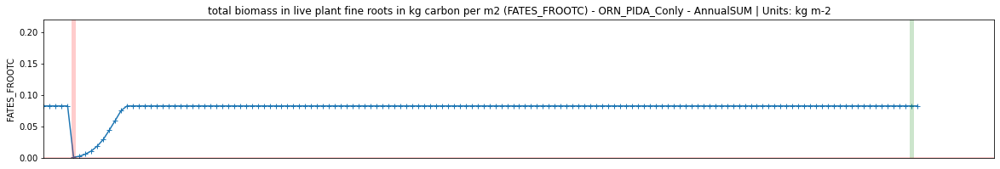

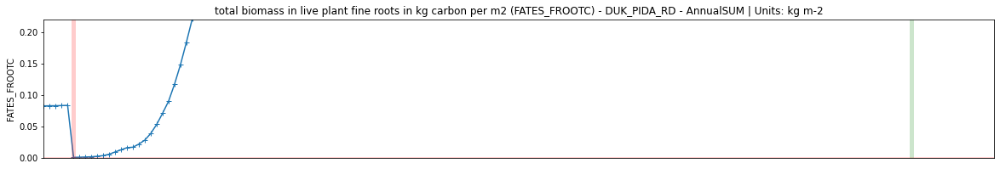

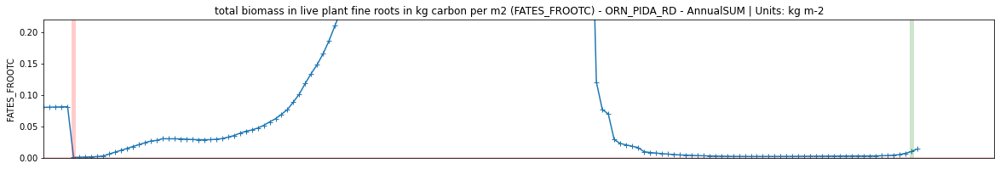

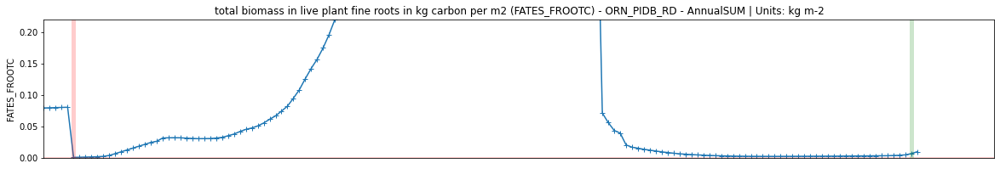

...

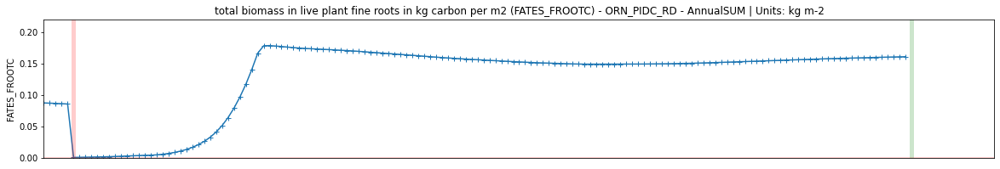

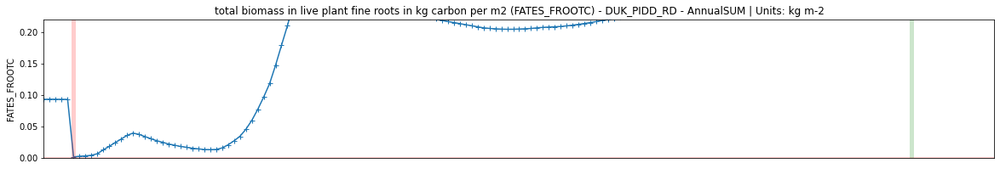

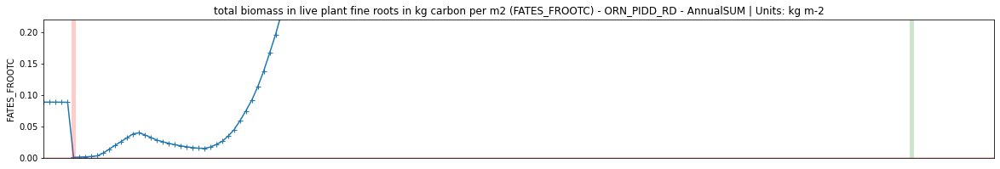

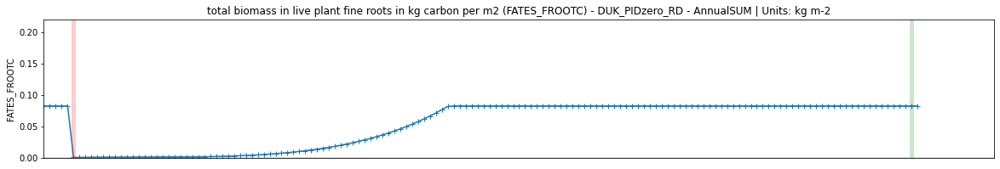

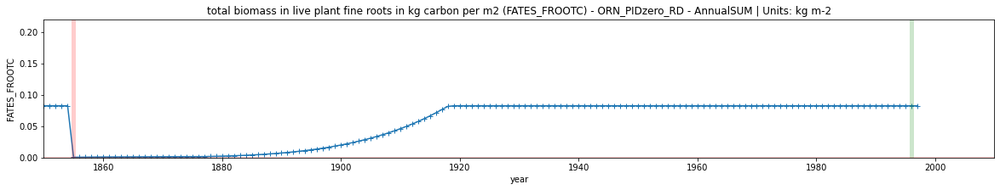

In [104]:

var = "FATES_FROOTC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,.22)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)

ds[key][var].long_name 
# Remarks: 

'total biomass in live plant leaves in kg carbon per m2'

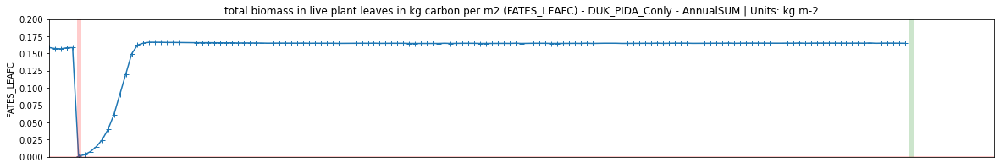

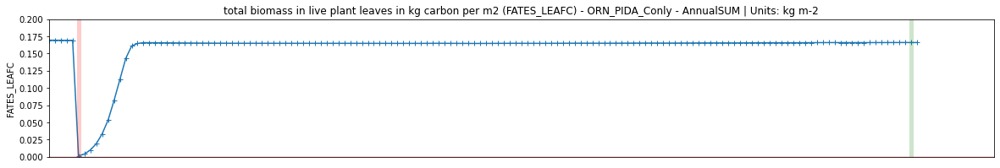

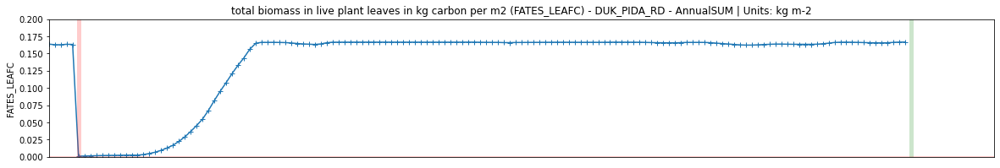

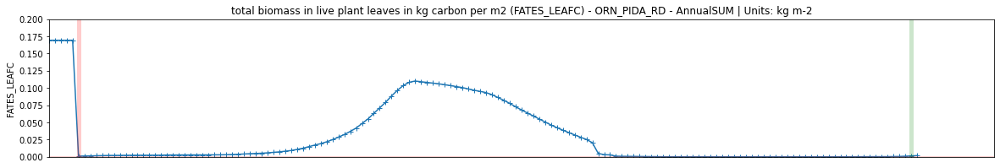

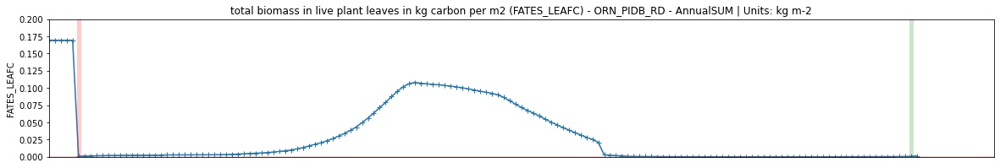

...

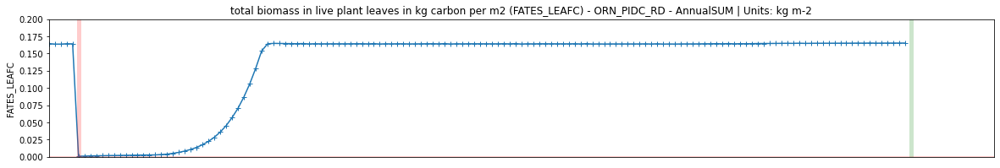

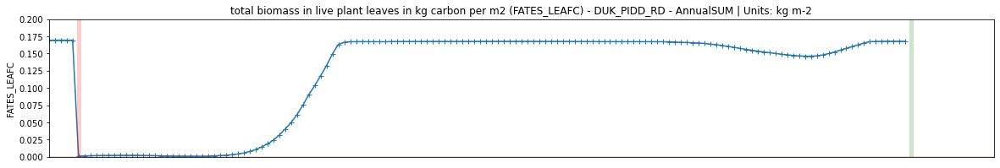

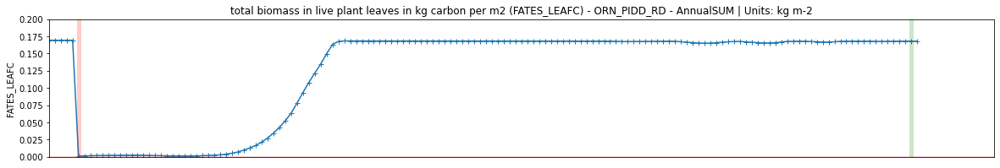

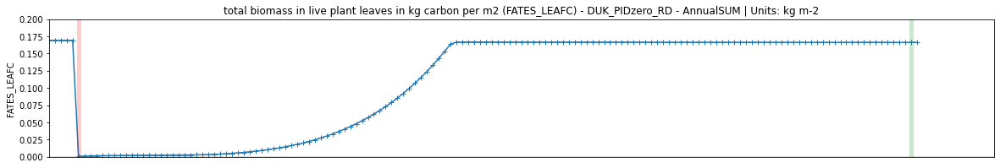

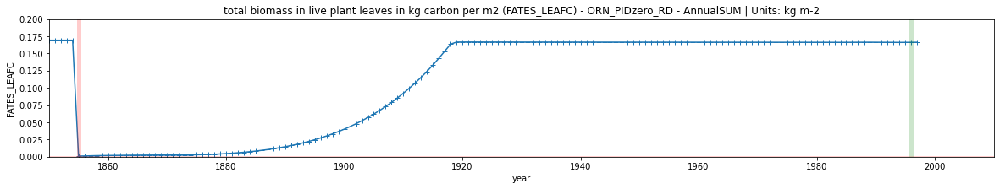

In [105]:
var = "FATES_LEAFC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,.2)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'flux of biomass carbon from live to dead pools from mortality of canopy plants in kg carbon per m2 per second'

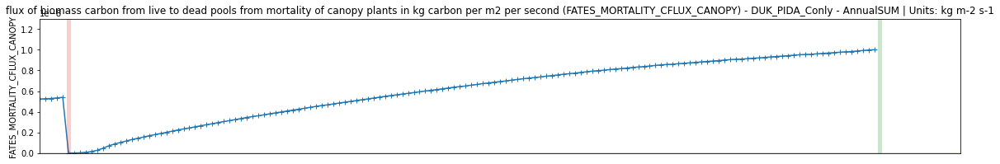

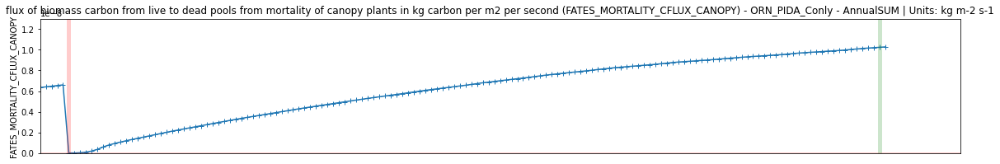

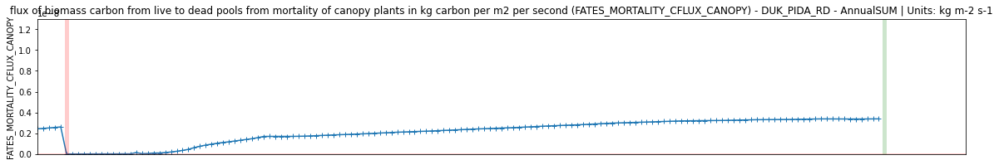

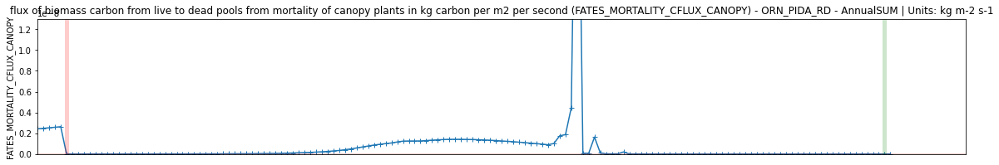

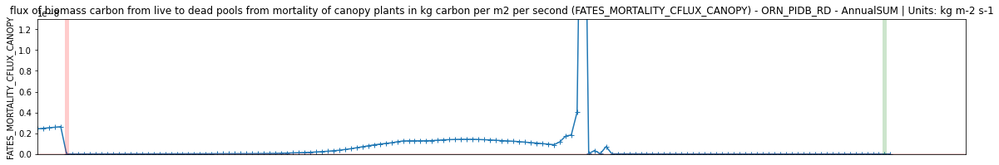

...

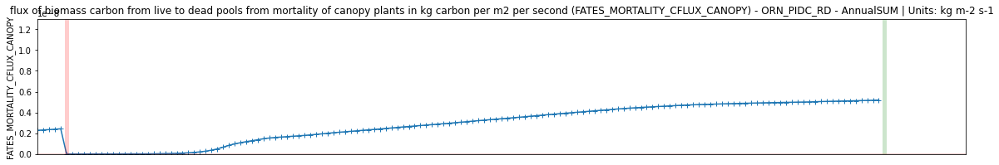

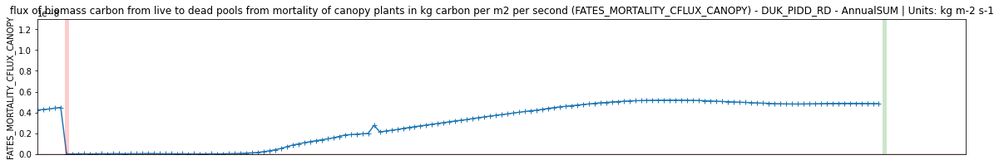

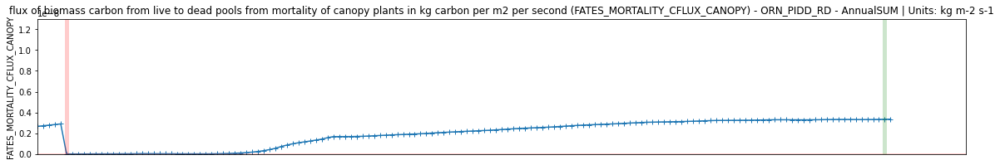

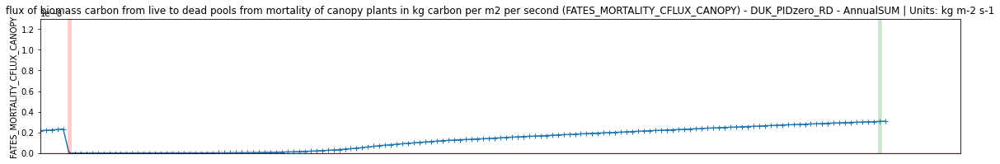

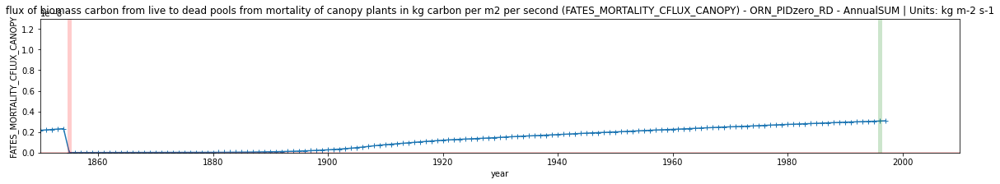

In [106]:

var = "FATES_MORTALITY_CFLUX_CANOPY"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,1.3e-8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'flux of biomass carbon from live to dead pools from mortality of understory plants in kg carbon per m2 per second'

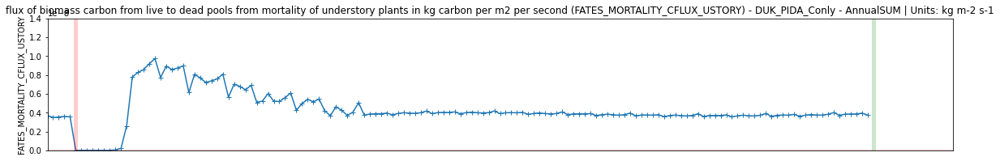

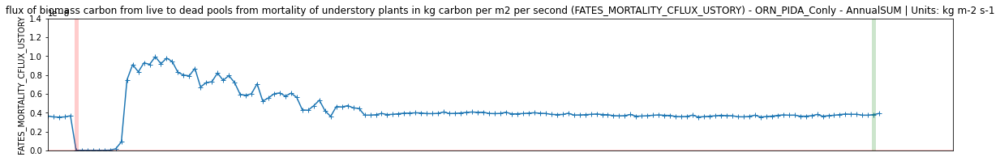

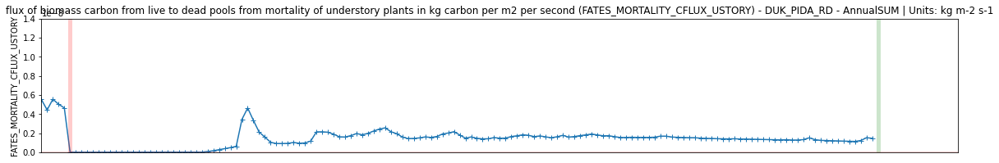

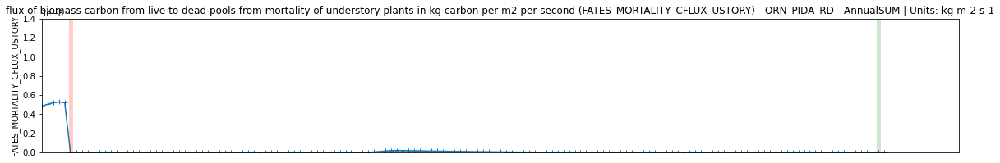

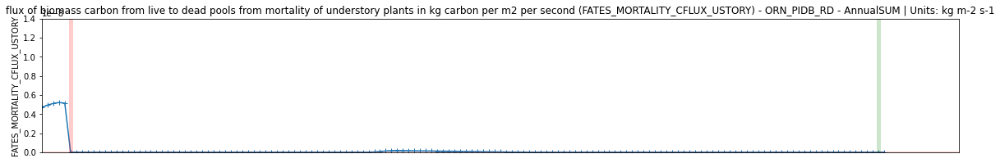

...

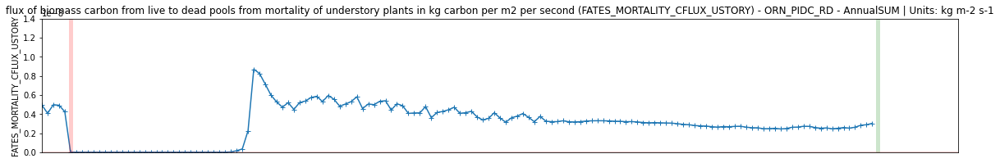

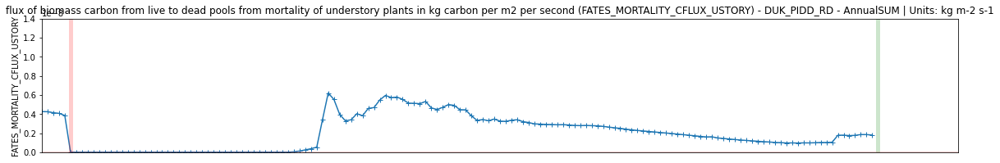

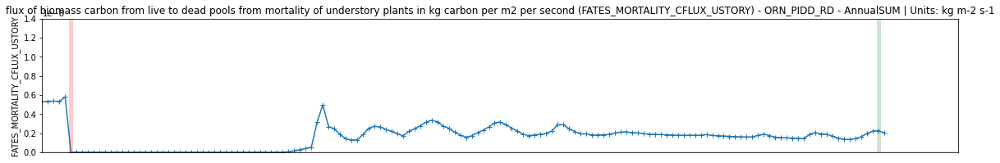

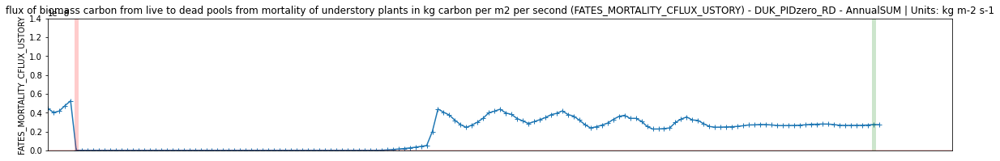

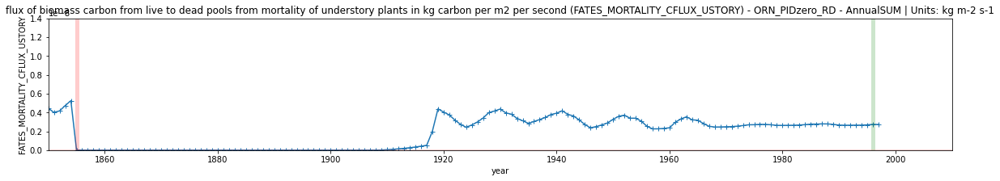

In [107]:

var = "FATES_MORTALITY_CFLUX_USTORY"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,1.4e-8)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'non-structural biomass (sapwood + leaf + fineroot) in kg carbon per m2'

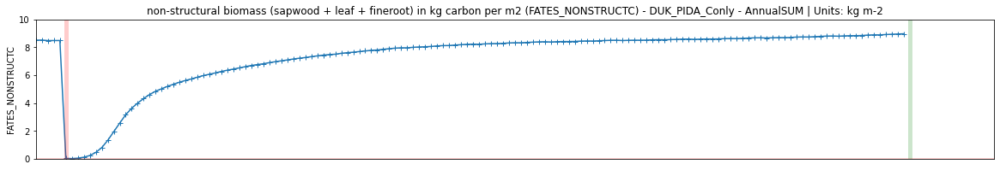

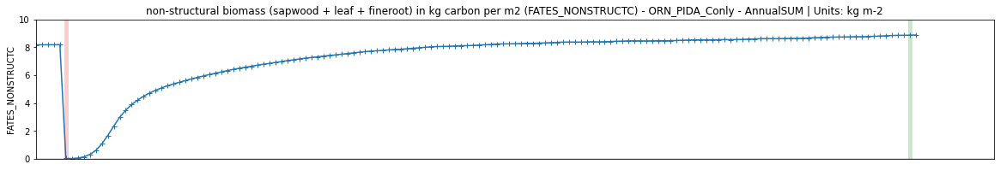

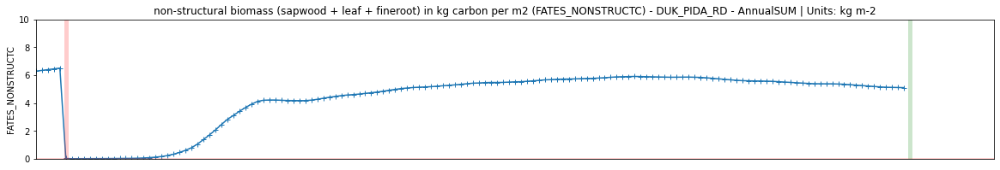

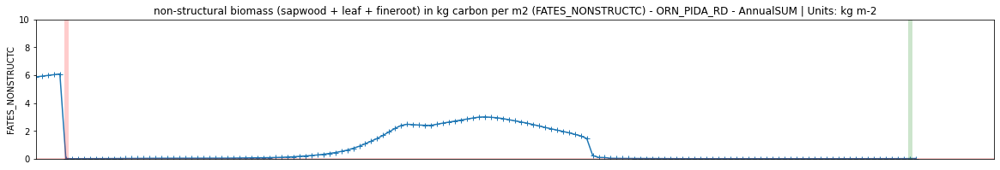

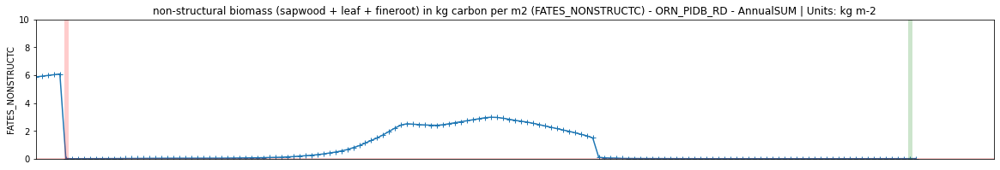

...

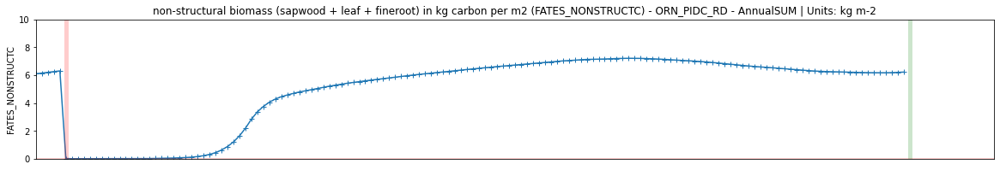

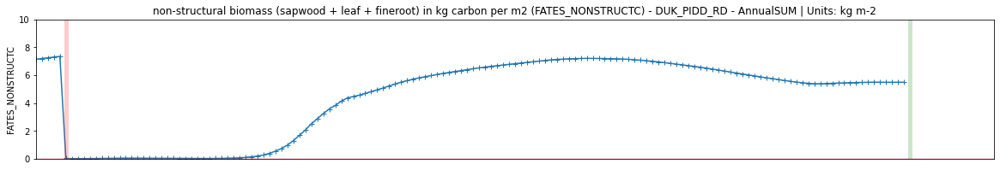

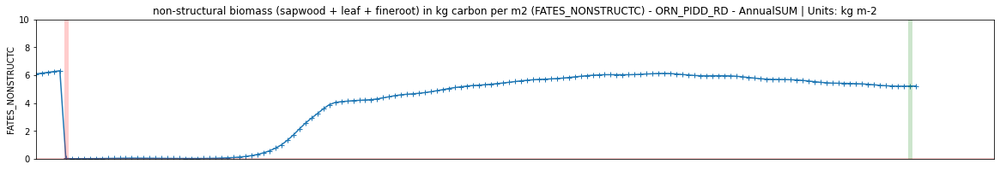

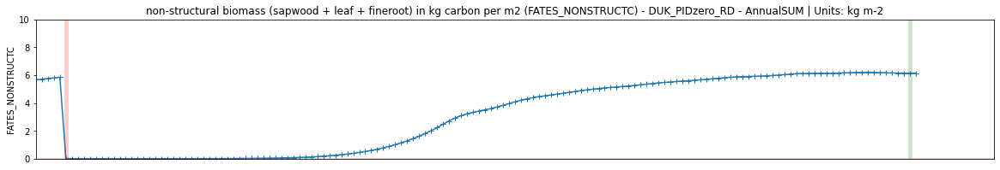

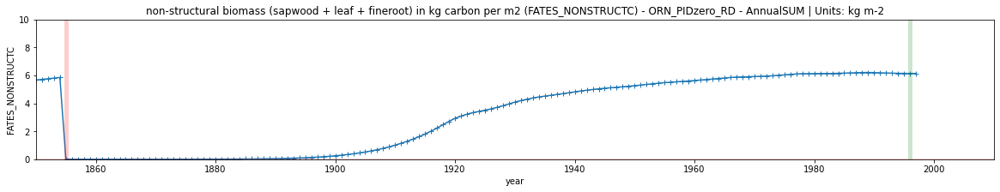

In [108]:

var = "FATES_NONSTRUCTC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,10)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'promotion-associated biomass carbon flux from understory to canopy in kg carbon per m2 per second'

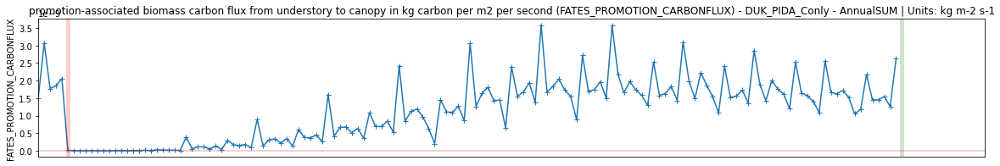

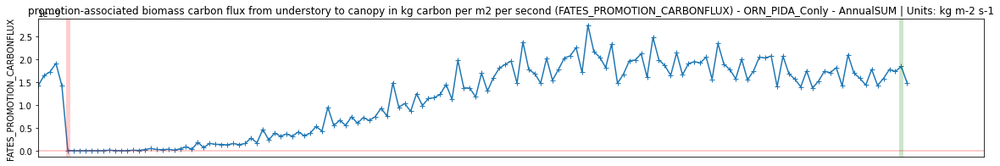

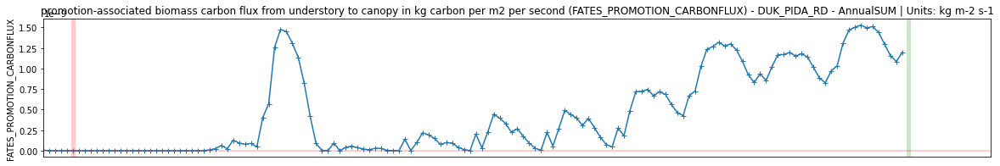

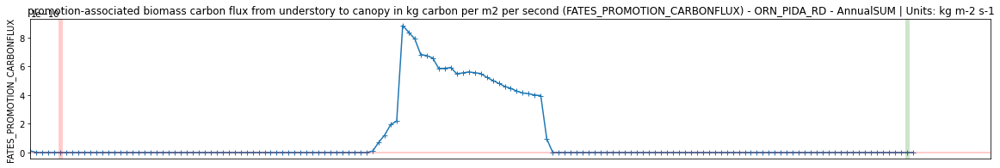

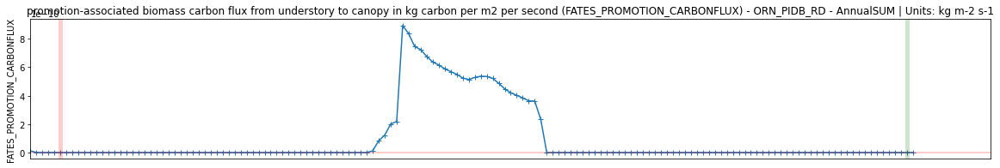

...

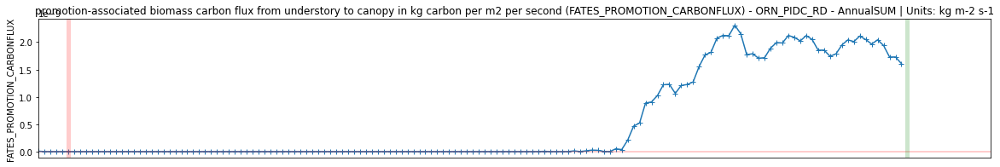

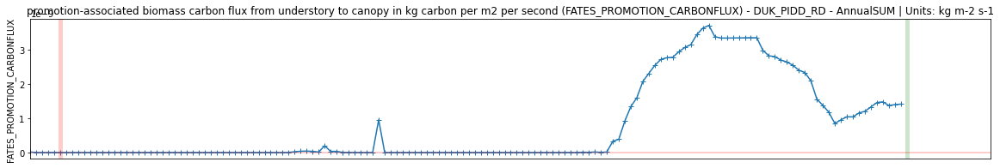

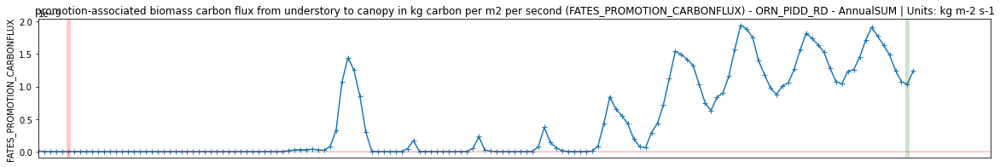

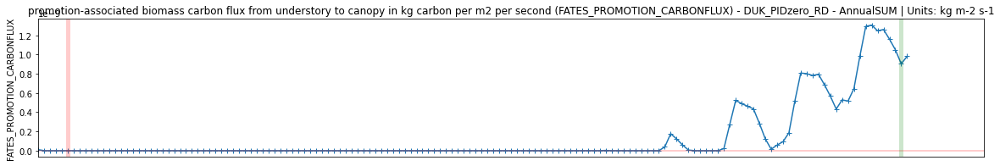

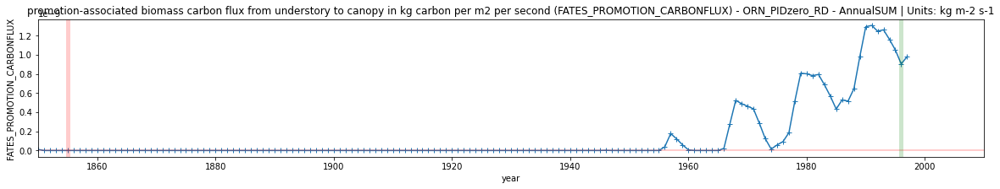

In [109]:


var = "FATES_PROMOTION_CARBONFLUX"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,10)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'total biomass in live plant reproductive tissues in kg carbon per m2'

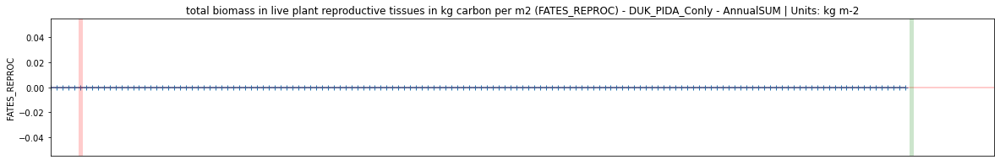

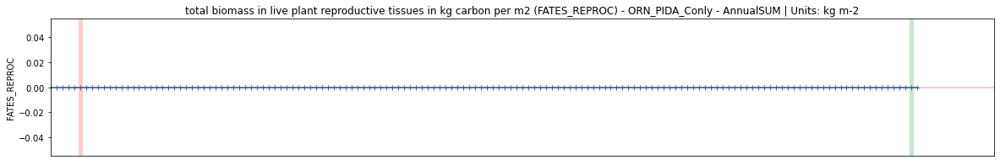

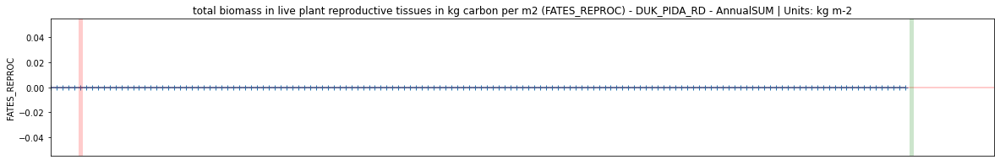

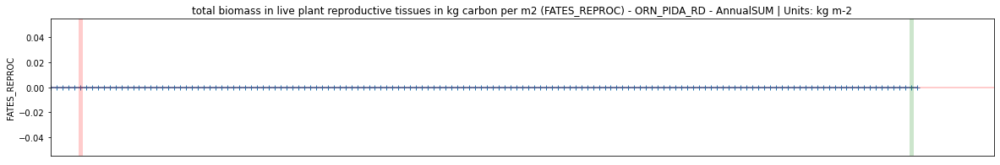

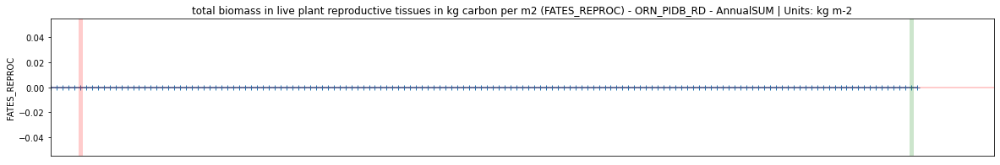

...

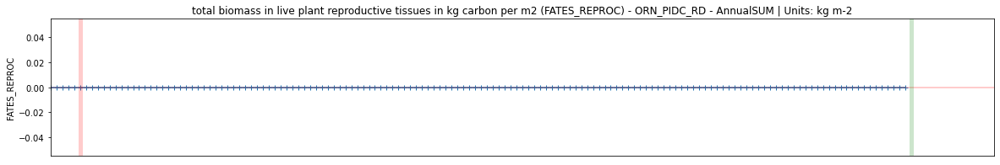

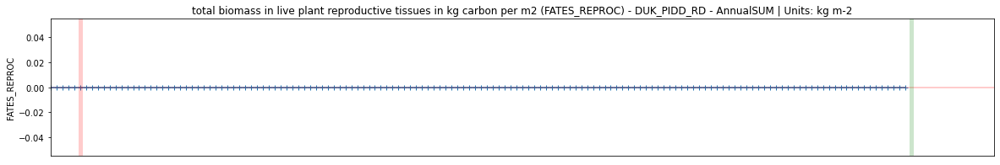

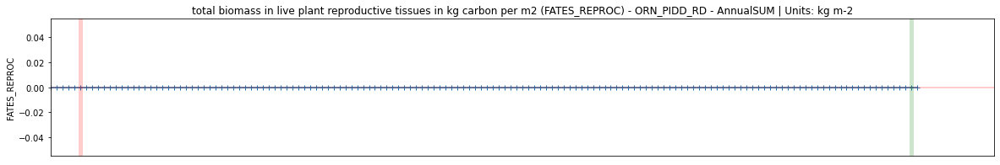

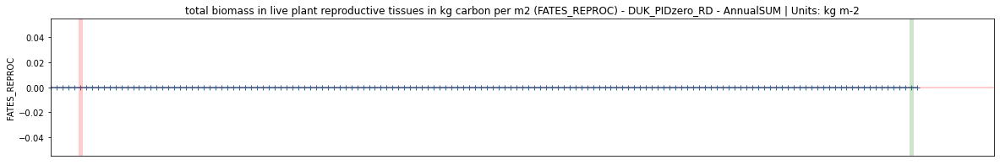

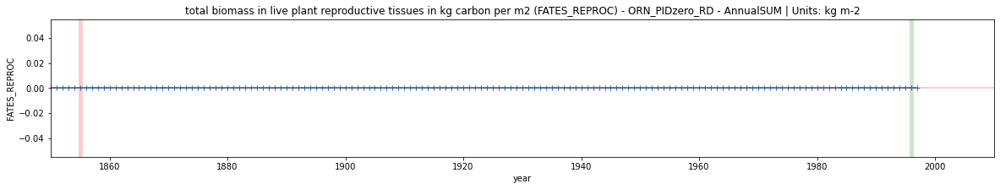

In [110]:



var = "FATES_REPROC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,10)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'total biomass in live plant sapwood in kg carbon per m2'

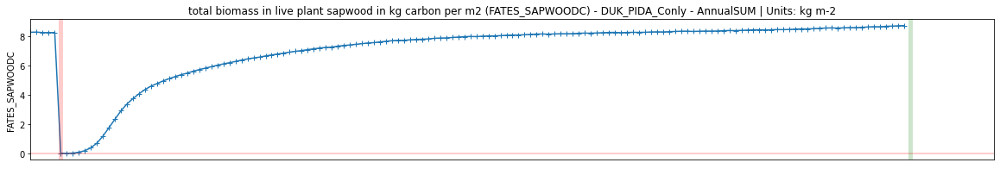

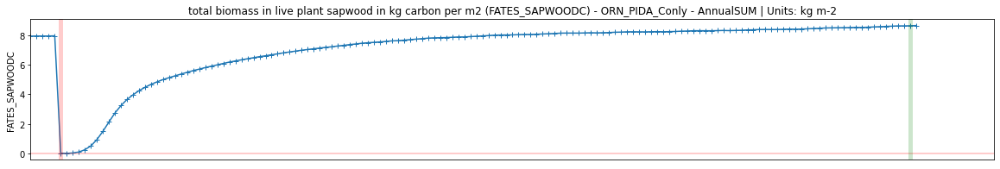

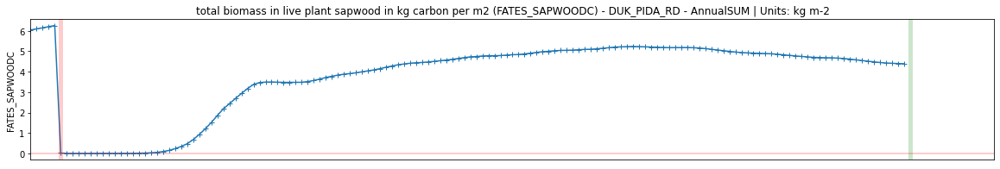

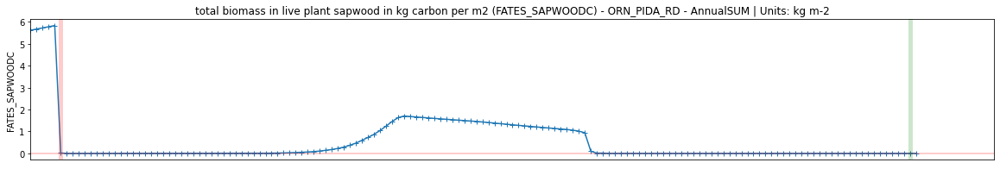

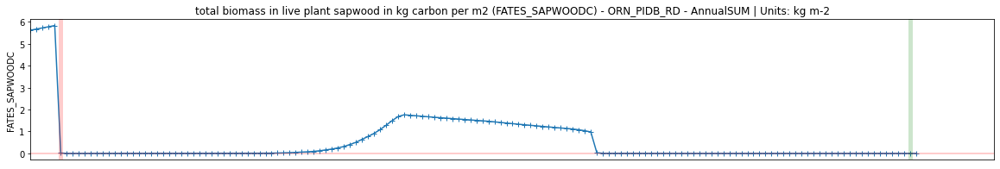

...

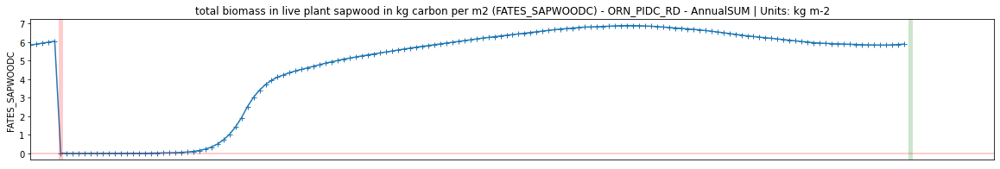

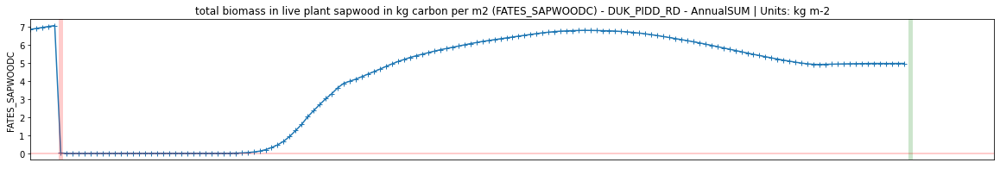

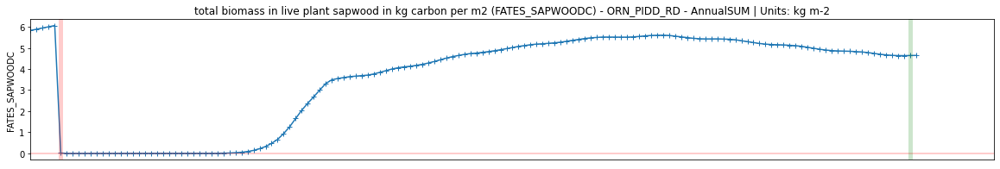

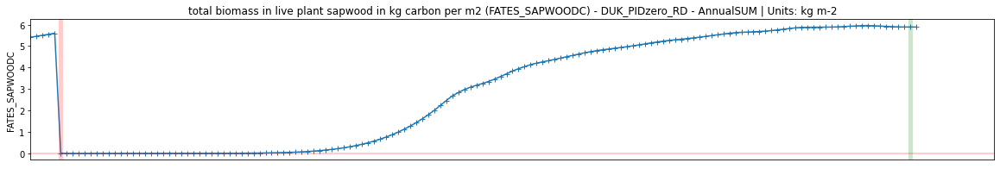

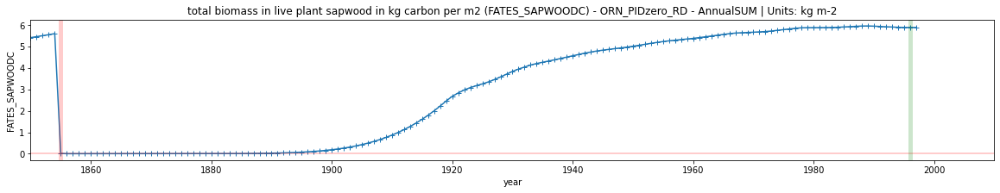

In [111]:
var = "FATES_SAPWOODC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,10)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'total biomass in live plant storage in kg carbon per m2 land area'

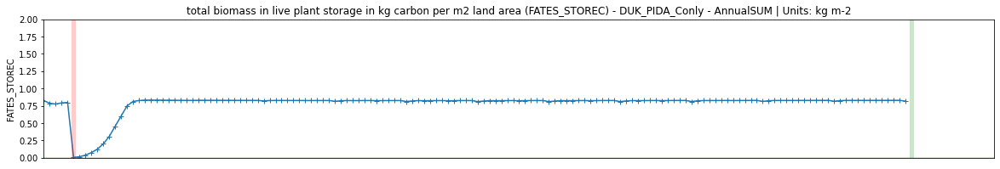

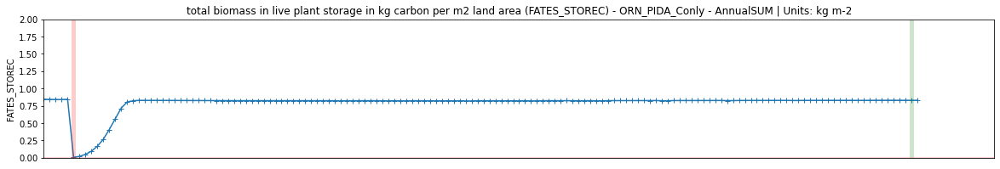

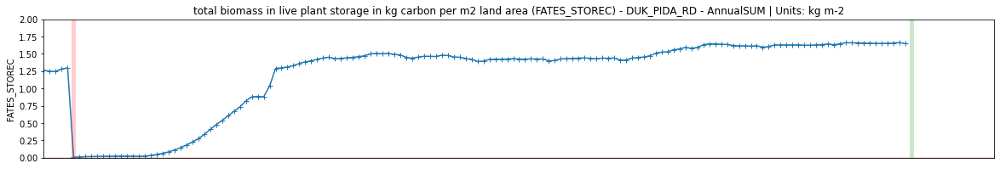

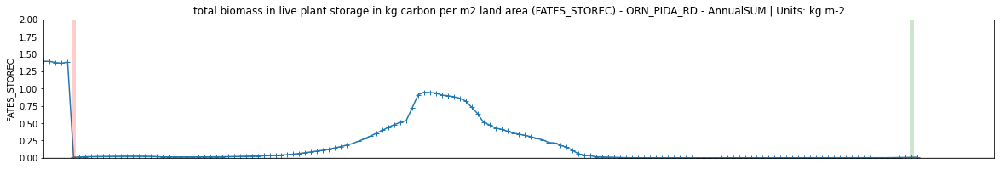

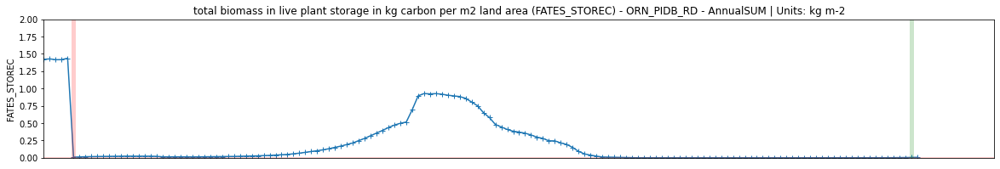

...

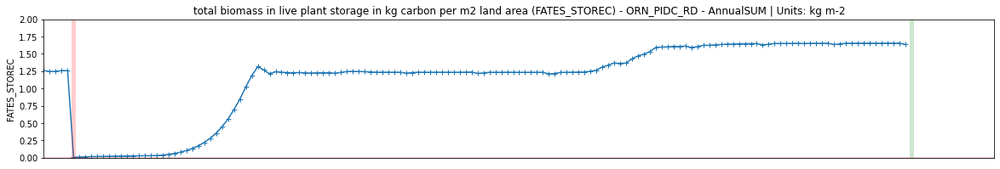

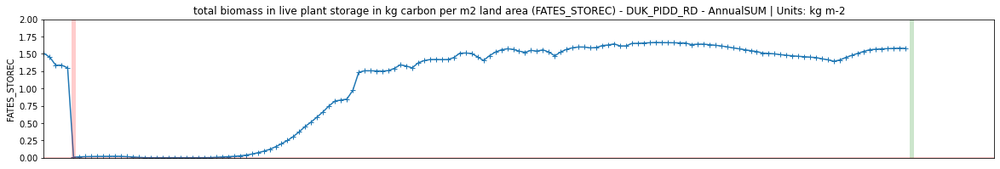

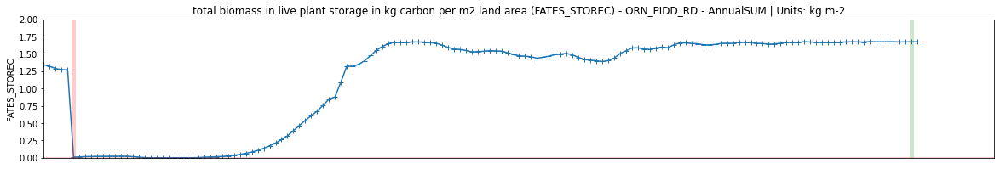

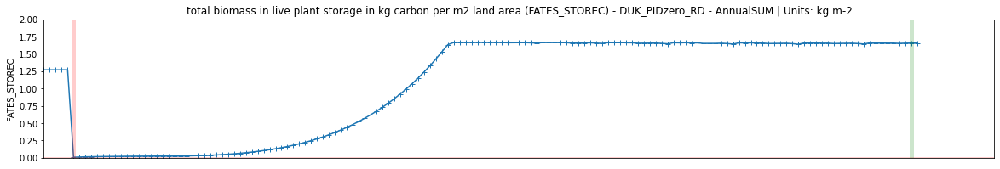

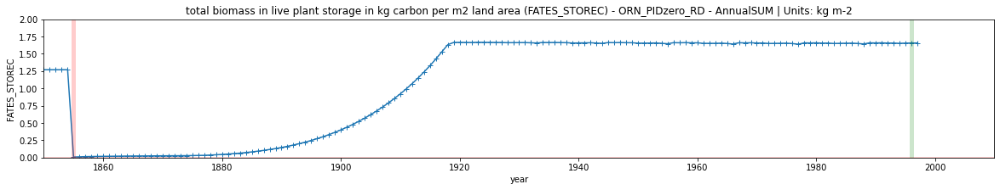

In [112]:
var = "FATES_STOREC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,2)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks:  

'structural biomass in kg carbon per m2 land area'

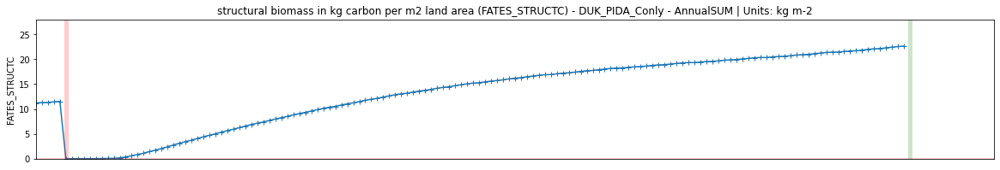

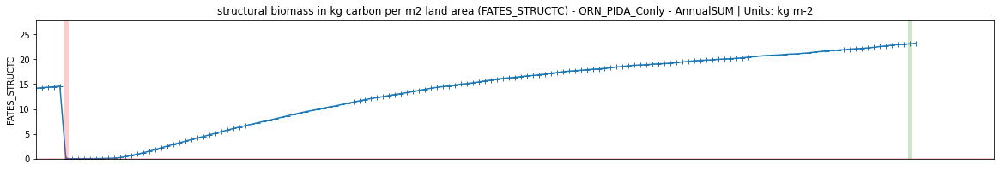

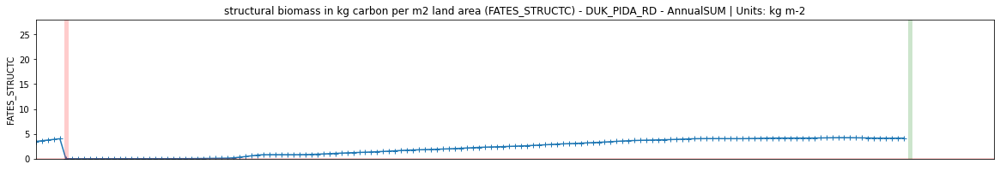

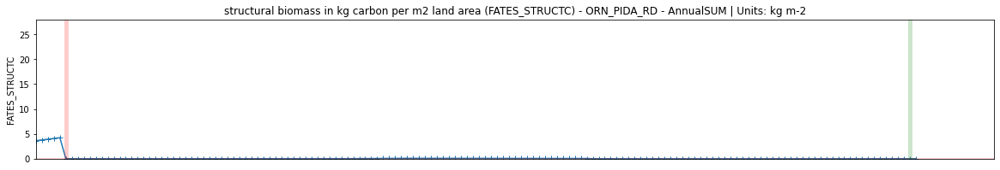

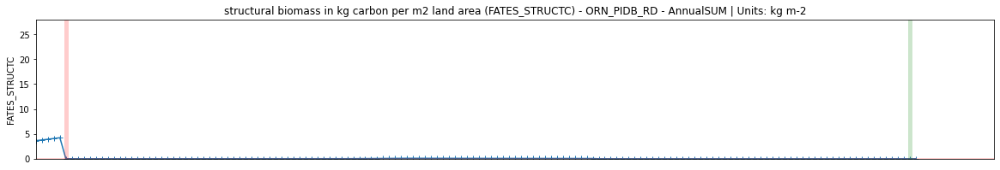

...

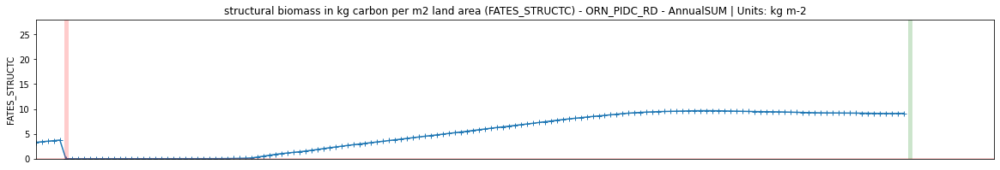

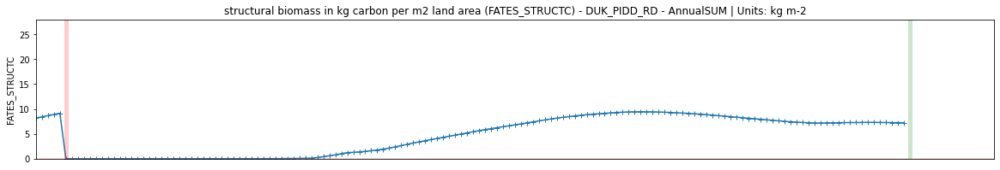

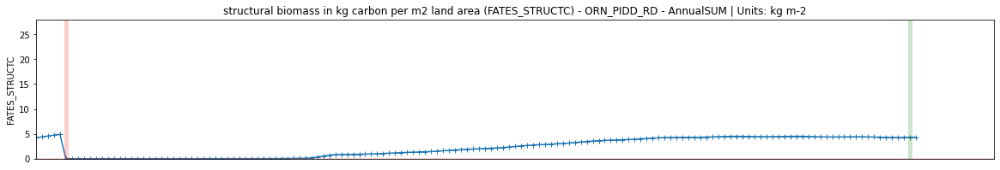

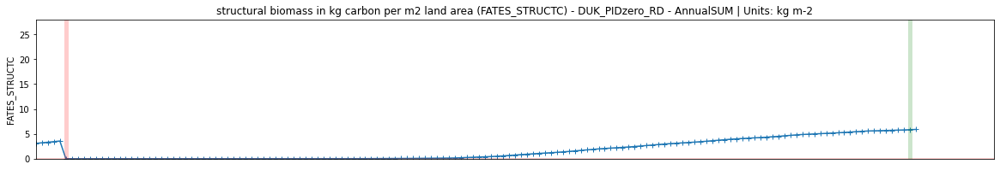

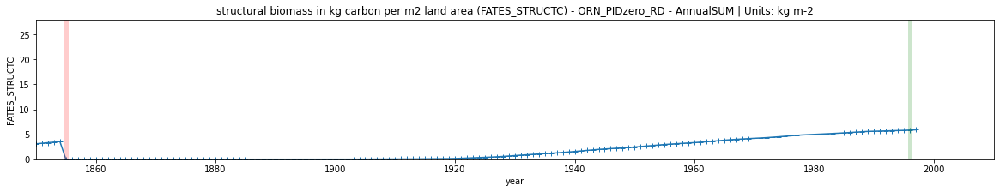

In [113]:
var = "FATES_STRUCTC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,28)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks:  

'biomass of understory plants in kg carbon per m2 land area'

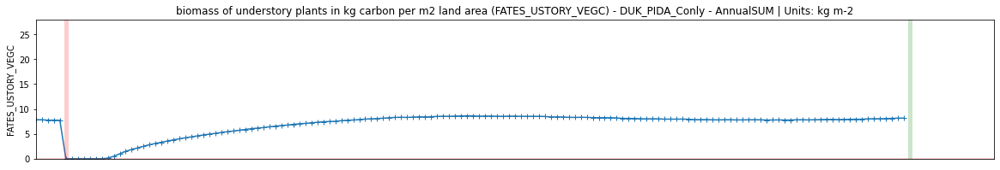

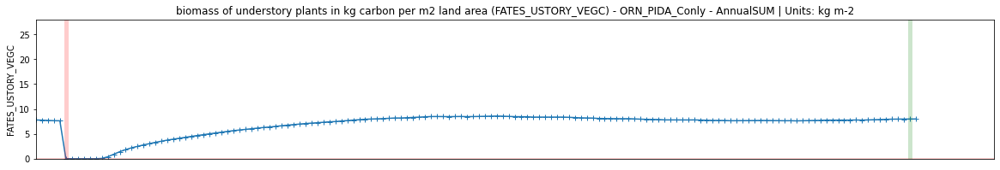

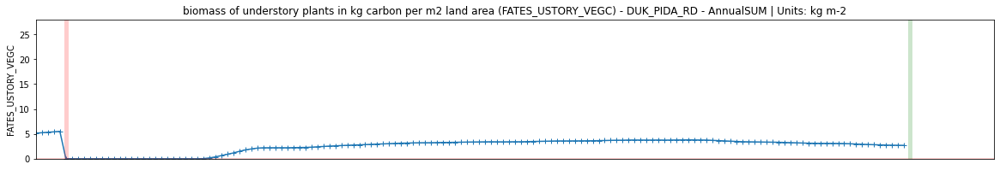

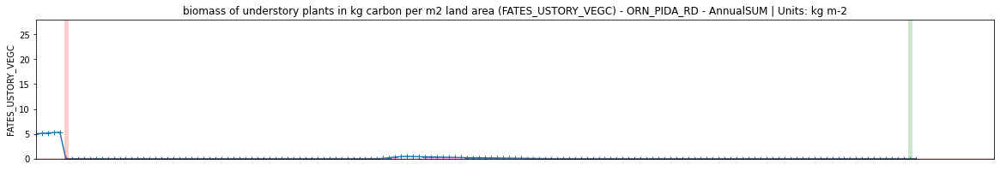

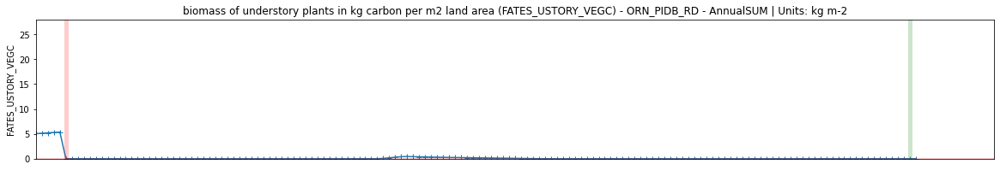

...

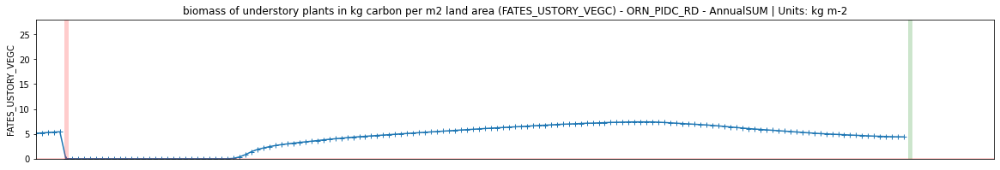

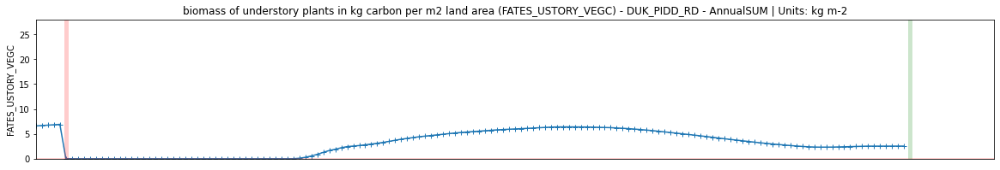

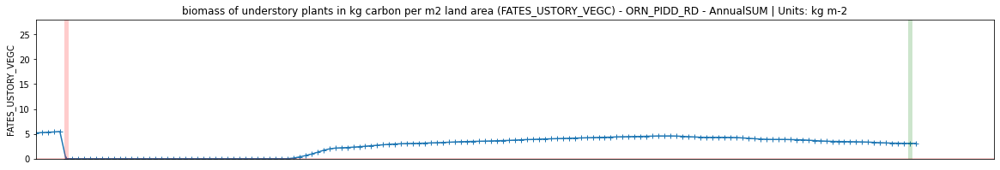

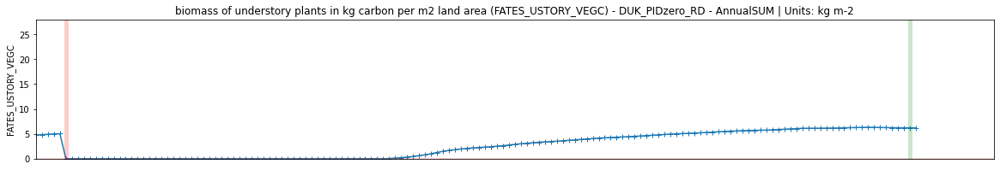

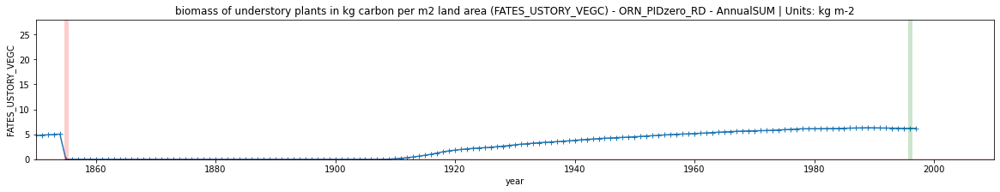

In [114]:
var = "FATES_USTORY_VEGC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,28)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks:  

'total biomass in live plants in kg carbon per m2 land area'

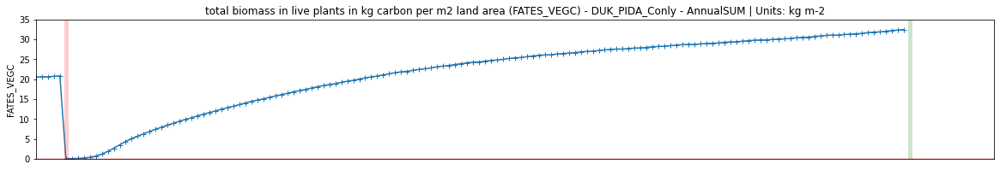

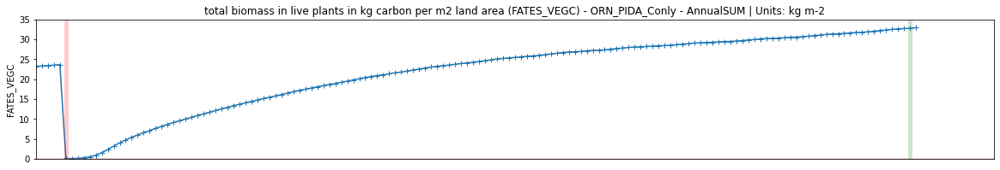

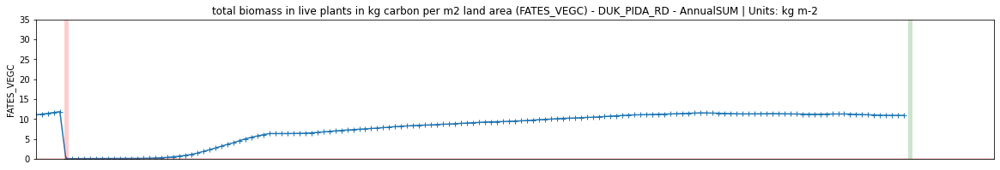

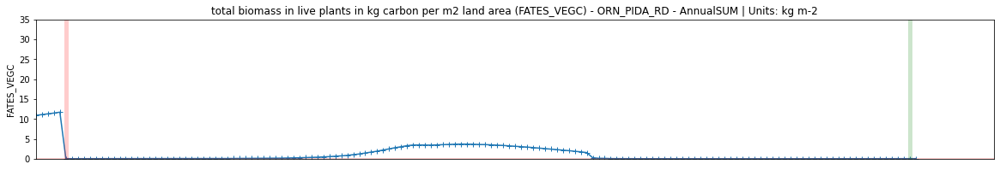

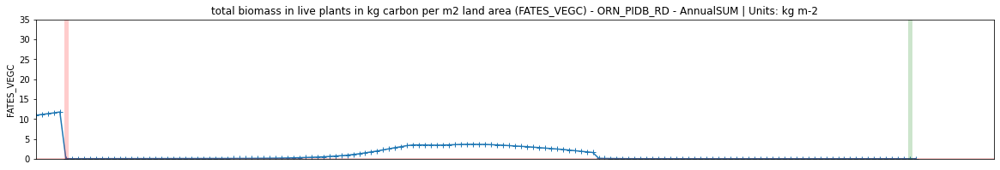

...

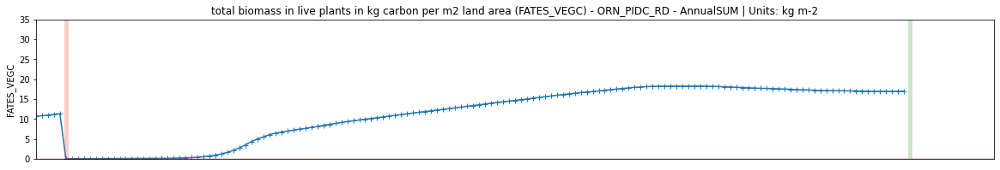

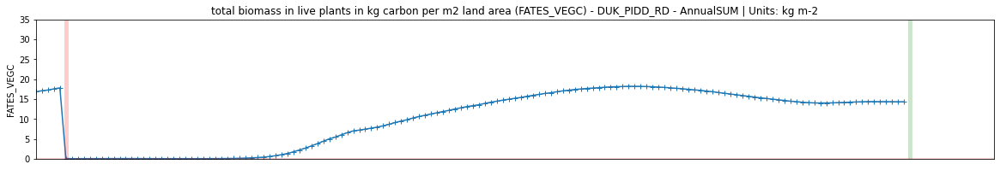

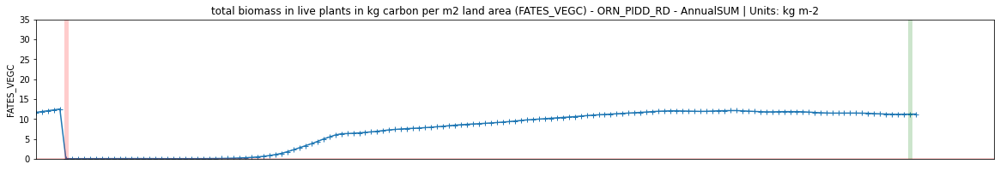

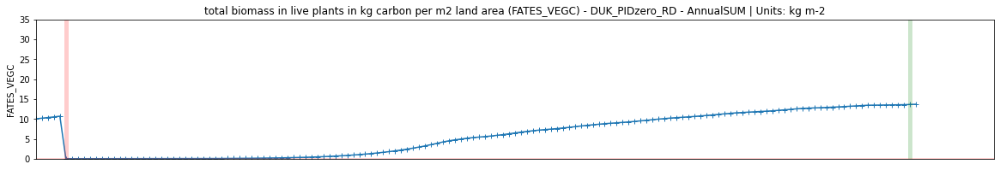

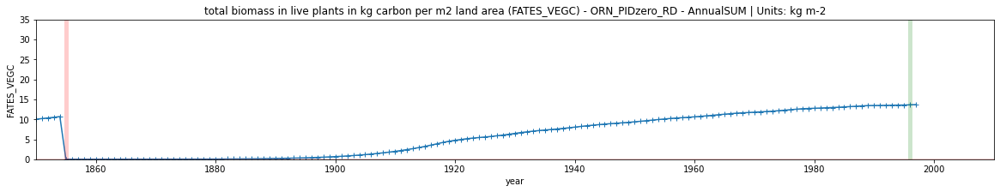

In [115]:
var = "FATES_VEGC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,35)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
 
ds[key][var].long_name 
# Remarks: 

'aboveground biomass in kg carbon per m2 land area'

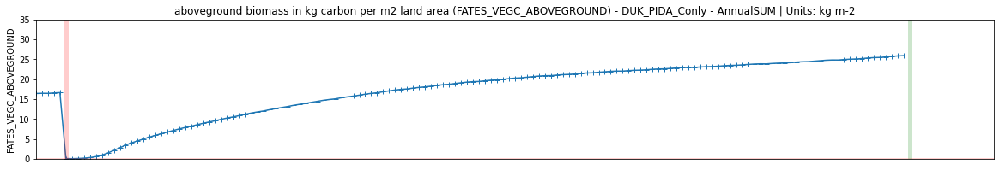

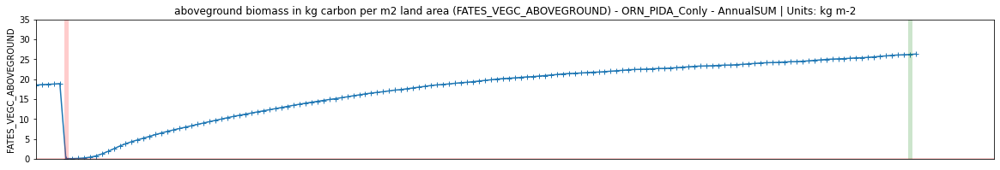

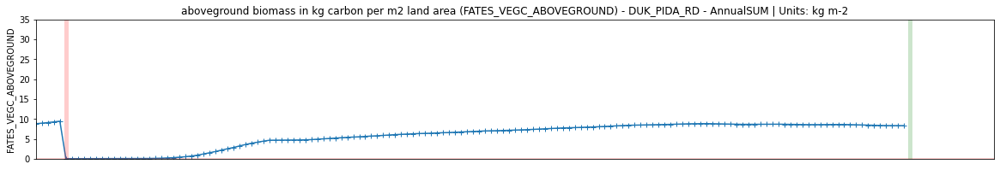

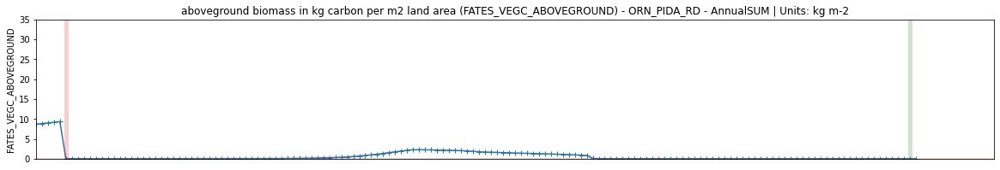

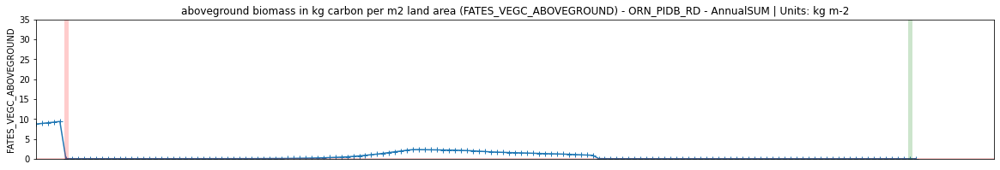

...

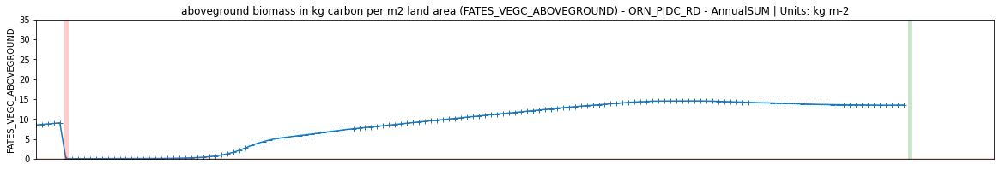

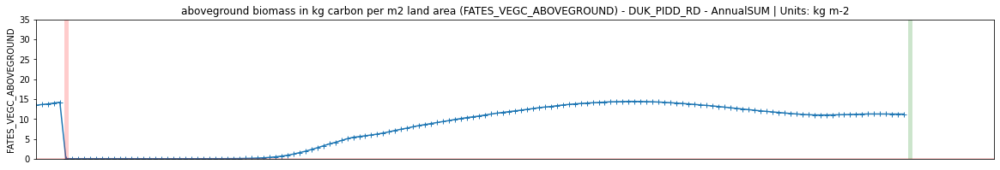

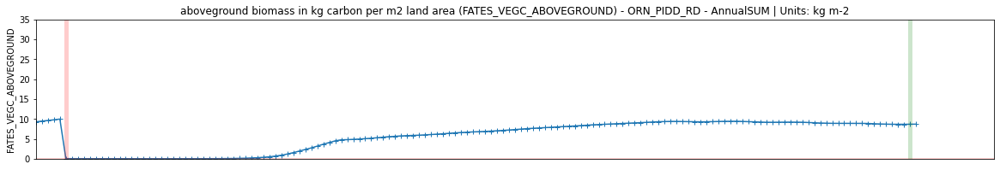

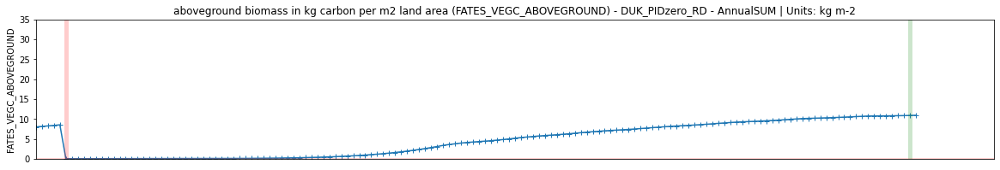

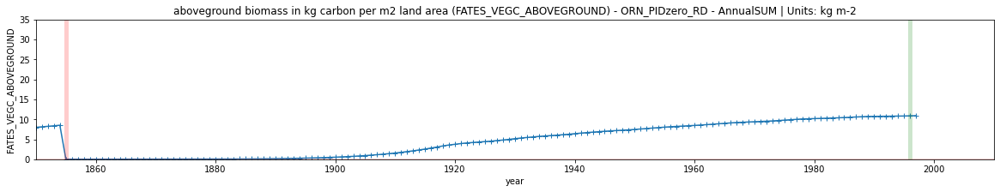

In [116]:
var = "FATES_VEGC_ABOVEGROUND"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    plt.ylim(0,35)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)

ds[key][var].long_name 
# Remarks: 

'litter C'

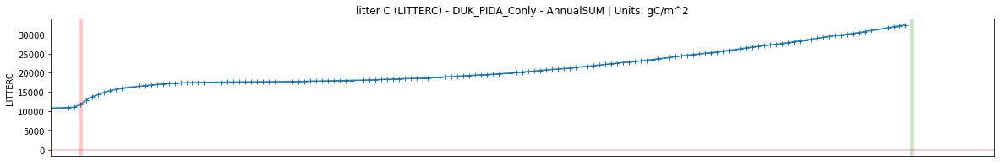

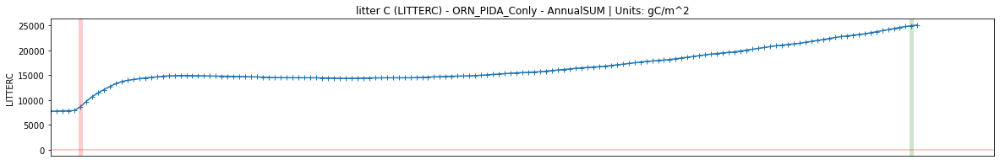

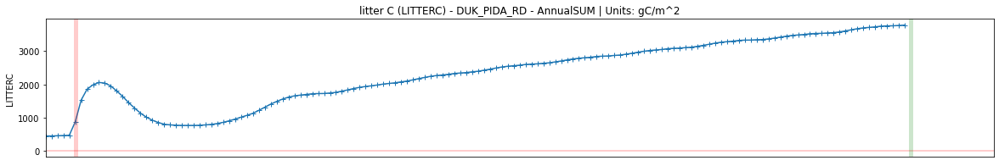

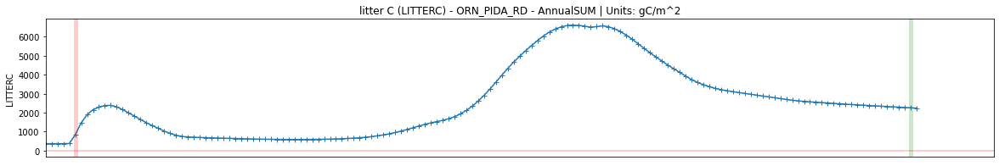

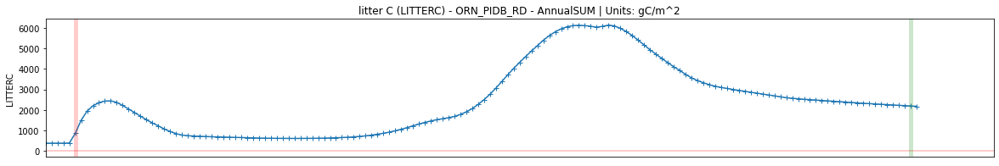

...

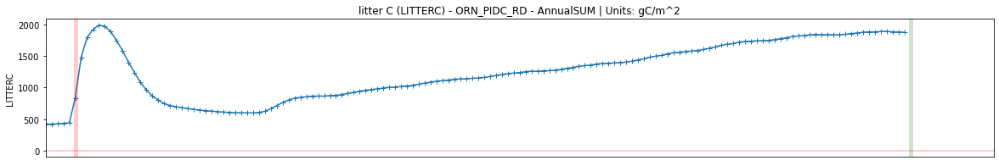

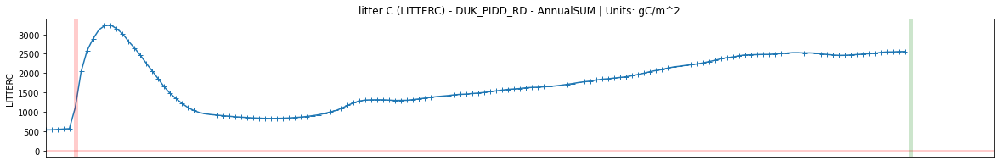

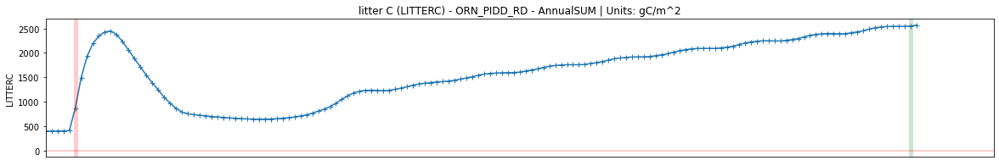

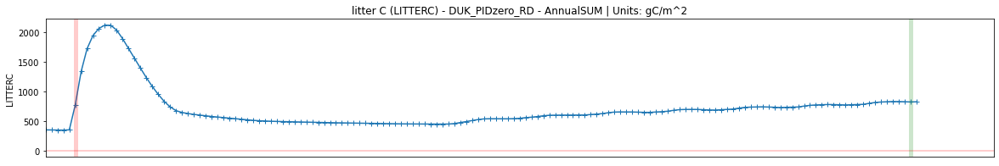

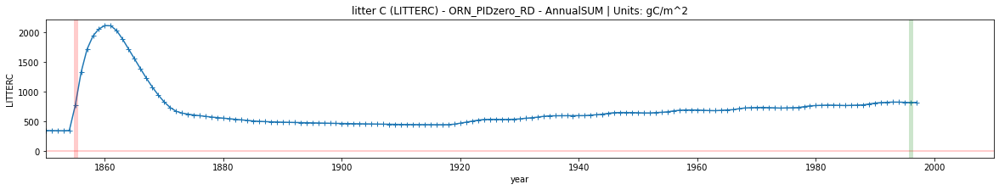

In [117]:
var = "LITTERC"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,35)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
ds[key][var].long_name
# Remarks: 

'litter heterotrophic respiration'

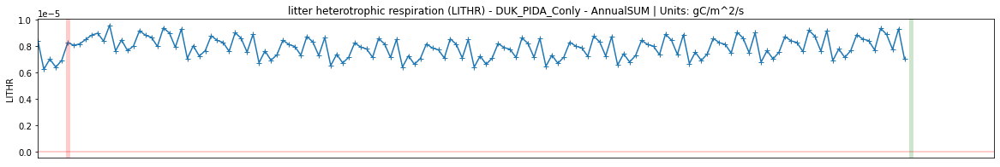

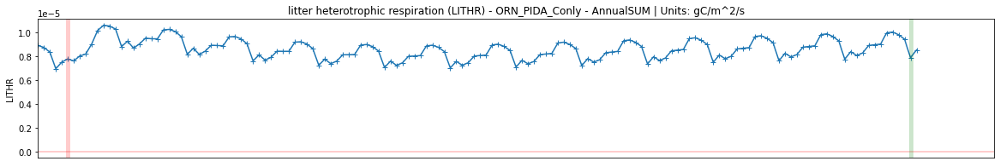

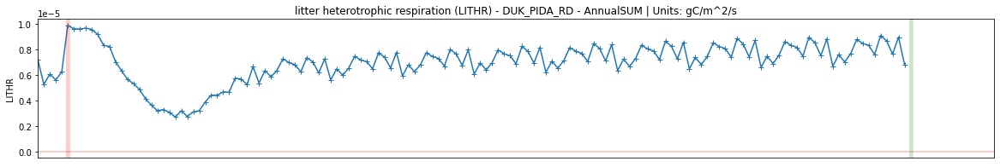

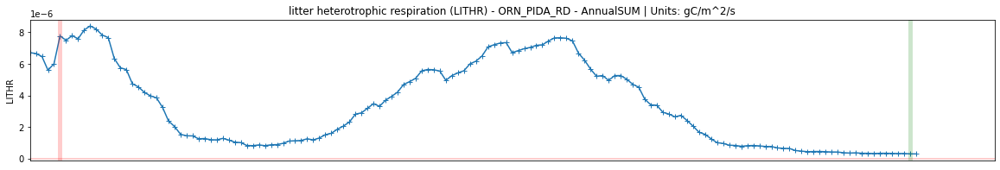

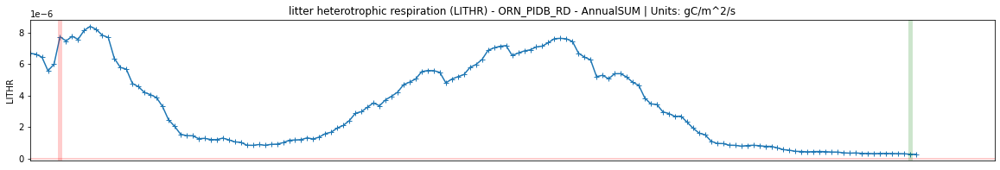

...

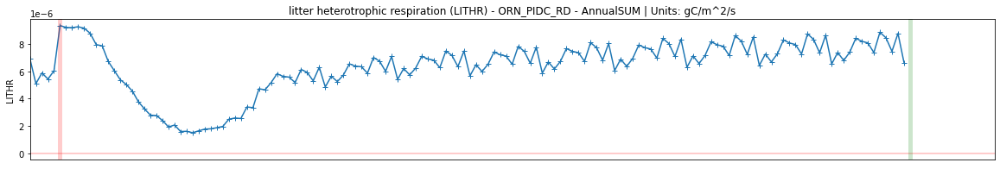

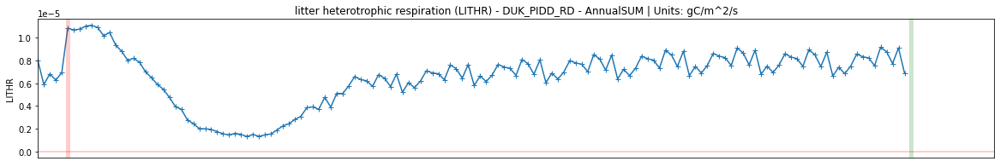

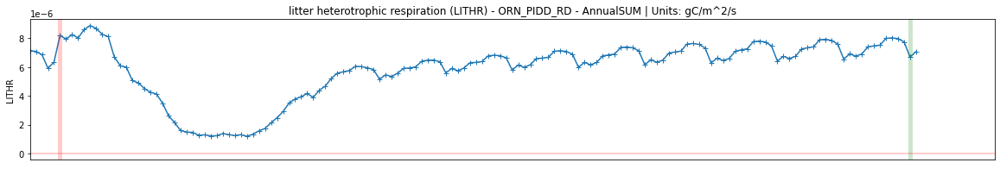

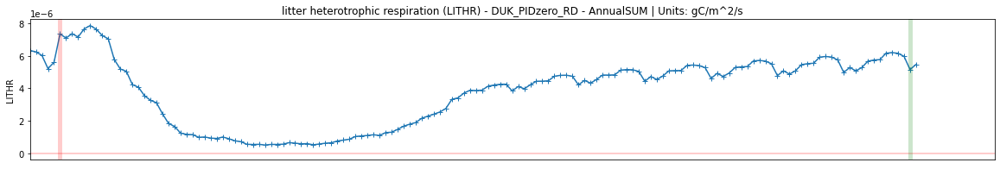

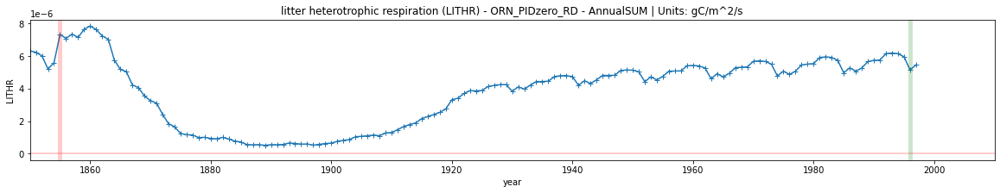

In [118]:
var = "LITHR"
for idx, key in enumerate(ds.keys()):
    ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
    plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
    plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
    plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
    plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
    plt.xlim(1850,2010)
    #plt.ylim(0,35)
    if idx != len(ds.keys())-1 : 
        plt.xticks([])
        plt.xlabel(None)
ds[key][var].long_name
# Remarks: 

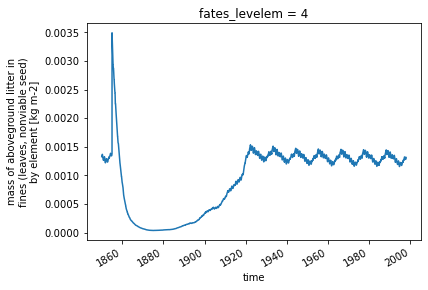

In [119]:

var = "FATES_LITTER_AG_FINE_EL"
#ds[key][var][:,0].plot()
ds[key][var][:,1].plot()
#ds[key][var][:,2].plot()

/Users/ud4/opt/anaconda3/envs/pyces/lib/python3.9/site-packages/xarray/plot/utils.py:429: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  _, ax = plt.subplots(figsize=figsize)


'mass of aboveground litter in fines (leaves, nonviable seed) by element'

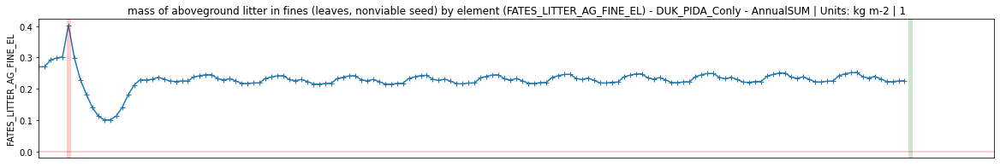

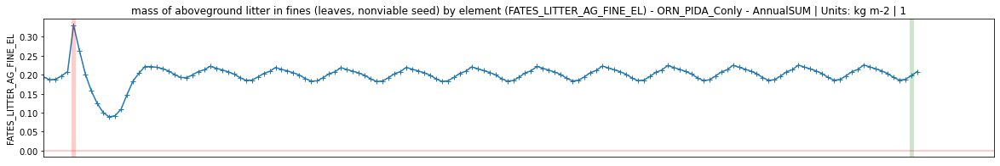

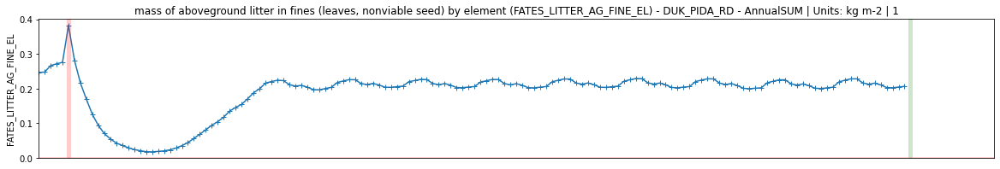

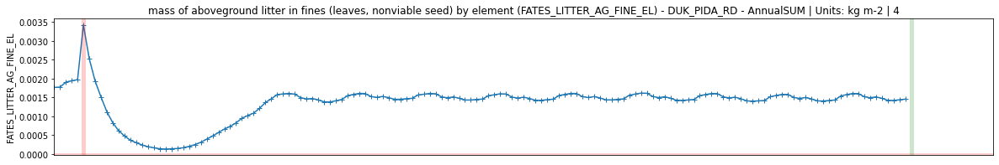

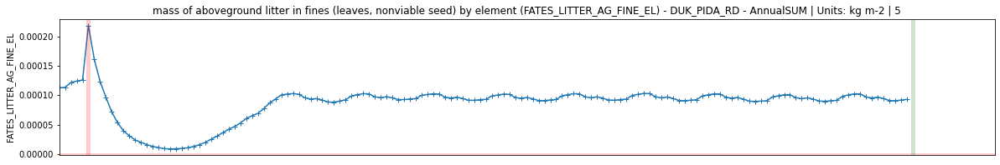

...

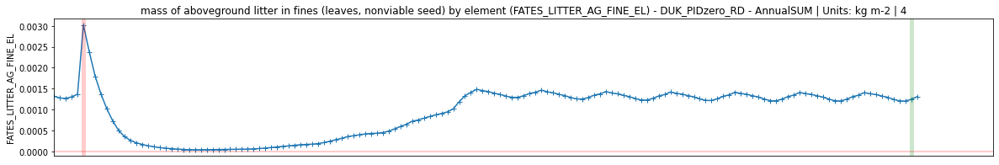

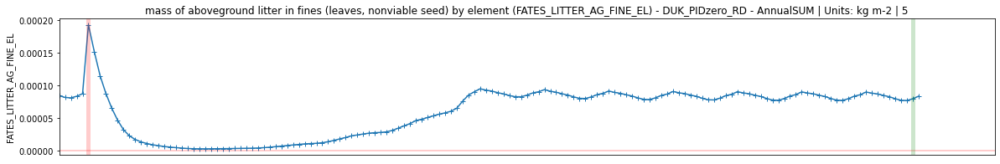

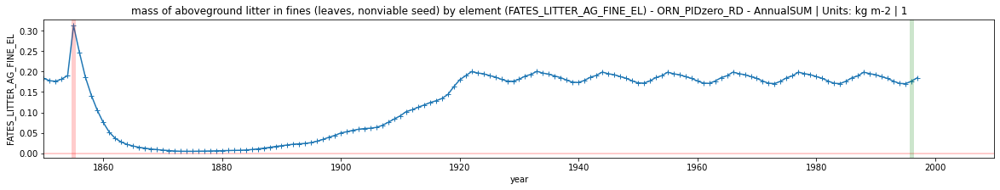

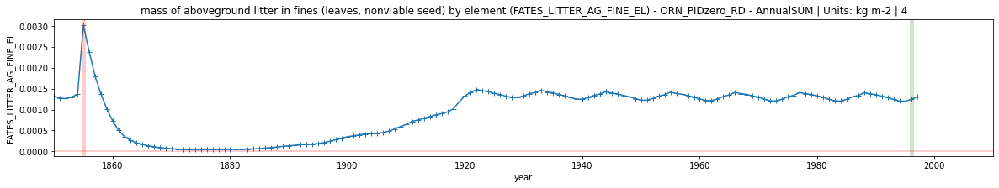

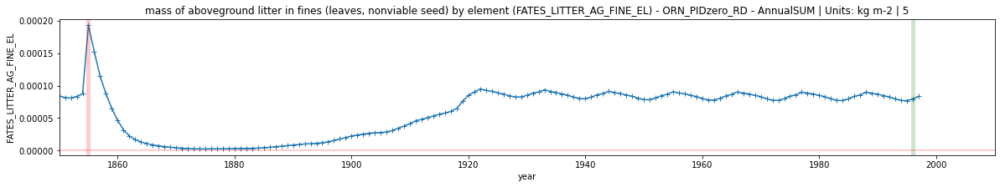

In [120]:
var = "FATES_LITTER_AG_FINE_EL"
for idx, key in enumerate(ds.keys()):
    for Fi in range (len(ds[key][var].fates_levelem)):
        ds[key][var][:,Fi].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
        plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units} | {(ds[key][var][:,Fi].fates_levelem.values)}")
        plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
        plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
        plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
        plt.xlim(1850,2010)
        #plt.ylim(0,35)
        if idx != len(ds.keys())-1 : 
            plt.xticks([])
            plt.xlabel(None)
ds[key][var].long_name

/Users/ud4/opt/anaconda3/envs/pyces/lib/python3.9/site-packages/xarray/plot/utils.py:429: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  _, ax = plt.subplots(figsize=figsize)


'mass of aboveground litter in coarse woody debris (trunks/branches/twigs) by element'

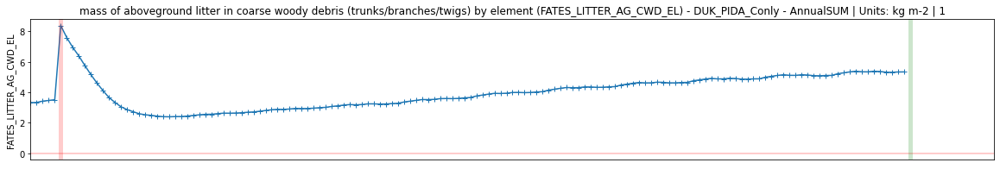

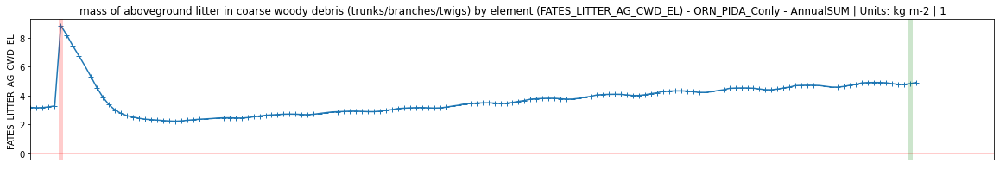

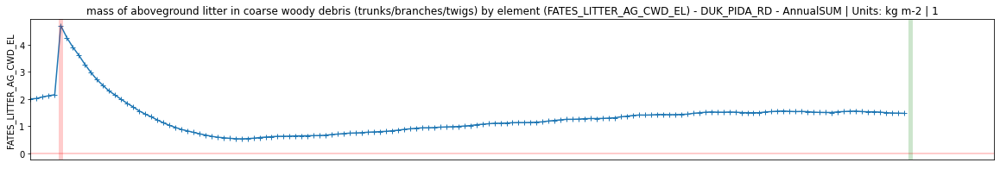

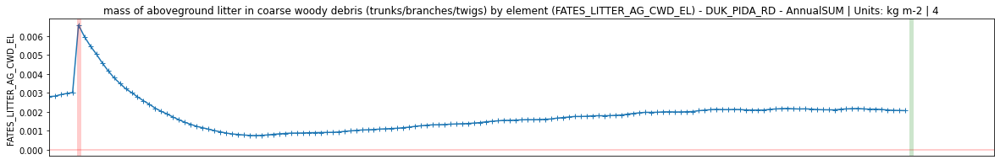

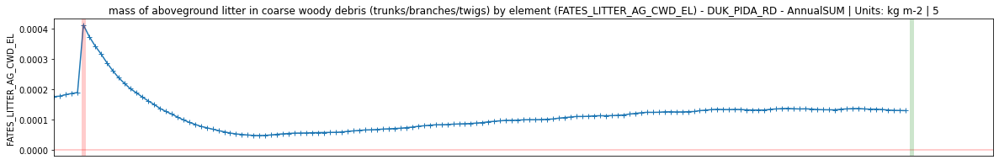

...

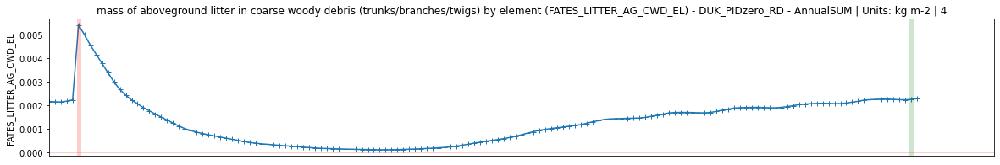

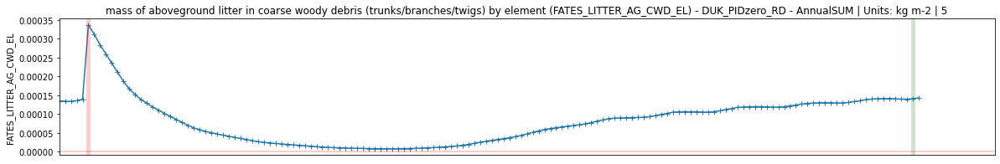

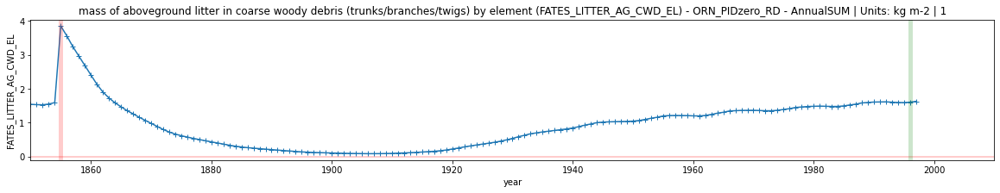

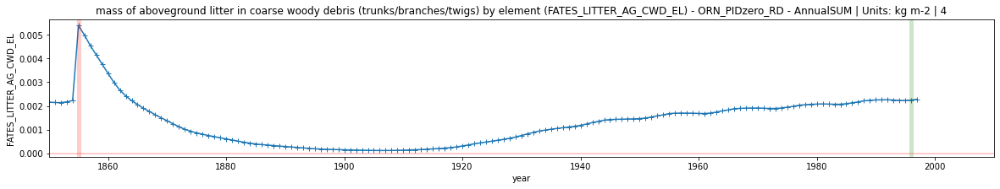

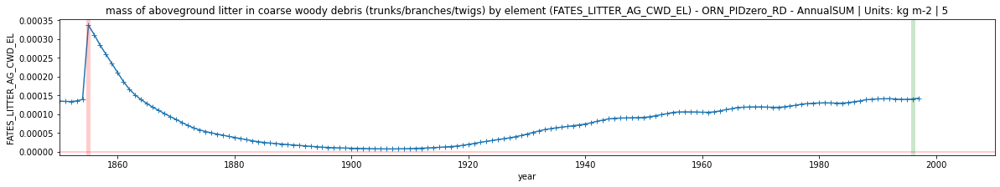

In [121]:
var = "FATES_LITTER_AG_CWD_EL"
for idx, key in enumerate(ds.keys()):
    for Fi in range (len(ds[key][var].fates_levelem)):
        ds[key][var][:,Fi].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
        plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units} | {(ds[key][var][:,Fi].fates_levelem.values)}")
        plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
        plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
        plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
        plt.xlim(1850,2010)
        #plt.ylim(0,35)
        if idx != len(ds.keys())-1 : 
            plt.xticks([])
            plt.xlabel(None)
ds[key][var].long_name

/Users/ud4/opt/anaconda3/envs/pyces/lib/python3.9/site-packages/xarray/plot/utils.py:429: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  _, ax = plt.subplots(figsize=figsize)


'mass of belowground litter in fines (fineroots) by element'

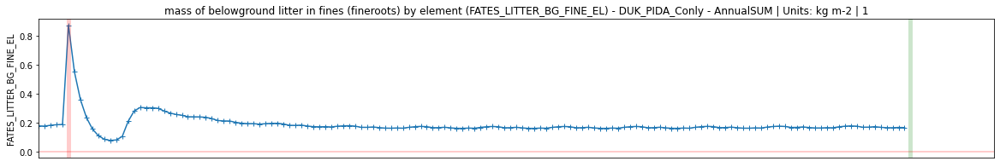

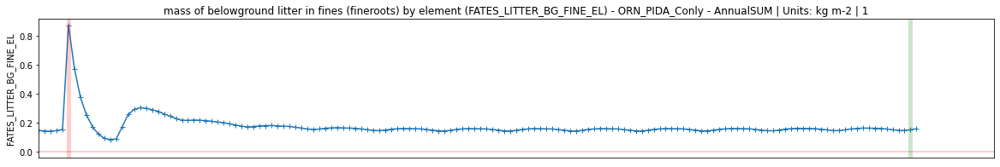

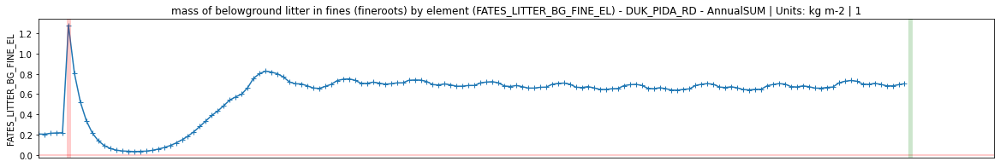

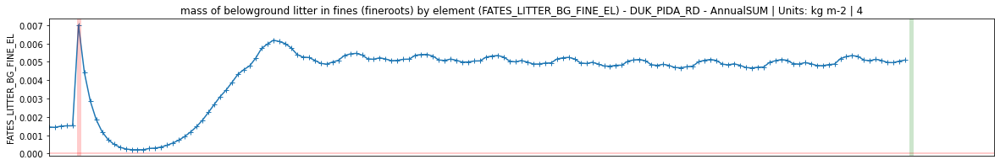

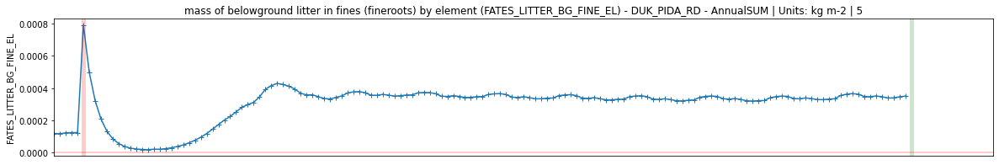

...

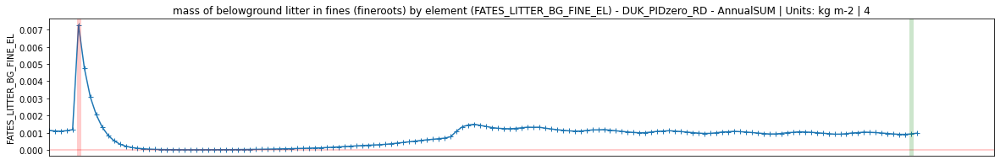

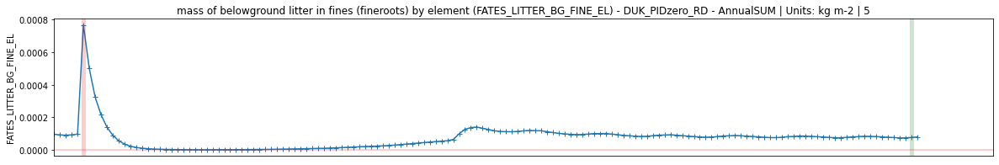

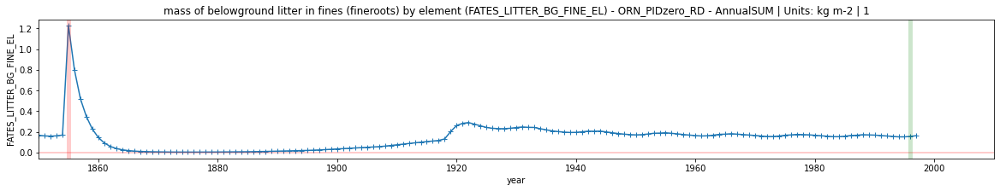

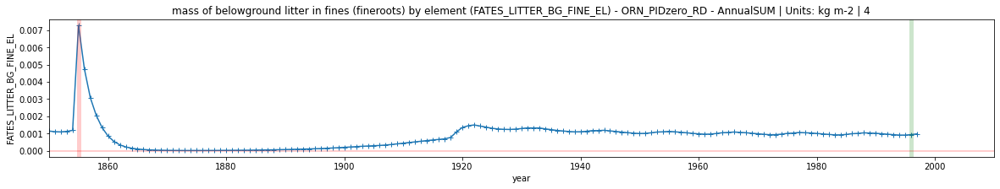

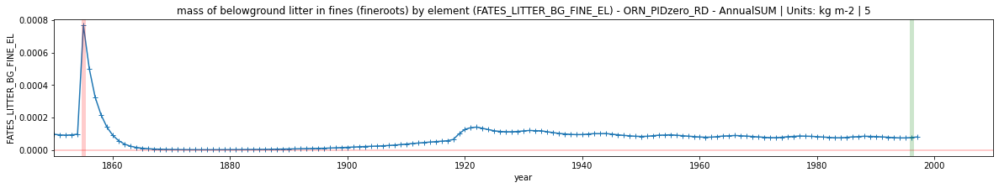

In [122]:
var = "FATES_LITTER_BG_FINE_EL"
for idx, key in enumerate(ds.keys()):
    for Fi in range (len(ds[key][var].fates_levelem)):
        ds[key][var][:,Fi].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
        plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units} | {(ds[key][var][:,Fi].fates_levelem.values)}")
        plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
        plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
        plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
        plt.xlim(1850,2010)
        #plt.ylim(0,35)
        if idx != len(ds.keys())-1 : 
            plt.xticks([])
            plt.xlabel(None)
ds[key][var].long_name

/Users/ud4/opt/anaconda3/envs/pyces/lib/python3.9/site-packages/xarray/plot/utils.py:429: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  _, ax = plt.subplots(figsize=figsize)


'mass of belowground litter in coarse woody debris (coarse roots) by element'

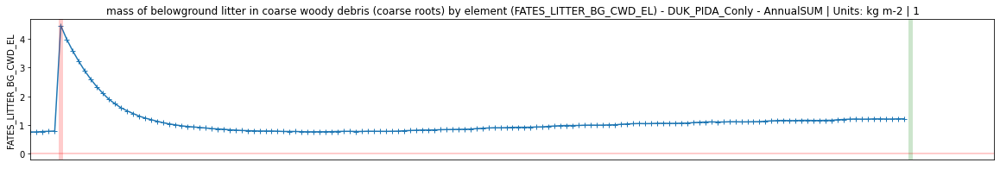

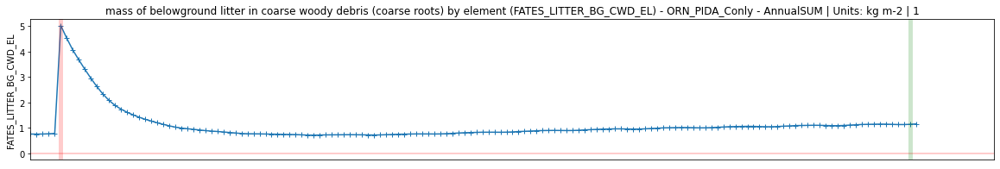

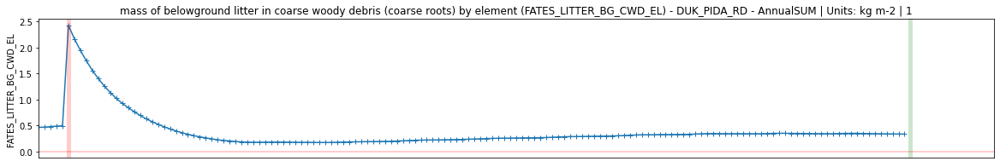

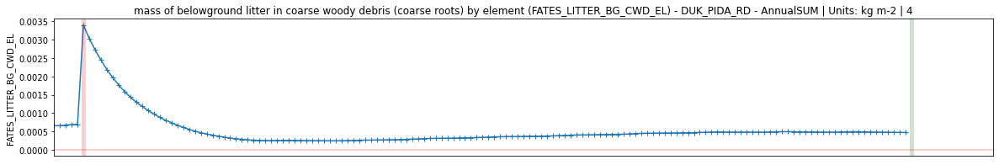

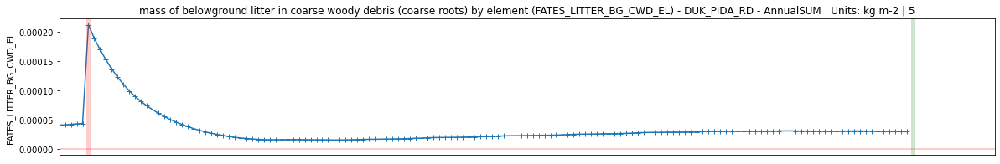

...

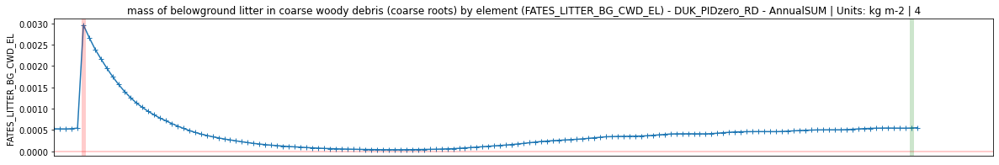

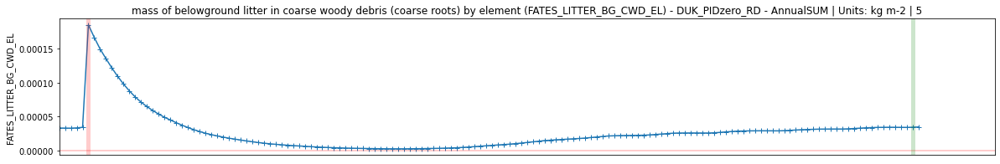

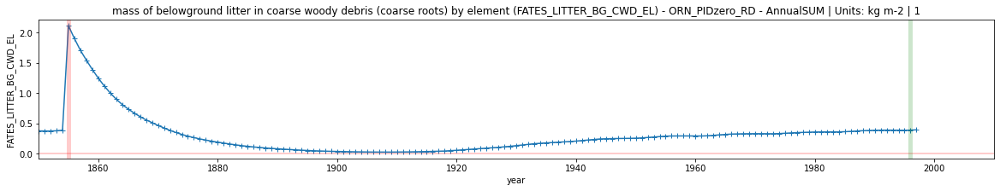

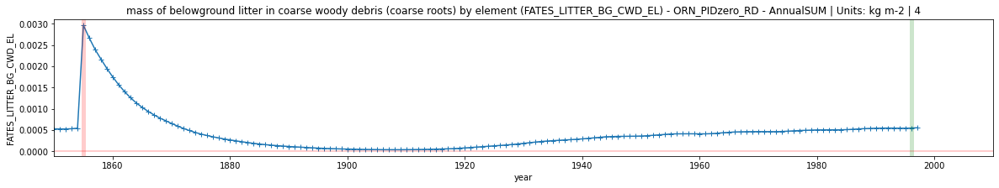

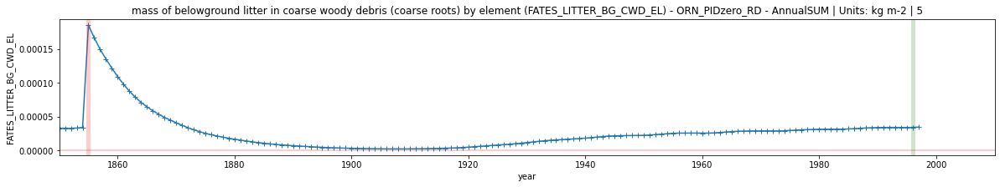

In [123]:
var = "FATES_LITTER_BG_CWD_EL"
for idx, key in enumerate(ds.keys()):
    for Fi in range (len(ds[key][var].fates_levelem)):
        ds[key][var][:,Fi].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
        plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units} | {(ds[key][var][:,Fi].fates_levelem.values)}")
        plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
        plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
        plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
        plt.xlim(1850,2010)
        #plt.ylim(0,35)
        if idx != len(ds.keys())-1 : 
            plt.xticks([])
            plt.xlabel(None)
ds[key][var].long_name

/Users/ud4/opt/anaconda3/envs/pyces/lib/python3.9/site-packages/xarray/plot/utils.py:429: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  _, ax = plt.subplots(figsize=figsize)


'litter flux in in kg element per m2 per second'

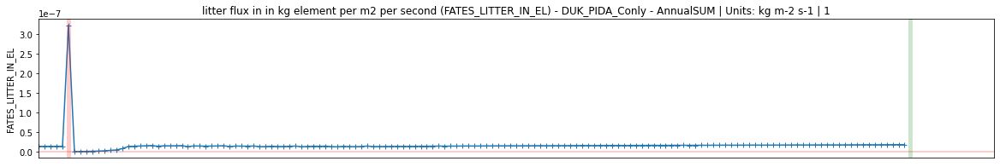

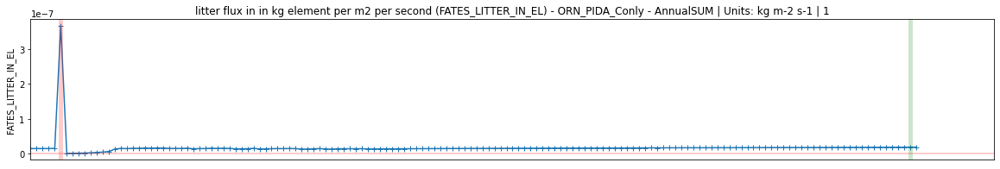

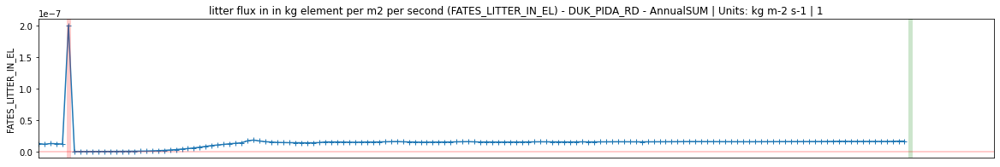

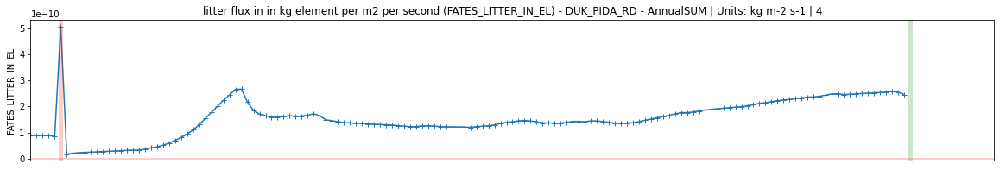

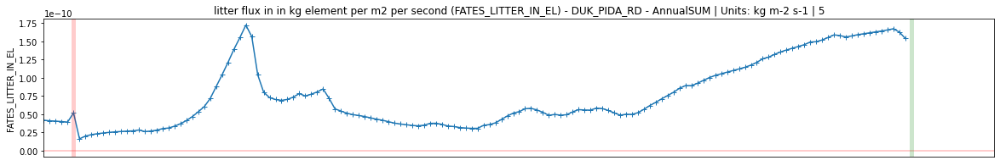

...

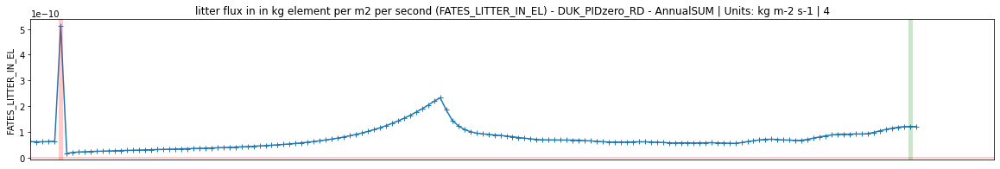

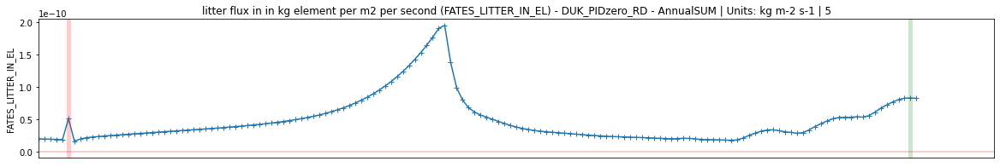

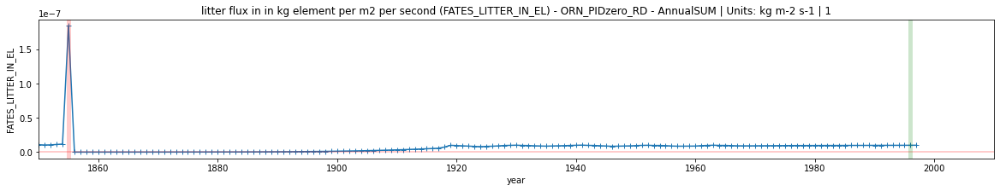

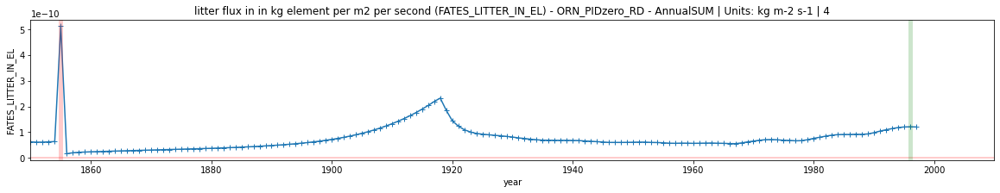

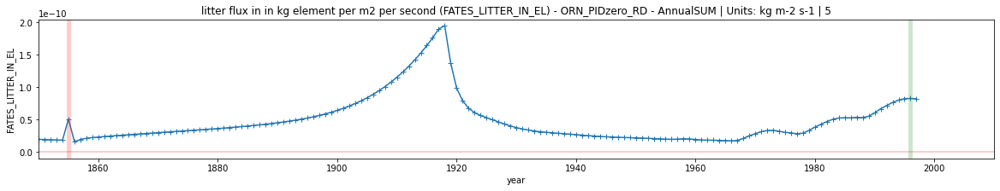

In [124]:
var = "FATES_LITTER_IN_EL"
for idx, key in enumerate(ds.keys()):
    for Fi in range (len(ds[key][var].fates_levelem)):
        ds[key][var][:,Fi].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
        plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units} | {(ds[key][var][:,Fi].fates_levelem.values)}")
        plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
        plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
        plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
        plt.xlim(1850,2010)
        #plt.ylim(0,35)
        if idx != len(ds.keys())-1 : 
            plt.xticks([])
            plt.xlabel(None)
ds[key][var].long_name

/Users/ud4/opt/anaconda3/envs/pyces/lib/python3.9/site-packages/xarray/plot/utils.py:429: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  _, ax = plt.subplots(figsize=figsize)


'litter flux out (exudation, fragmentation and seed decay) in kg element'

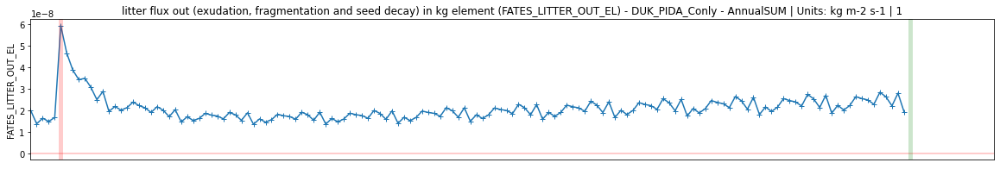

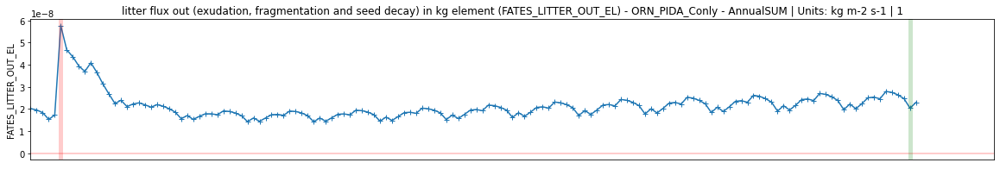

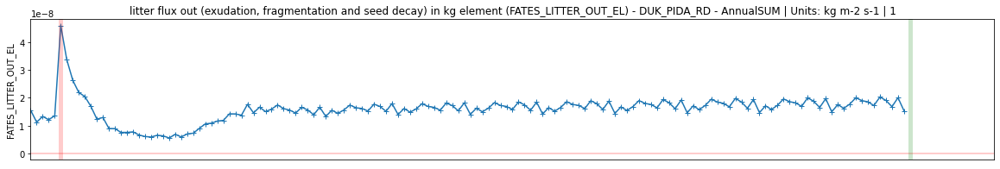

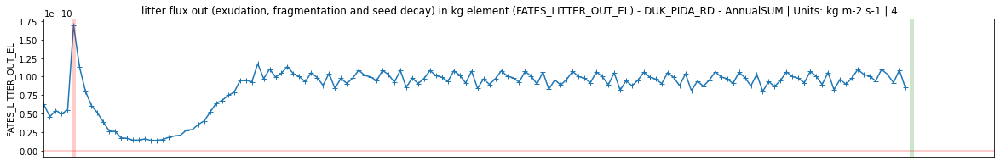

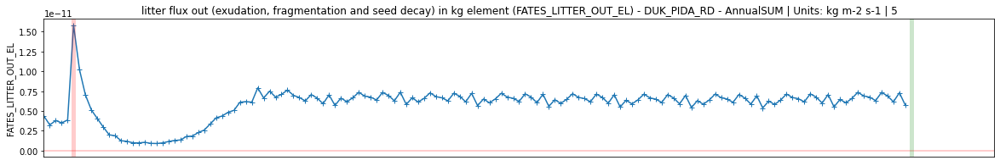

...

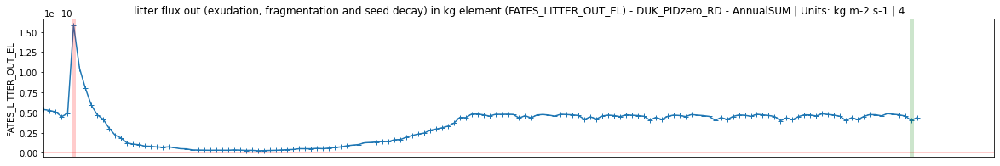

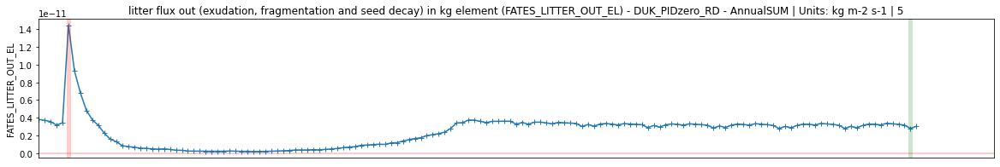

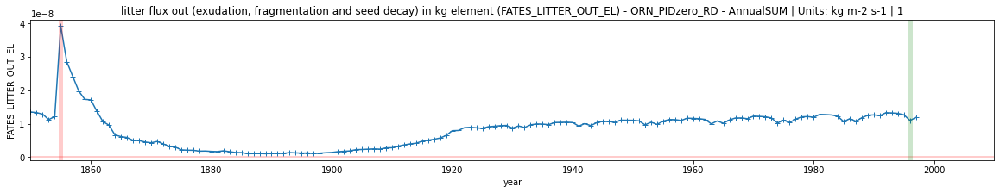

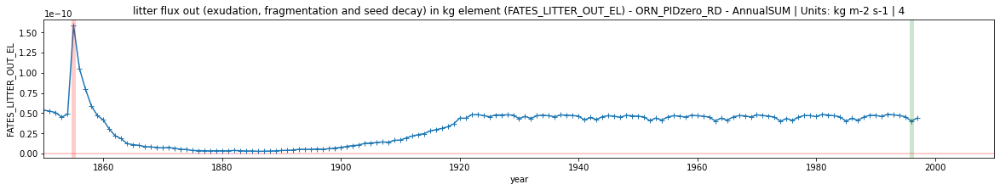

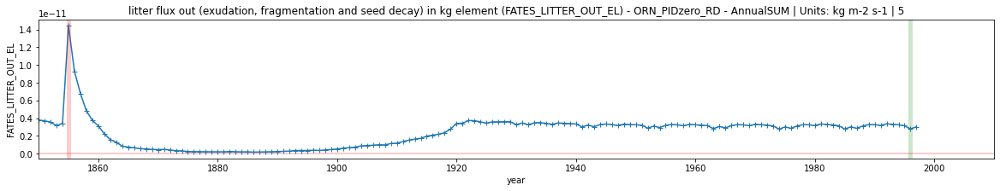

In [125]:
var = "FATES_LITTER_OUT_EL"
for idx, key in enumerate(ds.keys()):
    for Fi in range (len(ds[key][var].fates_levelem)):
        ds[key][var][:,Fi].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
        plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units} | {(ds[key][var][:,Fi].fates_levelem.values)}")
        plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
        plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
        plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
        plt.xlim(1850,2010)
        #plt.ylim(0,35)
        if idx != len(ds.keys())-1 : 
            plt.xticks([])
            plt.xlabel(None)
ds[key][var].long_name

/Users/ud4/opt/anaconda3/envs/pyces/lib/python3.9/site-packages/xarray/plot/utils.py:429: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  _, ax = plt.subplots(figsize=figsize)


'LITR1 C (vertically resolved)'

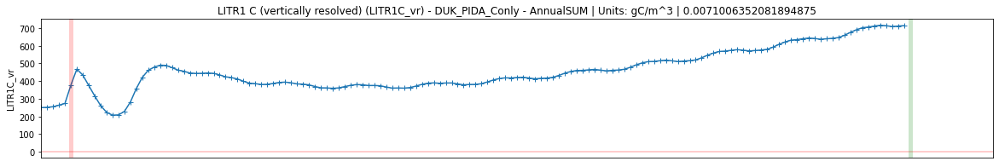

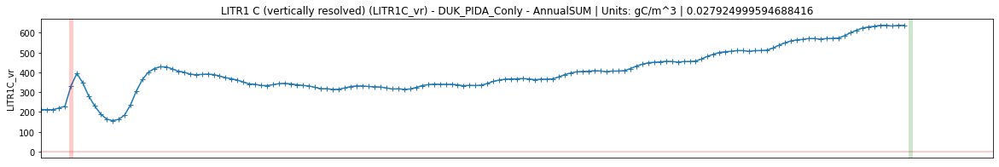

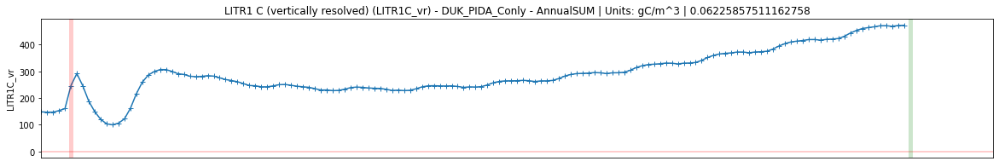

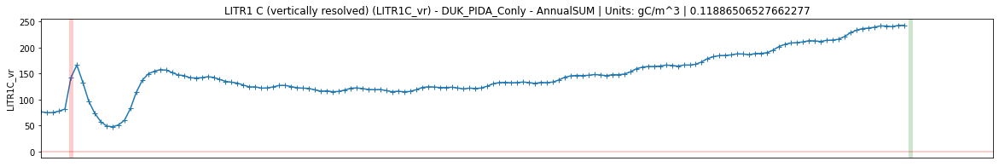

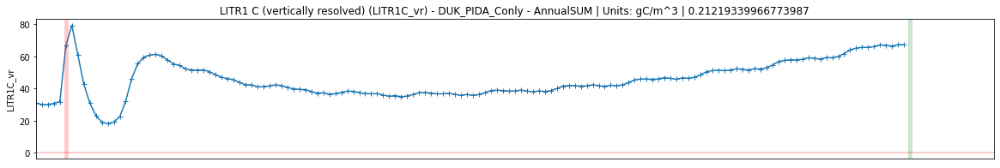

...

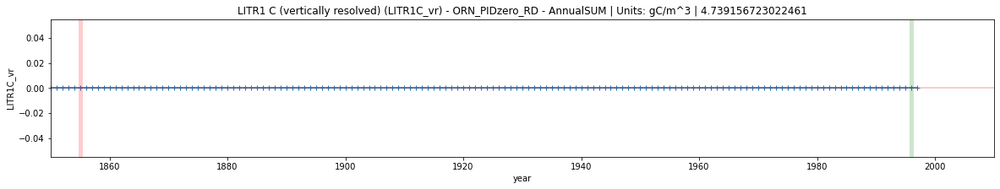

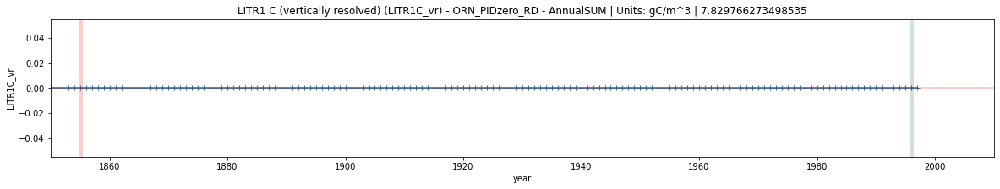

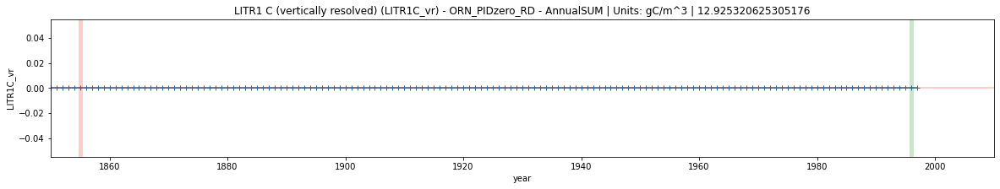

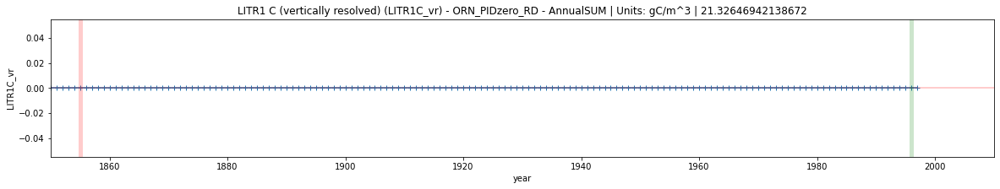

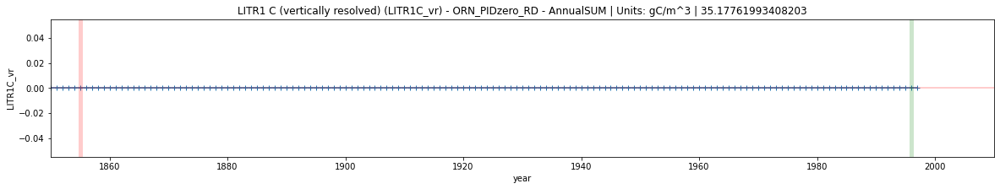

In [126]:
var = "LITR1C_vr"
for idx, key in enumerate(ds.keys()):
    for Fi in range (len(ds[key][var].levdcmp)):
        ds[key][var][:,Fi].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
        plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units} | {(ds[key][var][:,Fi].levdcmp.values)}")
        plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
        plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
        plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
        plt.xlim(1850,2010)
        #plt.ylim(0,35)
        if idx != len(ds.keys())-1 : 
            plt.xticks([])
            plt.xlabel(None)
ds[key][var].long_name

In [127]:
ds[key][var]

<xarray.DataArray 'LITR1C_vr' (time: 54020, levdcmp: 15, lndgrid: 1)>
dask.array<open_dataset-8e18e7adabec0373b3c7fb59ffb5c454LITR1C_vr, shape=(54020, 15, 1), dtype=float32, chunksize=(54020, 15, 1), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) datetime64[ns] 1850-01-01 1850-01-02 ... 1997-12-31
  * levdcmp  (levdcmp) float64 0.007101 0.02792 0.06226 ... 12.93 21.33 35.18
Dimensions without coordinates: lndgrid
Attributes:
    units:      gC/m^3
    long_name:  LITR1 C (vertically resolved)

In [128]:
ds[key][var].levdcmp

<xarray.DataArray 'levdcmp' (levdcmp: 15)>
array([7.100635e-03, 2.792500e-02, 6.225858e-02, 1.188651e-01, 2.121934e-01,
       3.660658e-01, 6.197585e-01, 1.038027e+00, 1.727635e+00, 2.864607e+00,
       4.739157e+00, 7.829766e+00, 1.292532e+01, 2.132647e+01, 3.517762e+01])
Coordinates:
  * levdcmp  (levdcmp) float64 0.007101 0.02792 0.06226 ... 12.93 21.33 35.18
Attributes:
    units:    m

In [129]:
#print(ds[key][var][:,Fi].fates_levelem.values)

'nitrate uptake rate by plants in kg NO3 per m2 per second'

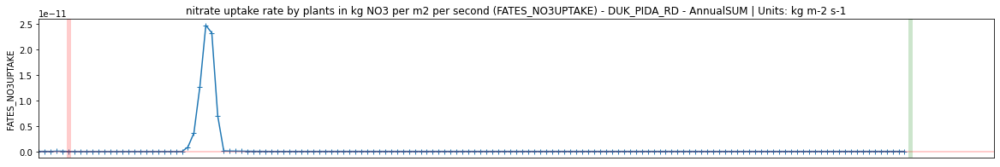

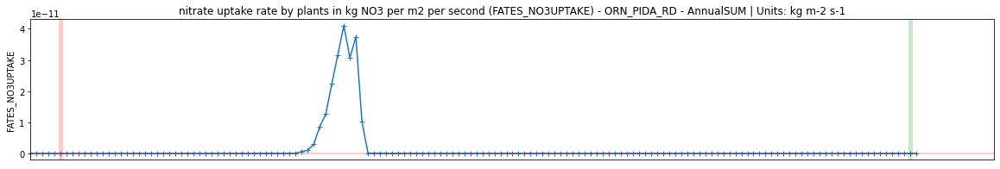

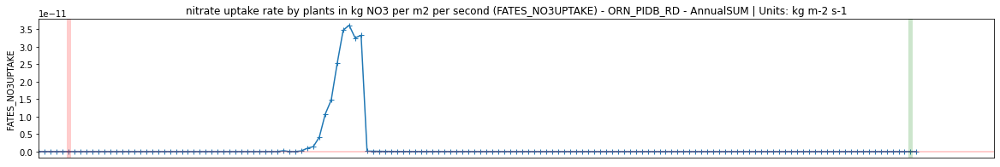

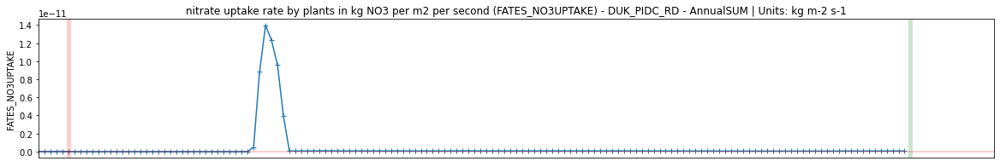

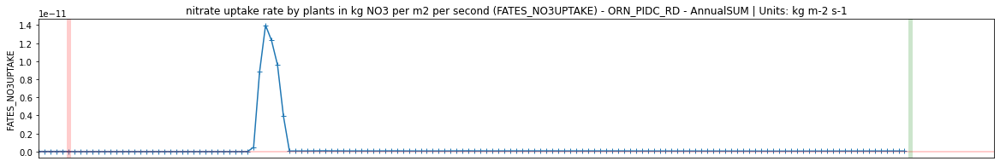

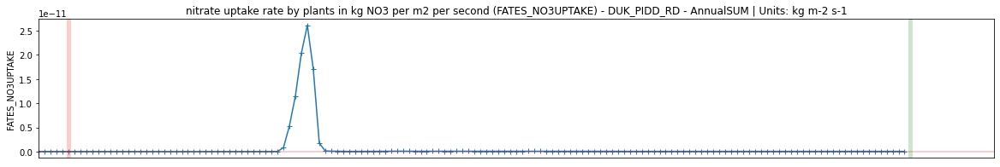

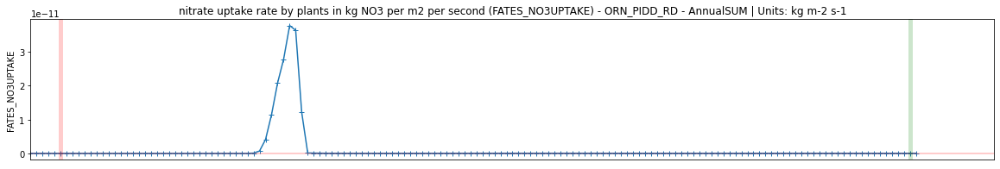

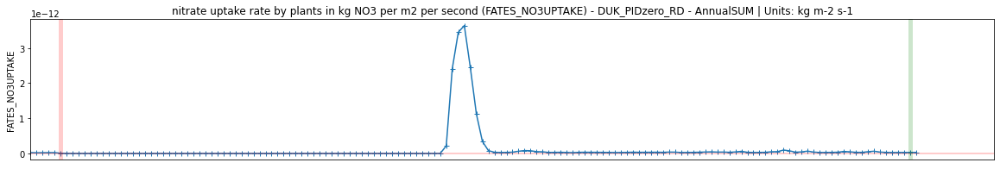

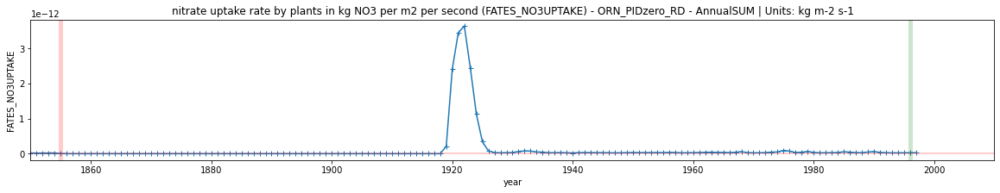

In [130]:
var = "FATES_NO3UPTAKE"#"FATES_NH4UPTAKE"
for idx, key in enumerate(ds.keys()):
    try:
        ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
        plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
        plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
        plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
        plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
        plt.xlim(1850,2010)
    #plt.ylim(0,35)
        if idx != len(ds.keys())-1 : 
            plt.xticks([])
            plt.xlabel(None)
    except: 
        pass
ds[key][var].long_name
# Remarks: 

'ammonium uptake rate by plants in kg NH4 per m2 per second'

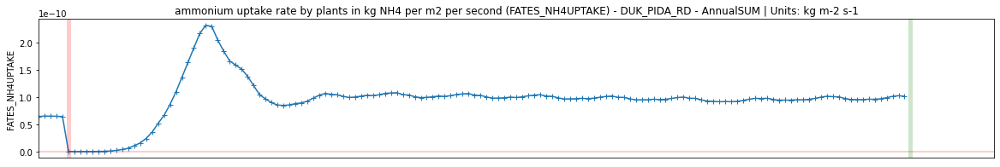

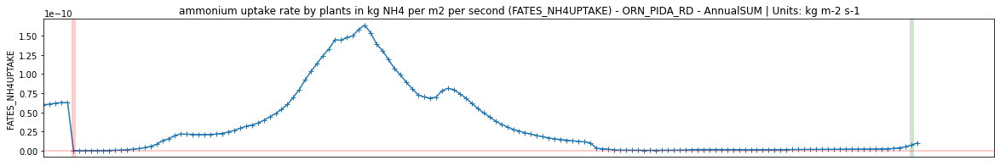

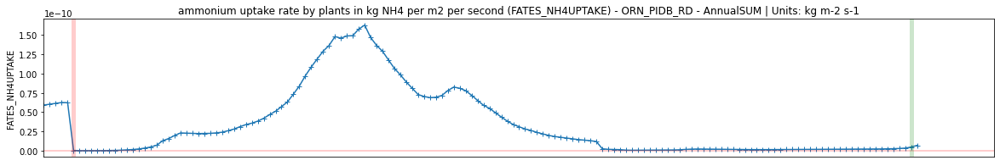

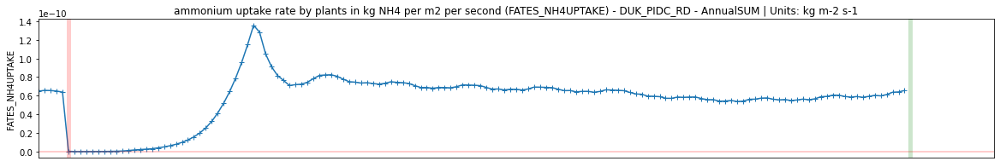

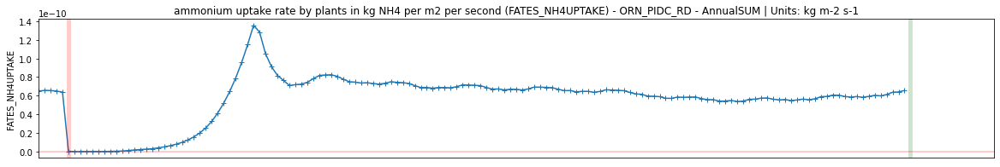

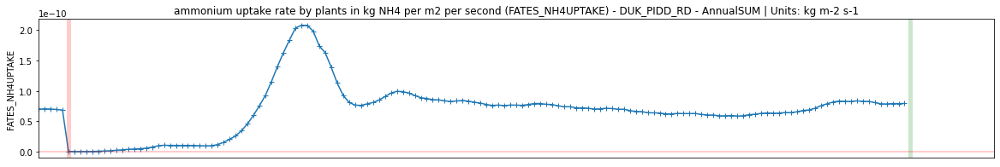

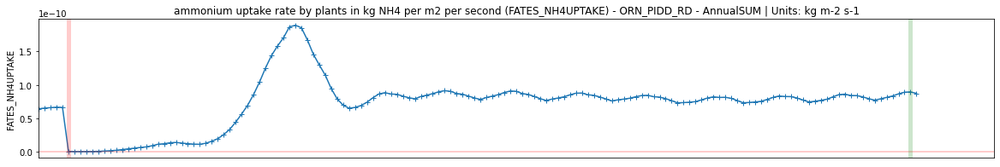

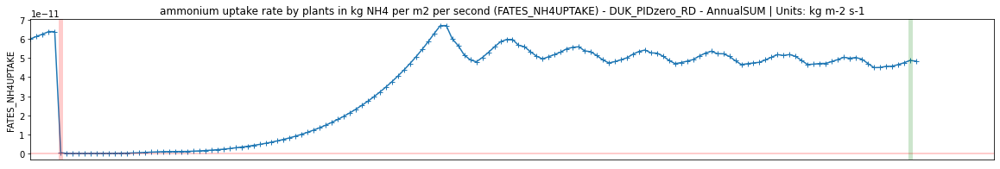

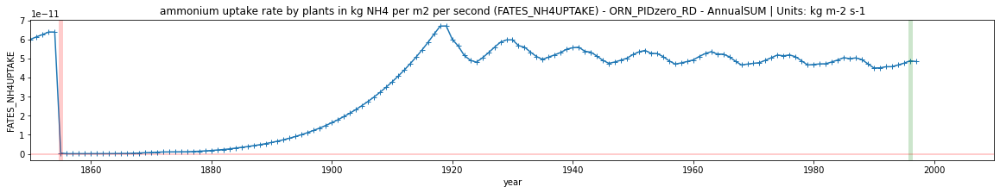

In [131]:
var = "FATES_NH4UPTAKE"
for idx, key in enumerate(ds.keys()):
    try:
        ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
        plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
        plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
        plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
        plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
        plt.xlim(1850,2010)
    #plt.ylim(0,35)
        if idx != len(ds.keys())-1 : 
            plt.xticks([])
            plt.xlabel(None)
    except: 
        pass
ds[key][var].long_name

'mineralized phosphorus uptake rate of plants in kg P per m2 per second'

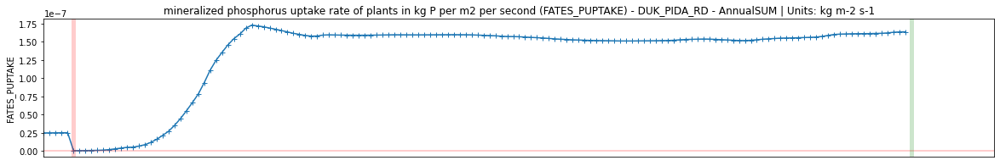

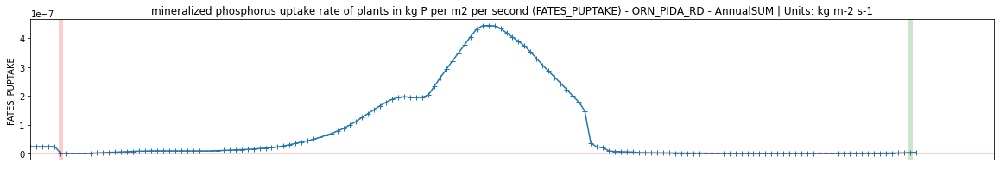

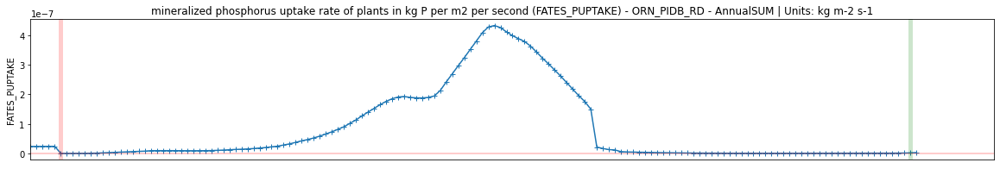

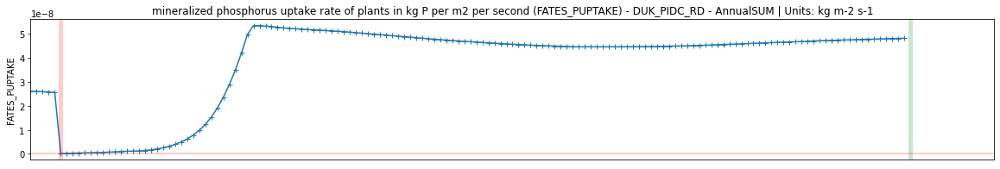

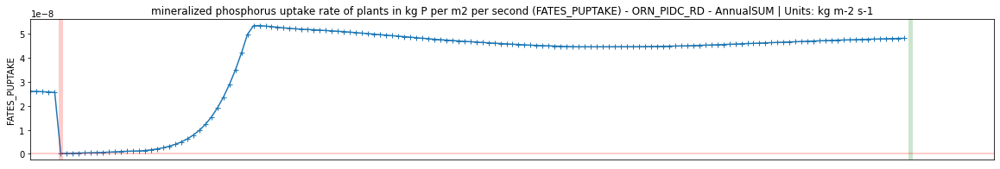

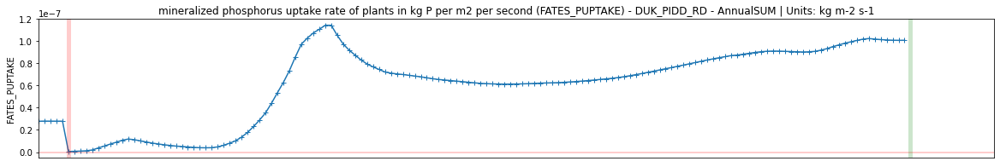

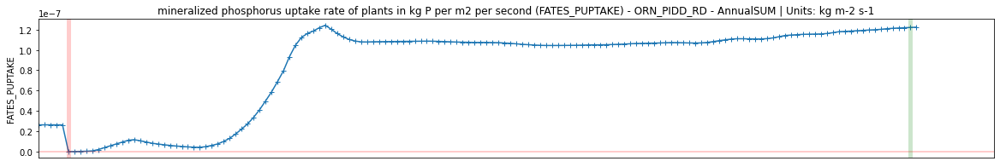

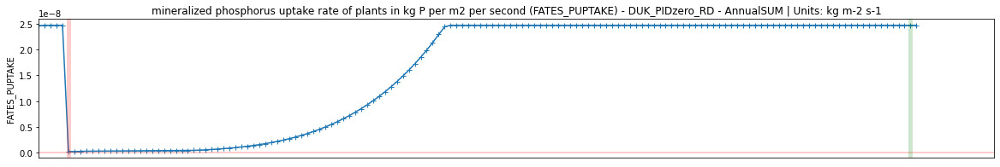

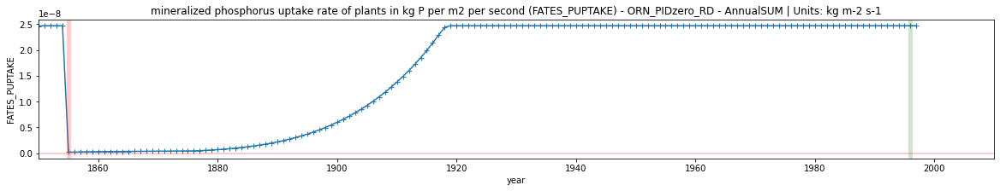

In [132]:
var = "FATES_PUPTAKE"
for idx, key in enumerate(ds.keys()):
    try:
        ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
        plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
        plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
        plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
        plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
        plt.xlim(1850,2010)
    #plt.ylim(0,35)
        if idx != len(ds.keys())-1 : 
            plt.xticks([])
            plt.xlabel(None)
    except: 
        pass
ds[key][var].long_name

'Storage C fraction of target'

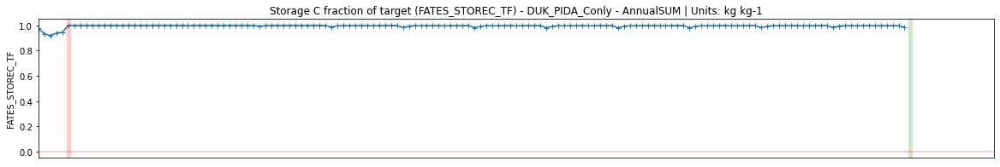

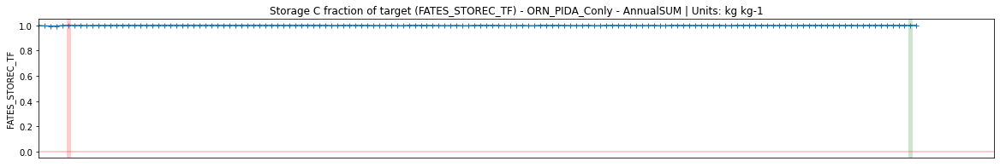

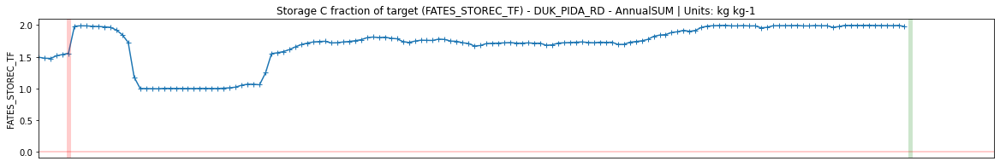

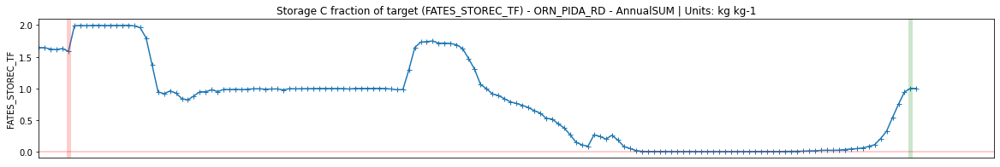

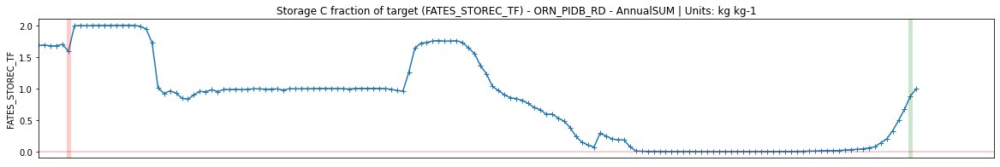

...

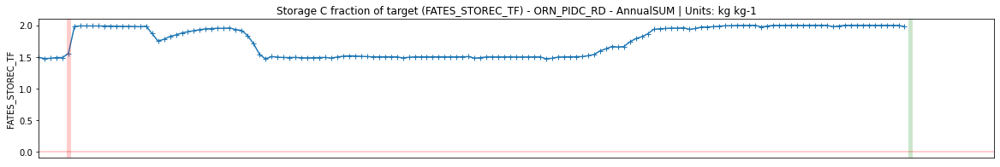

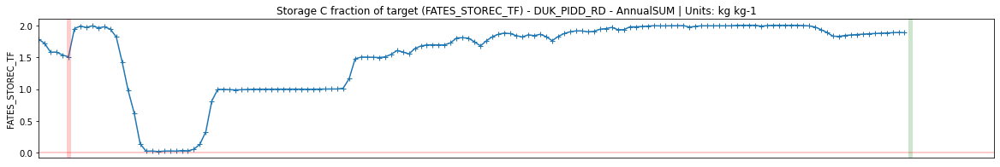

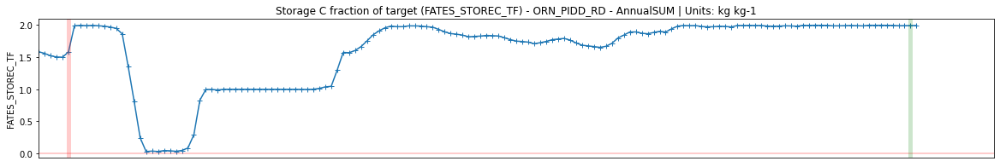

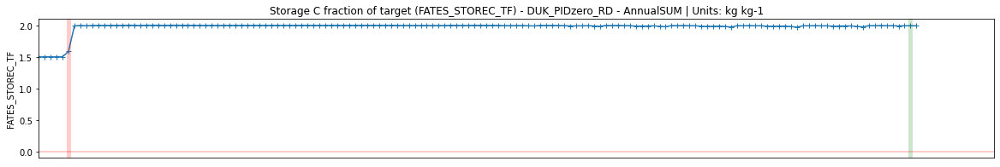

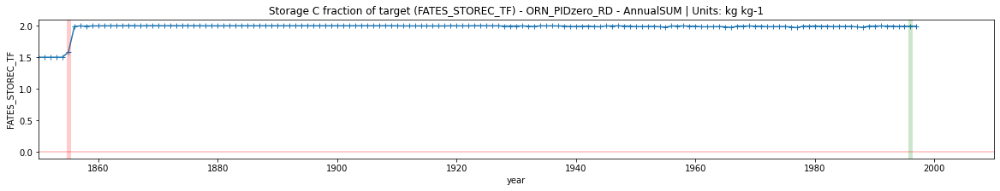

In [133]:

var = "FATES_STOREC_TF"
for idx, key in enumerate(ds.keys()):
    try:
        ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
        plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
        plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
        plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
        plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
        plt.xlim(1850,2010)
    #plt.ylim(0,35)
        if idx != len(ds.keys())-1 : 
            plt.xticks([])
            plt.xlabel(None)
    except: 
        pass
ds[key][var].long_name

'storage N fraction of target'

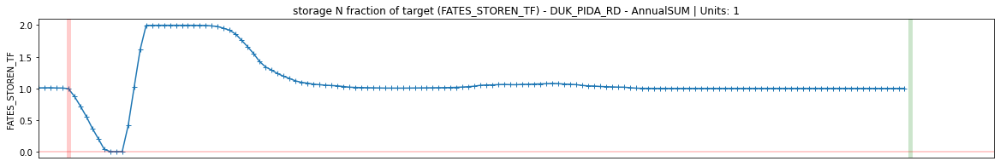

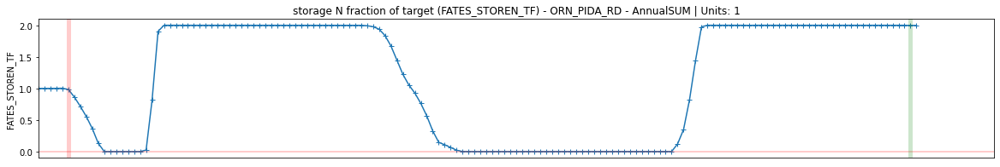

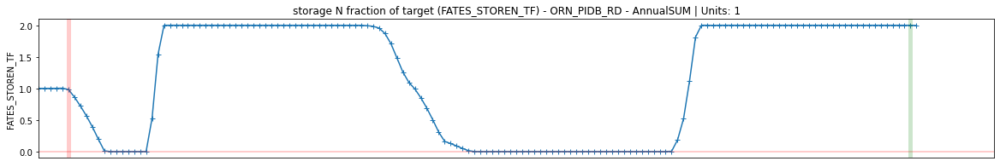

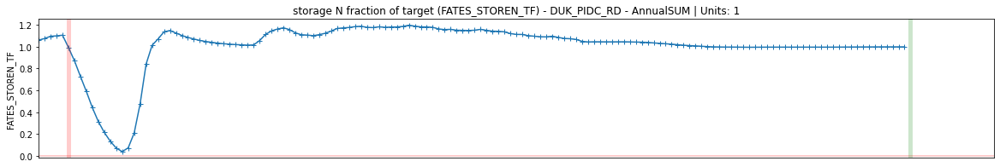

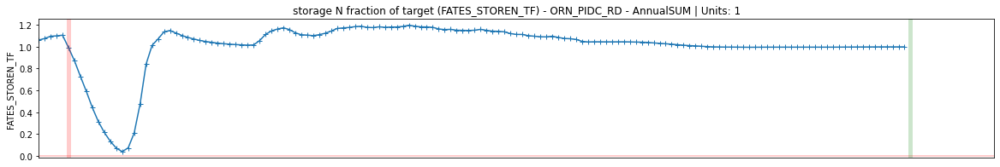

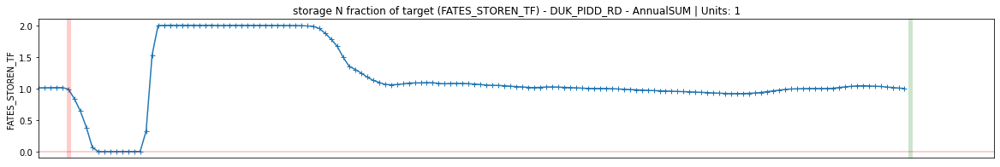

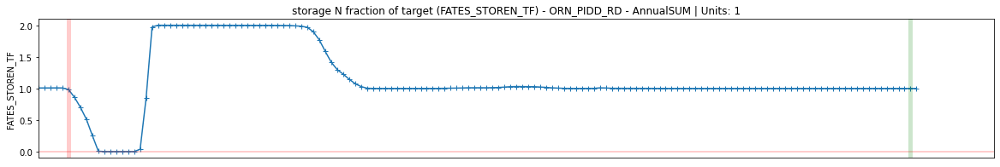

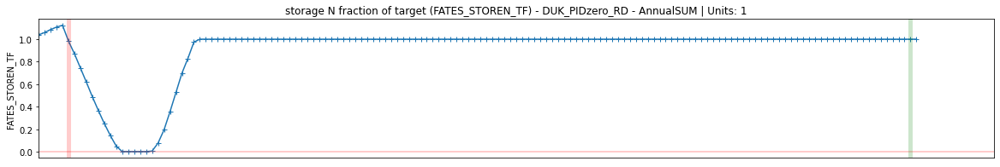

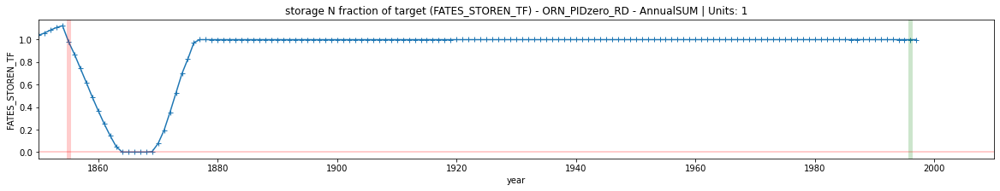

In [134]:

var = "FATES_STOREN_TF"
for idx, key in enumerate(ds.keys()):
    try:
        ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
        plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
        plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
        plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
        plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
        plt.xlim(1850,2010)
    #plt.ylim(0,35)
        if idx != len(ds.keys())-1 : 
            plt.xticks([])
            plt.xlabel(None)
    except: 
        pass
ds[key][var].long_name

'storage P fraction of target'

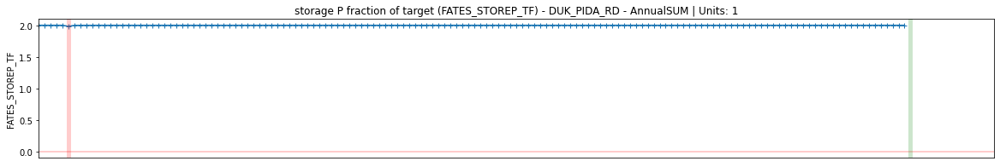

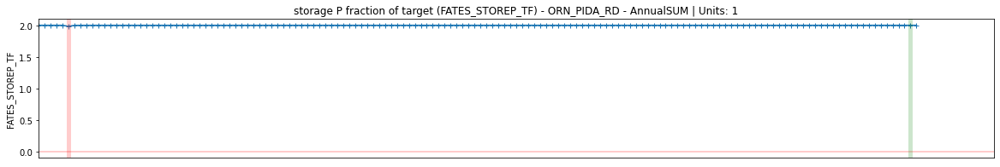

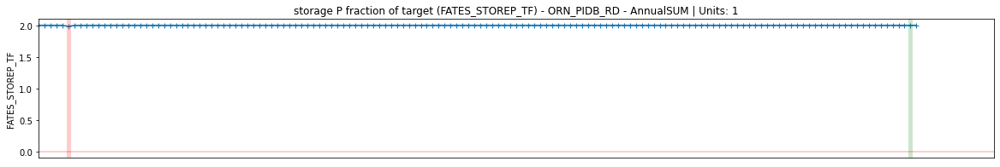

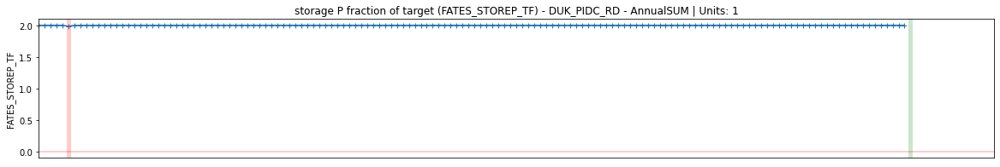

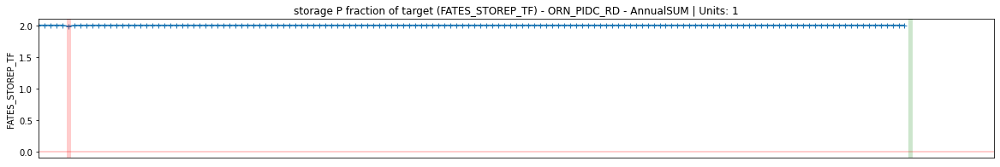

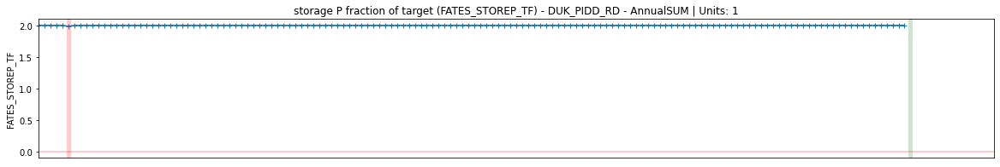

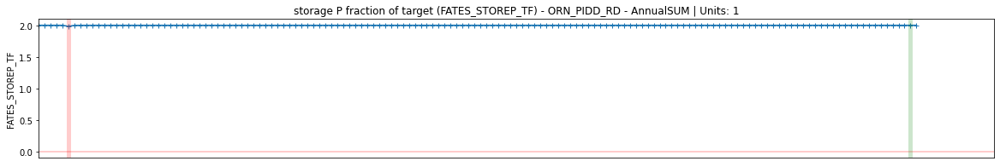

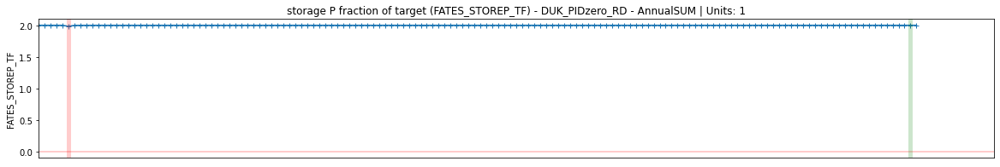

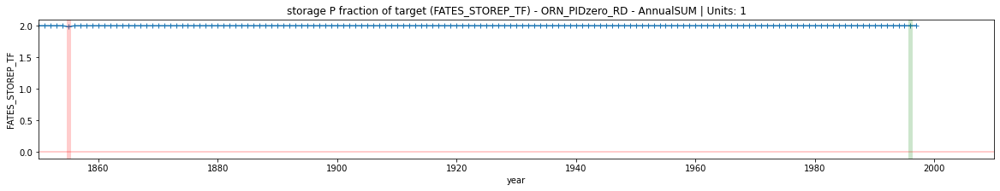

In [135]:

var = "FATES_STOREP_TF"
for idx, key in enumerate(ds.keys()):
    try:
        ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
        plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
        plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
        plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
        plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
        plt.xlim(1850,2010)
    #plt.ylim(0,35)
        if idx != len(ds.keys())-1 : 
            plt.xticks([])
            plt.xlabel(None)
    except: 
        pass
ds[key][var].long_name

'The leaf to fineroot biomass multiplier for target allometry'

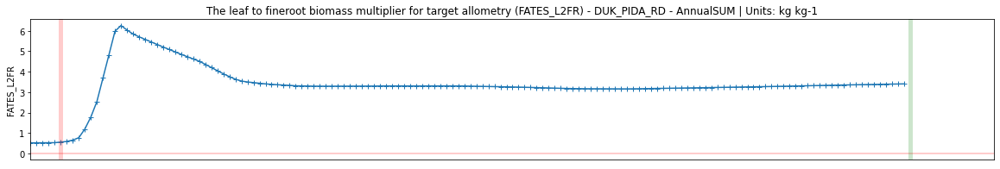

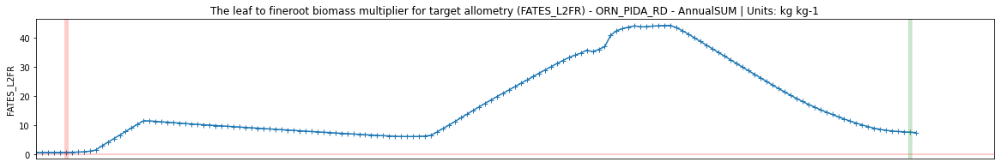

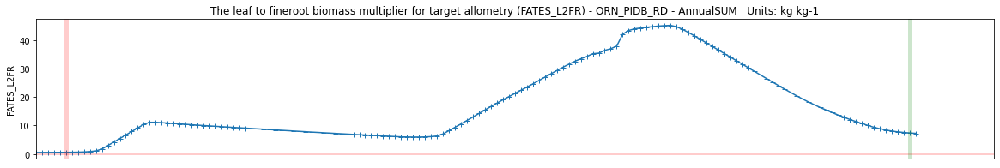

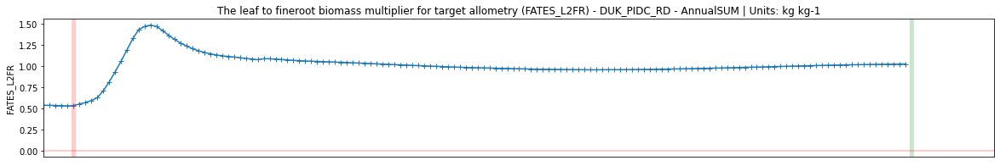

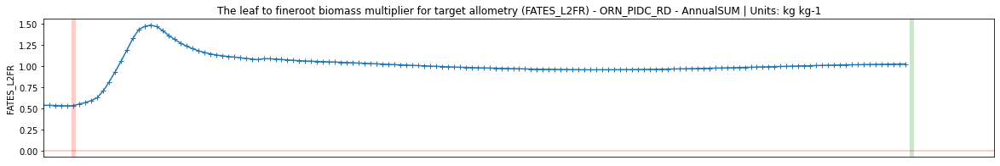

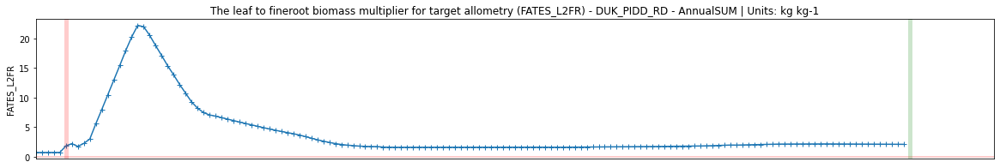

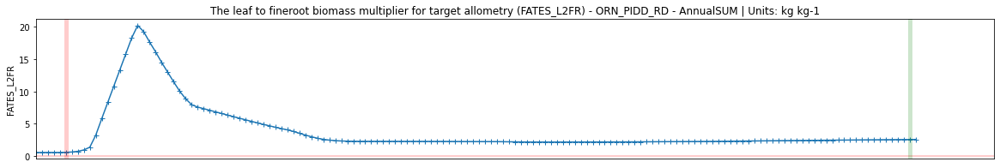

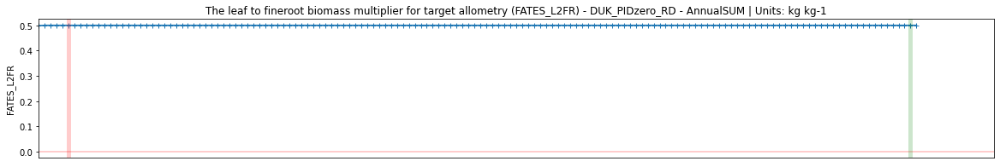

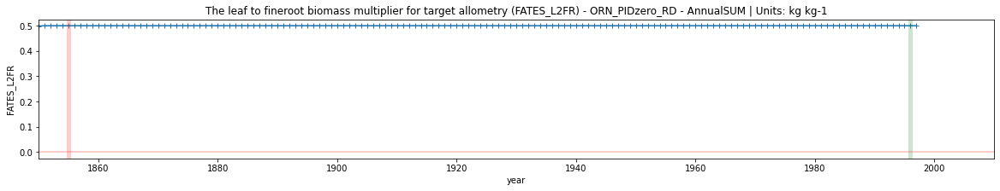

In [136]:


var = "FATES_L2FR"
for idx, key in enumerate(ds.keys()):
    try:
        ds[key][var].groupby("time.year").mean('time').plot(figsize=(20,3),marker='+')
        plt.title(f"{ds[key][var].long_name} ({var}) - {key} - AnnualSUM | Units: {ds[key][var].units}")
        plt.axvline(x = logging_year, color = 'r',lw=5, label = 'logging year', alpha=.2)
        plt.axhline(y = 0, color = 'r',lw=2, label = 'Zero', alpha=.2)
        plt.axvline(x = 1996, color = 'g',lw=5, label = 'logging year', alpha=.2)
        plt.xlim(1850,2010)
    #plt.ylim(0,35)
        if idx != len(ds.keys())-1 : 
            plt.xticks([])
            plt.xlabel(None)
    except: 
        pass
ds[key][var].long_name

In [137]:
print ("Successful run")

Successful run
